In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from task4 import Task
import numpy as np

class TaskEmbeddingDataset(torch.utils.data.Dataset):
    def __init__(self, tasks, feature_size=40):
        self.tasks = tasks
        self.feature_size = feature_size
        
        # Extract features for all tasks
        print("Extracting features...")
        self.features = [extract_task_features(task, feature_size) for task in tasks]
        
        # Create simplified groups based on grid size and example counts
        print("Creating task groups...")
        self.task_to_group = {}  # Maps task index to group ID
        groups = {}  # Maps group key to group ID
        
        for i, task in enumerate(tasks):
            if hasattr(task, 'train_pairs') and task.train_pairs:
                # Simple grouping by grid size categories
                input_grid = task.train_pairs[0][0]
                grid_array = np.array(input_grid)
                rows, cols = grid_array.shape
                
                # Create broader categories
                row_cat = rows // 5  # Group into ranges of 5
                col_cat = cols // 5
                num_examples = min(5, len(task.train_pairs))
                
                # Combine these features for grouping
                group_key = f"size_{row_cat}x{col_cat}_ex_{num_examples}"
                
                # Assign to group
                if group_key not in groups:
                    groups[group_key] = len(groups)
                
                self.task_to_group[i] = groups[group_key]
            else:
                # Default group for tasks without examples
                if "default" not in groups:
                    groups["default"] = len(groups)
                self.task_to_group[i] = groups["default"]
        
        print(f"Created {len(groups)} groups from {len(tasks)} tasks")
        
        # Analyze group distribution
        group_sizes = {}
        for group_id in self.task_to_group.values():
            if group_id not in group_sizes:
                group_sizes[group_id] = 0
            group_sizes[group_id] += 1
        
        print("Group size distribution:")
        for group_id, size in sorted(group_sizes.items(), key=lambda x: x[1], reverse=True):
            print(f"  Group {group_id}: {size} tasks")
    
    def __len__(self):
        return len(self.tasks)
    
    def __getitem__(self, idx):
        # Get the group index directly from the mapping
        group_idx = self.task_to_group[idx]
        
        # Return the pre-computed features and group index
        return self.features[idx], torch.tensor(group_idx, dtype=torch.long)

    
# def extract_task_features(task, feature_size=40):
#     """Enhanced feature extraction from a Task object for embedding training"""
#     features = []
    
#     # 1. Color/value distribution features
#     try:
#         color_stats = []
#         num_colors = []
        
#         for input_grid, _ in task.train_pairs:
#             grid_array = np.array(input_grid)
#             values, counts = np.unique(grid_array, return_counts=True)
            
#             # Calculate color entropy
#             total = sum(counts)
#             if total > 0:
#                 distribution = [c/total for c in counts]
#                 entropy = -sum(p * np.log2(p) if p > 0 else 0 for p in distribution)
#                 color_stats.append(entropy / 3.32)  # Normalize by log2(10)
            
#             # Number of colors
#             num_colors.append(len(values) / 10.0)  # Normalize by max expected colors
        
#         # Add color features
#         features.append(np.mean(color_stats) if color_stats else 0.0)
#         features.append(np.mean(num_colors) if num_colors else 0.0)
#     except Exception as e:
#         print("Using default value distribution features")
#         features.extend([0.0, 0.0])
    
#     # 2. Grid size features
#     if task.train_pairs:
#         input_shape = np.array(task.train_pairs[0][0]).shape
#         features.append(input_shape[0] / 30.0)  # Normalized row count
#         features.append(input_shape[1] / 30.0)  # Normalized column count
#         features.append((input_shape[0] * input_shape[1]) / 900.0)  # Normalized total size
#     else:
#         print("Using default grid size features")
#         features.extend([0.0, 0.0, 0.0])
    
#     # 3. Change analysis with enhanced transformation features
#     if task.train_pairs:
#         # Basic change analysis
#         avg_changes = 0
#         for input_grid, output_grid in task.train_pairs:
#             input_np = np.array(input_grid)
#             output_np = np.array(output_grid)
            
#             # Find shape intersection
#             min_rows = min(input_np.shape[0], output_np.shape[0])
#             min_cols = min(input_np.shape[1], output_np.shape[1])
            
#             # Count changes
#             if min_rows > 0 and min_cols > 0:
#                 changes = np.sum(input_np[:min_rows, :min_cols] != output_np[:min_rows, :min_cols])
#                 total_cells = min_rows * min_cols
#                 change_ratio = changes / total_cells if total_cells > 0 else 0
#                 avg_changes += change_ratio
        
#         if task.train_pairs:
#             avg_changes /= len(task.train_pairs)
#         features.append(avg_changes)
        
#         # Analyze transformation types if available in train_graphs
#         if hasattr(task, 'train_graphs') and task.train_graphs:
#             # Track transformation types (add, remove, unchanged)
#             transformation_stats = {
#                 "add": 0.0,
#                 "remove": 0.0,
#                 "unchanged": 0.0
#             }
            
#             edge_type_stats = {}
            
#             total_transformations = 0
#             total_edges = 0
            
#             for graph in task.train_graphs:
#                 # Extract transformation info if available
#                 if hasattr(graph, 'edge_transformation_pred') and hasattr(graph, 'edge_transformation_labels'):
#                     labels = graph.edge_transformation_labels.cpu().numpy() if torch.is_tensor(graph.edge_transformation_labels) else graph.edge_transformation_labels
                    
#                     # Count transformation types (assuming 0=unchanged, 1=removed, 2=added)
#                     if len(labels) > 0:
#                         unchanged_count = np.sum(labels == 0)
#                         removed_count = np.sum(labels == 1)
#                         added_count = np.sum(labels == 2)
                        
#                         total = len(labels)
#                         total_transformations += total
                        
#                         transformation_stats["unchanged"] += unchanged_count
#                         transformation_stats["remove"] += removed_count 
#                         transformation_stats["add"] += added_count
                
#                 # Extract edge type information if available
#                 if hasattr(graph, 'edge_type') and torch.is_tensor(graph.edge_type):
#                     edge_types = graph.edge_type.cpu().numpy()
#                     unique_types, counts = np.unique(edge_types, return_counts=True)
                    
#                     total_edges += len(edge_types)
                    
#                     for t, count in zip(unique_types, counts):
#                         type_name = f"edge_type_{t}"
#                         if type_name not in edge_type_stats:
#                             edge_type_stats[type_name] = 0
#                         edge_type_stats[type_name] += count
            
#             # Normalize transformation stats
#             if total_transformations > 0:
#                 for key in transformation_stats:
#                     transformation_stats[key] /= total_transformations
#                     features.append(transformation_stats[key])
#             else:
#                 features.extend([0.0, 0.0, 0.0])  # Default values if no transformations
            
#             # Normalize edge type stats
#             if total_edges > 0:
#                 # Add top 5 edge types or pad with zeros
#                 edge_type_items = sorted(edge_type_stats.items(), key=lambda x: x[1], reverse=True)
#                 edge_ratios = [count/total_edges for _, count in edge_type_items[:5]]
                
#                 # Pad to ensure 5 features
#                 edge_ratios = edge_ratios + [0.0] * (5 - len(edge_ratios))
#                 features.extend(edge_ratios)
#             else:
#                 features.extend([0.0, 0.0, 0.0, 0.0, 0.0])  # Default values if no edges
#     else:
#         print("Using default edge transformation features")
#         features.append(0.0)  # Default change ratio
#         features.extend([0.0, 0.0, 0.0])  # Default transformation stats
#         features.extend([0.0, 0.0, 0.0, 0.0, 0.0])  # Default edge type stats
    
#     # 4. Pattern complexity metrics
#     if task.train_pairs:
#         # Calculate average symmetry scores
#         symmetry_scores = []
#         for input_grid, _ in task.train_pairs:
#             grid_array = np.array(input_grid)
            
#             # Horizontal symmetry
#             rows, cols = grid_array.shape
#             h_symmetry = 0
#             v_symmetry = 0
            
#             if cols >= 2:
#                 # Check horizontal symmetry (left-right)
#                 mid = cols // 2
#                 left_side = grid_array[:, :mid]
#                 right_side = grid_array[:, cols-1:mid-1 if mid > 0 else None:-1]
#                 if left_side.shape == right_side.shape:
#                     h_symmetry = np.mean(left_side == right_side)
            
#             if rows >= 2:
#                 # Check vertical symmetry (top-bottom)
#                 mid = rows // 2
#                 top_side = grid_array[:mid, :]
#                 bottom_side = grid_array[rows-1:mid-1 if mid > 0 else None:-1, :]
#                 if top_side.shape == bottom_side.shape:
#                     v_symmetry = np.mean(top_side == bottom_side)
            
#             symmetry_scores.append((h_symmetry + v_symmetry) / 2)
        
#         # Add average symmetry score
#         features.append(np.mean(symmetry_scores) if symmetry_scores else 0.0)
        
#         # Add count of different shapes/patterns (connected components)
#         avg_components = 0
#         for input_grid, _ in task.train_pairs:
#             grid_array = np.array(input_grid)
#             # Simple connected components count (non-zero elements)
#             from scipy.ndimage import label
#             non_zero_mask = (grid_array > 0)
#             if np.any(non_zero_mask):
#                 labeled_array, num_components = label(non_zero_mask)
#                 avg_components += num_components / 20.0  # Normalize by expected max
            
#         features.append(avg_components / len(task.train_pairs) if task.train_pairs else 0.0)
#     else:
#         print("Using default pattern complexity features")
#         features.extend([0.0, 0.0])  # Default pattern metrics
    
#     # 5. Task metadata
#     features.append(len(task.train_pairs) / 10.0)  # Number of training examples
#     features.append(len(task.test_pairs) / 10.0)   # Number of test examples
    
#     # 6. Use existing graph information
#     if hasattr(task, 'train_graphs') and task.train_graphs:
#         graph_features = []
#         for graph in task.train_graphs:
#             # Number of nodes
#             nodes = graph.x.size(0) if hasattr(graph, 'x') else 0
#             graph_features.append(nodes / 900.0)  # Normalize by max nodes
            
#             # Number of edges by type
#             for edge_type in ['edge_index', 'value_edge_index', 'region_edge_index', 'contextual_edge_index', 'alignment_edge_index']:
#                 if hasattr(graph, edge_type):
#                     edges = getattr(graph, edge_type).size(1) / 2  # Divide by 2 because edges are bidirectional
#                     graph_features.append(edges / 4000.0)  # Normalize by typical max edges
#                 else:
#                     graph_features.append(0.0)
        
#         # Average graph features across training examples
#         if graph_features:
#             features.extend([sum(graph_features[i::5])/len(task.train_graphs) for i in range(5)])
#         else:
#             print("Using default edge transformation features")
#             features.extend([0.0, 0.0, 0.0, 0.0, 0.0])
#     else:
#         print("Using default edge transformation features")
#         features.extend([0.0, 0.0, 0.0, 0.0, 0.0])
    
#     # Ensure we have the right number of features
#     while len(features) < feature_size:
#         features.append(0.0)
    
#     # Truncate if too long
#     features = features[:feature_size]
    
#     return torch.tensor(features, dtype=torch.float32)
def extract_task_features(task, feature_size=40):
    """Enhanced feature extraction from a Task object for embedding training"""
    features = []
    
    # 1. Color/value distribution features
    try:
        color_stats = []
        num_colors = []
        
        for input_grid, _ in task.train_pairs:
            grid_array = np.array(input_grid)
            values, counts = np.unique(grid_array, return_counts=True)
            
            # Calculate color entropy
            total = sum(counts)
            if total > 0:
                distribution = [c/total for c in counts]
                entropy = -sum(p * np.log2(p) if p > 0 else 0 for p in distribution)
                color_stats.append(entropy / 3.32)  # Normalize by log2(10)
            
            # Number of colors
            num_colors.append(len(values) / 10.0)  # Normalize by max expected colors
        
        # Add color features
        features.append(np.mean(color_stats) if color_stats else 0.0)
        features.append(np.mean(num_colors) if num_colors else 0.0)
    except Exception as e:
        print("Using default value distribution features")
        features.extend([0.0, 0.0])
    
    # 2. Grid size features
    if task.train_pairs:
        input_shape = np.array(task.train_pairs[0][0]).shape
        features.append(input_shape[0] / 30.0)  # Normalized row count
        features.append(input_shape[1] / 30.0)  # Normalized column count
        features.append((input_shape[0] * input_shape[1]) / 900.0)  # Normalized total size
    else:
        print("Using default grid size features")
        features.extend([0.0, 0.0, 0.0])
    
    # 3. Basic change analysis (without the duplicate edge transformation features)
    if task.train_pairs:
        # Basic change analysis
        avg_changes = 0
        for input_grid, output_grid in task.train_pairs:
            input_np = np.array(input_grid)
            output_np = np.array(output_grid)
            
            # Find shape intersection
            min_rows = min(input_np.shape[0], output_np.shape[0])
            min_cols = min(input_np.shape[1], output_np.shape[1])
            
            # Count changes
            if min_rows > 0 and min_cols > 0:
                changes = np.sum(input_np[:min_rows, :min_cols] != output_np[:min_rows, :min_cols])
                total_cells = min_rows * min_cols
                change_ratio = changes / total_cells if total_cells > 0 else 0
                avg_changes += change_ratio
        
        if task.train_pairs:
            avg_changes /= len(task.train_pairs)
        features.append(avg_changes)
    else:
        print("Using default change features")
        features.append(0.0)  # Default change ratio
    
    # 4. Pattern complexity metrics
    if task.train_pairs:
        # Calculate average symmetry scores
        symmetry_scores = []
        for input_grid, _ in task.train_pairs:
            grid_array = np.array(input_grid)
            
            # Horizontal symmetry
            rows, cols = grid_array.shape
            h_symmetry = 0
            v_symmetry = 0
            
            if cols >= 2:
                # Check horizontal symmetry (left-right)
                mid = cols // 2
                left_side = grid_array[:, :mid]
                right_side = grid_array[:, cols-1:mid-1 if mid > 0 else None:-1]
                if left_side.shape == right_side.shape:
                    h_symmetry = np.mean(left_side == right_side)
            
            if rows >= 2:
                # Check vertical symmetry (top-bottom)
                mid = rows // 2
                top_side = grid_array[:mid, :]
                bottom_side = grid_array[rows-1:mid-1 if mid > 0 else None:-1, :]
                if top_side.shape == bottom_side.shape:
                    v_symmetry = np.mean(top_side == bottom_side)
            
            symmetry_scores.append((h_symmetry + v_symmetry) / 2)
        
        # Add average symmetry score
        features.append(np.mean(symmetry_scores) if symmetry_scores else 0.0)
        
        # Add count of different shapes/patterns (connected components)
        avg_components = 0
        for input_grid, _ in task.train_pairs:
            grid_array = np.array(input_grid)
            # Simple connected components count (non-zero elements)
            from scipy.ndimage import label
            non_zero_mask = (grid_array > 0)
            if np.any(non_zero_mask):
                labeled_array, num_components = label(non_zero_mask)
                avg_components += num_components / 20.0  # Normalize by expected max
            
        features.append(avg_components / len(task.train_pairs) if task.train_pairs else 0.0)
    else:
        print("Using default pattern complexity features")
        features.extend([0.0, 0.0])  # Default pattern metrics
    
    # 5. Task metadata
    features.append(len(task.train_pairs) / 10.0)  # Number of training examples
    features.append(len(task.test_pairs) / 10.0)   # Number of test examples

    # 6. Graph information analysis (edge types and transformations)
    if hasattr(task, 'train_graphs') and task.train_graphs:
        # Track edge information
        edge_types_counts = {}
        edge_transformation_counts = {"unchanged": 0, "removed": 0, "added": 0}
        total_nodes = 0
        total_edges = 0
        total_transformations = 0
        
        for graph in task.train_graphs:
            # Count nodes
            if hasattr(graph, 'x'):
                total_nodes += graph.x.size(0)
            
            # Count total edges (only using edge_index for total)
            if hasattr(graph, 'edge_index'):
                total_edges += getattr(graph, 'edge_index').size(1) // 2  # Divide by 2 because edges are bidirectional
            
            # Count edges by specific type (without double-counting)
            specific_edge_types = ['value_edge_index', 'region_edge_index', 'contextual_edge_index', 'alignment_edge_index']
            for edge_type in specific_edge_types:
                if hasattr(graph, edge_type):
                    edge_count = getattr(graph, edge_type).size(1) // 2
                    if edge_type not in edge_types_counts:
                        edge_types_counts[edge_type] = 0
                    edge_types_counts[edge_type] += edge_count
            
            # Add transformation information if available
            if hasattr(graph, 'edge_transformation_labels'):
                labels = graph.edge_transformation_labels.cpu().numpy() if torch.is_tensor(graph.edge_transformation_labels) else graph.edge_transformation_labels
                
                if len(labels) > 0:
                    # Count transformation types (assuming 0=unchanged, 1=removed, 2=added)
                    edge_transformation_counts["unchanged"] += np.sum(labels == 0)
                    edge_transformation_counts["removed"] += np.sum(labels == 1) 
                    edge_transformation_counts["added"] += np.sum(labels == 2)
                    total_transformations += len(labels)
        
        # Add node density feature
        num_graphs = len(task.train_graphs)
        features.append(total_nodes / (900 * num_graphs) if num_graphs > 0 else 0.0)  # Average normalized node count
        
        # Add total edge density feature
        features.append(total_edges / (4000 * num_graphs) if num_graphs > 0 else 0.0)  # Normalized edge count
        
        # Add specific edge type proportion features
        specific_edge_types = ['value_edge_index', 'region_edge_index', 'contextual_edge_index', 'alignment_edge_index']
        for edge_type in specific_edge_types:
            if total_edges > 0:
                ratio = edge_types_counts.get(edge_type, 0) / total_edges
            else:
                ratio = 0.0
            features.append(ratio)
        
        # Add transformation distribution features
        if total_transformations > 0:
            for key in ["unchanged", "removed", "added"]:
                features.append(edge_transformation_counts[key] / total_transformations)
        else:
            features.extend([0.0, 0.0, 0.0])  # Default values if no transformations
    else:
        print("Using default graph features")
        features.append(0.0)  # Default node density
        features.append(0.0)  # Default edge density
        features.extend([0.0, 0.0, 0.0, 0.0])  # Default edge type features
        features.extend([0.0, 0.0, 0.0])  # Default transformation features
    
    # Ensure we have the right number of features
    while len(features) < feature_size:
        features.append(0.0)
    
    # Truncate if too long
    features = features[:feature_size]
    
    return torch.tensor(features, dtype=torch.float32)

In [9]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from tqdm import tqdm
import os

class TaskEmbeddingModel(nn.Module):
    """Simple embedding model for task representation learning"""
    def __init__(self, input_dim=40, hidden_dim=128, embedding_dim=128):
        super(TaskEmbeddingModel, self).__init__()
        
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.embedding_dim = embedding_dim
        
        # Main embedding network
        self.embedding_network = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(hidden_dim, embedding_dim)
        )
        
        # Simplified structure (removed unnecessary ProtoNetTrainer compatibility)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        
    def forward(self, x):
        # Process the input features directly
        embeddings = self.embedding_network(x)
        
        # Check the number of dimensions to ensure proper normalization
        if embeddings.dim() == 1:
            # If it's a 1D tensor (single vector), expand it to 2D first
            embeddings = embeddings.unsqueeze(0)
            normalized = F.normalize(embeddings, p=2, dim=1)
            return normalized.squeeze(0)  # Return to original shape
        else:
            # If it already has batch dimension, normalize along dim=1
            return F.normalize(embeddings, p=2, dim=1)
    
    def train_model(self, dataset, epochs=30, batch_size=16, lr=0.001):
        """Train the model directly on a TaskEmbeddingDataset"""
        # Create data loader
        dataloader = torch.utils.data.DataLoader(
            dataset, 
            batch_size=batch_size, 
            shuffle=True,
            drop_last=False
        )
        
        # Move model to device
        self.to(self.device)
        
        # Create optimizer
        optimizer = torch.optim.Adam(self.parameters(), lr=lr)
        
        # Training metrics
        losses = []
        
        for epoch in (range(epochs)):
            self.train()
            epoch_loss = 0.0
            
            with tqdm(dataloader, desc=f"Epoch {epoch+1}/{epochs}") as progress_bar:
                for features, task_indices in progress_bar:
                    features = features.to(self.device)
                    task_indices = task_indices.to(self.device)
                    
                    # Zero gradients
                    optimizer.zero_grad()
                    
                    # Forward pass - get embeddings
                    embeddings = self(features)
                    
                    # Compute prototypical loss
                    loss = self._compute_proto_loss(embeddings, task_indices)
                    
                    # Backward pass and optimize
                    loss.backward()
                    optimizer.step()
                    
                    # Track loss
                    epoch_loss += loss.item()
                    progress_bar.set_postfix(loss=loss.item())
            
            # Calculate average loss for epoch
            avg_loss = epoch_loss / len(dataloader)
            losses.append(avg_loss)
            print(f"Epoch {epoch+1}/{epochs} completed: Avg loss = {avg_loss:.6f}")
            
            # Visualization of embeddings every 10 epochs
            if (epoch + 1) % 10 == 0 or epoch == epochs - 1:
                self._visualize_embeddings(dataset, f"embeddings_epoch_{epoch+1}.png")
        
        return losses
    
    def _compute_proto_loss(self, embeddings, task_indices):
        """Compute prototypical network loss with cosine similarity"""
        unique_indices = torch.unique(task_indices)
        
        # Skip if only one class in batch
        if len(unique_indices) < 2:
            # Return dummy loss that requires grad
            return torch.tensor(0.1, device=self.device, requires_grad=True)
        
        # Compute prototypes for each task group
        prototypes = {}
        for idx in unique_indices:
            mask = (task_indices == idx)
            if mask.sum() >= 2:  # Need at least 2 samples per class
                class_embeddings = embeddings[mask]
                # Use half of the examples to create prototype
                split = max(1, class_embeddings.size(0) // 2)
                prototype = class_embeddings[:split].mean(dim=0)
                # Store prototype and query examples
                prototypes[idx.item()] = {
                    'prototype': prototype,
                    'queries': class_embeddings[split:]
                }
        
        # Check if we have any valid prototypes
        if not prototypes:
            # No valid prototypes, use a simple contrastive loss instead
            return self._compute_contrastive_loss(embeddings, task_indices)
        
        # Compute loss based on cosine similarity to prototypes
        losses = []
        prototype_tensors = torch.stack([data['prototype'] for idx, data in prototypes.items()])
        prototype_indices = torch.tensor([idx for idx in prototypes.keys()], device=self.device)
        
        for idx, data in prototypes.items():
            for query in data['queries']:
                # Normalize query and prototypes for cosine similarity
                query_norm = F.normalize(query.unsqueeze(0), p=2, dim=1)
                proto_norm = F.normalize(prototype_tensors, p=2, dim=1)
                
                # Compute cosine similarities
                similarities = torch.mm(query_norm, proto_norm.t()).squeeze(0)
                
                # Scale similarities for softmax (standard temperature for cosine)
                scaled_similarities = similarities / 0.07
                
                # Target is the index of the correct prototype
                target_idx = (prototype_indices == idx).nonzero().item()
                
                # Compute loss (cross-entropy)
                loss = F.cross_entropy(scaled_similarities.unsqueeze(0), 
                                    torch.tensor([target_idx], device=self.device))
                losses.append(loss)
        
        if losses:
            return torch.stack(losses).mean()
        
        # Fallback to contrastive loss if somehow we got no losses
        return self._compute_contrastive_loss(embeddings, task_indices)

    def _compute_contrastive_loss(self, embeddings, task_indices):
        """Compute contrastive loss with cosine similarity"""
        batch_size = embeddings.size(0)
        if batch_size <= 1:
            return torch.tensor(0.1, device=self.device, requires_grad=True)
        
        # Normalize embeddings for cosine similarity
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)
        
        # Compute pairwise cosine similarities
        similarities = torch.mm(embeddings_norm, embeddings_norm.t())
        
        # Create mask for positive pairs (same task index)
        positive_mask = torch.eq(task_indices.unsqueeze(0), task_indices.unsqueeze(1))
        
        # Set diagonal to False (don't compare with self)
        diag_mask = torch.eye(batch_size, dtype=torch.bool, device=self.device)
        positive_mask.masked_fill_(diag_mask, False)
        
        # Create negative mask (different task index)
        negative_mask = ~positive_mask
        negative_mask.masked_fill_(diag_mask, False)
        
        # If no positive or negative pairs, return dummy loss
        if not positive_mask.any() or not negative_mask.any():
            return torch.tensor(0.1, device=self.device, requires_grad=True)
        
        # Temperature scaling
        temperature = 0.07
        scaled_similarities = similarities / temperature
        
        # For each anchor, create a "classification" problem:
        # - Positives should have high similarity
        # - Negatives should have low similarity
        losses = []
        
        for i in range(batch_size):
            pos_indices = positive_mask[i].nonzero().squeeze(-1)
            if len(pos_indices) > 0:  # Skip if no positives
                neg_indices = negative_mask[i].nonzero().squeeze(-1)
                
                # Combine positive and negative indices
                all_indices = torch.cat([pos_indices, neg_indices])
                
                # Target is to select the positives (first len(pos_indices) elements)
                labels = torch.zeros(len(all_indices), device=self.device, dtype=torch.long)
                labels[:len(pos_indices)] = 1
                
                # Get the similarities for these indices
                sims = scaled_similarities[i, all_indices]
                
                # Compute loss - encouraging high values for positives
                loss = -torch.mean(labels.float() * F.log_softmax(sims, dim=0))
                losses.append(loss)
        
        if losses:
            return torch.stack(losses).mean()
        
        # Ultimate fallback - encourage embeddings to be different
        return torch.mean((embeddings_norm.unsqueeze(0) - embeddings_norm.unsqueeze(1))**2) * 0.1
    
    def embed_task(self, task_features):
        """Embed a task's features into the learned space"""
        self.eval()
        with torch.no_grad():
            features_tensor = torch.tensor(task_features, dtype=torch.float32).to(self.device)
            embedding = self.forward(features_tensor.unsqueeze(0))
            return embedding.squeeze(0)
    
    # In the _visualize_embeddings method, ensure it handles paths properly:
    def _visualize_embeddings(self, dataset, filename=None):
        """Visualize the learned embeddings using t-SNE"""
        try:
            import matplotlib.pyplot as plt
            from sklearn.manifold import TSNE
            
            # Get embeddings for all tasks
            self.eval()
            embeddings = []
            task_indices = []
            
            with torch.no_grad():
                for i in range(len(dataset)):
                    features, idx = dataset[i]
                    embedding = self(features.unsqueeze(0).to(self.device))
                    embeddings.append(embedding.cpu())
                    task_indices.append(idx)
            
            # Stack embeddings and convert to numpy
            embeddings = torch.cat(embeddings).numpy()
            task_indices = np.array(task_indices)
            
            # Apply t-SNE for 2D visualization
            tsne = TSNE(n_components=2, perplexity=min(30, len(embeddings)-1), random_state=42)
            embeddings_2d = tsne.fit_transform(embeddings)
            
            # Plot
            plt.figure(figsize=(10, 8))
            scatter = plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], 
                       c=task_indices % 10, cmap='tab10', alpha=0.7)
            
            plt.colorbar(scatter, label='Task Index (mod 10)')
            plt.title("t-SNE Visualization of Task Embeddings")
            
            # Save or show
            if filename:
                # Make sure output directory exists
                os.makedirs(os.path.dirname(filename) or "output", exist_ok=True)
                plt.savefig(filename)
                plt.close()
                plt.show()
            else:
                plt.show()
                
        except Exception as e:
            print(f"Visualization error: {e}")

In [11]:
def analyze_task_groups(dataset):
    """Analyze task grouping to check if meaningful groups are created"""
    # Count tasks per group
    group_counts = {}
    
    # First, determine the dataset structure
    sample_item = dataset[0]
    
    # Try to extract group index based on dataset structure
    if isinstance(sample_item, tuple) and len(sample_item) >= 2:
        # Assuming the group_idx is the last element in the tuple
        for i in range(len(dataset)):
            item = dataset[i]
            group_idx = item[-1]
            if group_idx not in group_counts:
                group_counts[group_idx] = 0
            group_counts[group_idx] += 1
    elif hasattr(sample_item, 'group_idx'):
        # If items are objects with a group_idx attribute
        for i in range(len(dataset)):
            item = dataset[i]
            group_idx = item.group_idx
            if group_idx not in group_counts:
                group_counts[group_idx] = 0
            group_counts[group_idx] += 1
    else:
        # If no group info, each item is its own group
        print("WARNING: Could not determine group structure. Treating each item as its own group.")
        for i in range(len(dataset)):
            if i not in group_counts:
                group_counts[i] = 0
            group_counts[i] += 1
    
    # Print statistics
    print(f"Dataset size: {len(dataset)} tasks")
    print(f"Total tasks: {len(dataset)}")
    print(f"Number of groups: {len(group_counts)}")
    
    # Distribution of group sizes
    sizes = list(group_counts.values())
    print(f"Min group size: {min(sizes)}")
    print(f"Max group size: {max(sizes)}")
    print(f"Average group size: {sum(sizes)/len(sizes):.2f}")
    
    # Print histogram of group sizes
    size_histogram = {}
    for size in sizes:
        if size not in size_histogram:
            size_histogram[size] = 0
        size_histogram[size] += 1
    
    print("\nGroup size distribution:")
    for size in sorted(size_histogram.keys()):
        print(f"  {size} tasks: {size_histogram[size]} groups")
    
    # Identify singleton groups (potential issue)
    singleton_count = size_histogram.get(1, 0)
    if singleton_count > 0:
        singleton_percentage = (singleton_count / len(group_counts)) * 100
        print(f"\nWARNING: {singleton_count} groups ({singleton_percentage:.1f}%) contain only 1 task")
        print("This may prevent effective prototype learning - consider adjusting your grouping strategy")
    
    return group_counts

In [ ]:
import trainer
# After creating your dataset
tasks = trainer.load_precomputed_tasks("precomputed_tasks/training")
dataset = TaskEmbeddingDataset(tasks, feature_size=40)
print(f"Dataset size: {len(dataset)} tasks")

# Analyze groups
group_counts = analyze_task_groups(dataset)

Epoch 1/100: 100%|██████████| 88/88 [00:02<00:00, 32.48it/s, loss=0.408]


Epoch 1/100 completed: Avg loss = 1.401479


Epoch 2/100: 100%|██████████| 88/88 [00:02<00:00, 33.49it/s, loss=1.37] 


Epoch 2/100 completed: Avg loss = 1.132310


Epoch 3/100: 100%|██████████| 88/88 [00:02<00:00, 32.15it/s, loss=0.313] 


Epoch 3/100 completed: Avg loss = 1.036002


Epoch 4/100: 100%|██████████| 88/88 [00:02<00:00, 33.70it/s, loss=0.297]


Epoch 4/100 completed: Avg loss = 1.002036


Epoch 5/100: 100%|██████████| 88/88 [00:02<00:00, 36.28it/s, loss=0.134]


Epoch 5/100 completed: Avg loss = 0.948713


Epoch 6/100: 100%|██████████| 88/88 [00:02<00:00, 33.88it/s, loss=0.86] 


Epoch 6/100 completed: Avg loss = 0.939648


Epoch 7/100: 100%|██████████| 88/88 [00:02<00:00, 33.29it/s, loss=0.316]


Epoch 7/100 completed: Avg loss = 0.857055


Epoch 8/100: 100%|██████████| 88/88 [00:02<00:00, 33.43it/s, loss=0]    


Epoch 8/100 completed: Avg loss = 0.858947


Epoch 9/100: 100%|██████████| 88/88 [00:02<00:00, 33.17it/s, loss=1.99e-7]


Epoch 9/100 completed: Avg loss = 0.851601


Epoch 10/100: 100%|██████████| 88/88 [00:02<00:00, 33.57it/s, loss=0.376]


Epoch 10/100 completed: Avg loss = 0.788032


Epoch 11/100: 100%|██████████| 88/88 [00:02<00:00, 33.59it/s, loss=0]     


Epoch 11/100 completed: Avg loss = 0.737477


Epoch 12/100: 100%|██████████| 88/88 [00:02<00:00, 33.76it/s, loss=0.648]


Epoch 12/100 completed: Avg loss = 0.680604


Epoch 13/100: 100%|██████████| 88/88 [00:02<00:00, 33.84it/s, loss=1.08]  


Epoch 13/100 completed: Avg loss = 0.610620


Epoch 14/100: 100%|██████████| 88/88 [00:02<00:00, 33.76it/s, loss=0.0117]


Epoch 14/100 completed: Avg loss = 0.599181


Epoch 15/100: 100%|██████████| 88/88 [00:02<00:00, 32.38it/s, loss=0.0445]


Epoch 15/100 completed: Avg loss = 0.473299


Epoch 16/100: 100%|██████████| 88/88 [00:02<00:00, 33.26it/s, loss=0.207] 


Epoch 16/100 completed: Avg loss = 0.453648


Epoch 17/100: 100%|██████████| 88/88 [00:02<00:00, 33.47it/s, loss=0.263] 


Epoch 17/100 completed: Avg loss = 0.454162


Epoch 18/100: 100%|██████████| 88/88 [00:02<00:00, 33.47it/s, loss=0.106] 


Epoch 18/100 completed: Avg loss = 0.380037


Epoch 19/100: 100%|██████████| 88/88 [00:02<00:00, 33.62it/s, loss=0.188] 


Epoch 19/100 completed: Avg loss = 0.379990


Epoch 20/100: 100%|██████████| 88/88 [00:02<00:00, 34.26it/s, loss=0.0399]


Epoch 20/100 completed: Avg loss = 0.342710


Epoch 21/100: 100%|██████████| 88/88 [00:02<00:00, 33.52it/s, loss=0.000208]


Epoch 21/100 completed: Avg loss = 0.350367


Epoch 22/100: 100%|██████████| 88/88 [00:02<00:00, 32.25it/s, loss=0.0719]


Epoch 22/100 completed: Avg loss = 0.328976


Epoch 23/100: 100%|██████████| 88/88 [00:02<00:00, 33.34it/s, loss=0.00679]


Epoch 23/100 completed: Avg loss = 0.305986


Epoch 24/100: 100%|██████████| 88/88 [00:02<00:00, 37.57it/s, loss=0.056] 


Epoch 24/100 completed: Avg loss = 0.324489


Epoch 25/100: 100%|██████████| 88/88 [00:02<00:00, 34.89it/s, loss=0.0106] 


Epoch 25/100 completed: Avg loss = 0.295094


Epoch 26/100: 100%|██████████| 88/88 [00:02<00:00, 40.48it/s, loss=0.0013] 


Epoch 26/100 completed: Avg loss = 0.260383


Epoch 27/100: 100%|██████████| 88/88 [00:02<00:00, 33.16it/s, loss=0.0629]


Epoch 27/100 completed: Avg loss = 0.300405


Epoch 28/100: 100%|██████████| 88/88 [00:02<00:00, 34.35it/s, loss=0.43]   


Epoch 28/100 completed: Avg loss = 0.261454


Epoch 29/100: 100%|██████████| 88/88 [00:02<00:00, 33.33it/s, loss=0.00213]


Epoch 29/100 completed: Avg loss = 0.268723


Epoch 30/100: 100%|██████████| 88/88 [00:02<00:00, 32.63it/s, loss=0.00658]


Epoch 30/100 completed: Avg loss = 0.244946


Epoch 31/100: 100%|██████████| 88/88 [00:02<00:00, 33.86it/s, loss=0.00481]


Epoch 31/100 completed: Avg loss = 0.233762


Epoch 32/100: 100%|██████████| 88/88 [00:02<00:00, 32.91it/s, loss=0.198]  


Epoch 32/100 completed: Avg loss = 0.251824


Epoch 33/100: 100%|██████████| 88/88 [00:02<00:00, 33.75it/s, loss=8.91e-5] 


Epoch 33/100 completed: Avg loss = 0.262072


Epoch 34/100: 100%|██████████| 88/88 [00:02<00:00, 34.42it/s, loss=8.51e-5] 


Epoch 34/100 completed: Avg loss = 0.205834


Epoch 35/100: 100%|██████████| 88/88 [00:02<00:00, 33.14it/s, loss=4.72e-6]


Epoch 35/100 completed: Avg loss = 0.213655


Epoch 36/100: 100%|██████████| 88/88 [00:02<00:00, 33.32it/s, loss=5.25e-6]


Epoch 36/100 completed: Avg loss = 0.226066


Epoch 37/100: 100%|██████████| 88/88 [00:02<00:00, 34.18it/s, loss=0.00211]


Epoch 37/100 completed: Avg loss = 0.215094


Epoch 38/100: 100%|██████████| 88/88 [00:02<00:00, 33.12it/s, loss=0.00285]


Epoch 38/100 completed: Avg loss = 0.226533


Epoch 39/100: 100%|██████████| 88/88 [00:02<00:00, 32.46it/s, loss=0]      


Epoch 39/100 completed: Avg loss = 0.239739


Epoch 40/100: 100%|██████████| 88/88 [00:02<00:00, 33.97it/s, loss=0.0123]  


Epoch 40/100 completed: Avg loss = 0.199001


Epoch 41/100: 100%|██████████| 88/88 [00:02<00:00, 32.89it/s, loss=0.00683]


Epoch 41/100 completed: Avg loss = 0.237475


Epoch 42/100: 100%|██████████| 88/88 [00:02<00:00, 32.96it/s, loss=0.0258] 


Epoch 42/100 completed: Avg loss = 0.237968


Epoch 43/100: 100%|██████████| 88/88 [00:02<00:00, 33.99it/s, loss=0]      


Epoch 43/100 completed: Avg loss = 0.198413


Epoch 44/100: 100%|██████████| 88/88 [00:02<00:00, 33.46it/s, loss=0.0805] 


Epoch 44/100 completed: Avg loss = 0.199319


Epoch 45/100: 100%|██████████| 88/88 [00:02<00:00, 33.72it/s, loss=0.00635]


Epoch 45/100 completed: Avg loss = 0.207894


Epoch 46/100: 100%|██████████| 88/88 [00:02<00:00, 32.80it/s, loss=0.689]   


Epoch 46/100 completed: Avg loss = 0.251092


Epoch 47/100: 100%|██████████| 88/88 [00:02<00:00, 33.39it/s, loss=0.0493] 


Epoch 47/100 completed: Avg loss = 0.216363


Epoch 48/100: 100%|██████████| 88/88 [00:02<00:00, 33.79it/s, loss=0.003]  


Epoch 48/100 completed: Avg loss = 0.214208


Epoch 49/100: 100%|██████████| 88/88 [00:02<00:00, 32.72it/s, loss=0.305]  


Epoch 49/100 completed: Avg loss = 0.201881


Epoch 50/100: 100%|██████████| 88/88 [00:02<00:00, 34.25it/s, loss=0.00399]


Epoch 50/100 completed: Avg loss = 0.174187


Epoch 51/100: 100%|██████████| 88/88 [00:02<00:00, 33.25it/s, loss=4.02e-6]


Epoch 51/100 completed: Avg loss = 0.188379


Epoch 52/100: 100%|██████████| 88/88 [00:02<00:00, 32.69it/s, loss=0.0301]  


Epoch 52/100 completed: Avg loss = 0.159075


Epoch 53/100: 100%|██████████| 88/88 [00:02<00:00, 34.14it/s, loss=0.035]   


Epoch 53/100 completed: Avg loss = 0.184943


Epoch 54/100: 100%|██████████| 88/88 [00:02<00:00, 32.68it/s, loss=0.0864] 


Epoch 54/100 completed: Avg loss = 0.224210


Epoch 55/100: 100%|██████████| 88/88 [00:02<00:00, 33.03it/s, loss=0.000728]


Epoch 55/100 completed: Avg loss = 0.189645


Epoch 56/100: 100%|██████████| 88/88 [00:02<00:00, 33.64it/s, loss=0]       


Epoch 56/100 completed: Avg loss = 0.163986


Epoch 57/100: 100%|██████████| 88/88 [00:02<00:00, 35.94it/s, loss=0.00152] 


Epoch 57/100 completed: Avg loss = 0.168201


Epoch 58/100: 100%|██████████| 88/88 [00:02<00:00, 33.49it/s, loss=0.00289]


Epoch 58/100 completed: Avg loss = 0.240843


Epoch 59/100: 100%|██████████| 88/88 [00:02<00:00, 33.99it/s, loss=0.0256]  


Epoch 59/100 completed: Avg loss = 0.183324


Epoch 60/100: 100%|██████████| 88/88 [00:02<00:00, 32.77it/s, loss=0.304]   


Epoch 60/100 completed: Avg loss = 0.193712


Epoch 61/100: 100%|██████████| 88/88 [00:02<00:00, 33.55it/s, loss=2.82e-6]


Epoch 61/100 completed: Avg loss = 0.194474


Epoch 62/100: 100%|██████████| 88/88 [00:02<00:00, 33.33it/s, loss=0.00265] 


Epoch 62/100 completed: Avg loss = 0.169145


Epoch 63/100: 100%|██████████| 88/88 [00:02<00:00, 33.66it/s, loss=0.00901] 


Epoch 63/100 completed: Avg loss = 0.145060


Epoch 64/100: 100%|██████████| 88/88 [00:02<00:00, 33.67it/s, loss=3.7e-6] 


Epoch 64/100 completed: Avg loss = 0.172378


Epoch 65/100: 100%|██████████| 88/88 [00:02<00:00, 33.16it/s, loss=0.0102] 


Epoch 65/100 completed: Avg loss = 0.202617


Epoch 66/100: 100%|██████████| 88/88 [00:02<00:00, 34.48it/s, loss=1.45e-6]


Epoch 66/100 completed: Avg loss = 0.173199


Epoch 67/100: 100%|██████████| 88/88 [00:02<00:00, 32.83it/s, loss=0.403]  


Epoch 67/100 completed: Avg loss = 0.206968


Epoch 68/100: 100%|██████████| 88/88 [00:02<00:00, 41.93it/s, loss=2.36e-6] 


Epoch 68/100 completed: Avg loss = 0.160016


Epoch 69/100: 100%|██████████| 88/88 [00:02<00:00, 35.69it/s, loss=8.15e-6] 


Epoch 69/100 completed: Avg loss = 0.202334


Epoch 70/100: 100%|██████████| 88/88 [00:02<00:00, 33.20it/s, loss=0.00126] 


Epoch 70/100 completed: Avg loss = 0.174249


Epoch 71/100: 100%|██████████| 88/88 [00:02<00:00, 32.95it/s, loss=0]       


Epoch 71/100 completed: Avg loss = 0.199207


Epoch 72/100: 100%|██████████| 88/88 [00:02<00:00, 33.18it/s, loss=3.97e-8]


Epoch 72/100 completed: Avg loss = 0.207877


Epoch 73/100: 100%|██████████| 88/88 [00:02<00:00, 33.59it/s, loss=3.1e-6]  


Epoch 73/100 completed: Avg loss = 0.155433


Epoch 74/100: 100%|██████████| 88/88 [00:02<00:00, 33.03it/s, loss=0.0198] 


Epoch 74/100 completed: Avg loss = 0.156397


Epoch 75/100: 100%|██████████| 88/88 [00:02<00:00, 33.83it/s, loss=0.0436] 


Epoch 75/100 completed: Avg loss = 0.151401


Epoch 76/100: 100%|██████████| 88/88 [00:02<00:00, 33.12it/s, loss=1.2e-5]  


Epoch 76/100 completed: Avg loss = 0.140317


Epoch 77/100: 100%|██████████| 88/88 [00:02<00:00, 33.46it/s, loss=0.000541]


Epoch 77/100 completed: Avg loss = 0.138002


Epoch 78/100: 100%|██████████| 88/88 [00:02<00:00, 33.55it/s, loss=0.00329]


Epoch 78/100 completed: Avg loss = 0.203996


Epoch 79/100: 100%|██████████| 88/88 [00:02<00:00, 32.75it/s, loss=2.98e-8] 


Epoch 79/100 completed: Avg loss = 0.196876


Epoch 80/100: 100%|██████████| 88/88 [00:02<00:00, 33.44it/s, loss=0.000241]


Epoch 80/100 completed: Avg loss = 0.151257


Epoch 81/100: 100%|██████████| 88/88 [00:01<00:00, 77.04it/s, loss=0.0888]  


Epoch 81/100 completed: Avg loss = 0.176613


Epoch 82/100: 100%|██████████| 88/88 [00:01<00:00, 79.00it/s, loss=0.117]   


Epoch 82/100 completed: Avg loss = 0.129688


Epoch 83/100: 100%|██████████| 88/88 [00:01<00:00, 76.97it/s, loss=0.439]   


Epoch 83/100 completed: Avg loss = 0.155725


Epoch 84/100: 100%|██████████| 88/88 [00:01<00:00, 76.57it/s, loss=3.55e-5]


Epoch 84/100 completed: Avg loss = 0.143093


Epoch 85/100: 100%|██████████| 88/88 [00:01<00:00, 76.75it/s, loss=0.128]   


Epoch 85/100 completed: Avg loss = 0.160393


Epoch 86/100: 100%|██████████| 88/88 [00:01<00:00, 77.48it/s, loss=0.000467]


Epoch 86/100 completed: Avg loss = 0.139248


Epoch 87/100: 100%|██████████| 88/88 [00:01<00:00, 76.83it/s, loss=0.000309]


Epoch 87/100 completed: Avg loss = 0.167182


Epoch 88/100: 100%|██████████| 88/88 [00:01<00:00, 77.47it/s, loss=0.000104]


Epoch 88/100 completed: Avg loss = 0.118930


Epoch 89/100: 100%|██████████| 88/88 [00:01<00:00, 76.01it/s, loss=0.448]   


Epoch 89/100 completed: Avg loss = 0.131648


Epoch 90/100: 100%|██████████| 88/88 [00:01<00:00, 77.66it/s, loss=0.000342]


Epoch 90/100 completed: Avg loss = 0.161169


Epoch 91/100: 100%|██████████| 88/88 [00:01<00:00, 76.87it/s, loss=0.00313] 


Epoch 91/100 completed: Avg loss = 0.164058


Epoch 92/100: 100%|██████████| 88/88 [00:01<00:00, 77.87it/s, loss=0.000401]


Epoch 92/100 completed: Avg loss = 0.145441


Epoch 93/100: 100%|██████████| 88/88 [00:01<00:00, 77.05it/s, loss=0.000226]


Epoch 93/100 completed: Avg loss = 0.170377


Epoch 94/100: 100%|██████████| 88/88 [00:01<00:00, 76.16it/s, loss=5.36e-7] 


Epoch 94/100 completed: Avg loss = 0.134154


Epoch 95/100: 100%|██████████| 88/88 [00:01<00:00, 74.50it/s, loss=0.639]  


Epoch 95/100 completed: Avg loss = 0.117039


Epoch 96/100: 100%|██████████| 88/88 [00:01<00:00, 76.14it/s, loss=0.00013] 


Epoch 96/100 completed: Avg loss = 0.099863


Epoch 97/100: 100%|██████████| 88/88 [00:01<00:00, 75.16it/s, loss=0.471]  


Epoch 97/100 completed: Avg loss = 0.165923


Epoch 98/100: 100%|██████████| 88/88 [00:01<00:00, 76.09it/s, loss=0.00088] 


Epoch 98/100 completed: Avg loss = 0.117327


Epoch 99/100: 100%|██████████| 88/88 [00:01<00:00, 75.96it/s, loss=0.293]   


Epoch 99/100 completed: Avg loss = 0.145177


Epoch 100/100: 100%|██████████| 88/88 [00:01<00:00, 76.87it/s, loss=0.00183]


Epoch 100/100 completed: Avg loss = 0.143350


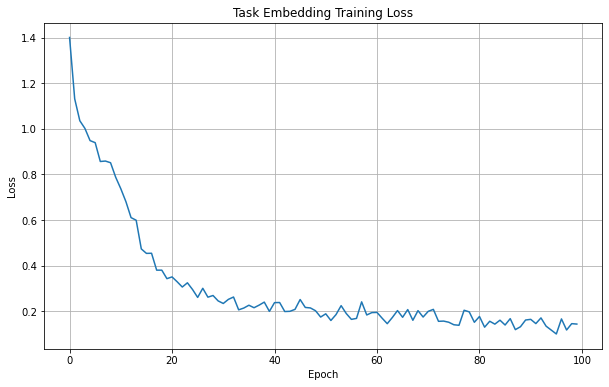

<Figure size 432x288 with 0 Axes>

In [13]:
import matplotlib.pyplot as plt

# Create and train the model
model = TaskEmbeddingModel(input_dim=40, hidden_dim=128, embedding_dim=128)
losses = model.train_model(dataset, epochs=100, batch_size=32)

# Save the trained model

torch.save(model.state_dict(), "task_embedding_model.pt")

# Plot training loss
plt.figure(figsize=(10, 6))
plt.plot(losses)
plt.title("Task Embedding Training Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.show()
plt.savefig("task_embedding_loss.png")

In [7]:
def initialize_mcu_with_task_embedding_model(embedding_model, reasoning_modules_list):
    """Initialize MCU with a pretrained TaskEmbeddingModel"""
    # Convert the list of reasoning modules to a dictionary
    reasoning_modules_dict = {}
    for module in reasoning_modules_list:
        # Use the class name as the key
        module_name = module.__class__.__name__.replace("ReasoningModule", "")
        reasoning_modules_dict[module_name] = module
    
    # Create new MCU system
    proto_mcu = ProtoMetaReasoningSystem(
        reasoning_modules=reasoning_modules_dict,
        config={
            "embedding_dim": 128,
            "num_prototypes": 15,
            "state_size": 30,
            "blackboard_feature_size": 10
        }
    )
    
    # If embedding_model is provided, replace the MCU's embedding network
    if embedding_model is not None:
        proto_mcu.embedding_network = embedding_model
    
    return proto_mcu

def initialize_prototypes(proto_mcu, diverse_tasks):
    """Initialize prototypes with diverse tasks"""
    # Need at least a few tasks
    if len(diverse_tasks) < 5:
        print("Not enough tasks for prototype initialization")
        return
    
    print(f"Initializing prototypes with {len(diverse_tasks)} tasks")
    
    # Create embeddings for diverse tasks
    task_embeddings = []
    task_ids = []
    
    for task in diverse_tasks:
        # Extract features
        features_array = extract_task_features(task)
        
        # Make sure features is a tensor on the correct device
        features = torch.tensor(features_array, dtype=torch.float32).to(proto_mcu.device)
        
        with torch.no_grad():
            # First make sure the embedding network is on the correct device
            proto_mcu.embedding_network = proto_mcu.embedding_network.to(proto_mcu.device)
            
            # Get embedding
            embedding = proto_mcu.embedding_network(features.unsqueeze(0))
            task_embeddings.append(embedding)
            task_ids.append(task.task_id)
    
    # Stack embeddings
    if task_embeddings:
        # Make sure all embeddings are on the same device
        embeddings_tensor = torch.cat(task_embeddings, dim=0)
        
        # Initialize prototypes with selected task embeddings
        with torch.no_grad():
            # Ensure proto networks are on the correct device
            proto_mcu.proto_policy_net = proto_mcu.proto_policy_net.to(proto_mcu.device)
            proto_mcu.proto_target_net = proto_mcu.proto_target_net.to(proto_mcu.device)
            
            # Select random subset for initial prototypes
            indices = torch.randperm(embeddings_tensor.size(0))[:min(proto_mcu.config["num_prototypes"], embeddings_tensor.size(0))]
            
            # Update prototype vectors
            for i, idx in enumerate(indices):
                if i < proto_mcu.proto_policy_net.prototypes.size(0):
                    proto_mcu.proto_policy_net.prototypes.data[i] = embeddings_tensor[idx]
            
            # Normalize prototypes
            proto_mcu.proto_policy_net.prototypes.data = torch.nn.functional.normalize(
                proto_mcu.proto_policy_net.prototypes.data, p=2, dim=1
            )
            
            # Copy to target network
            proto_mcu.proto_target_net.load_state_dict(proto_mcu.proto_policy_net.state_dict())
    
    print("Prototypes initialized successfully")

def train_mcu(proto_mcu, training_tasks, num_iterations=100):
    # Create output directories
    os.makedirs("output/models/mcu", exist_ok=True)
    os.makedirs("output/models/mcu/visualizations", exist_ok=True)
    
    # Initial exploration rate
    proto_mcu.epsilon = 1.0  # Start with high exploration
    
    # Training history
    history = {
        "iterations": [],
        "node_accuracy": [],
        "grid_accuracy": [],
        "epsilon": []
    }
    
    # Train the MCU
    for iteration in tqdm(range(num_iterations), desc="Training MCU"):
        # Sample a batch of tasks
        batch_size = min(10, len(training_tasks))
        batch_tasks = random.sample(training_tasks, batch_size)
        
        batch_node_accuracy = 0.0
        batch_grid_accuracy = 0.0
        for task in batch_tasks:
            # Solve with the current policy
            predictions = proto_mcu.solve_task(task, training=True)
            
            # Track both accuracies
            node_accuracy, grid_accuracy = proto_mcu.evaluate_predictions(predictions, task)
            batch_node_accuracy += node_accuracy
            batch_grid_accuracy += grid_accuracy
        
        # Calculate average accuracies
        avg_node_accuracy = batch_node_accuracy / batch_size
        avg_grid_accuracy = batch_grid_accuracy / batch_size
        
        # Log progress
        print(f"Iteration {iteration+1}/{num_iterations}, Cell Accuracy: {avg_node_accuracy:.4f}, Grid Accuracy: {avg_grid_accuracy:.4f}, Epsilon: {proto_mcu.epsilon:.4f}")
        
        # Record history
        history["iterations"].append(iteration+1)
        history["node_accuracy"].append(avg_node_accuracy)
        history["grid_accuracy"].append(avg_grid_accuracy)
        history["epsilon"].append(proto_mcu.epsilon)
        
        # Decay epsilon (exploration rate)
        proto_mcu.epsilon = max(0.05, proto_mcu.epsilon * 0.995)
        
        # Update prototypes every 10 iterations
        if iteration % 10 == 0:
            proto_mcu.update_prototypes_from_memory()
        
        # Save checkpoint periodically
        if iteration % 5 == 0:
            proto_mcu.save_model(f"output/models/proto_mcu_iter_{iteration+1}.pt")
            
            # Visualize prototypes
            proto_mcu.visualize_prototypes(f"output/visualizations/prototypes_iter_{iteration+1}.png")
            
            # Plot training progress
            plt.figure(figsize=(12, 5))
            
            # Plot both accuracies in the same subplot
            plt.subplot(1, 2, 1)
            plt.plot(history["iterations"], history["node_accuracy"], label="Cell Accuracy", color="blue")
            plt.plot(history["iterations"], history["grid_accuracy"], label="Grid Accuracy", color="green", linestyle="--")
            plt.title("Training Accuracy")
            plt.xlabel("Iteration")
            plt.ylabel("Accuracy")
            plt.legend()
            plt.grid(True)
            
            plt.subplot(1, 2, 2)
            plt.plot(history["iterations"], history["epsilon"])
            plt.title("Exploration Rate (Epsilon)")
            plt.xlabel("Iteration")
            plt.ylabel("Epsilon")
            plt.grid(True)
            
            plt.tight_layout()
            plt.savefig(f"output/visualizations/training_progress_iter_{iteration+1}.png")
            plt.close()
    
    # Final save
    proto_mcu.save_model("output/models/mcu/proto_mcu_final.pt")
    
    # Final plot
    plt.figure(figsize=(12, 5))
            
    # Plot both accuracies in the same subplot
    plt.subplot(1, 2, 1)
    plt.plot(history["iterations"], history["node_accuracy"], label="Cell Accuracy", color="blue")
    plt.plot(history["iterations"], history["grid_accuracy"], label="Grid Accuracy", color="green", linestyle="--")
    plt.title("Training Accuracy")
    plt.xlabel("Iteration")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.grid(True)
    
    plt.subplot(1, 2, 2)
    plt.plot(history["iterations"], history["epsilon"])
    plt.title("Exploration Rate (Epsilon)")
    plt.xlabel("Iteration")
    plt.ylabel("Epsilon")
    plt.grid(True)
    
    plt.tight_layout()
    plt.savefig("output/models/mcu/visualizations/training_progress_final.png")
    plt.close()
    
    return proto_mcu, history

def test_mcu(proto_mcu, test_tasks):
    """Test MCU on test tasks"""
    total_node_accuracy = 0.0
    total_grid_accuracy = 0.0
    results = []
    
    # Create output directories if they don't exist
    os.makedirs("output/models/mcu", exist_ok=True)
    os.makedirs("output/models/mcu/visualizations", exist_ok=True)
    os.makedirs("output/models/mcu/task_examples", exist_ok=True)
    
    for i, task in enumerate(test_tasks):
        # Use learned policy to select modules
        predictions = proto_mcu.solve_task(task, training=False)
        
        # Evaluate predictions
        node_accuracy, grid_accuracy = proto_mcu.evaluate_predictions(predictions, task)
        total_node_accuracy += node_accuracy
        total_grid_accuracy += grid_accuracy
        
        # Get module sequence
        module_sequence = proto_mcu.get_best_module_sequence(task)
        sequence_str = " → ".join(module_sequence)
        
        # Print results
        if grid_accuracy > 0:
            print(f"Task {task.task_id}: Cell Accuracy={node_accuracy:.4f}, Grid Accuracy={grid_accuracy:.4f}, Modules={sequence_str}")

            # Calculate figure size based on number of test pairs
            rows = len(task.test_pairs)
            plt.figure(figsize=(15, 5 * rows))
            
            # Basic grid visualization function that properly handles dimensions
            def visualize_grid(grid, ax, title):
                if grid is None:
                    ax.text(0.5, 0.5, 'Grid data unavailable', 
                           horizontalalignment='center', verticalalignment='center')
                    return
                
                # Handle different grid formats
                if isinstance(grid, list):
                    grid = np.array(grid)
                
                # Remove batch dimension if present (shape like [1, H, W])
                if len(grid.shape) == 3 and grid.shape[0] == 1:
                    grid = grid[0]
                
                # Display the grid
                im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
                ax.set_title(title)
                # Add grid lines
                ax.grid(False)
                ax.set_xticks(np.arange(-.5, grid.shape[1], 1), minor=True)
                ax.set_yticks(np.arange(-.5, grid.shape[0], 1), minor=True)
                ax.grid(which="minor", color="w", linestyle='-', linewidth=1)
                return im
            
            # Create a subplot for each test pair
            for row, (input_grid, output_grid) in enumerate(task.test_pairs):
                # Input grid
                ax1 = plt.subplot(rows, 3, row*3 + 1)
                im1 = visualize_grid(input_grid, ax1, f"Input {row+1}")
                
                # Ground truth
                ax2 = plt.subplot(rows, 3, row*3 + 2)
                im2 = visualize_grid(output_grid, ax2, f"Ground Truth {row+1}")
                
                # Prediction
                ax3 = plt.subplot(rows, 3, row*3 + 3)
                # For multiple test pairs, we need to get the corresponding prediction
                # This assumes predictions has the same structure as test_pairs
                pred = predictions[row] if isinstance(predictions, list) else predictions
                im3 = visualize_grid(pred, ax3, f"Prediction {row+1}")
            
            plt.suptitle(f"Task {task.task_id} - Module Sequence: {sequence_str}")
            plt.tight_layout()
            plt.savefig(f"output/models/mcu/task_examples/task_{task.task_id}_result.png", dpi=150)
            plt.close()
        
        # Store result
        results.append({
            "task_id": task.task_id,
            "node_accuracy": node_accuracy,
            "grid_accuracy": grid_accuracy,
            "module_sequence": module_sequence
        })
    
    avg_node_accuracy = total_node_accuracy / len(test_tasks)
    avg_grid_accuracy = total_grid_accuracy / len(test_tasks)
    print(f"Overall test results: Cell Accuracy={avg_node_accuracy:.4f}, Grid Accuracy={avg_grid_accuracy:.4f}")
    
    # Save test results
    with open("output/models/mcu/test_results.json", "w") as f:
        json.dump({
            "average_node_accuracy": avg_node_accuracy,
            "average_grid_accuracy": avg_grid_accuracy,
            "task_results": results,
            "timestamp": datetime.datetime.now().isoformat(),
            "model_config": {
                "name": proto_mcu.name if hasattr(proto_mcu, "name") else "Unknown",
                "num_modules": len(proto_mcu.modules) if hasattr(proto_mcu, "modules") else "Unknown",
                "max_seq_length": proto_mcu.max_sequence_length if hasattr(proto_mcu, "max_sequence_length") else "Unknown"
            }
        }, f, indent=2)
    
    # Create visualization of test results
    plt.figure(figsize=(15, 10))
    
    # Sort tasks by grid accuracy for better visualization
    sorted_results = sorted(results, key=lambda x: x["grid_accuracy"])
    task_ids = [r["task_id"] for r in sorted_results]
    node_accuracies = [r["node_accuracy"] for r in sorted_results]
    grid_accuracies = [r["grid_accuracy"] for r in sorted_results]
    
    # Bar chart of all task accuracies
    plt.subplot(2, 2, 1)
    x = np.arange(len(task_ids))
    width = 0.35
    plt.bar(x - width/2, node_accuracies, width, label='Cell Accuracy', color='blue', alpha=0.7)
    plt.bar(x + width/2, grid_accuracies, width, label='Grid Accuracy', color='green', alpha=0.7)
    plt.axhline(y=avg_node_accuracy, color='blue', linestyle='--', label=f'Avg Cell: {avg_node_accuracy:.3f}')
    plt.axhline(y=avg_grid_accuracy, color='green', linestyle='--', label=f'Avg Grid: {avg_grid_accuracy:.3f}')
    plt.xlabel('Tasks')
    plt.ylabel('Accuracy')
    plt.title('Test Results by Task')
    plt.legend()
    plt.xticks([])  # Hide task IDs as there might be too many
    
    # Histogram of accuracies
    plt.subplot(2, 2, 2)
    plt.hist([node_accuracies, grid_accuracies], bins=10, 
             label=['Cell Accuracy', 'Grid Accuracy'], color=['blue', 'green'],
             alpha=0.7, edgecolor='black')
    plt.axvline(x=avg_node_accuracy, color='blue', linestyle='--', label=f'Avg Cell: {avg_node_accuracy:.3f}')
    plt.axvline(x=avg_grid_accuracy, color='green', linestyle='--', label=f'Avg Grid: {avg_grid_accuracy:.3f}')
    plt.xlabel('Accuracy')
    plt.ylabel('Number of Tasks')
    plt.title('Distribution of Accuracies')
    plt.legend()
    
    # Module usage chart - show how often each module is used
    plt.subplot(2, 2, 3)
    module_counts = {}
    for r in results:
        for module in r["module_sequence"]:
            if module in module_counts:
                module_counts[module] += 1
            else:
                module_counts[module] = 1
    
    modules = list(module_counts.keys())
    counts = list(module_counts.values())
    # Sort by frequency for better visualization
    sorted_indices = np.argsort(counts)[::-1]
    modules = [modules[i] for i in sorted_indices]
    counts = [counts[i] for i in sorted_indices]
    
    plt.bar(modules, counts, color='purple', alpha=0.7)
    plt.xlabel('Module')
    plt.ylabel('Times Used')
    plt.title('Module Usage Frequency')
    plt.xticks(rotation=45, ha='right')
    
    # Scatterplot of node vs grid accuracy
    plt.subplot(2, 2, 4)
    plt.scatter(node_accuracies, grid_accuracies, alpha=0.7, c=range(len(task_ids)), cmap='viridis')
    plt.xlabel('Cell Accuracy')
    plt.ylabel('Grid Accuracy')
    plt.title('Cell vs Grid Accuracy')
    plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.savefig("output/models/mcu/visualizations/mcu_test_results.png", dpi=200)
    plt.close()
    
    # Save module sequence heatmap
    if len(results) > 1 and len(module_counts) > 1:  # Only create if we have multiple tasks and modules
        plt.figure(figsize=(12, 8))
        
        # Create matrix of module usage by task
        all_modules = list(module_counts.keys())
        all_modules.sort()
        
        task_module_matrix = np.zeros((len(results), len(all_modules)))
        for i, r in enumerate(results):
            for module in r["module_sequence"]:
                j = all_modules.index(module)
                task_module_matrix[i, j] = 1
        
        # Sort tasks by similarity for better visualization
        try:
            from scipy.cluster import hierarchy
            from scipy.spatial.distance import pdist
            
            # Only cluster if we have enough data
            if len(task_module_matrix) > 3:
                row_linkage = hierarchy.linkage(pdist(task_module_matrix))
                row_order = hierarchy.leaves_list(row_linkage)
                task_module_matrix = task_module_matrix[row_order, :]
                sorted_task_ids = [results[i]["task_id"] for i in row_order]
            else:
                sorted_task_ids = [r["task_id"] for r in results]
        except Exception as e:
            print(f"Warning: Could not cluster tasks: {str(e)}")
            sorted_task_ids = [r["task_id"] for r in results]
        
        plt.imshow(task_module_matrix, cmap='Blues', aspect='auto')
        plt.colorbar(label='Module Used (1) or Not (0)')
        plt.yticks(range(len(sorted_task_ids)), sorted_task_ids)
        plt.xticks(range(len(all_modules)), all_modules, rotation=90)
        plt.xlabel('Modules')
        plt.ylabel('Tasks')
        plt.title('Module Usage by Task')
        plt.tight_layout()
        plt.savefig("output/models/mcu/visualizations/module_usage_heatmap.png", dpi=200)
        plt.close()
    
    return (avg_node_accuracy, avg_grid_accuracy), results

def select_diverse_tasks(tasks, n=50, seed=42):
    """
    Select a diverse subset of tasks using a simple heuristic approach.
    
    Args:
        tasks: List of task objects
        n: Number of tasks to select
        seed: Random seed for reproducibility
        
    Returns:
        List of selected tasks
    """
    import random
    import numpy as np
    
    random.seed(seed)
    
    if len(tasks) <= n:
        return tasks
    
    # If there's an extract_features method, use it
    if hasattr(tasks[0], 'extract_features'):
        # Collect features for all tasks
        features = []
        for task in tasks:
            task_features = task.extract_features()
            if isinstance(task_features, torch.Tensor):
                task_features = task_features.cpu().numpy()
            features.append(task_features.flatten())
        
        # Select diverse tasks using furthest point sampling
        selected_indices = [random.randrange(len(tasks))]  # Start with a random task
        selected_features = [features[selected_indices[0]]]
        
        while len(selected_indices) < n:
            # Find the task that's furthest from all selected tasks
            max_dist = -1
            max_idx = -1
            
            for i in range(len(tasks)):
                if i in selected_indices:
                    continue
                
                # Compute minimum distance to any selected task
                min_dist = float('inf')
                for feat in selected_features:
                    dist = np.linalg.norm(features[i] - feat)
                    min_dist = min(min_dist, dist)
                
                if min_dist > max_dist:
                    max_dist = min_dist
                    max_idx = i
            
            selected_indices.append(max_idx)
            selected_features.append(features[max_idx])
        
        return [tasks[i] for i in selected_indices]
    
    # If no feature extraction is available, just randomly sample
    else:
        return random.sample(tasks, n)

Model state loaded from output/models/nlm/nlm_reasoning_module_final.pt
Model state loaded from output/models/unified/unified_reasoning_model_final.pt
Loading precomputed tasks from precomputed_tasks/training_400


Loading tasks from precomputed_tasks/training_400: 100%|██████████| 400/400 [00:02<00:00, 148.45it/s]
/tmp/ipykernel_904743/3040790984.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  features = torch.tensor(features_array, dtype=torch.float32).to(proto_mcu.device)


Loaded 400 precomputed tasks
Initializing prototypes with 400 tasks
Prototypes initialized successfully


Training MCU:   0%|          | 0/500 [00:00<?, ?it/s]

Iteration 1/500, Cell Accuracy: 0.4013, Grid Accuracy: 0.0000, Epsilon: 0.9511
Model saved to output/models/proto_mcu_iter_1.pt


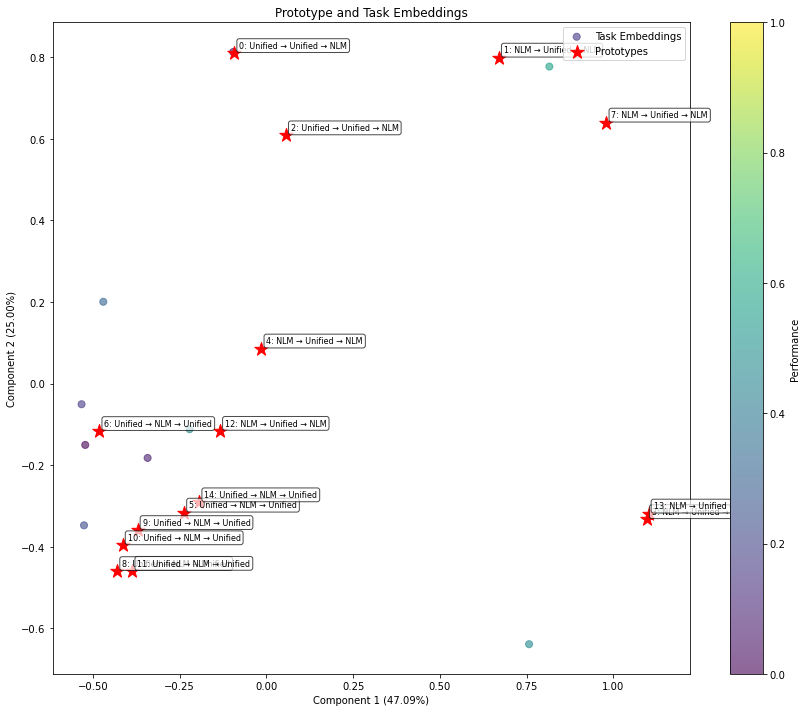

Training MCU:   0%|          | 2/500 [00:13<50:10,  6.05s/it]  

Iteration 2/500, Cell Accuracy: 0.3182, Grid Accuracy: 0.0000, Epsilon: 0.9001


Training MCU:   1%|          | 3/500 [00:22<1:00:23,  7.29s/it]

Iteration 3/500, Cell Accuracy: 0.5313, Grid Accuracy: 0.0000, Epsilon: 0.8518


Training MCU:   1%|          | 4/500 [00:31<1:08:11,  8.25s/it]

Iteration 4/500, Cell Accuracy: 0.5767, Grid Accuracy: 0.0000, Epsilon: 0.8061


Training MCU:   1%|          | 5/500 [00:34<52:01,  6.31s/it]  

Iteration 5/500, Cell Accuracy: 0.2601, Grid Accuracy: 0.0000, Epsilon: 0.7629
Iteration 6/500, Cell Accuracy: 0.5411, Grid Accuracy: 0.1000, Epsilon: 0.7219
Model saved to output/models/proto_mcu_iter_6.pt


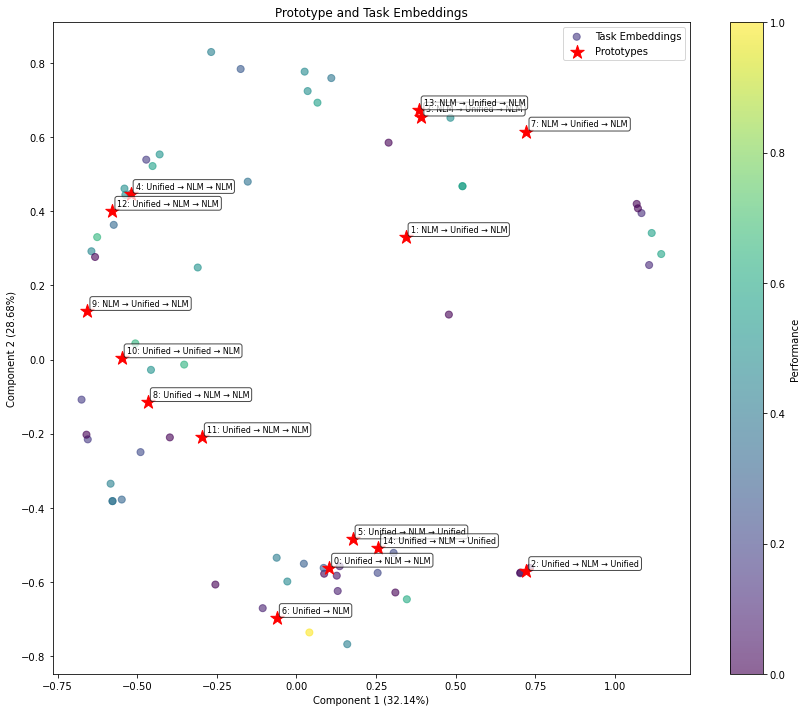

Training MCU:   1%|▏         | 7/500 [00:43<43:18,  5.27s/it]

Iteration 7/500, Cell Accuracy: 0.4518, Grid Accuracy: 0.0000, Epsilon: 0.6832


Training MCU:   2%|▏         | 8/500 [00:45<36:00,  4.39s/it]

Iteration 8/500, Cell Accuracy: 0.4253, Grid Accuracy: 0.0000, Epsilon: 0.6466


Training MCU:   2%|▏         | 9/500 [00:55<50:11,  6.13s/it]

Iteration 9/500, Cell Accuracy: 0.4157, Grid Accuracy: 0.0000, Epsilon: 0.6119


Training MCU:   2%|▏         | 10/500 [01:08<1:06:44,  8.17s/it]

Iteration 10/500, Cell Accuracy: 0.3415, Grid Accuracy: 0.0000, Epsilon: 0.5790
Iteration 11/500, Cell Accuracy: 0.4935, Grid Accuracy: 0.0000, Epsilon: 0.5480
Model saved to output/models/proto_mcu_iter_11.pt


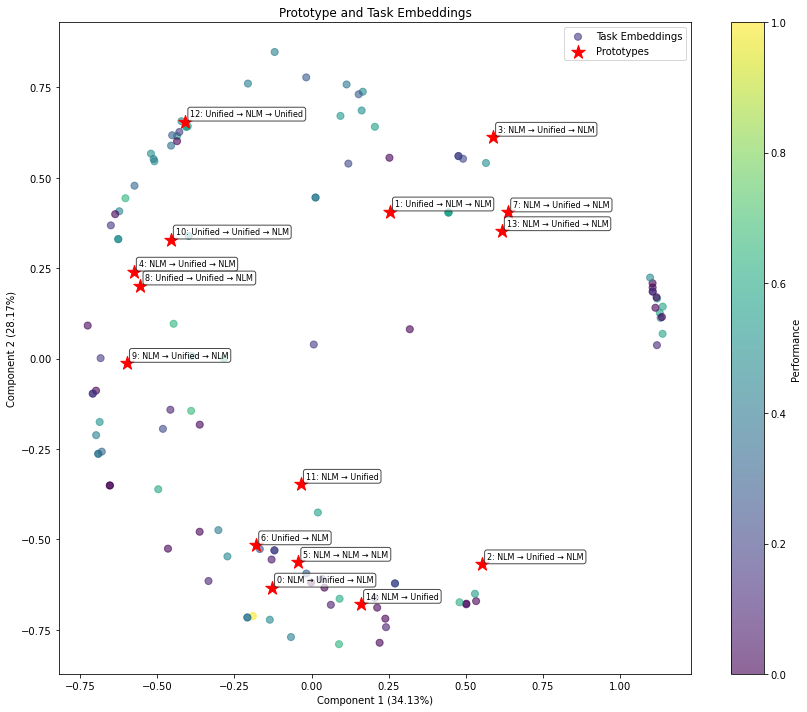

Training MCU:   2%|▏         | 12/500 [01:32<1:19:28,  9.77s/it]

Iteration 12/500, Cell Accuracy: 0.3450, Grid Accuracy: 0.0000, Epsilon: 0.5186


Training MCU:   3%|▎         | 13/500 [01:35<1:02:01,  7.64s/it]

Iteration 13/500, Cell Accuracy: 0.3337, Grid Accuracy: 0.0000, Epsilon: 0.4908


Training MCU:   3%|▎         | 14/500 [01:46<1:11:22,  8.81s/it]

Iteration 14/500, Cell Accuracy: 0.5087, Grid Accuracy: 0.0000, Epsilon: 0.4644


Training MCU:   3%|▎         | 15/500 [01:50<58:44,  7.27s/it]  

Iteration 15/500, Cell Accuracy: 0.5854, Grid Accuracy: 0.0000, Epsilon: 0.4395
Iteration 16/500, Cell Accuracy: 0.4010, Grid Accuracy: 0.0000, Epsilon: 0.4159
Model saved to output/models/proto_mcu_iter_16.pt


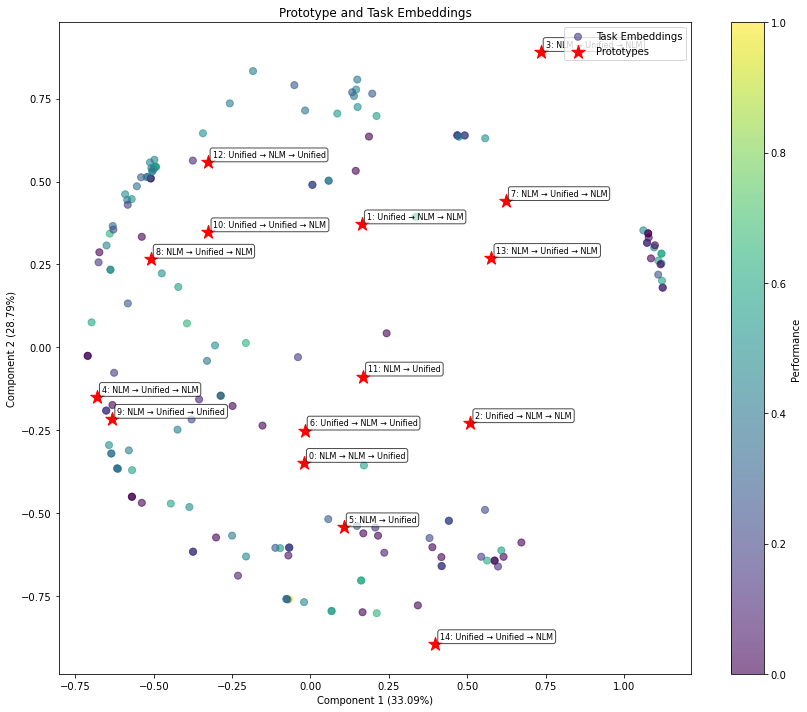

Training MCU:   3%|▎         | 17/500 [02:05<1:01:46,  7.67s/it]

Iteration 17/500, Cell Accuracy: 0.3294, Grid Accuracy: 0.0000, Epsilon: 0.3936


Training MCU:   4%|▎         | 18/500 [02:15<1:07:50,  8.44s/it]

Iteration 18/500, Cell Accuracy: 0.2725, Grid Accuracy: 0.0000, Epsilon: 0.3725


Training MCU:   4%|▍         | 19/500 [02:21<1:00:22,  7.53s/it]

Iteration 19/500, Cell Accuracy: 0.4620, Grid Accuracy: 0.0000, Epsilon: 0.3525


Training MCU:   4%|▍         | 20/500 [02:42<1:34:30, 11.81s/it]

Iteration 20/500, Cell Accuracy: 0.4502, Grid Accuracy: 0.0000, Epsilon: 0.3336
Iteration 21/500, Cell Accuracy: 0.4507, Grid Accuracy: 0.0000, Epsilon: 0.3157
Model saved to output/models/proto_mcu_iter_21.pt


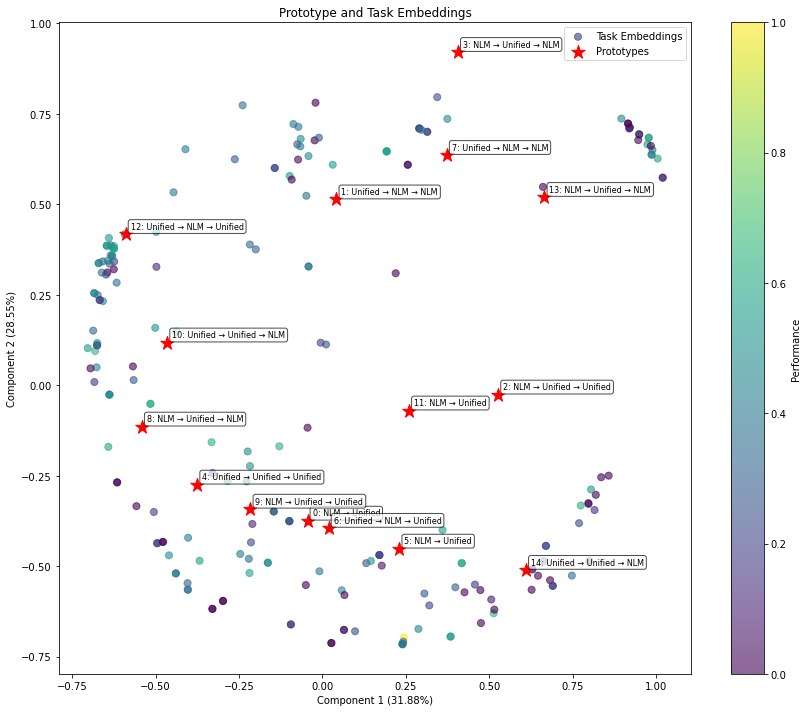

Training MCU:   4%|▍         | 22/500 [02:56<1:14:35,  9.36s/it]

Iteration 22/500, Cell Accuracy: 0.4601, Grid Accuracy: 0.0000, Epsilon: 0.2988


Training MCU:   5%|▍         | 23/500 [03:12<1:28:56, 11.19s/it]

Iteration 23/500, Cell Accuracy: 0.3946, Grid Accuracy: 0.0000, Epsilon: 0.2828


Training MCU:   5%|▍         | 24/500 [03:16<1:12:25,  9.13s/it]

Iteration 24/500, Cell Accuracy: 0.4353, Grid Accuracy: 0.0000, Epsilon: 0.2676


Training MCU:   5%|▌         | 25/500 [03:21<1:03:04,  7.97s/it]

Iteration 25/500, Cell Accuracy: 0.3831, Grid Accuracy: 0.0000, Epsilon: 0.2532
Iteration 26/500, Cell Accuracy: 0.5897, Grid Accuracy: 0.0000, Epsilon: 0.2397
Model saved to output/models/proto_mcu_iter_26.pt


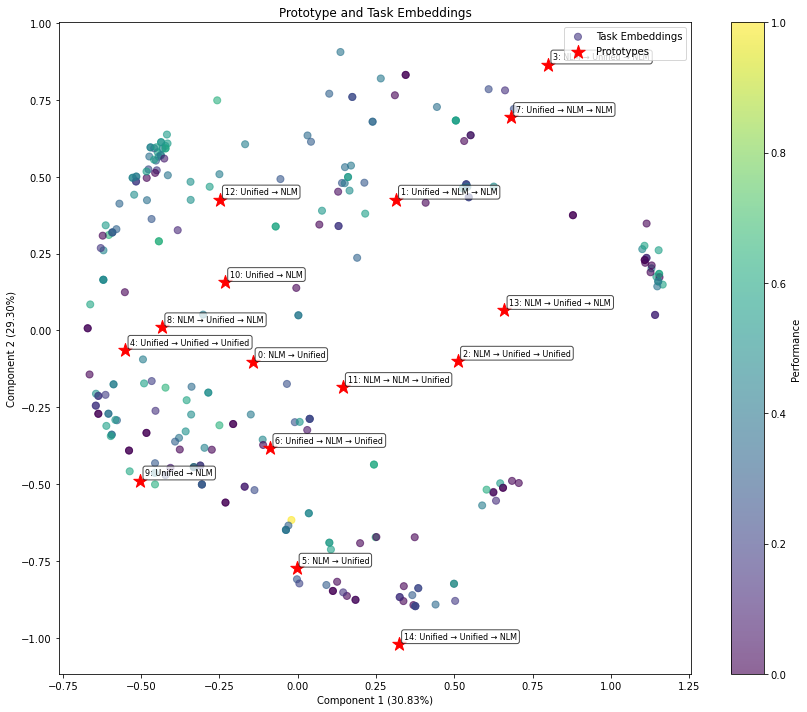

Training MCU:   5%|▌         | 27/500 [03:33<54:08,  6.87s/it]  

Iteration 27/500, Cell Accuracy: 0.4405, Grid Accuracy: 0.0000, Epsilon: 0.2268


Training MCU:   6%|▌         | 28/500 [03:39<52:16,  6.65s/it]

Iteration 28/500, Cell Accuracy: 0.4541, Grid Accuracy: 0.0000, Epsilon: 0.2146


Training MCU:   6%|▌         | 29/500 [03:48<57:54,  7.38s/it]

Iteration 29/500, Cell Accuracy: 0.3859, Grid Accuracy: 0.0000, Epsilon: 0.2031


Training MCU:   6%|▌         | 30/500 [03:52<50:27,  6.44s/it]

Iteration 30/500, Cell Accuracy: 0.4029, Grid Accuracy: 0.0000, Epsilon: 0.1922
Iteration 31/500, Cell Accuracy: 0.5277, Grid Accuracy: 0.0000, Epsilon: 0.1819
Model saved to output/models/proto_mcu_iter_31.pt


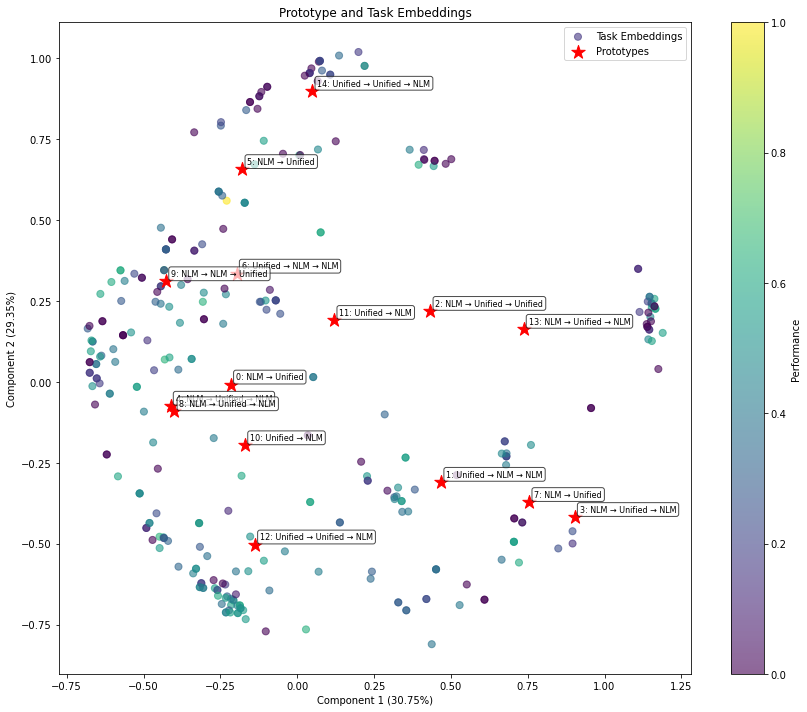

Training MCU:   6%|▋         | 32/500 [04:26<1:27:15, 11.19s/it]

Iteration 32/500, Cell Accuracy: 0.4485, Grid Accuracy: 0.0000, Epsilon: 0.1721


Training MCU:   7%|▋         | 33/500 [04:39<1:32:37, 11.90s/it]

Iteration 33/500, Cell Accuracy: 0.3813, Grid Accuracy: 0.0000, Epsilon: 0.1629


Training MCU:   7%|▋         | 34/500 [04:47<1:23:20, 10.73s/it]

Iteration 34/500, Cell Accuracy: 0.4447, Grid Accuracy: 0.0000, Epsilon: 0.1542


Training MCU:   7%|▋         | 35/500 [04:54<1:12:29,  9.35s/it]

Iteration 35/500, Cell Accuracy: 0.3549, Grid Accuracy: 0.0000, Epsilon: 0.1459
Iteration 36/500, Cell Accuracy: 0.3652, Grid Accuracy: 0.0000, Epsilon: 0.1381
Model saved to output/models/proto_mcu_iter_36.pt


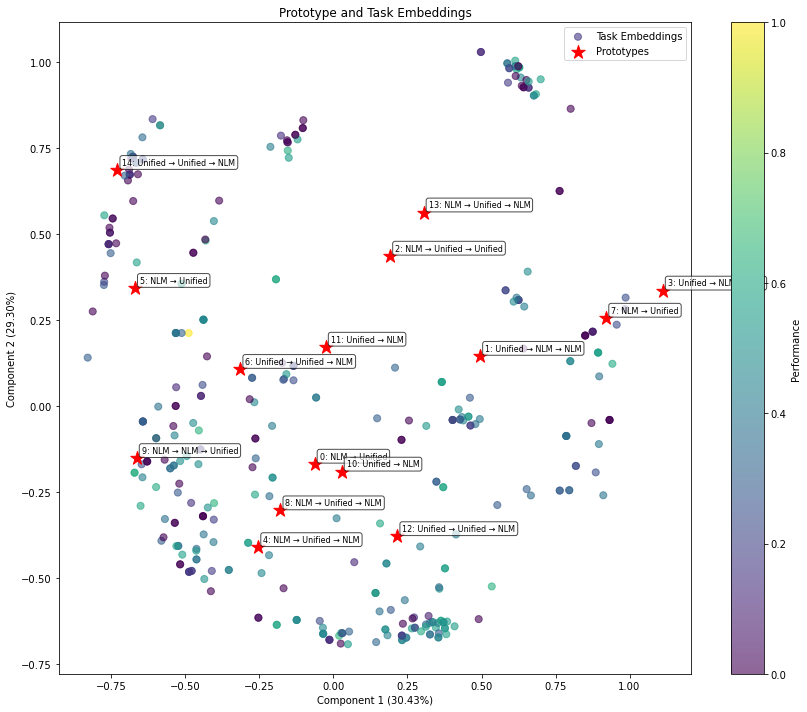

Training MCU:   7%|▋         | 37/500 [05:04<54:56,  7.12s/it]  

Iteration 37/500, Cell Accuracy: 0.6283, Grid Accuracy: 0.0000, Epsilon: 0.1307


Training MCU:   8%|▊         | 38/500 [05:18<1:11:50,  9.33s/it]

Iteration 38/500, Cell Accuracy: 0.4793, Grid Accuracy: 0.1000, Epsilon: 0.1237


Training MCU:   8%|▊         | 39/500 [05:26<1:07:38,  8.80s/it]

Iteration 39/500, Cell Accuracy: 0.4774, Grid Accuracy: 0.0500, Epsilon: 0.1170


Training MCU:   8%|▊         | 40/500 [05:40<1:18:56, 10.30s/it]

Iteration 40/500, Cell Accuracy: 0.3878, Grid Accuracy: 0.0000, Epsilon: 0.1107
Iteration 41/500, Cell Accuracy: 0.5504, Grid Accuracy: 0.0000, Epsilon: 0.1048
Model saved to output/models/proto_mcu_iter_41.pt


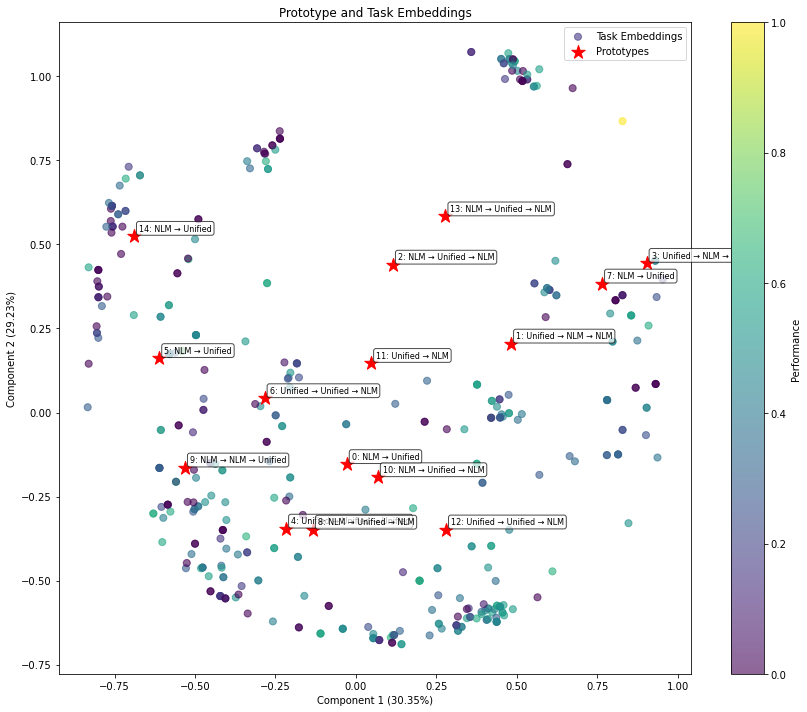

Training MCU:   8%|▊         | 42/500 [05:49<56:30,  7.40s/it]  

Iteration 42/500, Cell Accuracy: 0.5012, Grid Accuracy: 0.1000, Epsilon: 0.0992


Training MCU:   9%|▊         | 43/500 [06:06<1:17:08, 10.13s/it]

Iteration 43/500, Cell Accuracy: 0.2873, Grid Accuracy: 0.0000, Epsilon: 0.0939


Training MCU:   9%|▉         | 44/500 [06:08<58:39,  7.72s/it]  

Iteration 44/500, Cell Accuracy: 0.4592, Grid Accuracy: 0.0500, Epsilon: 0.0888


Training MCU:   9%|▉         | 45/500 [06:11<48:16,  6.37s/it]

Iteration 45/500, Cell Accuracy: 0.3640, Grid Accuracy: 0.0000, Epsilon: 0.0841
Iteration 46/500, Cell Accuracy: 0.2977, Grid Accuracy: 0.0000, Epsilon: 0.0796
Model saved to output/models/proto_mcu_iter_46.pt


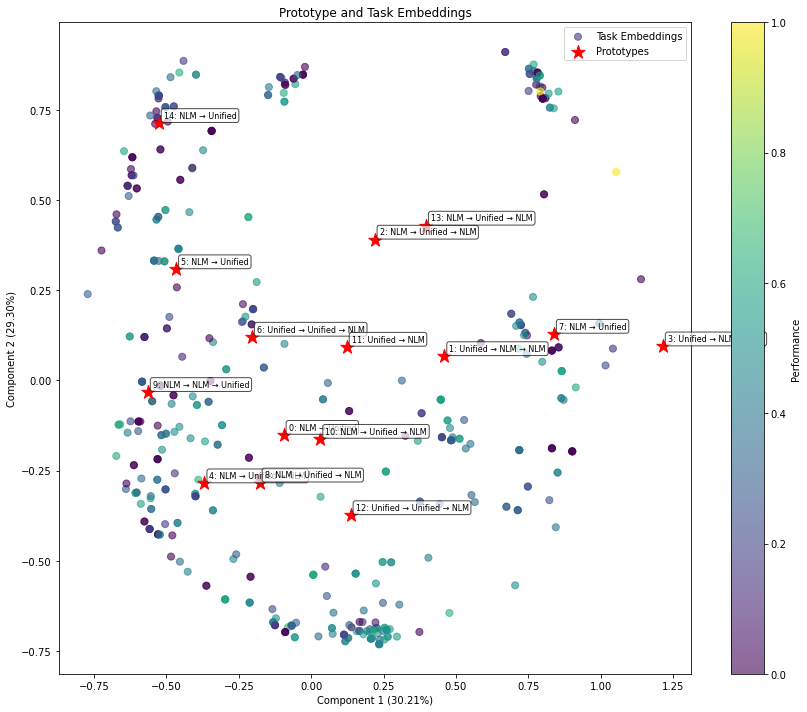

Training MCU:   9%|▉         | 47/500 [06:18<37:20,  4.95s/it]

Iteration 47/500, Cell Accuracy: 0.5742, Grid Accuracy: 0.0000, Epsilon: 0.0753


Training MCU:  10%|▉         | 48/500 [06:26<45:10,  6.00s/it]

Iteration 48/500, Cell Accuracy: 0.4521, Grid Accuracy: 0.0000, Epsilon: 0.0712


Training MCU:  10%|▉         | 49/500 [06:28<35:43,  4.75s/it]

Iteration 49/500, Cell Accuracy: 0.6522, Grid Accuracy: 0.1000, Epsilon: 0.0674


Training MCU:  10%|█         | 50/500 [06:32<32:57,  4.40s/it]

Iteration 50/500, Cell Accuracy: 0.3751, Grid Accuracy: 0.0000, Epsilon: 0.0638
Iteration 51/500, Cell Accuracy: 0.3786, Grid Accuracy: 0.0000, Epsilon: 0.0604
Model saved to output/models/proto_mcu_iter_51.pt


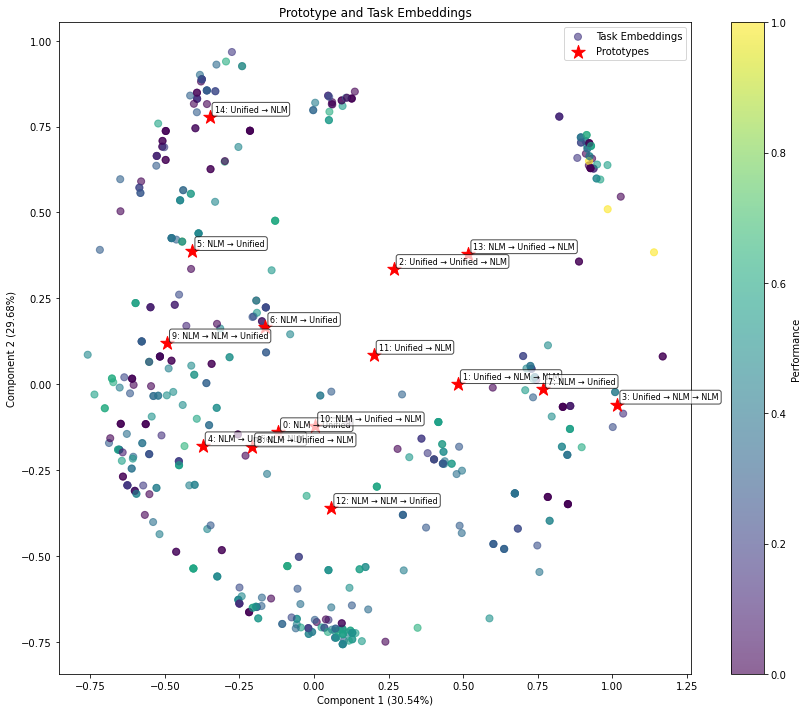

Training MCU:  10%|█         | 52/500 [07:08<1:33:40, 12.55s/it]

Iteration 52/500, Cell Accuracy: 0.1920, Grid Accuracy: 0.0000, Epsilon: 0.0571


Training MCU:  11%|█         | 53/500 [07:09<1:08:47,  9.23s/it]

Iteration 53/500, Cell Accuracy: 0.6535, Grid Accuracy: 0.0000, Epsilon: 0.0541


Training MCU:  11%|█         | 54/500 [07:10<50:32,  6.80s/it]  

Iteration 54/500, Cell Accuracy: 0.6106, Grid Accuracy: 0.0000, Epsilon: 0.0512


Training MCU:  11%|█         | 55/500 [07:18<51:55,  7.00s/it]

Iteration 55/500, Cell Accuracy: 0.4114, Grid Accuracy: 0.0000, Epsilon: 0.0484
Iteration 56/500, Cell Accuracy: 0.3403, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_56.pt


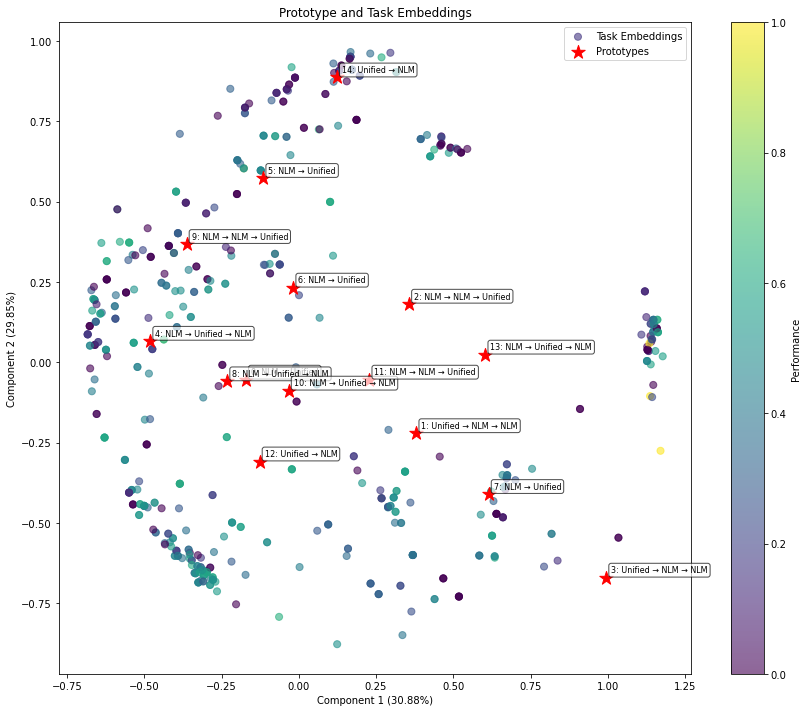

Training MCU:  11%|█▏        | 57/500 [07:24<37:50,  5.13s/it]

Iteration 57/500, Cell Accuracy: 0.3729, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  12%|█▏        | 58/500 [07:33<44:49,  6.08s/it]

Iteration 58/500, Cell Accuracy: 0.3554, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  12%|█▏        | 59/500 [07:44<55:29,  7.55s/it]

Iteration 59/500, Cell Accuracy: 0.5419, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  12%|█▏        | 60/500 [07:47<46:26,  6.33s/it]

Iteration 60/500, Cell Accuracy: 0.5175, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 61/500, Cell Accuracy: 0.2486, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_61.pt


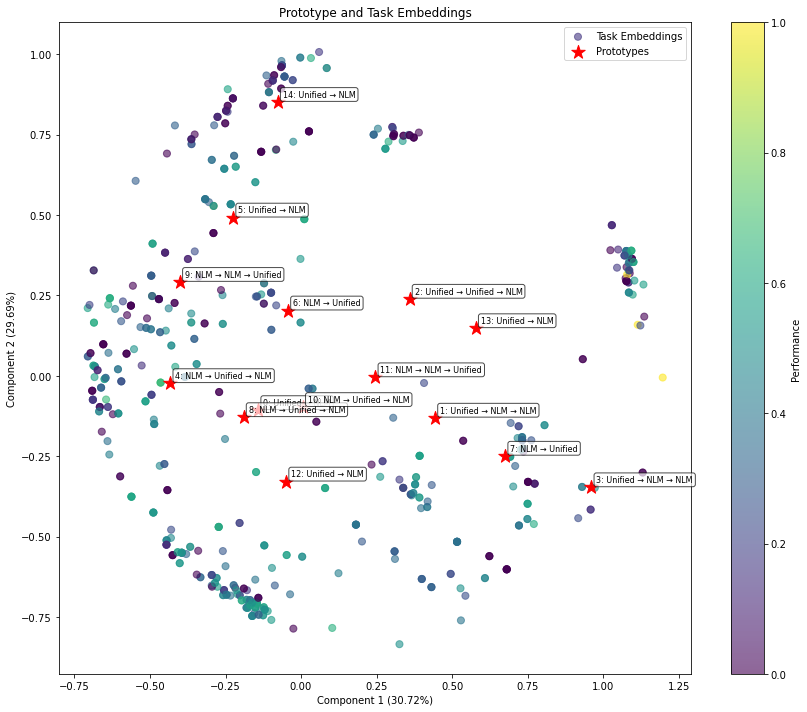

Training MCU:  12%|█▏        | 62/500 [08:08<1:02:40,  8.59s/it]

Iteration 62/500, Cell Accuracy: 0.3909, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  13%|█▎        | 63/500 [08:11<49:34,  6.81s/it]  

Iteration 63/500, Cell Accuracy: 0.3854, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  13%|█▎        | 64/500 [08:18<50:42,  6.98s/it]

Iteration 64/500, Cell Accuracy: 0.5324, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  13%|█▎        | 65/500 [08:20<40:50,  5.63s/it]

Iteration 65/500, Cell Accuracy: 0.4928, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 66/500, Cell Accuracy: 0.4725, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_66.pt


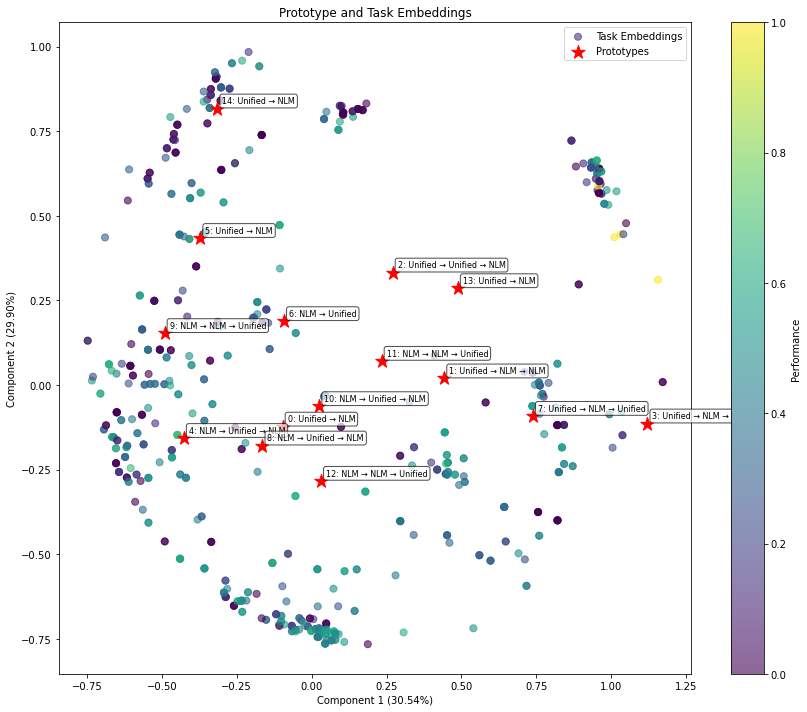

Training MCU:  13%|█▎        | 67/500 [08:33<42:55,  5.95s/it]

Iteration 67/500, Cell Accuracy: 0.4698, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  14%|█▎        | 68/500 [08:40<45:17,  6.29s/it]

Iteration 68/500, Cell Accuracy: 0.5197, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  14%|█▍        | 69/500 [08:44<41:11,  5.73s/it]

Iteration 69/500, Cell Accuracy: 0.4682, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  14%|█▍        | 70/500 [08:46<32:40,  4.56s/it]

Iteration 70/500, Cell Accuracy: 0.4346, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 71/500, Cell Accuracy: 0.3864, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_71.pt


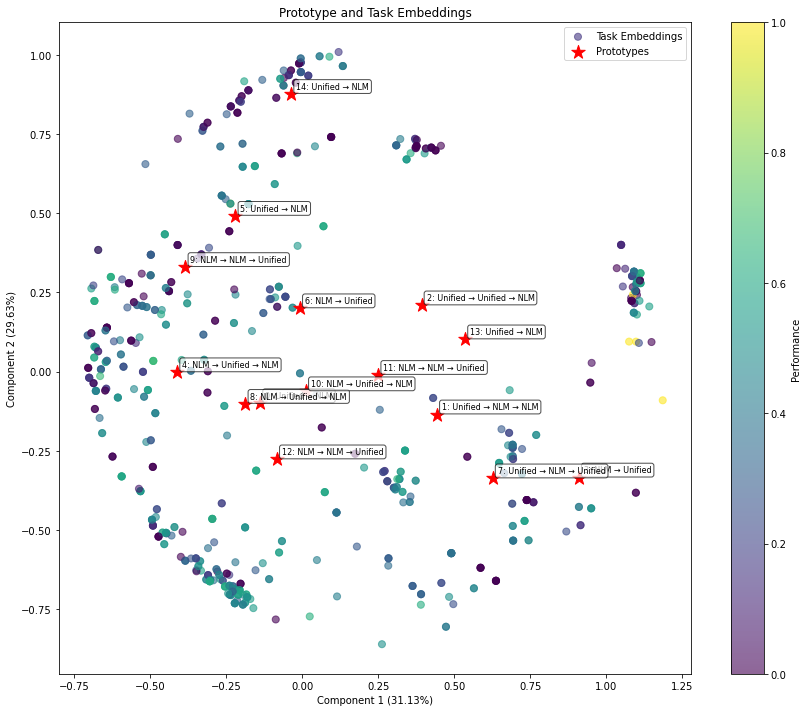

Training MCU:  14%|█▍        | 72/500 [09:04<48:29,  6.80s/it]

Iteration 72/500, Cell Accuracy: 0.3233, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  15%|█▍        | 73/500 [09:16<58:37,  8.24s/it]

Iteration 73/500, Cell Accuracy: 0.4887, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  15%|█▍        | 74/500 [09:22<53:08,  7.49s/it]

Iteration 74/500, Cell Accuracy: 0.4101, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  15%|█▌        | 75/500 [09:31<56:34,  7.99s/it]

Iteration 75/500, Cell Accuracy: 0.3364, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 76/500, Cell Accuracy: 0.6242, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_76.pt


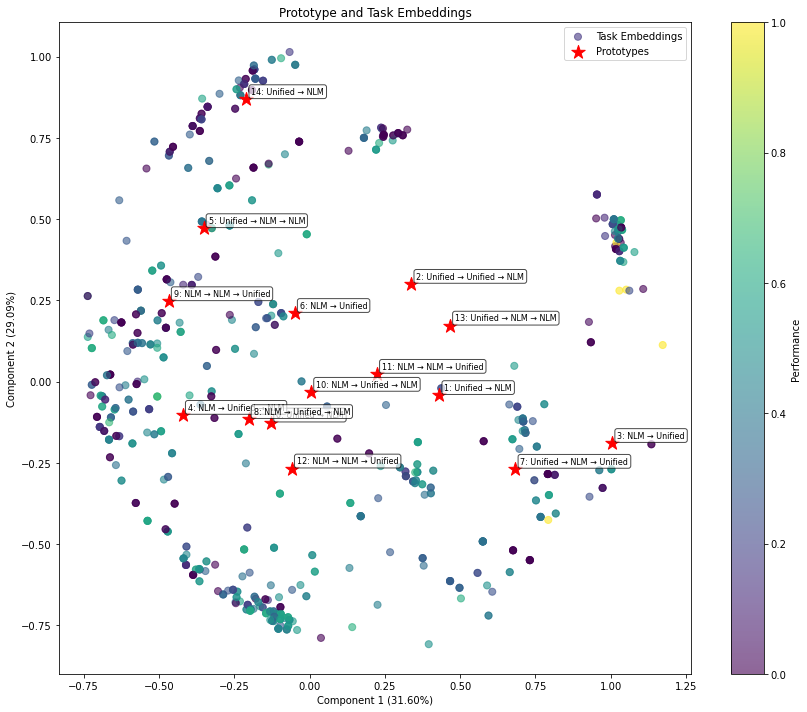

Training MCU:  15%|█▌        | 77/500 [09:46<56:19,  7.99s/it]

Iteration 77/500, Cell Accuracy: 0.3344, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  16%|█▌        | 78/500 [09:59<1:06:02,  9.39s/it]

Iteration 78/500, Cell Accuracy: 0.4730, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  16%|█▌        | 79/500 [10:02<53:02,  7.56s/it]  

Iteration 79/500, Cell Accuracy: 0.3696, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  16%|█▌        | 80/500 [10:10<54:37,  7.80s/it]

Iteration 80/500, Cell Accuracy: 0.4141, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 81/500, Cell Accuracy: 0.5197, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_81.pt


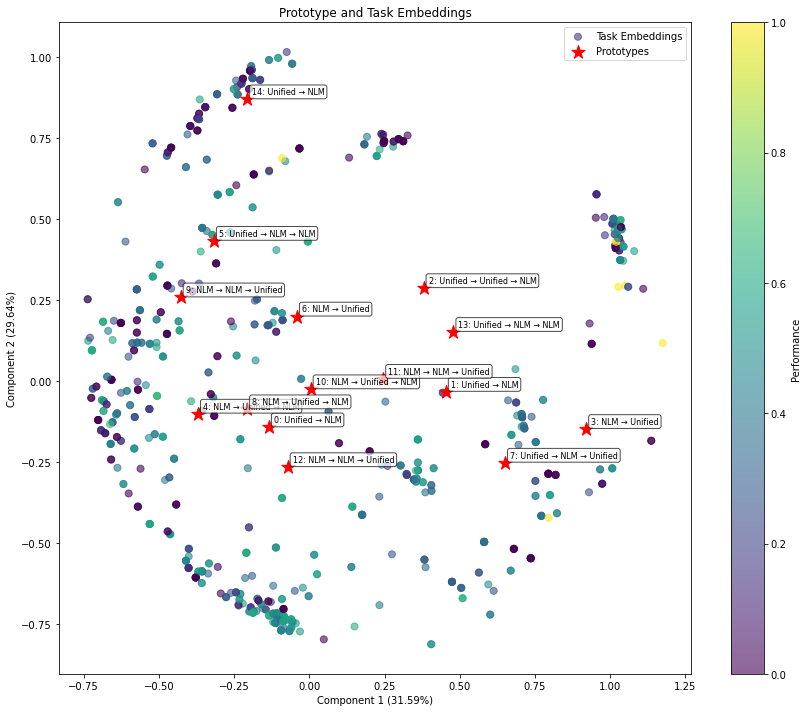

Training MCU:  16%|█▋        | 82/500 [10:22<46:15,  6.64s/it]

Iteration 82/500, Cell Accuracy: 0.2412, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  17%|█▋        | 83/500 [10:27<42:12,  6.07s/it]

Iteration 83/500, Cell Accuracy: 0.5727, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  17%|█▋        | 84/500 [10:37<48:57,  7.06s/it]

Iteration 84/500, Cell Accuracy: 0.6507, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  17%|█▋        | 85/500 [10:42<45:56,  6.64s/it]

Iteration 85/500, Cell Accuracy: 0.4840, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 86/500, Cell Accuracy: 0.5948, Grid Accuracy: 0.0500, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_86.pt


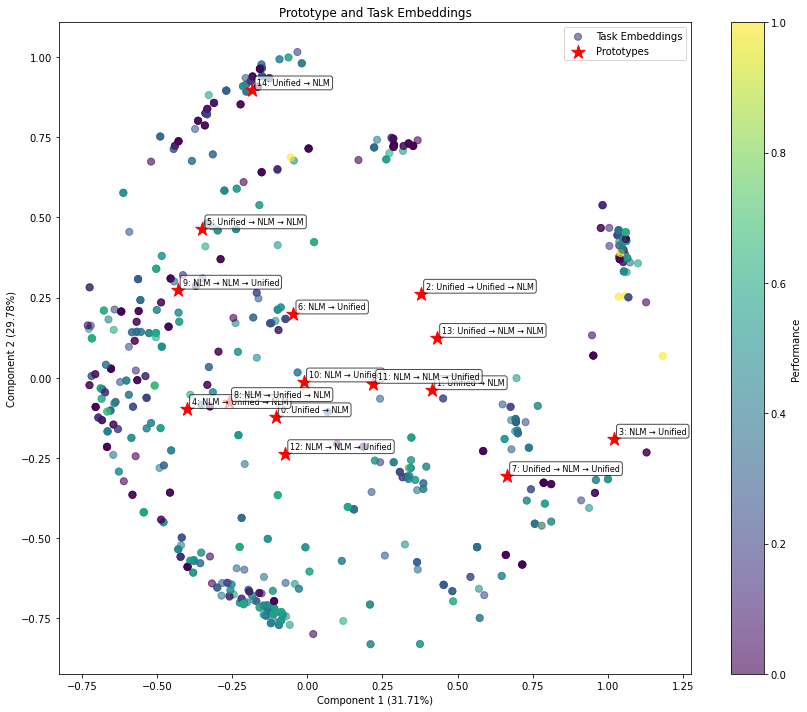

Training MCU:  17%|█▋        | 87/500 [10:51<37:26,  5.44s/it]

Iteration 87/500, Cell Accuracy: 0.3743, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  18%|█▊        | 88/500 [10:53<31:08,  4.54s/it]

Iteration 88/500, Cell Accuracy: 0.5149, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  18%|█▊        | 89/500 [11:05<46:03,  6.72s/it]

Iteration 89/500, Cell Accuracy: 0.3898, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  18%|█▊        | 90/500 [11:13<47:51,  7.00s/it]

Iteration 90/500, Cell Accuracy: 0.1561, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 91/500, Cell Accuracy: 0.5184, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_91.pt


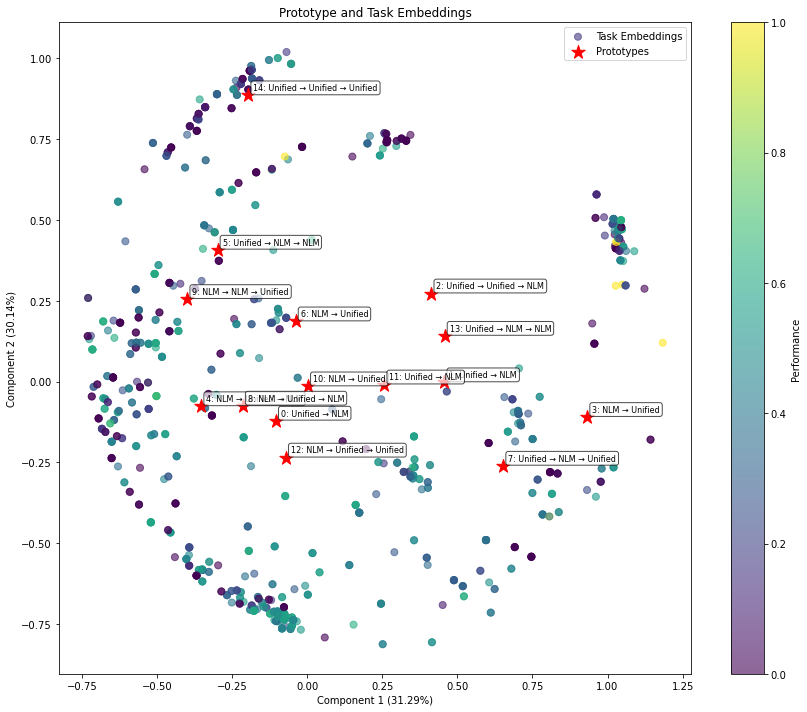

Training MCU:  18%|█▊        | 92/500 [11:26<46:01,  6.77s/it]

Iteration 92/500, Cell Accuracy: 0.4615, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  19%|█▊        | 93/500 [11:29<38:26,  5.67s/it]

Iteration 93/500, Cell Accuracy: 0.5775, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  19%|█▉        | 94/500 [11:34<37:40,  5.57s/it]

Iteration 94/500, Cell Accuracy: 0.4796, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  19%|█▉        | 95/500 [11:41<40:46,  6.04s/it]

Iteration 95/500, Cell Accuracy: 0.3924, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 96/500, Cell Accuracy: 0.4912, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_96.pt


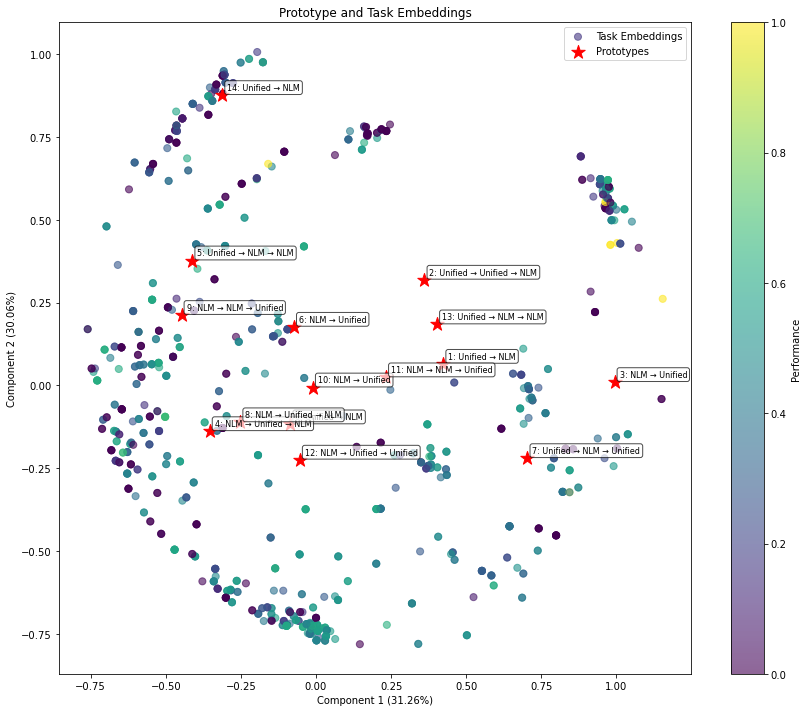

Training MCU:  19%|█▉        | 97/500 [12:03<1:01:28,  9.15s/it]

Iteration 97/500, Cell Accuracy: 0.4351, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  20%|█▉        | 98/500 [12:18<1:12:55, 10.88s/it]

Iteration 98/500, Cell Accuracy: 0.4403, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  20%|█▉        | 99/500 [12:22<59:02,  8.83s/it]  

Iteration 99/500, Cell Accuracy: 0.5055, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  20%|██        | 100/500 [12:25<46:30,  6.98s/it]

Iteration 100/500, Cell Accuracy: 0.5760, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 101/500, Cell Accuracy: 0.5972, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_101.pt


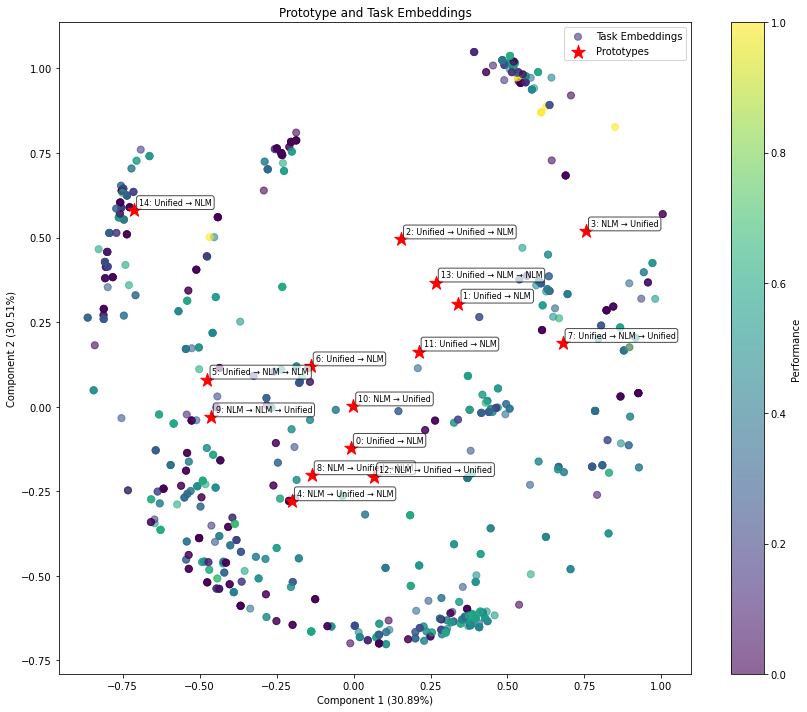

Training MCU:  20%|██        | 102/500 [12:31<31:40,  4.77s/it]

Iteration 102/500, Cell Accuracy: 0.5021, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  21%|██        | 103/500 [12:38<36:48,  5.56s/it]

Iteration 103/500, Cell Accuracy: 0.5808, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  21%|██        | 104/500 [12:42<32:47,  4.97s/it]

Iteration 104/500, Cell Accuracy: 0.4730, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  21%|██        | 105/500 [12:46<30:57,  4.70s/it]

Iteration 105/500, Cell Accuracy: 0.5745, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 106/500, Cell Accuracy: 0.6358, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_106.pt


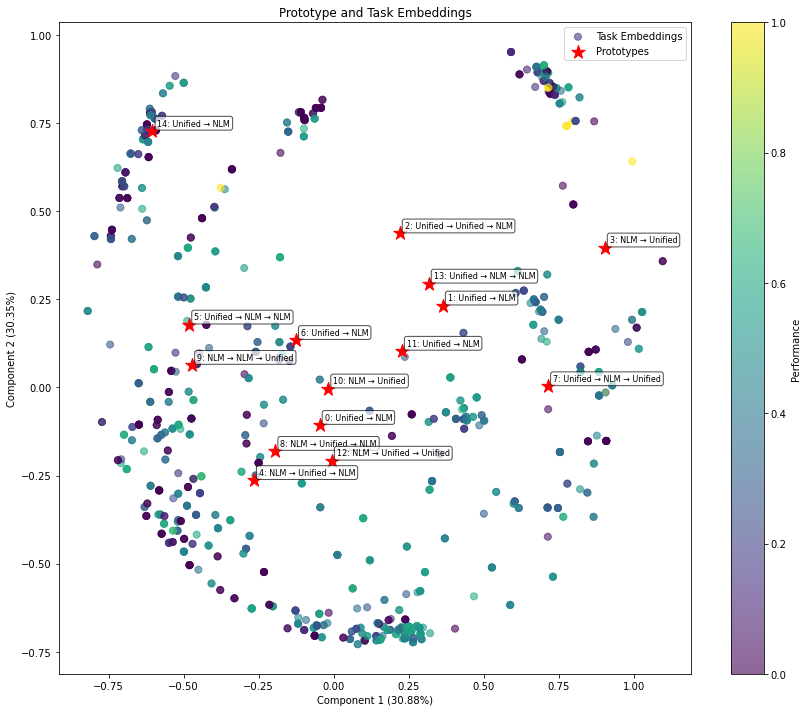

Training MCU:  21%|██▏       | 107/500 [13:02<45:04,  6.88s/it]

Iteration 107/500, Cell Accuracy: 0.3972, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  22%|██▏       | 108/500 [13:03<33:30,  5.13s/it]

Iteration 108/500, Cell Accuracy: 0.4597, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  22%|██▏       | 109/500 [13:06<28:25,  4.36s/it]

Iteration 109/500, Cell Accuracy: 0.3846, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  22%|██▏       | 110/500 [13:09<25:38,  3.95s/it]

Iteration 110/500, Cell Accuracy: 0.4675, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 111/500, Cell Accuracy: 0.2175, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_111.pt


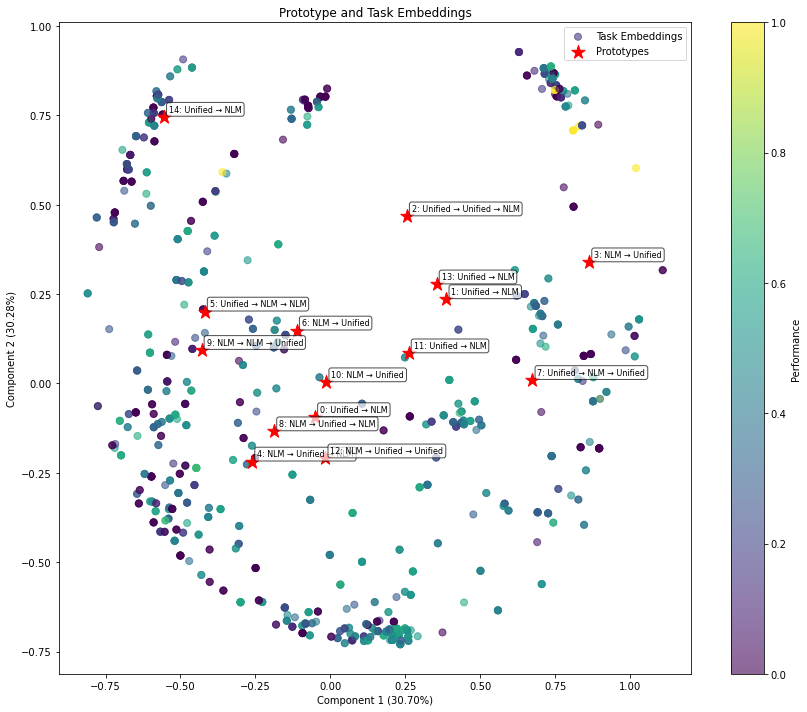

Training MCU:  22%|██▏       | 112/500 [13:29<44:44,  6.92s/it]

Iteration 112/500, Cell Accuracy: 0.4154, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  23%|██▎       | 113/500 [13:32<36:24,  5.64s/it]

Iteration 113/500, Cell Accuracy: 0.5256, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  23%|██▎       | 114/500 [13:37<35:26,  5.51s/it]

Iteration 114/500, Cell Accuracy: 0.5119, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  23%|██▎       | 115/500 [13:44<39:22,  6.14s/it]

Iteration 115/500, Cell Accuracy: 0.4348, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 116/500, Cell Accuracy: 0.4869, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_116.pt


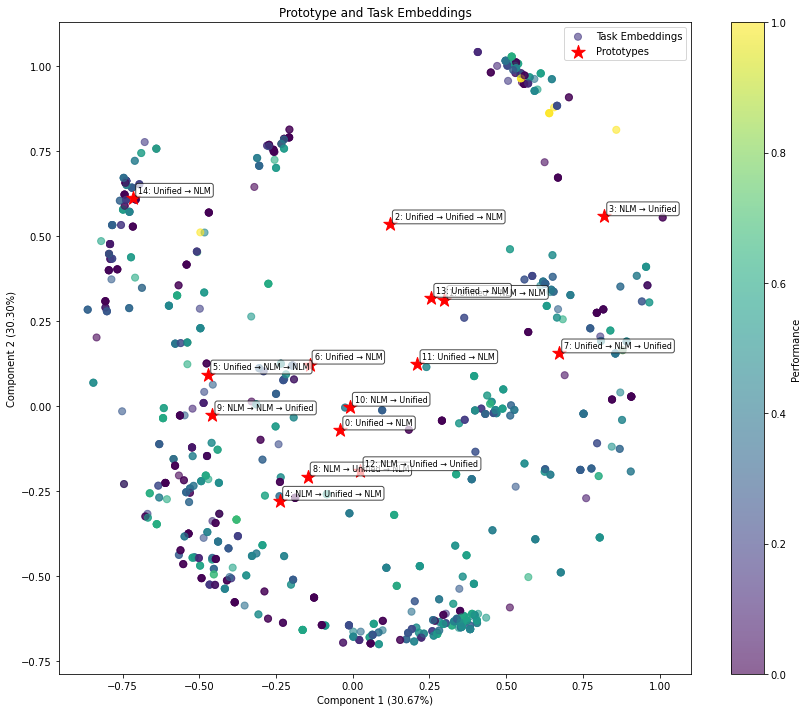

Training MCU:  23%|██▎       | 117/500 [14:02<49:55,  7.82s/it]

Iteration 117/500, Cell Accuracy: 0.4660, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  24%|██▎       | 118/500 [14:05<40:30,  6.36s/it]

Iteration 118/500, Cell Accuracy: 0.5136, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  24%|██▍       | 119/500 [14:07<30:26,  4.79s/it]

Iteration 119/500, Cell Accuracy: 0.4728, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  24%|██▍       | 120/500 [14:09<25:07,  3.97s/it]

Iteration 120/500, Cell Accuracy: 0.5870, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 121/500, Cell Accuracy: 0.3871, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_121.pt


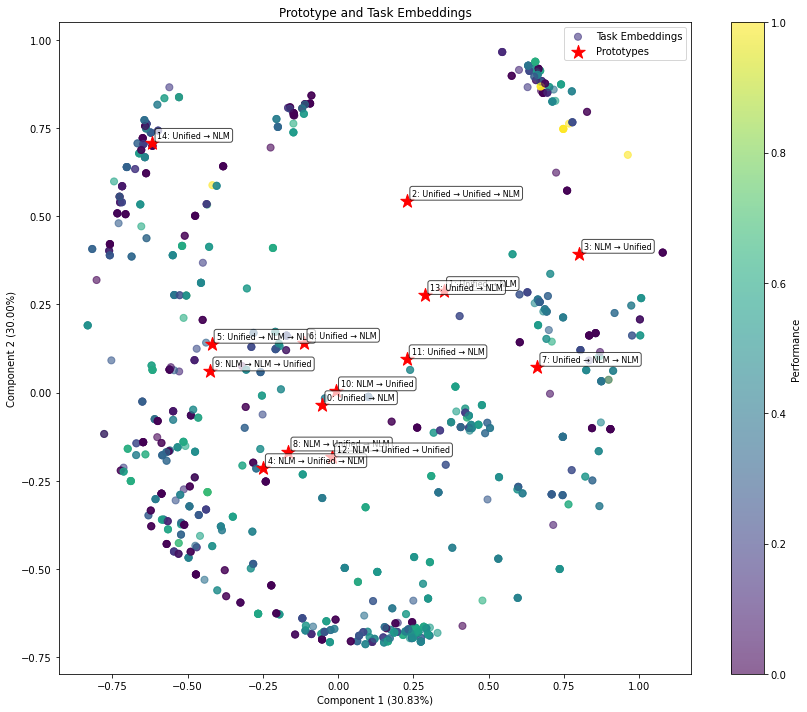

Training MCU:  24%|██▍       | 122/500 [14:27<38:38,  6.13s/it]

Iteration 122/500, Cell Accuracy: 0.3911, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  25%|██▍       | 123/500 [14:29<31:36,  5.03s/it]

Iteration 123/500, Cell Accuracy: 0.4570, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  25%|██▍       | 124/500 [14:34<31:07,  4.97s/it]

Iteration 124/500, Cell Accuracy: 0.5082, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  25%|██▌       | 125/500 [14:37<27:14,  4.36s/it]

Iteration 125/500, Cell Accuracy: 0.5906, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 126/500, Cell Accuracy: 0.4646, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_126.pt


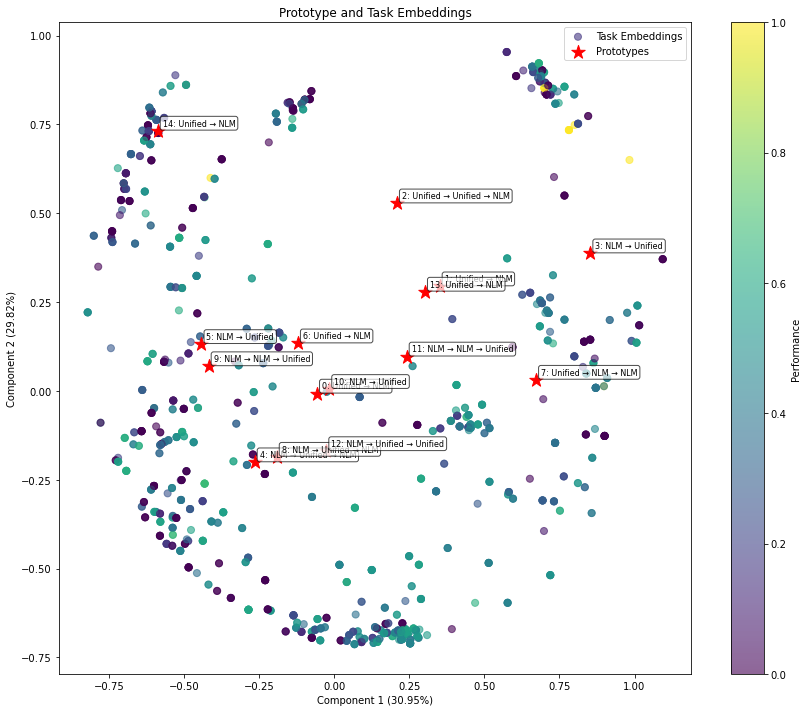

Training MCU:  25%|██▌       | 127/500 [14:44<23:33,  3.79s/it]

Iteration 127/500, Cell Accuracy: 0.5093, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  26%|██▌       | 128/500 [15:07<1:00:30,  9.76s/it]

Iteration 128/500, Cell Accuracy: 0.5726, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  26%|██▌       | 129/500 [15:15<55:41,  9.01s/it]  

Iteration 129/500, Cell Accuracy: 0.4728, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  26%|██▌       | 130/500 [15:17<42:55,  6.96s/it]

Iteration 130/500, Cell Accuracy: 0.4643, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 131/500, Cell Accuracy: 0.5011, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_131.pt


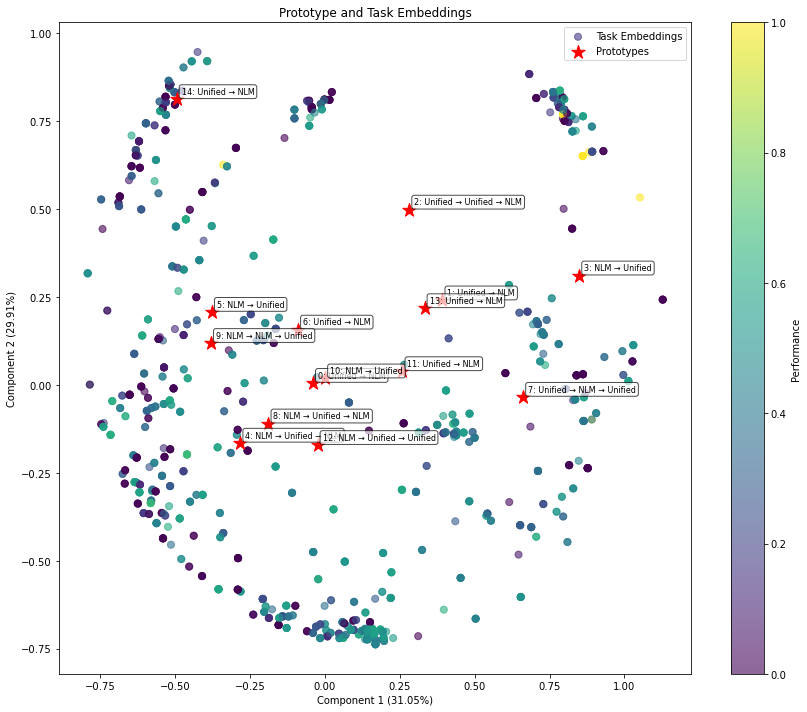

Training MCU:  26%|██▋       | 132/500 [15:24<31:17,  5.10s/it]

Iteration 132/500, Cell Accuracy: 0.5103, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  27%|██▋       | 133/500 [15:31<34:15,  5.60s/it]

Iteration 133/500, Cell Accuracy: 0.3783, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  27%|██▋       | 134/500 [15:35<30:26,  4.99s/it]

Iteration 134/500, Cell Accuracy: 0.6651, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  27%|██▋       | 135/500 [15:37<25:31,  4.20s/it]

Iteration 135/500, Cell Accuracy: 0.4443, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 136/500, Cell Accuracy: 0.3397, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_136.pt


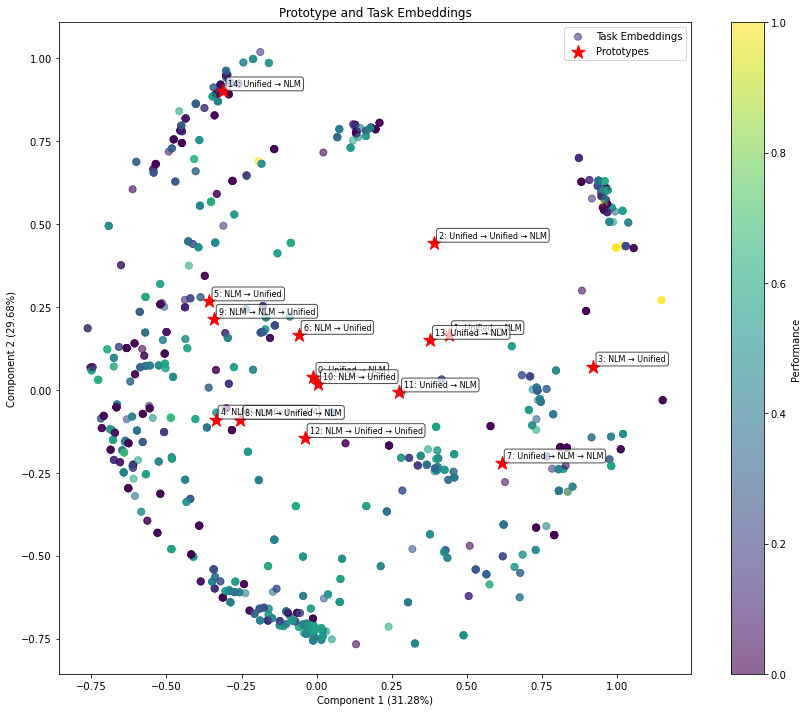

Training MCU:  27%|██▋       | 137/500 [15:45<23:28,  3.88s/it]

Iteration 137/500, Cell Accuracy: 0.4570, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  28%|██▊       | 138/500 [15:47<19:44,  3.27s/it]

Iteration 138/500, Cell Accuracy: 0.3964, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  28%|██▊       | 139/500 [15:49<18:26,  3.07s/it]

Iteration 139/500, Cell Accuracy: 0.4856, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  28%|██▊       | 140/500 [15:56<24:06,  4.02s/it]

Iteration 140/500, Cell Accuracy: 0.3814, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 141/500, Cell Accuracy: 0.5081, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_141.pt


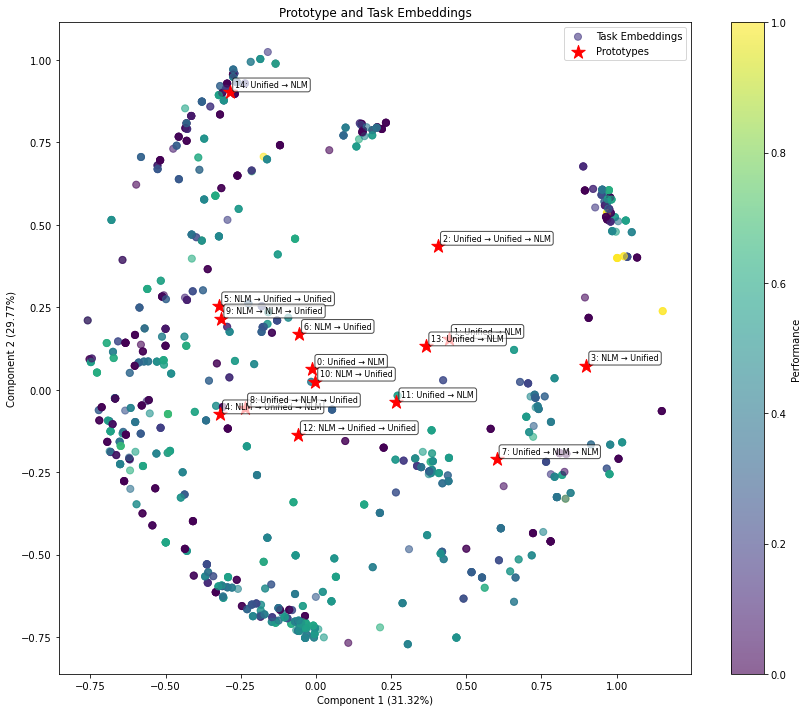

Training MCU:  28%|██▊       | 142/500 [16:04<23:22,  3.92s/it]

Iteration 142/500, Cell Accuracy: 0.4668, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  29%|██▊       | 143/500 [16:09<24:11,  4.07s/it]

Iteration 143/500, Cell Accuracy: 0.4880, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  29%|██▉       | 144/500 [16:26<48:25,  8.16s/it]

Iteration 144/500, Cell Accuracy: 0.4973, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  29%|██▉       | 145/500 [16:33<46:21,  7.84s/it]

Iteration 145/500, Cell Accuracy: 0.3366, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 146/500, Cell Accuracy: 0.3482, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_146.pt


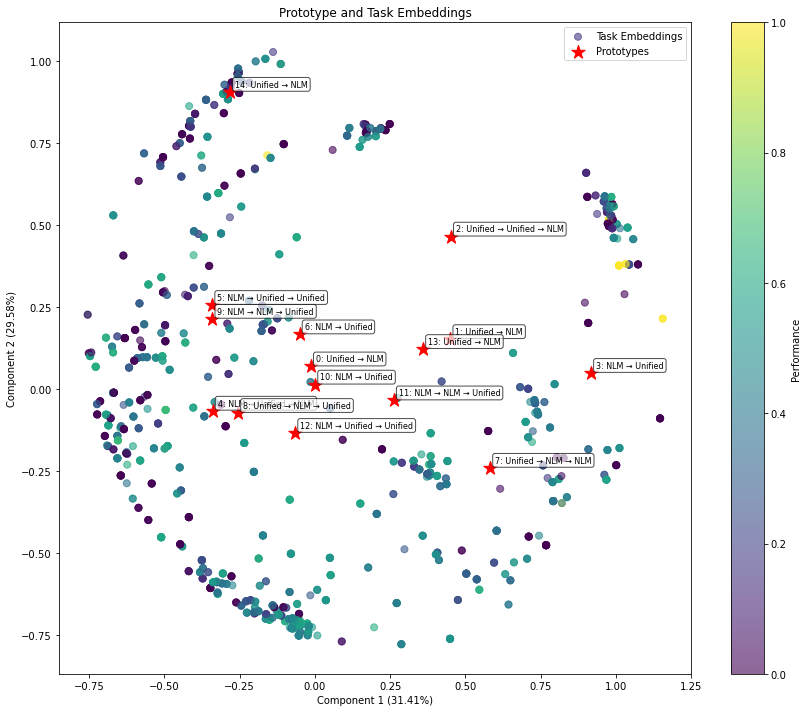

Training MCU:  29%|██▉       | 147/500 [16:50<42:51,  7.29s/it]

Iteration 147/500, Cell Accuracy: 0.6163, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  30%|██▉       | 148/500 [16:59<45:45,  7.80s/it]

Iteration 148/500, Cell Accuracy: 0.3175, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  30%|██▉       | 149/500 [17:02<38:36,  6.60s/it]

Iteration 149/500, Cell Accuracy: 0.5671, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  30%|███       | 150/500 [17:04<29:28,  5.05s/it]

Iteration 150/500, Cell Accuracy: 0.2765, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 151/500, Cell Accuracy: 0.4403, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_151.pt


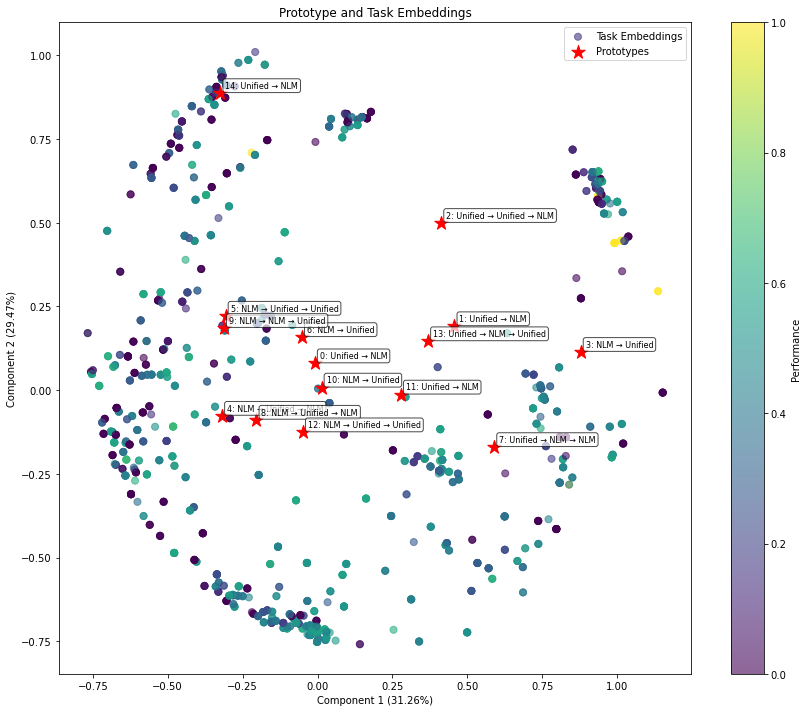

Training MCU:  30%|███       | 152/500 [17:15<30:19,  5.23s/it]

Iteration 152/500, Cell Accuracy: 0.4921, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  31%|███       | 153/500 [17:18<27:09,  4.70s/it]

Iteration 153/500, Cell Accuracy: 0.3982, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  31%|███       | 154/500 [17:23<26:36,  4.61s/it]

Iteration 154/500, Cell Accuracy: 0.6426, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  31%|███       | 155/500 [17:25<22:09,  3.85s/it]

Iteration 155/500, Cell Accuracy: 0.4396, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 156/500, Cell Accuracy: 0.4984, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_156.pt


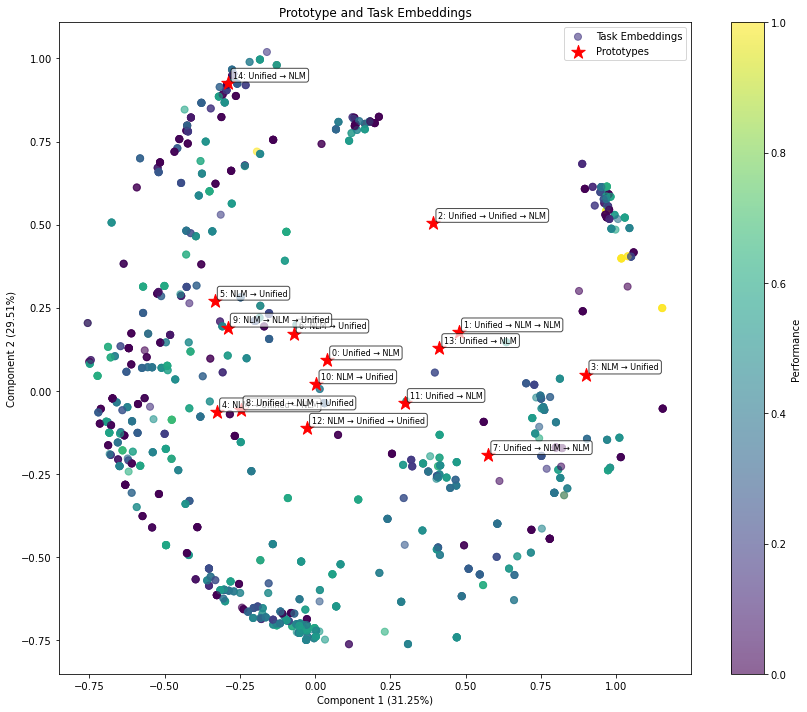

Training MCU:  31%|███▏      | 157/500 [17:35<26:20,  4.61s/it]

Iteration 157/500, Cell Accuracy: 0.4422, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  32%|███▏      | 158/500 [17:38<23:38,  4.15s/it]

Iteration 158/500, Cell Accuracy: 0.4647, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  32%|███▏      | 159/500 [17:40<19:51,  3.50s/it]

Iteration 159/500, Cell Accuracy: 0.5106, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  32%|███▏      | 160/500 [17:52<34:10,  6.03s/it]

Iteration 160/500, Cell Accuracy: 0.5110, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 161/500, Cell Accuracy: 0.4086, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_161.pt


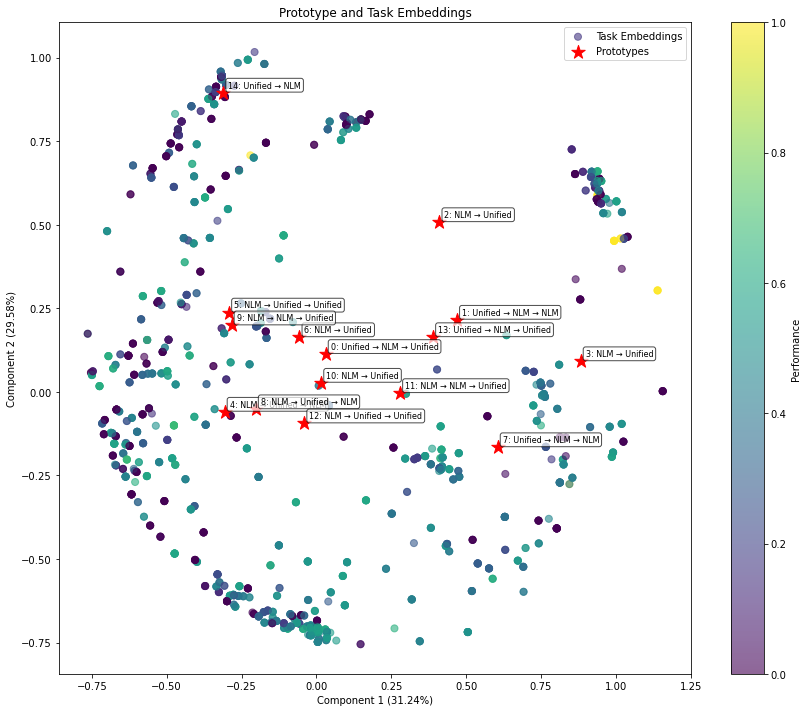

Training MCU:  32%|███▏      | 162/500 [18:06<33:35,  5.96s/it]

Iteration 162/500, Cell Accuracy: 0.6998, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  33%|███▎      | 163/500 [18:07<26:08,  4.65s/it]

Iteration 163/500, Cell Accuracy: 0.4178, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  33%|███▎      | 164/500 [18:19<38:14,  6.83s/it]

Iteration 164/500, Cell Accuracy: 0.4461, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  33%|███▎      | 165/500 [18:26<37:10,  6.66s/it]

Iteration 165/500, Cell Accuracy: 0.2336, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 166/500, Cell Accuracy: 0.5525, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_166.pt


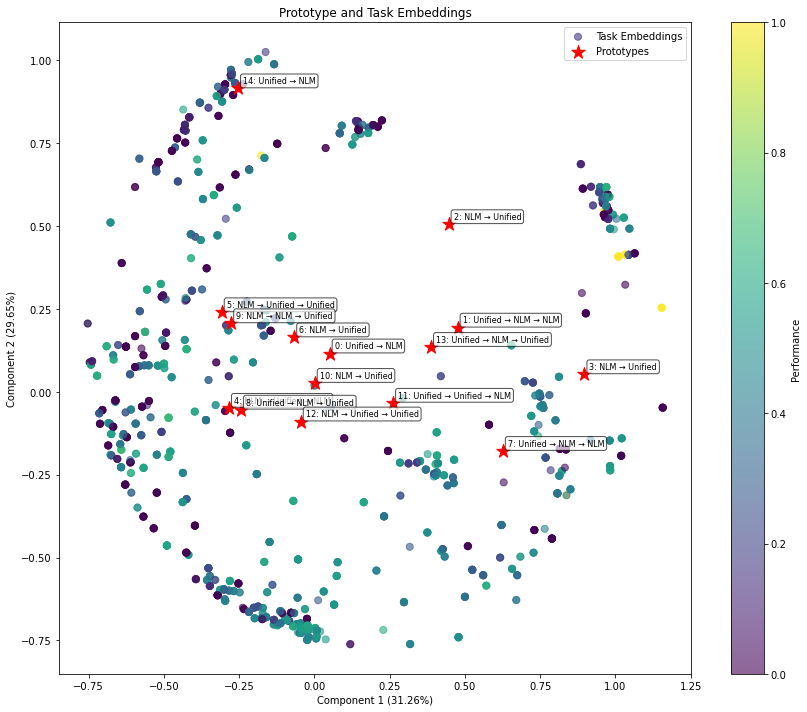

Training MCU:  33%|███▎      | 167/500 [18:56<58:19, 10.51s/it]

Iteration 167/500, Cell Accuracy: 0.5002, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  34%|███▎      | 168/500 [18:58<43:33,  7.87s/it]

Iteration 168/500, Cell Accuracy: 0.5003, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  34%|███▍      | 169/500 [18:59<32:49,  5.95s/it]

Iteration 169/500, Cell Accuracy: 0.5983, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  34%|███▍      | 170/500 [19:05<33:29,  6.09s/it]

Iteration 170/500, Cell Accuracy: 0.3540, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 171/500, Cell Accuracy: 0.4006, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_171.pt


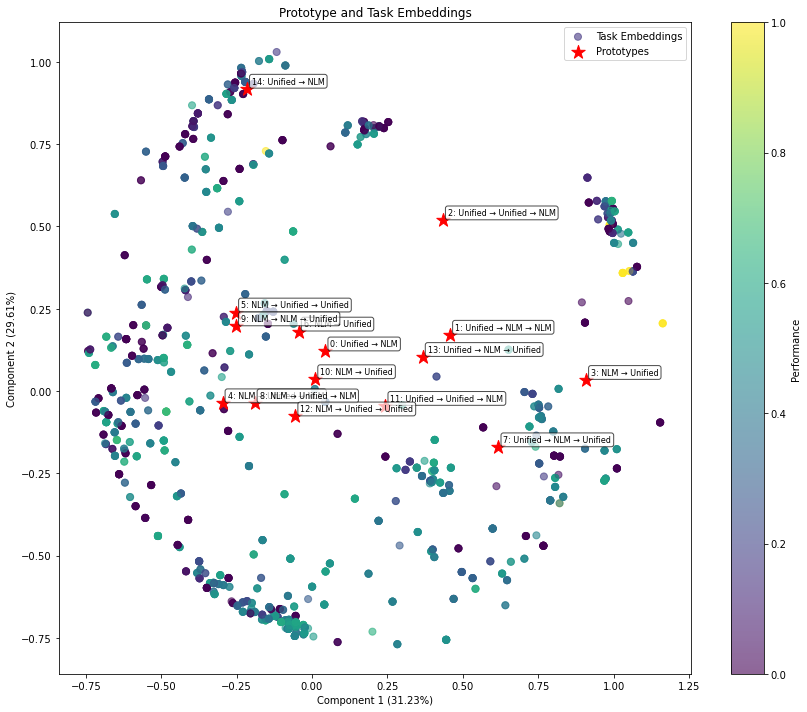

Training MCU:  34%|███▍      | 172/500 [19:19<32:46,  6.00s/it]

Iteration 172/500, Cell Accuracy: 0.5200, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  35%|███▍      | 173/500 [19:27<35:57,  6.60s/it]

Iteration 173/500, Cell Accuracy: 0.5874, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  35%|███▍      | 174/500 [19:36<40:58,  7.54s/it]

Iteration 174/500, Cell Accuracy: 0.6326, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  35%|███▌      | 175/500 [19:49<48:58,  9.04s/it]

Iteration 175/500, Cell Accuracy: 0.5359, Grid Accuracy: 0.2000, Epsilon: 0.0476
Iteration 176/500, Cell Accuracy: 0.6695, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_176.pt


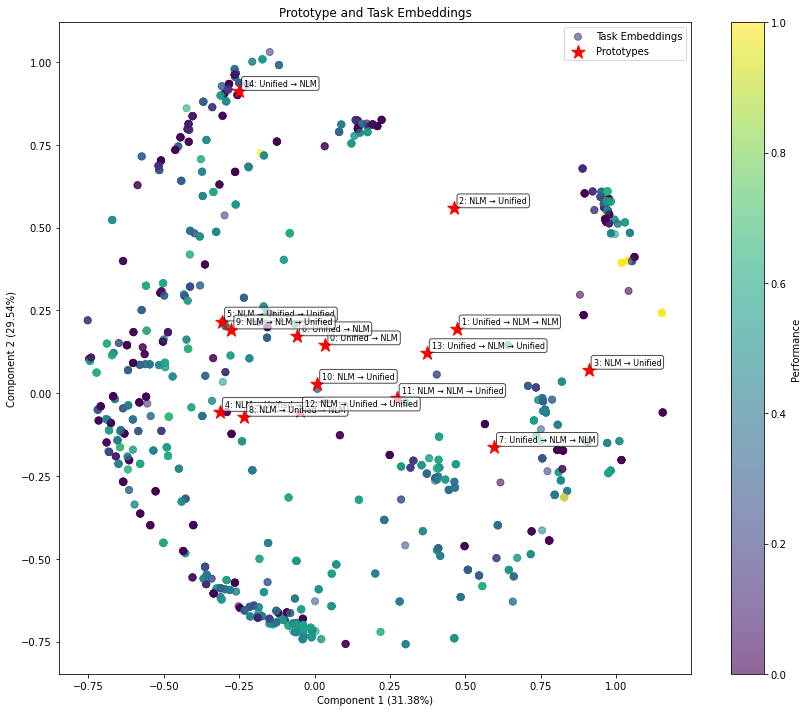

Training MCU:  35%|███▌      | 177/500 [20:05<48:41,  9.04s/it]

Iteration 177/500, Cell Accuracy: 0.3637, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  36%|███▌      | 178/500 [20:11<43:18,  8.07s/it]

Iteration 178/500, Cell Accuracy: 0.5084, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  36%|███▌      | 179/500 [20:19<42:54,  8.02s/it]

Iteration 179/500, Cell Accuracy: 0.5175, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  36%|███▌      | 180/500 [20:26<41:17,  7.74s/it]

Iteration 180/500, Cell Accuracy: 0.5531, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 181/500, Cell Accuracy: 0.5876, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_181.pt


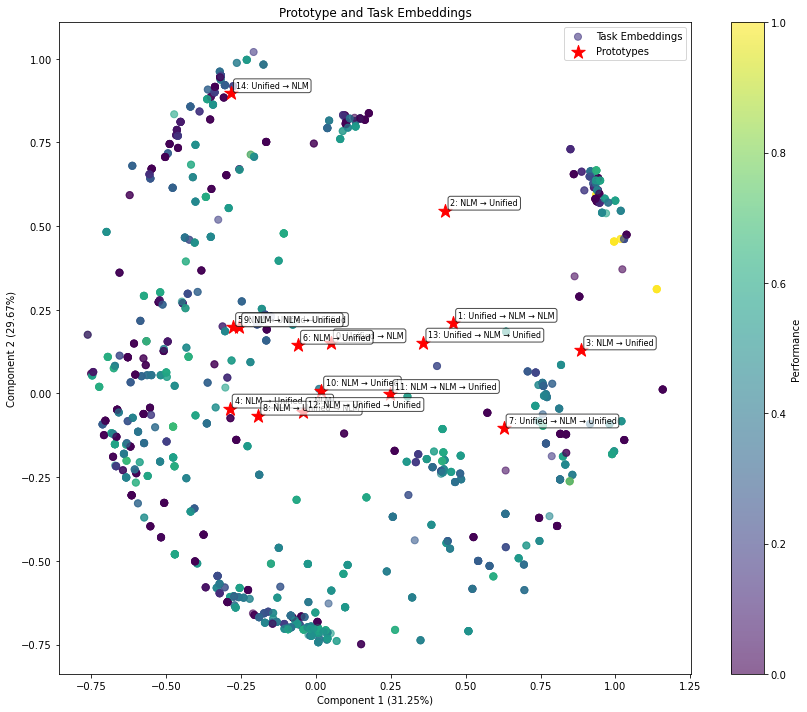

Training MCU:  36%|███▋      | 182/500 [20:40<36:28,  6.88s/it]

Iteration 182/500, Cell Accuracy: 0.4981, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  37%|███▋      | 183/500 [20:56<50:32,  9.57s/it]

Iteration 183/500, Cell Accuracy: 0.4809, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  37%|███▋      | 184/500 [20:58<37:39,  7.15s/it]

Iteration 184/500, Cell Accuracy: 0.3568, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  37%|███▋      | 185/500 [20:58<27:32,  5.25s/it]

Iteration 185/500, Cell Accuracy: 0.2842, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 186/500, Cell Accuracy: 0.4852, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_186.pt


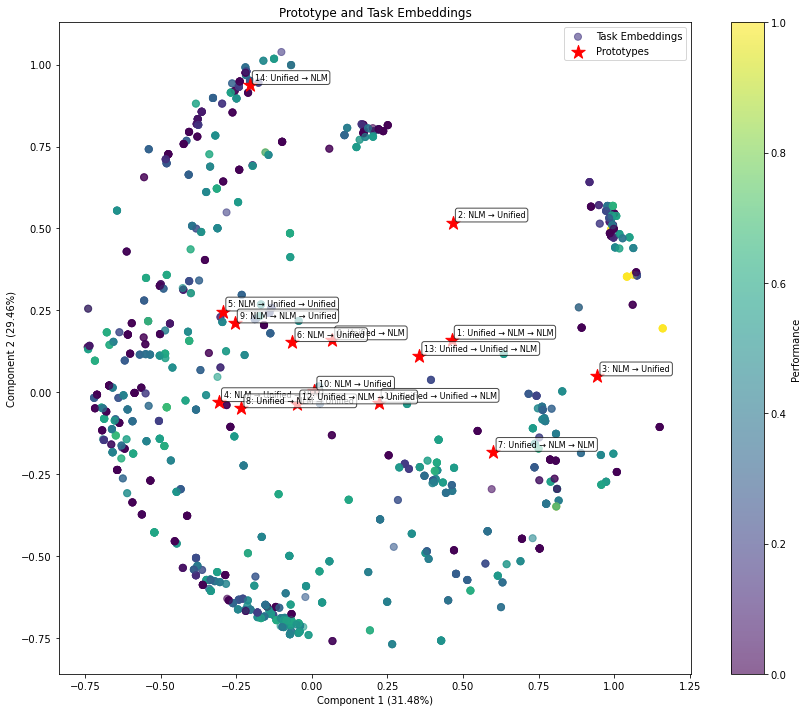

Training MCU:  37%|███▋      | 187/500 [21:11<29:17,  5.61s/it]

Iteration 187/500, Cell Accuracy: 0.6081, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  38%|███▊      | 188/500 [21:19<33:03,  6.36s/it]

Iteration 188/500, Cell Accuracy: 0.3910, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  38%|███▊      | 189/500 [21:21<26:12,  5.06s/it]

Iteration 189/500, Cell Accuracy: 0.5647, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  38%|███▊      | 190/500 [21:23<20:53,  4.04s/it]

Iteration 190/500, Cell Accuracy: 0.7318, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 191/500, Cell Accuracy: 0.4082, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_191.pt


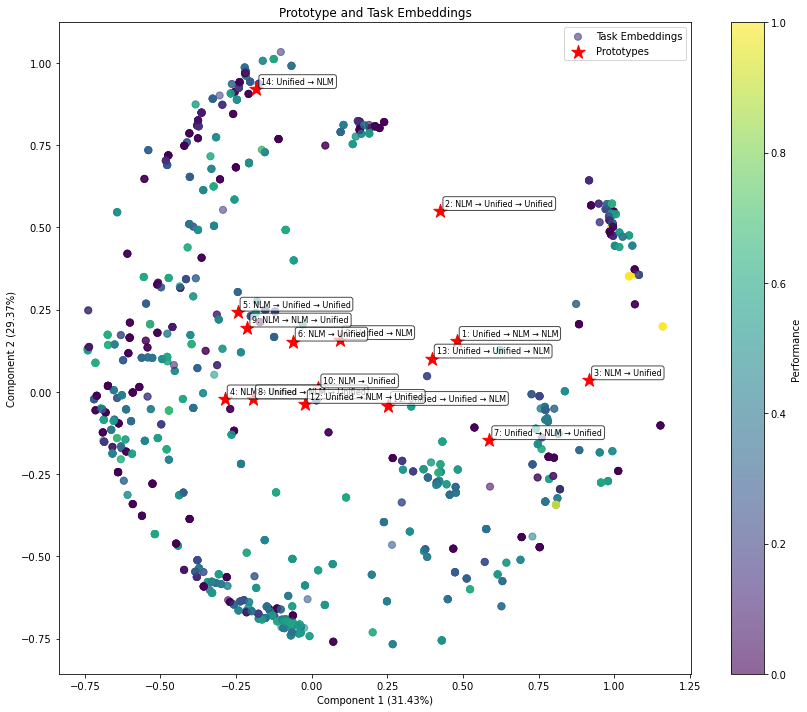

Training MCU:  38%|███▊      | 192/500 [21:33<21:21,  4.16s/it]

Iteration 192/500, Cell Accuracy: 0.4568, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  39%|███▊      | 193/500 [21:39<25:24,  4.97s/it]

Iteration 193/500, Cell Accuracy: 0.5014, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  39%|███▉      | 194/500 [21:41<19:57,  3.91s/it]

Iteration 194/500, Cell Accuracy: 0.4199, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  39%|███▉      | 195/500 [21:42<16:08,  3.18s/it]

Iteration 195/500, Cell Accuracy: 0.4208, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 196/500, Cell Accuracy: 0.4025, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_196.pt


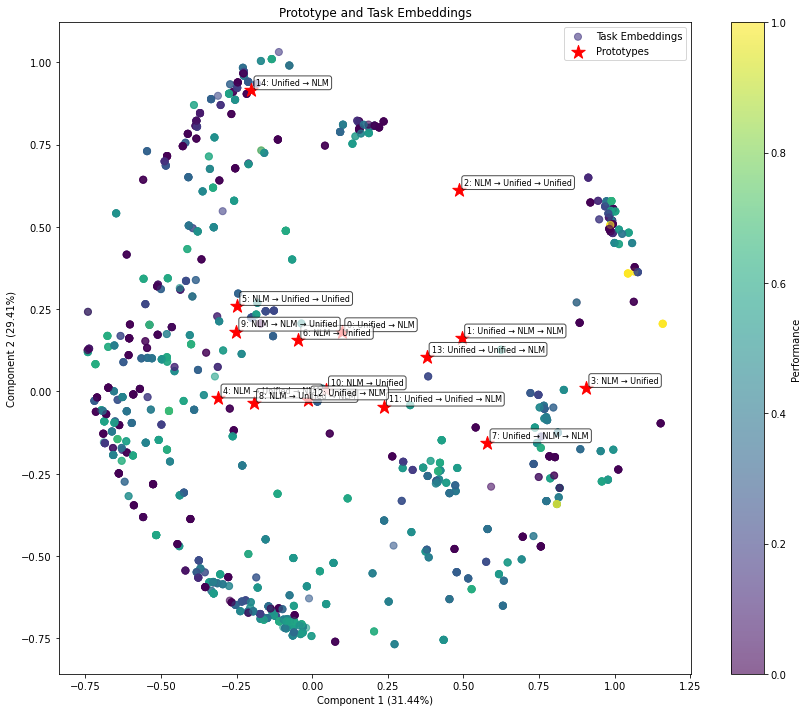

Training MCU:  39%|███▉      | 197/500 [21:53<19:23,  3.84s/it]

Iteration 197/500, Cell Accuracy: 0.6928, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  40%|███▉      | 198/500 [21:57<20:29,  4.07s/it]

Iteration 198/500, Cell Accuracy: 0.6697, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  40%|███▉      | 199/500 [22:08<30:00,  5.98s/it]

Iteration 199/500, Cell Accuracy: 0.5139, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  40%|████      | 200/500 [22:24<45:17,  9.06s/it]

Iteration 200/500, Cell Accuracy: 0.4201, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 201/500, Cell Accuracy: 0.5223, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_201.pt


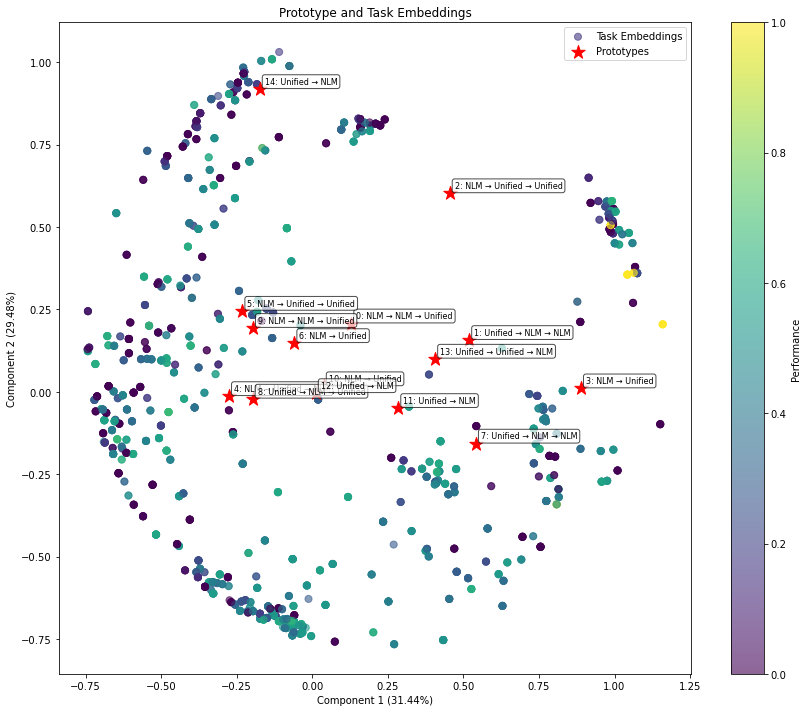

Training MCU:  40%|████      | 202/500 [22:37<36:25,  7.33s/it]

Iteration 202/500, Cell Accuracy: 0.2217, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  41%|████      | 203/500 [22:43<34:27,  6.96s/it]

Iteration 203/500, Cell Accuracy: 0.3757, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  41%|████      | 204/500 [22:47<30:03,  6.09s/it]

Iteration 204/500, Cell Accuracy: 0.4409, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  41%|████      | 205/500 [22:54<30:42,  6.25s/it]

Iteration 205/500, Cell Accuracy: 0.3561, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 206/500, Cell Accuracy: 0.3731, Grid Accuracy: 0.0500, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_206.pt


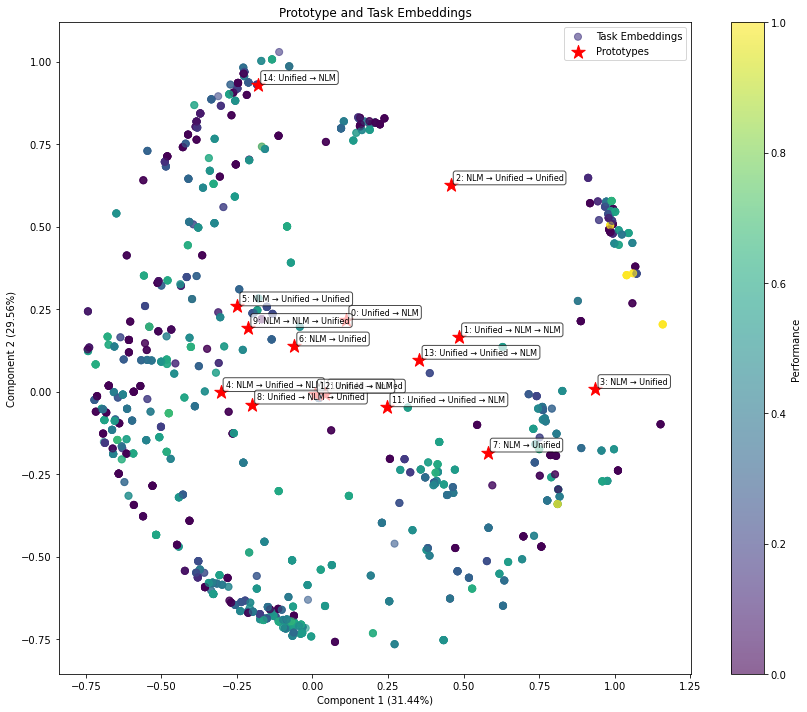

Training MCU:  41%|████▏     | 207/500 [23:03<25:25,  5.20s/it]

Iteration 207/500, Cell Accuracy: 0.5253, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  42%|████▏     | 208/500 [23:05<20:14,  4.16s/it]

Iteration 208/500, Cell Accuracy: 0.5205, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  42%|████▏     | 209/500 [23:06<15:19,  3.16s/it]

Iteration 209/500, Cell Accuracy: 0.6089, Grid Accuracy: 0.2500, Epsilon: 0.0476


Training MCU:  42%|████▏     | 210/500 [23:09<16:01,  3.32s/it]

Iteration 210/500, Cell Accuracy: 0.4341, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 211/500, Cell Accuracy: 0.4627, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_211.pt


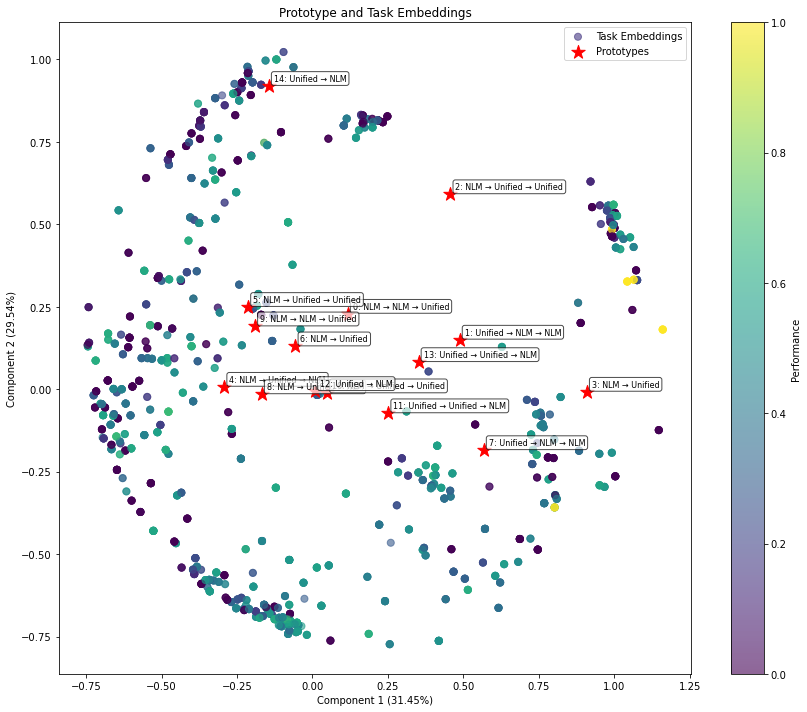

Training MCU:  42%|████▏     | 212/500 [23:24<24:10,  5.04s/it]

Iteration 212/500, Cell Accuracy: 0.3554, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  43%|████▎     | 213/500 [23:31<26:54,  5.62s/it]

Iteration 213/500, Cell Accuracy: 0.5188, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  43%|████▎     | 214/500 [23:34<22:27,  4.71s/it]

Iteration 214/500, Cell Accuracy: 0.4831, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  43%|████▎     | 215/500 [23:41<25:28,  5.36s/it]

Iteration 215/500, Cell Accuracy: 0.5325, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 216/500, Cell Accuracy: 0.5400, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_216.pt


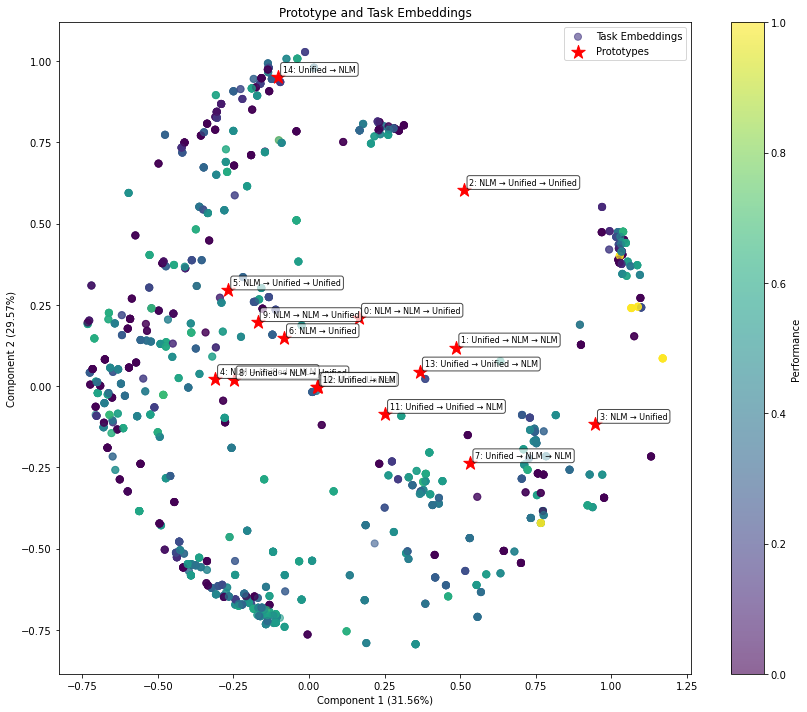

Training MCU:  43%|████▎     | 217/500 [23:48<20:19,  4.31s/it]

Iteration 217/500, Cell Accuracy: 0.4126, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  44%|████▎     | 218/500 [23:49<15:41,  3.34s/it]

Iteration 218/500, Cell Accuracy: 0.6404, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  44%|████▍     | 219/500 [23:51<13:52,  2.96s/it]

Iteration 219/500, Cell Accuracy: 0.5165, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  44%|████▍     | 220/500 [23:56<16:11,  3.47s/it]

Iteration 220/500, Cell Accuracy: 0.2114, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 221/500, Cell Accuracy: 0.4255, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_221.pt


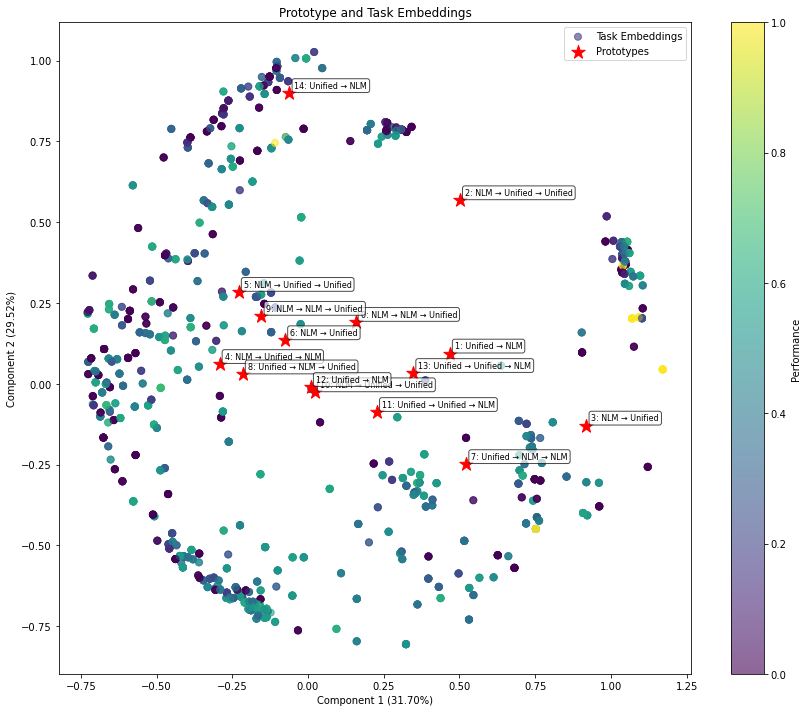

Training MCU:  44%|████▍     | 222/500 [24:03<15:48,  3.41s/it]

Iteration 222/500, Cell Accuracy: 0.3602, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  45%|████▍     | 223/500 [24:06<15:05,  3.27s/it]

Iteration 223/500, Cell Accuracy: 0.5230, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  45%|████▍     | 224/500 [24:07<12:13,  2.66s/it]

Iteration 224/500, Cell Accuracy: 0.4938, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  45%|████▌     | 225/500 [24:10<13:02,  2.85s/it]

Iteration 225/500, Cell Accuracy: 0.3872, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 226/500, Cell Accuracy: 0.4851, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_226.pt


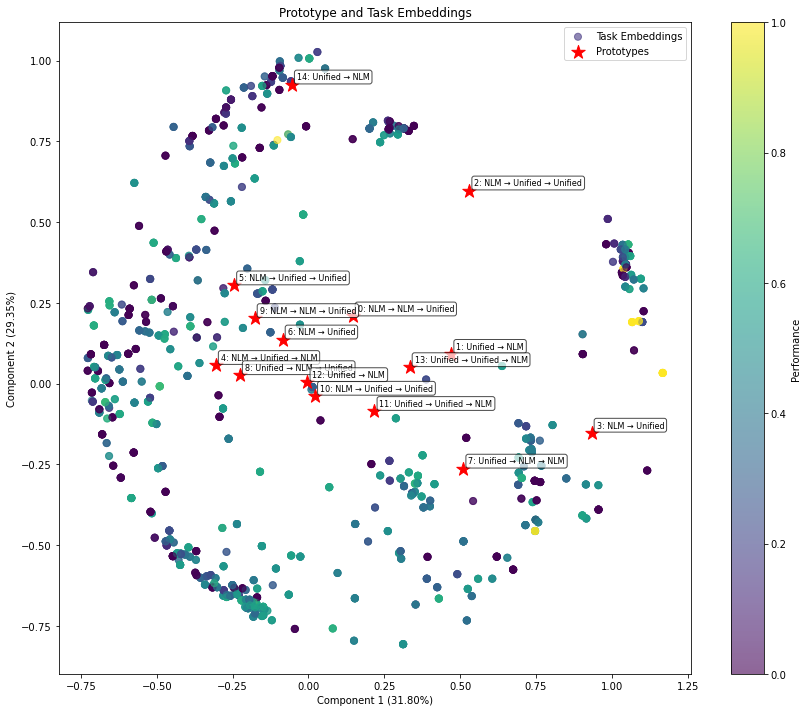

Training MCU:  45%|████▌     | 227/500 [24:16<12:41,  2.79s/it]

Iteration 227/500, Cell Accuracy: 0.4622, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  46%|████▌     | 228/500 [24:19<12:35,  2.78s/it]

Iteration 228/500, Cell Accuracy: 0.4959, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  46%|████▌     | 229/500 [24:24<15:31,  3.44s/it]

Iteration 229/500, Cell Accuracy: 0.4562, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  46%|████▌     | 230/500 [24:30<19:05,  4.24s/it]

Iteration 230/500, Cell Accuracy: 0.4752, Grid Accuracy: 0.0500, Epsilon: 0.0476
Iteration 231/500, Cell Accuracy: 0.3656, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_231.pt


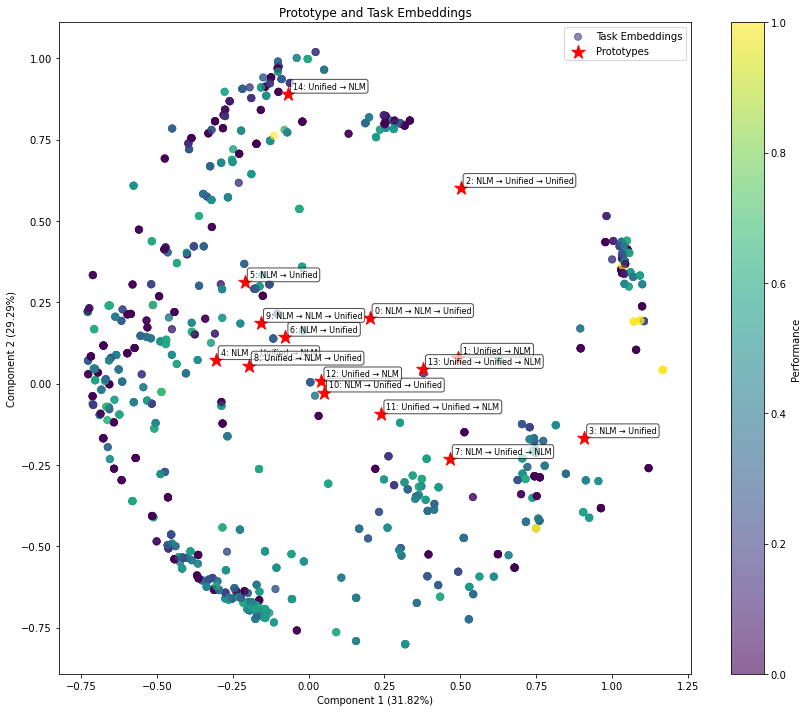

Training MCU:  46%|████▋     | 232/500 [24:47<29:30,  6.61s/it]

Iteration 232/500, Cell Accuracy: 0.5367, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  47%|████▋     | 233/500 [24:55<32:15,  7.25s/it]

Iteration 233/500, Cell Accuracy: 0.4819, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  47%|████▋     | 234/500 [24:57<24:51,  5.61s/it]

Iteration 234/500, Cell Accuracy: 0.4697, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  47%|████▋     | 235/500 [25:10<33:49,  7.66s/it]

Iteration 235/500, Cell Accuracy: 0.3428, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 236/500, Cell Accuracy: 0.5209, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_236.pt


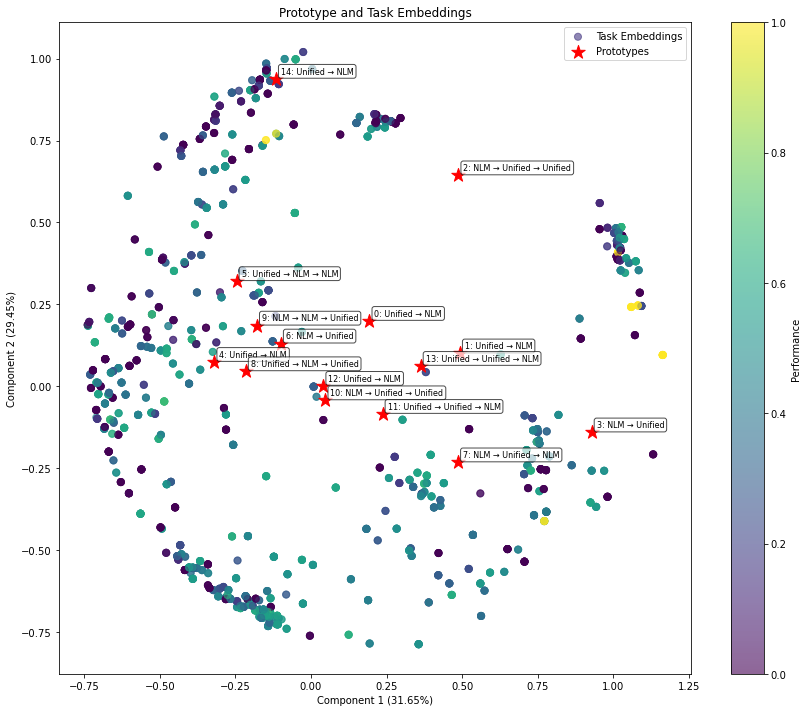

Training MCU:  47%|████▋     | 237/500 [25:35<44:42, 10.20s/it]

Iteration 237/500, Cell Accuracy: 0.2971, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  48%|████▊     | 238/500 [25:39<36:30,  8.36s/it]

Iteration 238/500, Cell Accuracy: 0.4625, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  48%|████▊     | 239/500 [25:43<30:39,  7.05s/it]

Iteration 239/500, Cell Accuracy: 0.3490, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  48%|████▊     | 240/500 [25:46<24:17,  5.61s/it]

Iteration 240/500, Cell Accuracy: 0.5536, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 241/500, Cell Accuracy: 0.4777, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_241.pt


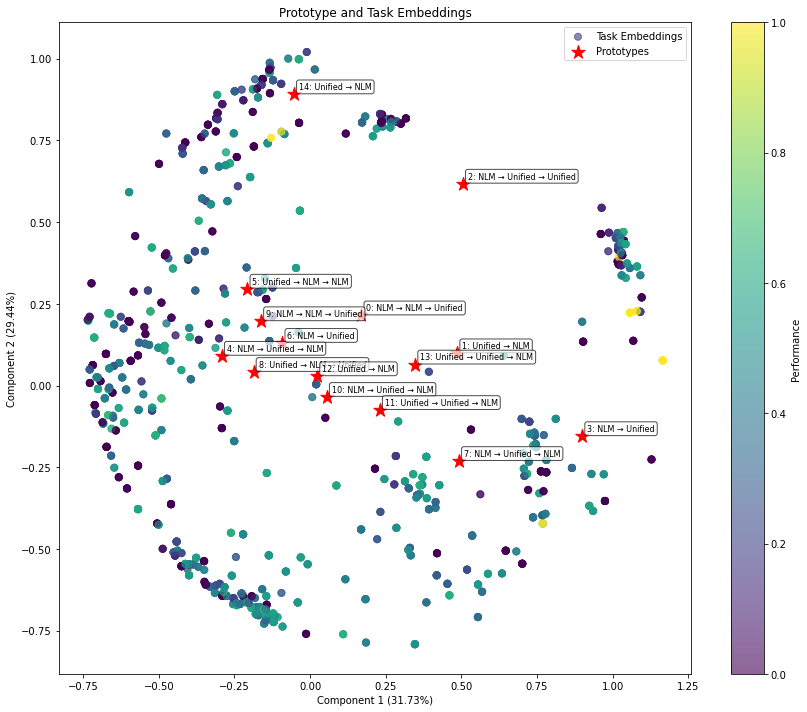

Training MCU:  48%|████▊     | 242/500 [25:54<20:23,  4.74s/it]

Iteration 242/500, Cell Accuracy: 0.5386, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  49%|████▊     | 243/500 [25:58<18:58,  4.43s/it]

Iteration 243/500, Cell Accuracy: 0.4022, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  49%|████▉     | 244/500 [26:01<16:40,  3.91s/it]

Iteration 244/500, Cell Accuracy: 0.4914, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  49%|████▉     | 245/500 [26:02<13:32,  3.19s/it]

Iteration 245/500, Cell Accuracy: 0.2531, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 246/500, Cell Accuracy: 0.6258, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_246.pt


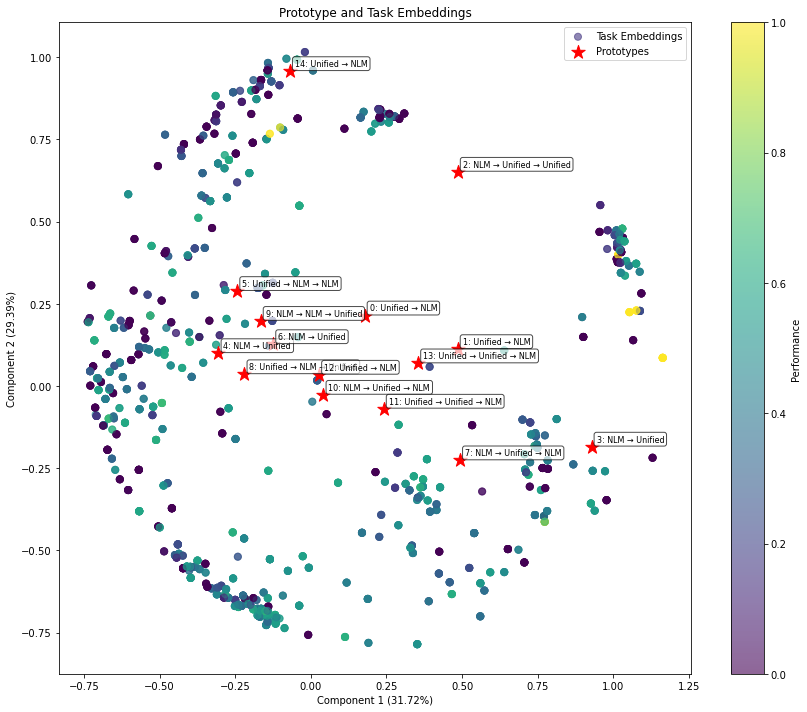

Training MCU:  49%|████▉     | 247/500 [26:22<27:28,  6.51s/it]

Iteration 247/500, Cell Accuracy: 0.5667, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  50%|████▉     | 248/500 [26:42<44:17, 10.55s/it]

Iteration 248/500, Cell Accuracy: 0.4681, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  50%|████▉     | 249/500 [26:44<33:20,  7.97s/it]

Iteration 249/500, Cell Accuracy: 0.2791, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  50%|█████     | 250/500 [26:46<26:19,  6.32s/it]

Iteration 250/500, Cell Accuracy: 0.4872, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 251/500, Cell Accuracy: 0.3773, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_251.pt


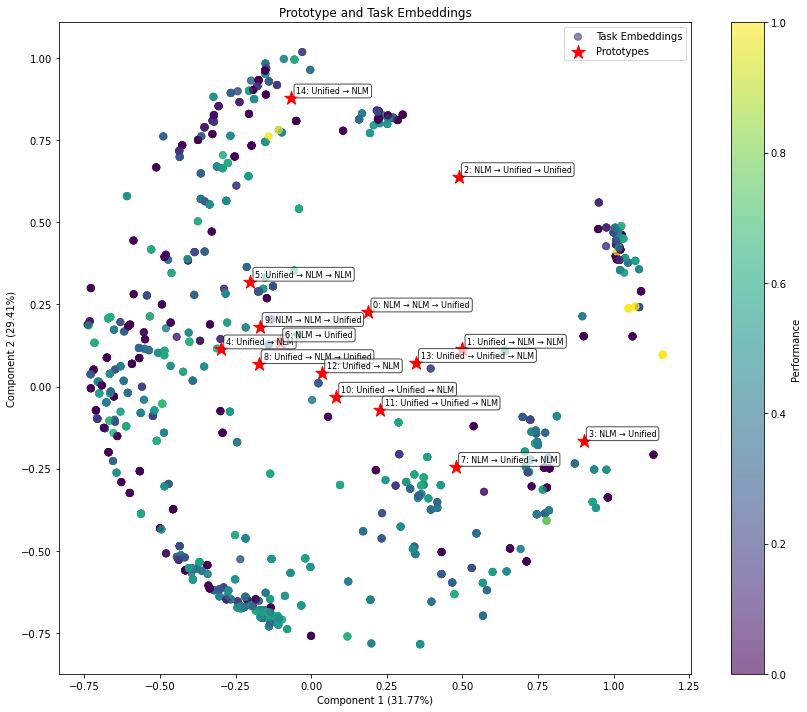

Training MCU:  50%|█████     | 252/500 [26:57<23:59,  5.81s/it]

Iteration 252/500, Cell Accuracy: 0.5116, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  51%|█████     | 253/500 [27:01<21:17,  5.17s/it]

Iteration 253/500, Cell Accuracy: 0.3210, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  51%|█████     | 254/500 [27:12<28:31,  6.96s/it]

Iteration 254/500, Cell Accuracy: 0.5521, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  51%|█████     | 255/500 [27:25<35:55,  8.80s/it]

Iteration 255/500, Cell Accuracy: 0.3562, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 256/500, Cell Accuracy: 0.7437, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_256.pt


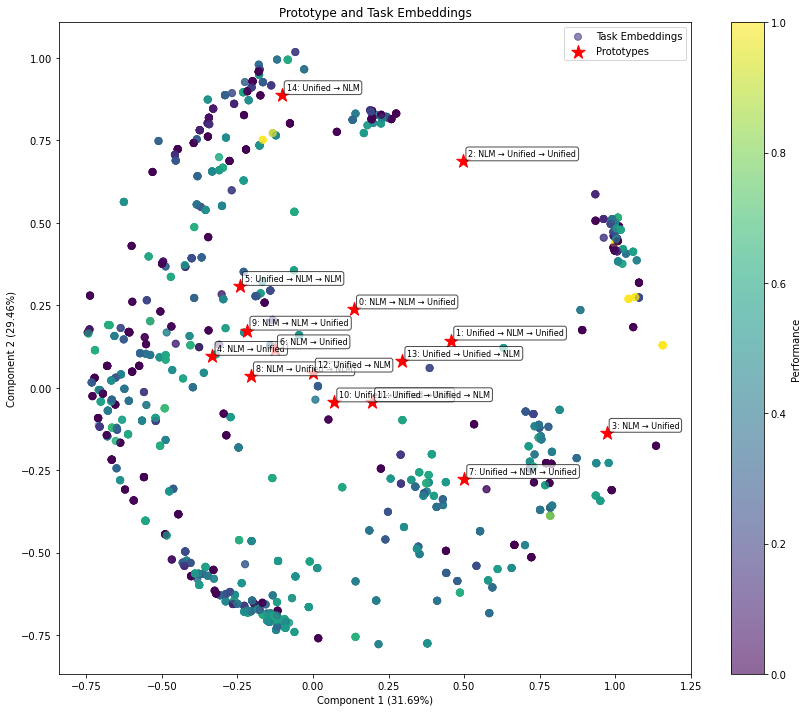

Training MCU:  51%|█████▏    | 257/500 [27:35<26:39,  6.58s/it]

Iteration 257/500, Cell Accuracy: 0.4439, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  52%|█████▏    | 258/500 [27:40<24:23,  6.05s/it]

Iteration 258/500, Cell Accuracy: 0.4500, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  52%|█████▏    | 259/500 [27:42<19:46,  4.92s/it]

Iteration 259/500, Cell Accuracy: 0.4178, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  52%|█████▏    | 260/500 [27:49<22:23,  5.60s/it]

Iteration 260/500, Cell Accuracy: 0.3651, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 261/500, Cell Accuracy: 0.5126, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_261.pt


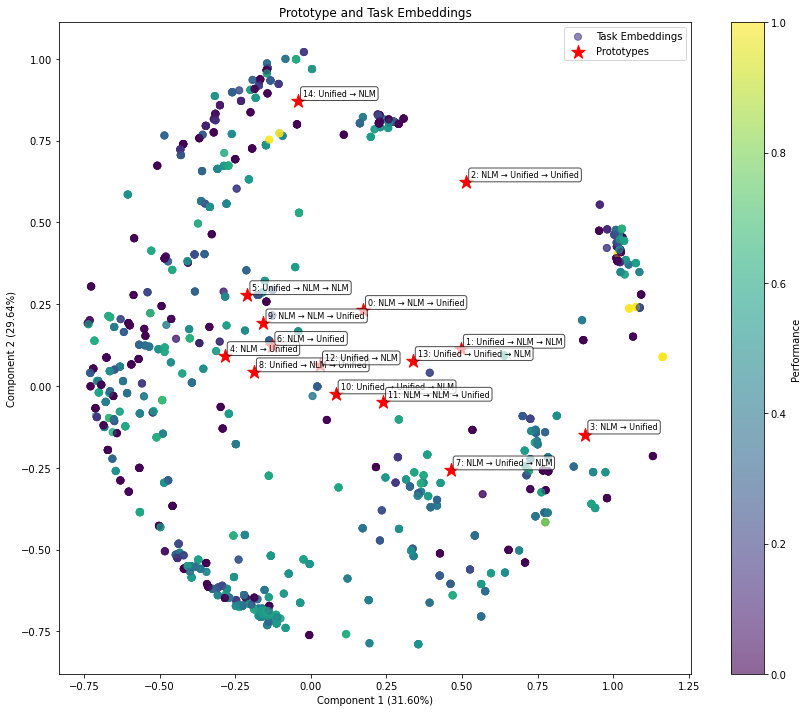

Training MCU:  52%|█████▏    | 262/500 [27:59<20:15,  5.11s/it]

Iteration 262/500, Cell Accuracy: 0.5051, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  53%|█████▎    | 263/500 [28:01<16:19,  4.13s/it]

Iteration 263/500, Cell Accuracy: 0.4400, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  53%|█████▎    | 264/500 [28:02<12:31,  3.18s/it]

Iteration 264/500, Cell Accuracy: 0.5611, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  53%|█████▎    | 265/500 [28:07<14:21,  3.67s/it]

Iteration 265/500, Cell Accuracy: 0.4540, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 266/500, Cell Accuracy: 0.3880, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_266.pt


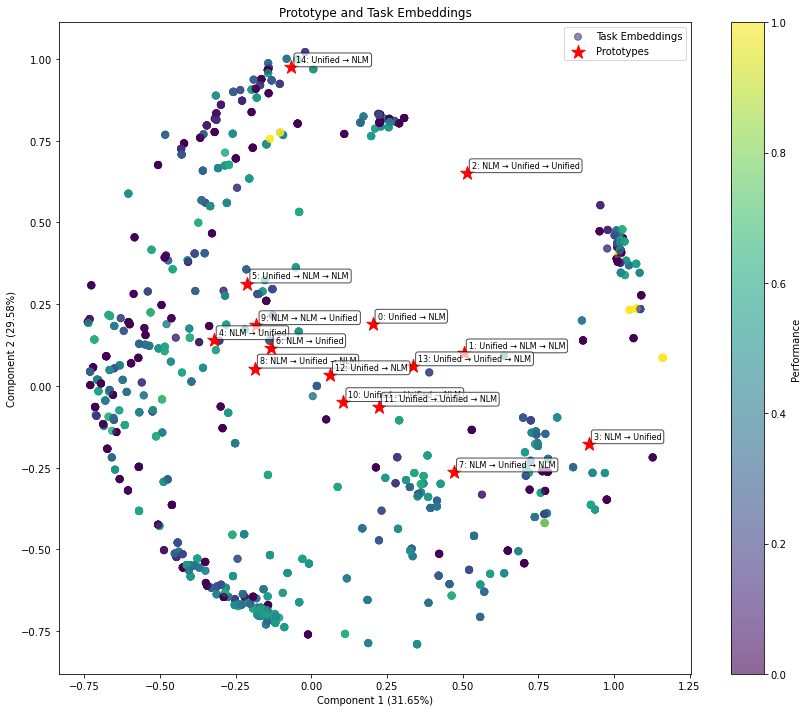

Training MCU:  53%|█████▎    | 267/500 [28:27<26:33,  6.84s/it]

Iteration 267/500, Cell Accuracy: 0.3941, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  54%|█████▎    | 268/500 [28:37<30:56,  8.00s/it]

Iteration 268/500, Cell Accuracy: 0.4366, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  54%|█████▍    | 269/500 [28:39<23:46,  6.18s/it]

Iteration 269/500, Cell Accuracy: 0.4436, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  54%|█████▍    | 270/500 [28:47<25:44,  6.72s/it]

Iteration 270/500, Cell Accuracy: 0.5340, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 271/500, Cell Accuracy: 0.4986, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_271.pt


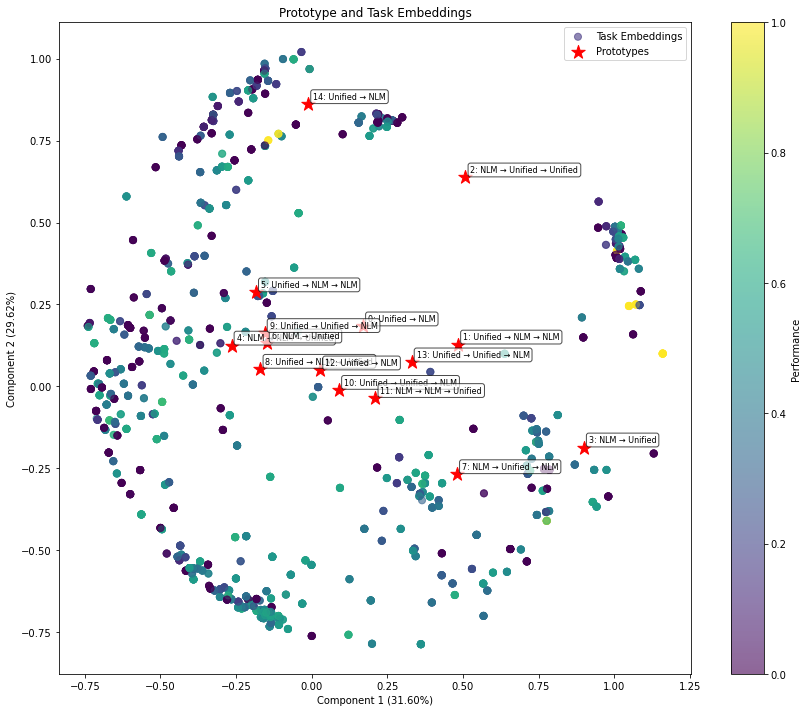

Training MCU:  54%|█████▍    | 272/500 [29:01<25:13,  6.64s/it]

Iteration 272/500, Cell Accuracy: 0.4706, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  55%|█████▍    | 273/500 [29:02<18:47,  4.97s/it]

Iteration 273/500, Cell Accuracy: 0.5798, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  55%|█████▍    | 274/500 [29:03<15:00,  3.99s/it]

Iteration 274/500, Cell Accuracy: 0.3534, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  55%|█████▌    | 275/500 [29:05<11:47,  3.15s/it]

Iteration 275/500, Cell Accuracy: 0.5769, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 276/500, Cell Accuracy: 0.6474, Grid Accuracy: 0.0500, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_276.pt


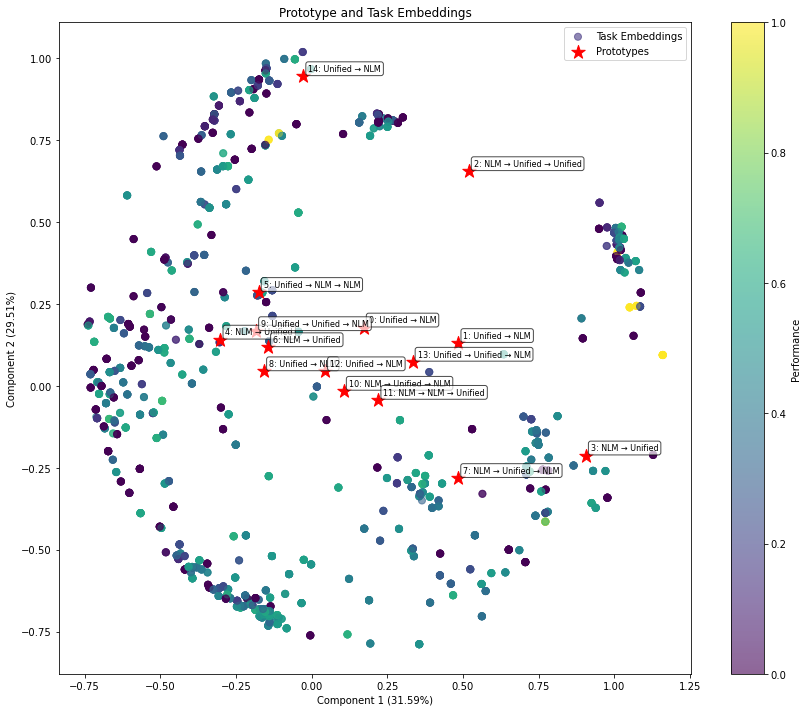

Training MCU:  55%|█████▌    | 277/500 [29:16<15:47,  4.25s/it]

Iteration 277/500, Cell Accuracy: 0.4253, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  56%|█████▌    | 278/500 [29:18<13:25,  3.63s/it]

Iteration 278/500, Cell Accuracy: 0.4729, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  56%|█████▌    | 279/500 [29:19<10:50,  2.94s/it]

Iteration 279/500, Cell Accuracy: 0.6903, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  56%|█████▌    | 280/500 [29:25<13:39,  3.73s/it]

Iteration 280/500, Cell Accuracy: 0.4623, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 281/500, Cell Accuracy: 0.5017, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_281.pt


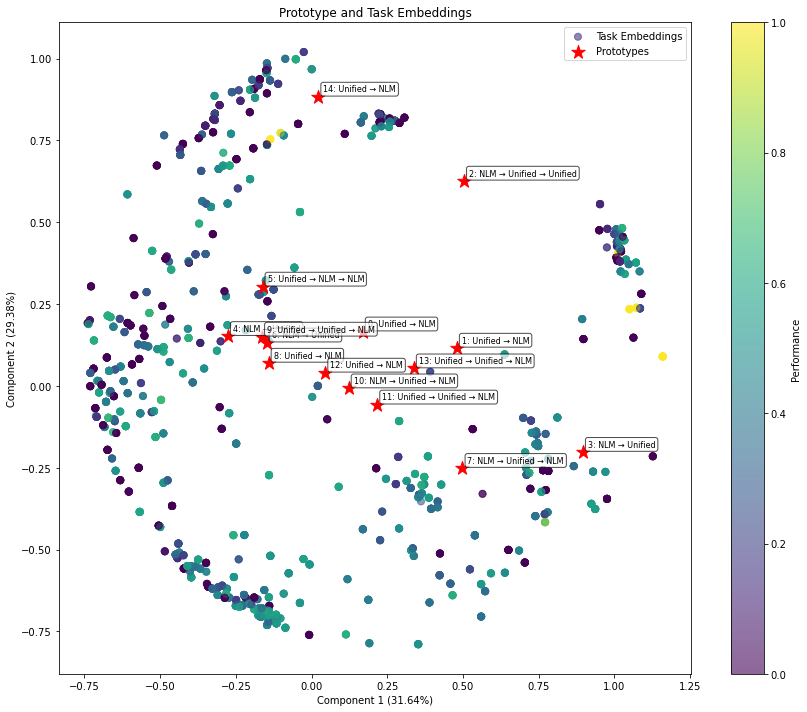

Training MCU:  56%|█████▋    | 282/500 [29:35<14:43,  4.05s/it]

Iteration 282/500, Cell Accuracy: 0.5554, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  57%|█████▋    | 283/500 [29:40<16:40,  4.61s/it]

Iteration 283/500, Cell Accuracy: 0.5766, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  57%|█████▋    | 284/500 [29:46<17:25,  4.84s/it]

Iteration 284/500, Cell Accuracy: 0.4225, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  57%|█████▋    | 285/500 [29:47<13:33,  3.78s/it]

Iteration 285/500, Cell Accuracy: 0.7050, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 286/500, Cell Accuracy: 0.4984, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_286.pt


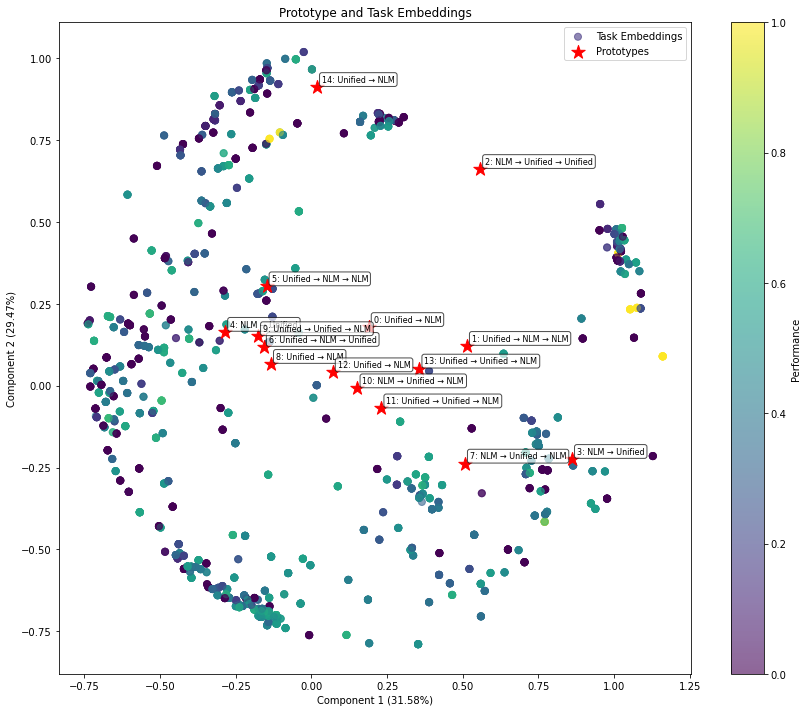

Training MCU:  57%|█████▋    | 287/500 [29:57<14:34,  4.10s/it]

Iteration 287/500, Cell Accuracy: 0.5282, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  58%|█████▊    | 288/500 [30:01<14:28,  4.10s/it]

Iteration 288/500, Cell Accuracy: 0.4339, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  58%|█████▊    | 289/500 [30:05<13:58,  3.97s/it]

Iteration 289/500, Cell Accuracy: 0.4538, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  58%|█████▊    | 290/500 [30:09<13:22,  3.82s/it]

Iteration 290/500, Cell Accuracy: 0.5454, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 291/500, Cell Accuracy: 0.4992, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_291.pt


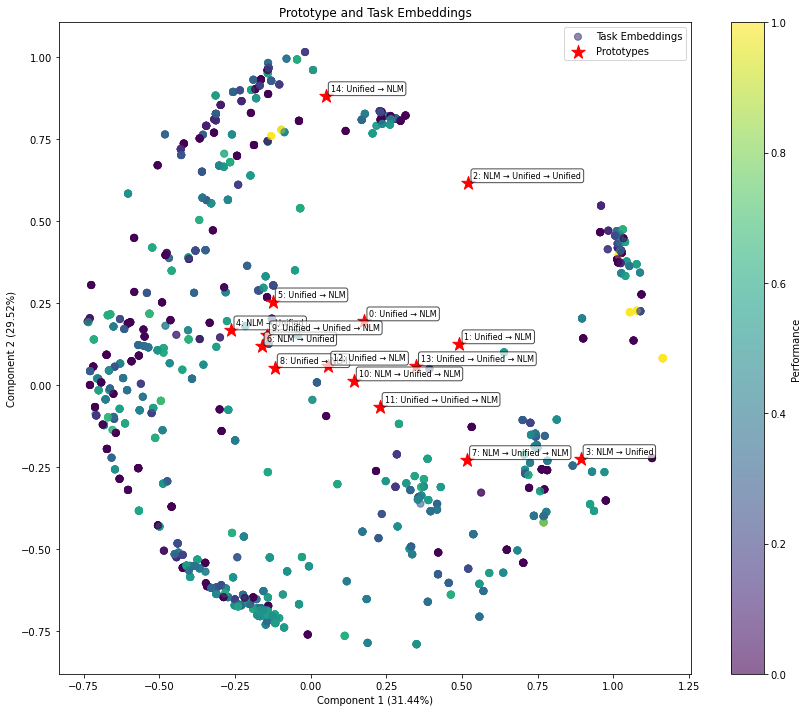

Training MCU:  58%|█████▊    | 292/500 [30:20<16:54,  4.88s/it]

Iteration 292/500, Cell Accuracy: 0.5354, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  59%|█████▊    | 293/500 [30:23<14:22,  4.16s/it]

Iteration 293/500, Cell Accuracy: 0.6536, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  59%|█████▉    | 294/500 [30:32<19:14,  5.60s/it]

Iteration 294/500, Cell Accuracy: 0.5923, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  59%|█████▉    | 295/500 [30:36<17:38,  5.16s/it]

Iteration 295/500, Cell Accuracy: 0.4350, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 296/500, Cell Accuracy: 0.3063, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_296.pt


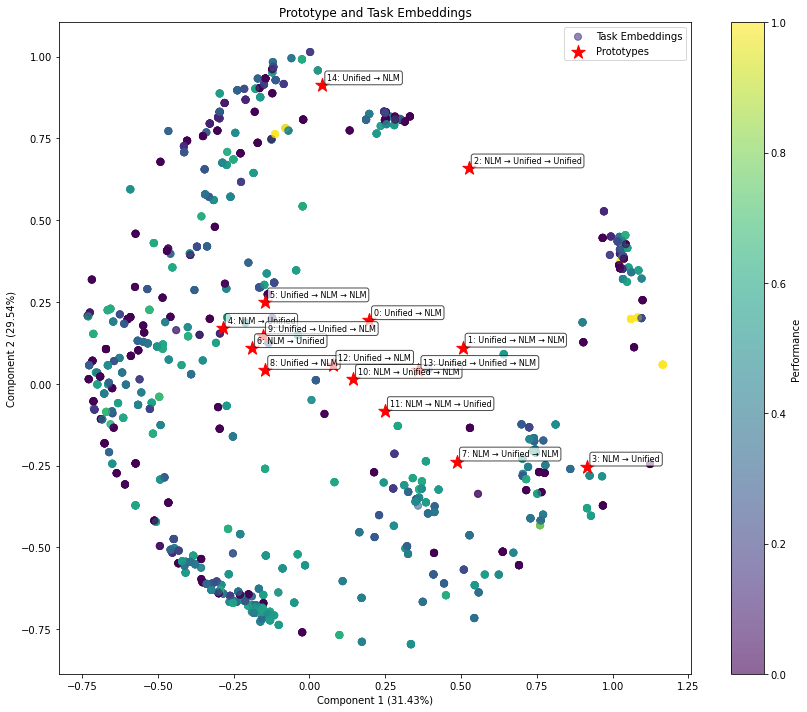

Training MCU:  59%|█████▉    | 297/500 [30:53<23:54,  7.07s/it]

Iteration 297/500, Cell Accuracy: 0.6221, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  60%|█████▉    | 298/500 [31:01<24:29,  7.27s/it]

Iteration 298/500, Cell Accuracy: 0.3002, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  60%|█████▉    | 299/500 [31:03<18:59,  5.67s/it]

Iteration 299/500, Cell Accuracy: 0.6506, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  60%|██████    | 300/500 [31:14<24:27,  7.34s/it]

Iteration 300/500, Cell Accuracy: 0.4151, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 301/500, Cell Accuracy: 0.4951, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_301.pt


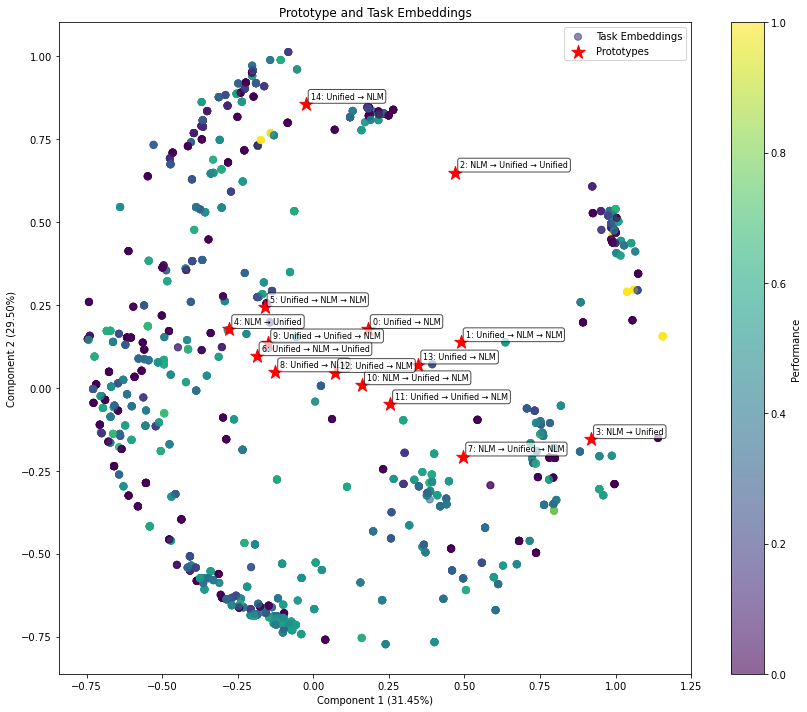

Training MCU:  60%|██████    | 302/500 [31:25<19:50,  6.01s/it]

Iteration 302/500, Cell Accuracy: 0.4804, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  61%|██████    | 303/500 [31:27<15:44,  4.79s/it]

Iteration 303/500, Cell Accuracy: 0.7474, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  61%|██████    | 304/500 [31:28<12:06,  3.71s/it]

Iteration 304/500, Cell Accuracy: 0.4980, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  61%|██████    | 305/500 [31:30<09:49,  3.02s/it]

Iteration 305/500, Cell Accuracy: 0.3899, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 306/500, Cell Accuracy: 0.6088, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_306.pt


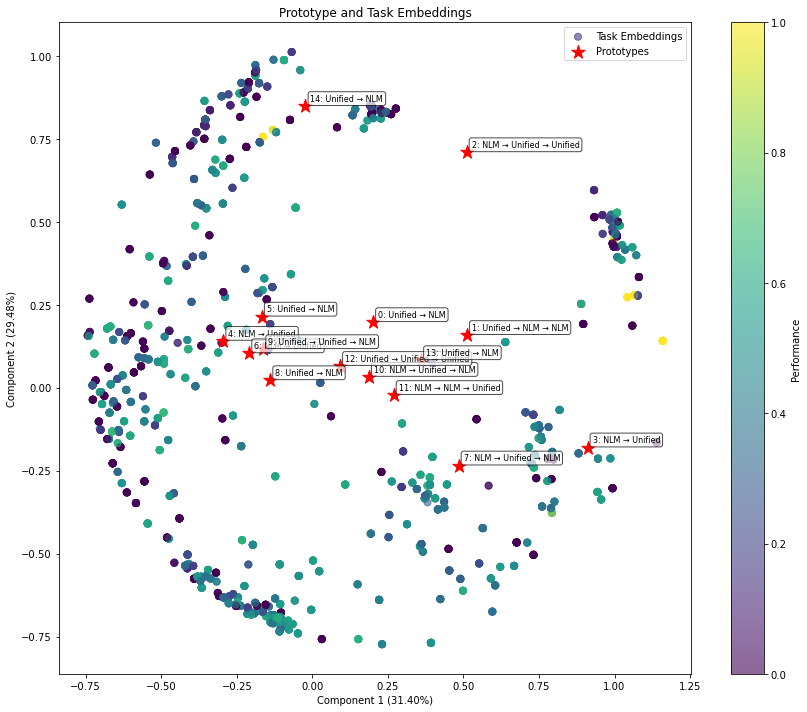

Training MCU:  61%|██████▏   | 307/500 [31:51<23:29,  7.30s/it]

Iteration 307/500, Cell Accuracy: 0.3853, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  62%|██████▏   | 308/500 [31:55<19:32,  6.11s/it]

Iteration 308/500, Cell Accuracy: 0.3339, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  62%|██████▏   | 309/500 [31:57<15:23,  4.84s/it]

Iteration 309/500, Cell Accuracy: 0.5856, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  62%|██████▏   | 310/500 [31:58<12:22,  3.91s/it]

Iteration 310/500, Cell Accuracy: 0.5534, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 311/500, Cell Accuracy: 0.4451, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_311.pt


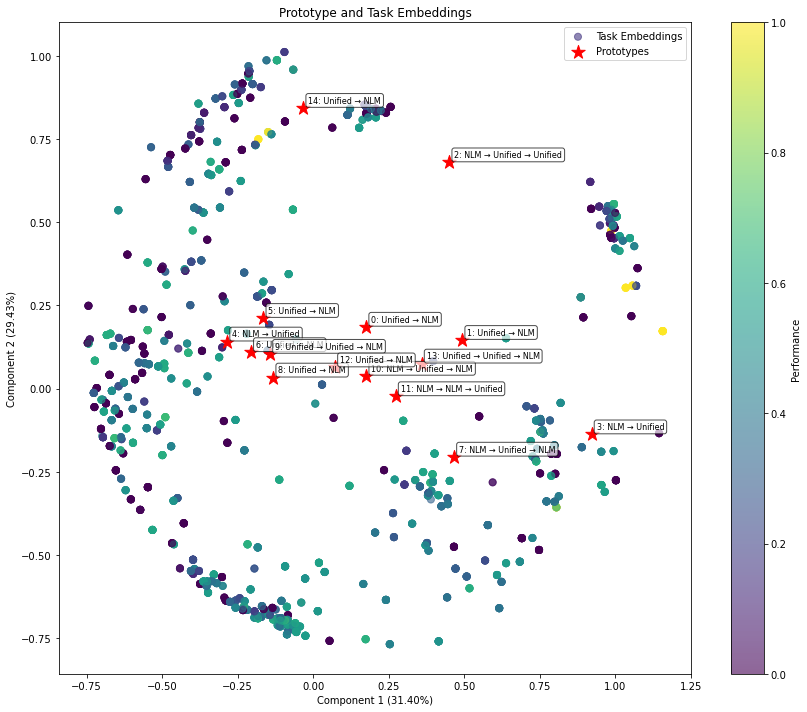

Training MCU:  62%|██████▏   | 312/500 [32:13<18:10,  5.80s/it]

Iteration 312/500, Cell Accuracy: 0.3582, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  63%|██████▎   | 313/500 [32:22<20:47,  6.67s/it]

Iteration 313/500, Cell Accuracy: 0.6334, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  63%|██████▎   | 314/500 [32:25<17:06,  5.52s/it]

Iteration 314/500, Cell Accuracy: 0.5525, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  63%|██████▎   | 315/500 [32:31<17:32,  5.69s/it]

Iteration 315/500, Cell Accuracy: 0.3988, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 316/500, Cell Accuracy: 0.6142, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_316.pt


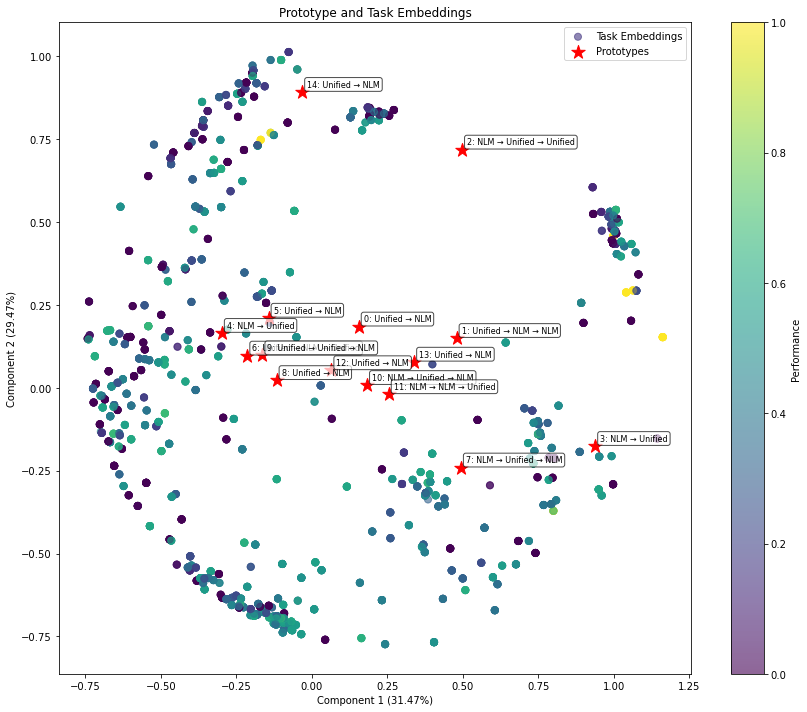

Training MCU:  63%|██████▎   | 317/500 [32:41<15:28,  5.07s/it]

Iteration 317/500, Cell Accuracy: 0.4550, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  64%|██████▎   | 318/500 [32:48<17:32,  5.78s/it]

Iteration 318/500, Cell Accuracy: 0.3658, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  64%|██████▍   | 319/500 [32:50<13:54,  4.61s/it]

Iteration 319/500, Cell Accuracy: 0.4543, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  64%|██████▍   | 320/500 [32:55<13:46,  4.59s/it]

Iteration 320/500, Cell Accuracy: 0.4608, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 321/500, Cell Accuracy: 0.3292, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_321.pt


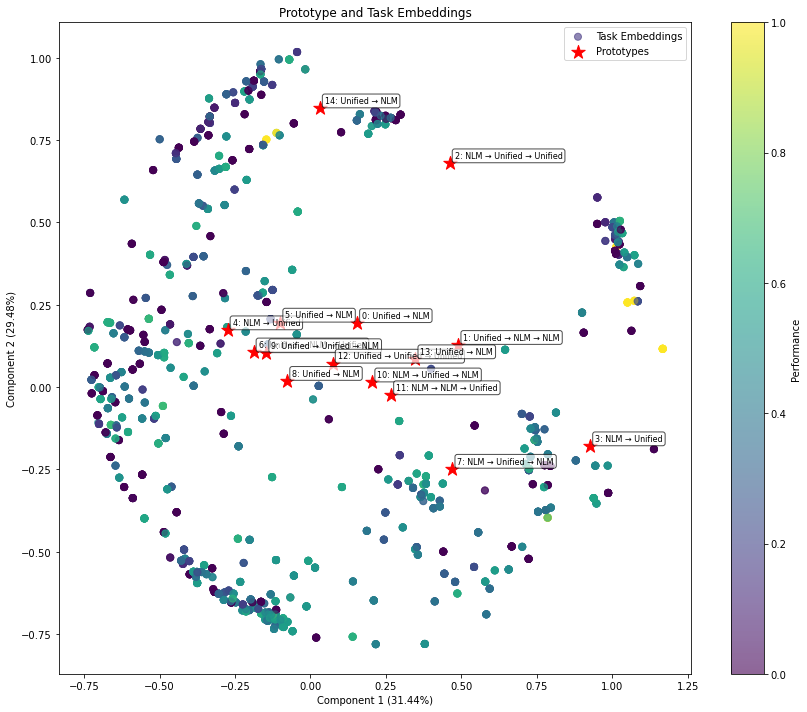

Training MCU:  64%|██████▍   | 322/500 [33:04<12:47,  4.31s/it]

Iteration 322/500, Cell Accuracy: 0.5309, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  65%|██████▍   | 323/500 [33:11<15:29,  5.25s/it]

Iteration 323/500, Cell Accuracy: 0.6197, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  65%|██████▍   | 324/500 [33:22<20:23,  6.95s/it]

Iteration 324/500, Cell Accuracy: 0.4835, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  65%|██████▌   | 325/500 [33:25<16:36,  5.69s/it]

Iteration 325/500, Cell Accuracy: 0.5717, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 326/500, Cell Accuracy: 0.3665, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_326.pt


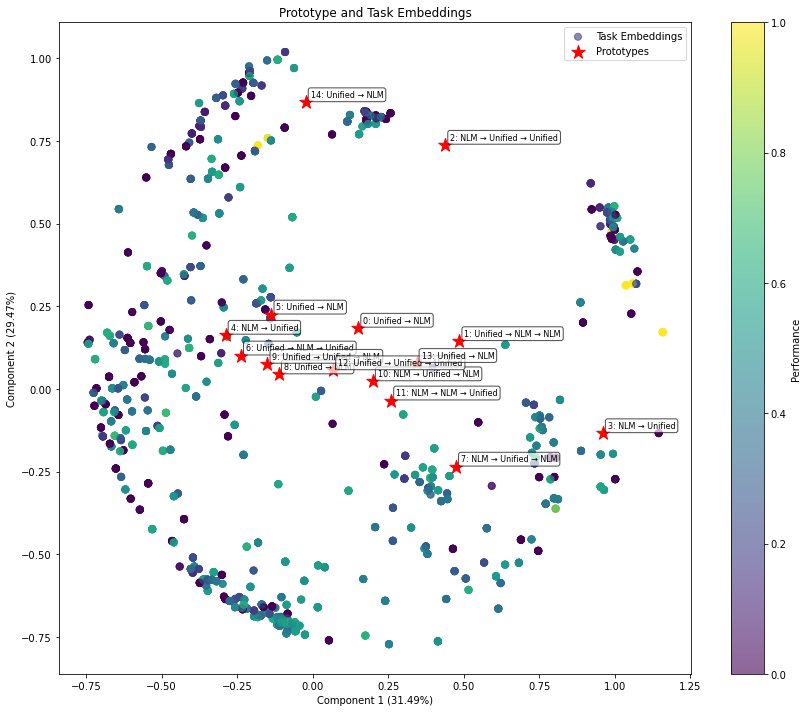

Training MCU:  65%|██████▌   | 327/500 [33:36<15:48,  5.48s/it]

Iteration 327/500, Cell Accuracy: 0.4932, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  66%|██████▌   | 328/500 [33:49<21:51,  7.62s/it]

Iteration 328/500, Cell Accuracy: 0.5630, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  66%|██████▌   | 329/500 [33:54<19:23,  6.81s/it]

Iteration 329/500, Cell Accuracy: 0.3415, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  66%|██████▌   | 330/500 [33:55<14:52,  5.25s/it]

Iteration 330/500, Cell Accuracy: 0.6563, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 331/500, Cell Accuracy: 0.5673, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_331.pt


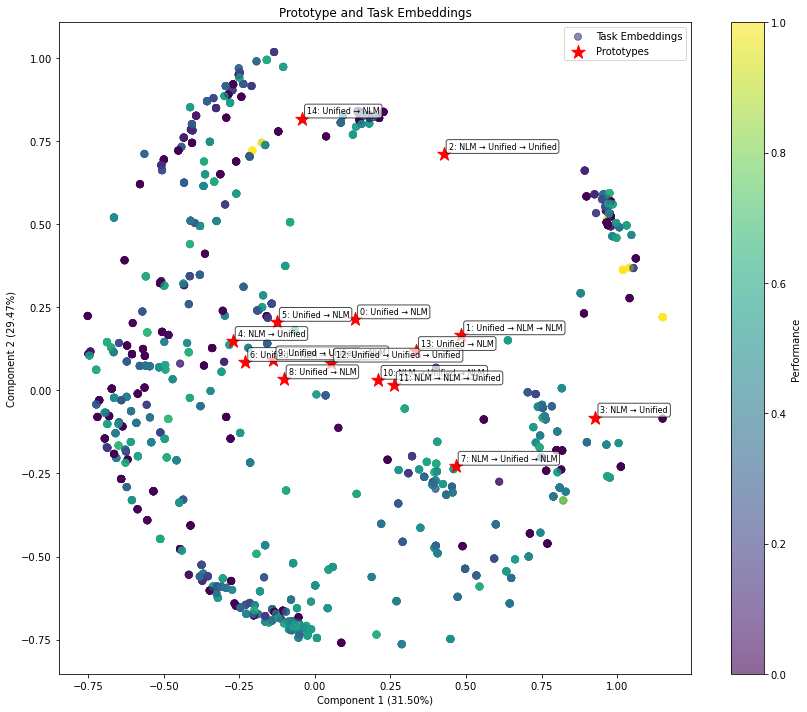

Training MCU:  66%|██████▋   | 332/500 [34:05<13:17,  4.75s/it]

Iteration 332/500, Cell Accuracy: 0.4904, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  67%|██████▋   | 333/500 [34:08<11:55,  4.28s/it]

Iteration 333/500, Cell Accuracy: 0.4851, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  67%|██████▋   | 334/500 [34:11<10:48,  3.91s/it]

Iteration 334/500, Cell Accuracy: 0.5960, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  67%|██████▋   | 335/500 [34:12<08:42,  3.17s/it]

Iteration 335/500, Cell Accuracy: 0.4160, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 336/500, Cell Accuracy: 0.4373, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_336.pt


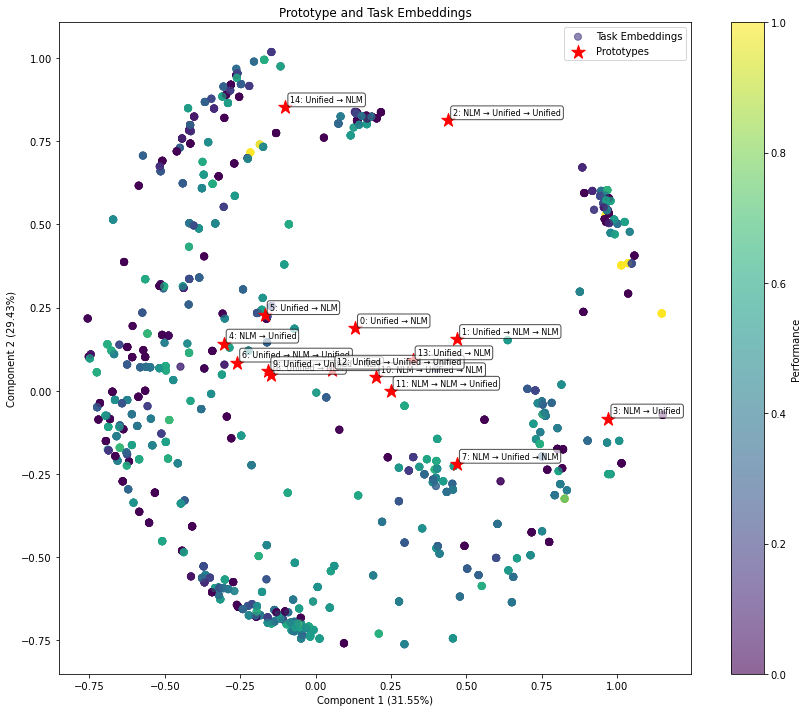

Training MCU:  67%|██████▋   | 337/500 [34:25<12:19,  4.54s/it]

Iteration 337/500, Cell Accuracy: 0.2908, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  68%|██████▊   | 338/500 [34:28<10:33,  3.91s/it]

Iteration 338/500, Cell Accuracy: 0.3329, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  68%|██████▊   | 339/500 [34:29<08:34,  3.19s/it]

Iteration 339/500, Cell Accuracy: 0.5523, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  68%|██████▊   | 340/500 [34:30<06:50,  2.56s/it]

Iteration 340/500, Cell Accuracy: 0.3444, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 341/500, Cell Accuracy: 0.5283, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_341.pt


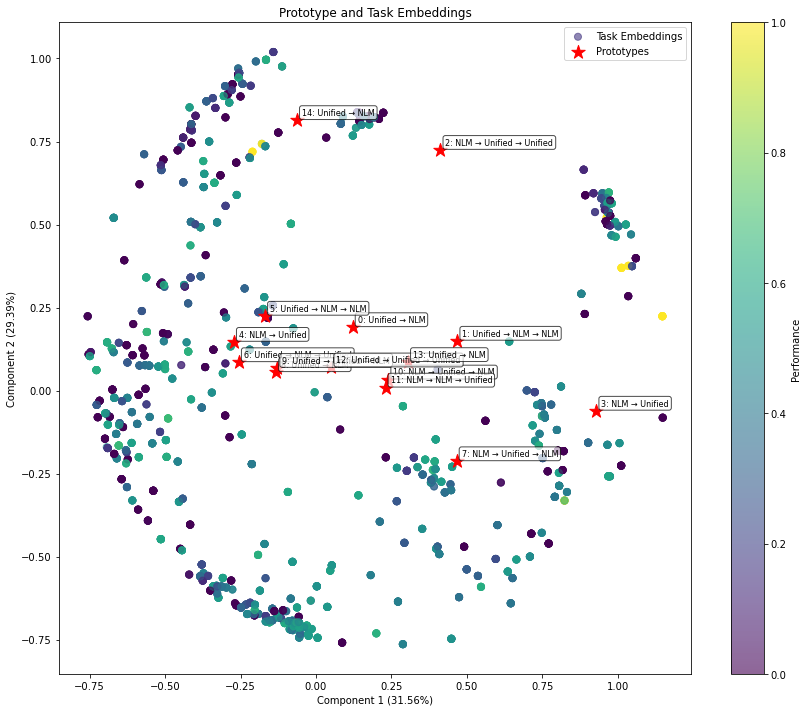

Training MCU:  68%|██████▊   | 342/500 [34:47<13:27,  5.11s/it]

Iteration 342/500, Cell Accuracy: 0.5971, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  69%|██████▊   | 343/500 [34:49<11:06,  4.25s/it]

Iteration 343/500, Cell Accuracy: 0.4513, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  69%|██████▉   | 344/500 [34:52<10:22,  3.99s/it]

Iteration 344/500, Cell Accuracy: 0.4697, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  69%|██████▉   | 345/500 [34:59<12:42,  4.92s/it]

Iteration 345/500, Cell Accuracy: 0.3546, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 346/500, Cell Accuracy: 0.4136, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_346.pt


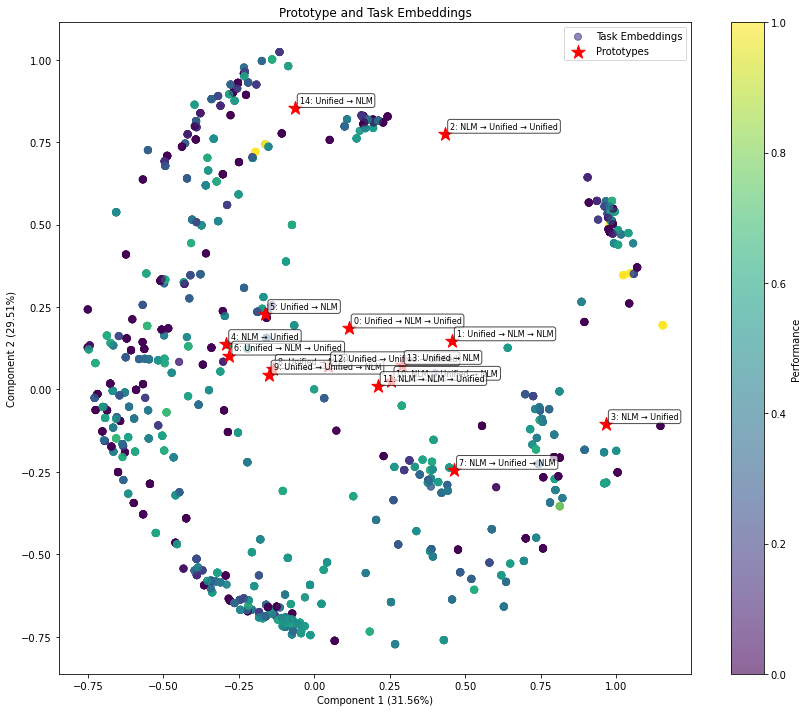

Training MCU:  69%|██████▉   | 347/500 [35:19<17:43,  6.95s/it]

Iteration 347/500, Cell Accuracy: 0.3224, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  70%|██████▉   | 348/500 [35:23<15:23,  6.07s/it]

Iteration 348/500, Cell Accuracy: 0.4690, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  70%|██████▉   | 349/500 [35:25<12:22,  4.92s/it]

Iteration 349/500, Cell Accuracy: 0.4929, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  70%|███████   | 350/500 [35:28<10:47,  4.32s/it]

Iteration 350/500, Cell Accuracy: 0.5316, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 351/500, Cell Accuracy: 0.4238, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_351.pt


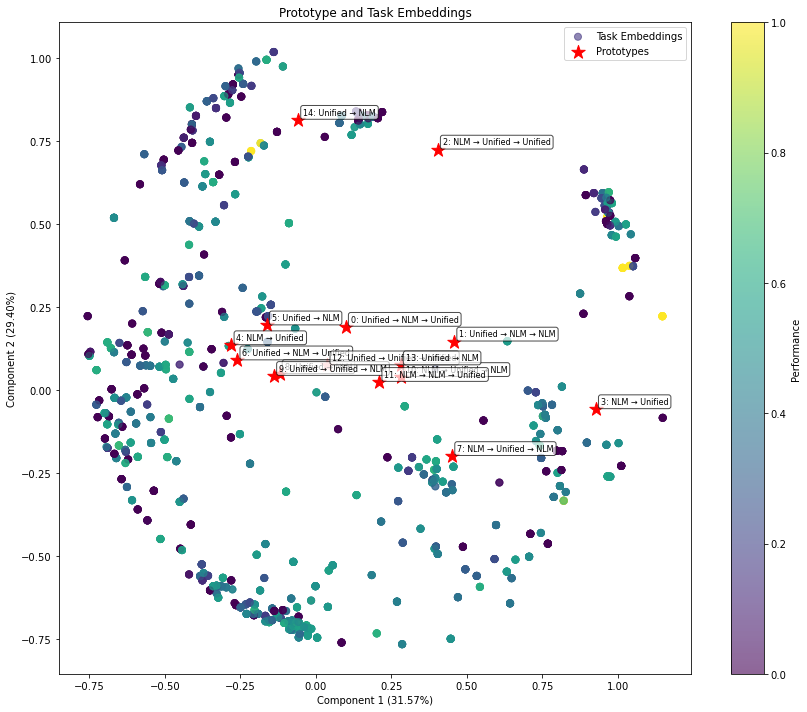

Training MCU:  70%|███████   | 352/500 [35:38<10:20,  4.19s/it]

Iteration 352/500, Cell Accuracy: 0.6603, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  71%|███████   | 353/500 [35:43<10:50,  4.42s/it]

Iteration 353/500, Cell Accuracy: 0.5292, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  71%|███████   | 354/500 [35:53<15:23,  6.33s/it]

Iteration 354/500, Cell Accuracy: 0.4572, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  71%|███████   | 355/500 [35:55<11:38,  4.82s/it]

Iteration 355/500, Cell Accuracy: 0.5610, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 356/500, Cell Accuracy: 0.6375, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_356.pt


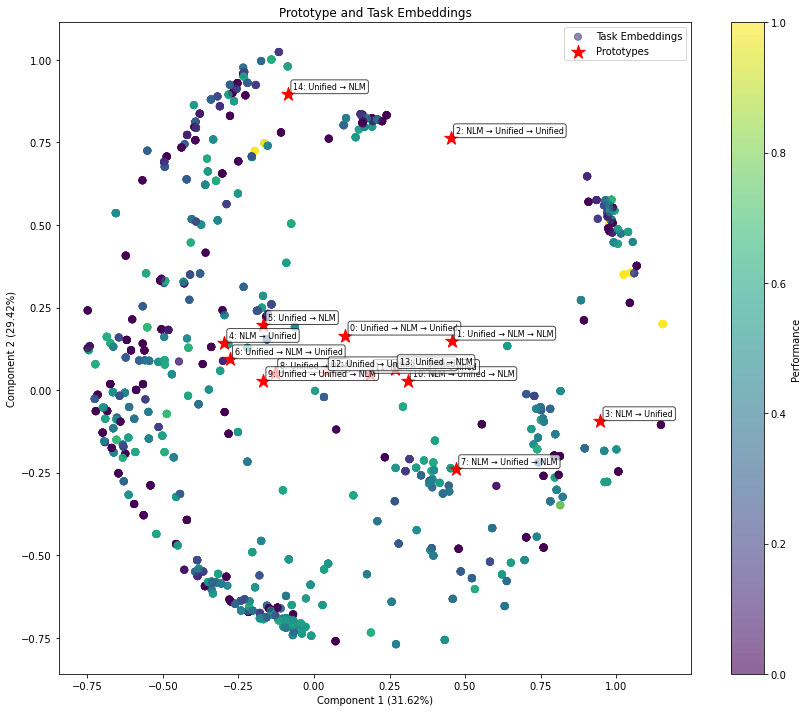

Training MCU:  71%|███████▏  | 357/500 [36:21<21:07,  8.87s/it]

Iteration 357/500, Cell Accuracy: 0.4869, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  72%|███████▏  | 358/500 [36:35<24:27, 10.33s/it]

Iteration 358/500, Cell Accuracy: 0.3767, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  72%|███████▏  | 359/500 [36:39<19:52,  8.46s/it]

Iteration 359/500, Cell Accuracy: 0.4964, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  72%|███████▏  | 360/500 [36:40<14:40,  6.29s/it]

Iteration 360/500, Cell Accuracy: 0.5282, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 361/500, Cell Accuracy: 0.6032, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_361.pt


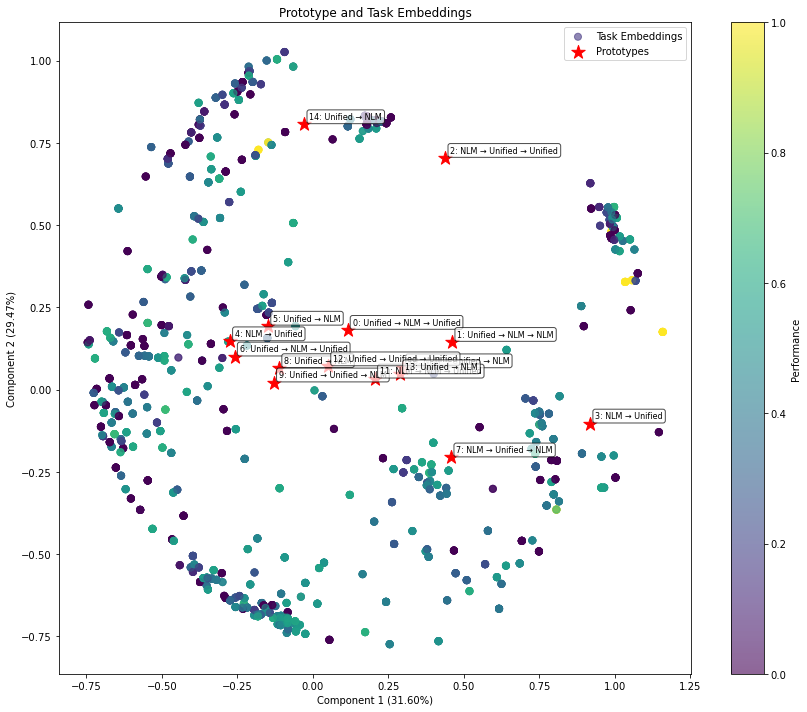

Training MCU:  72%|███████▏  | 362/500 [36:50<12:10,  5.30s/it]

Iteration 362/500, Cell Accuracy: 0.5203, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  73%|███████▎  | 363/500 [36:55<11:56,  5.23s/it]

Iteration 363/500, Cell Accuracy: 0.4678, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  73%|███████▎  | 364/500 [36:57<10:13,  4.51s/it]

Iteration 364/500, Cell Accuracy: 0.4493, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  73%|███████▎  | 365/500 [37:03<10:55,  4.85s/it]

Iteration 365/500, Cell Accuracy: 0.3457, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 366/500, Cell Accuracy: 0.5541, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_366.pt


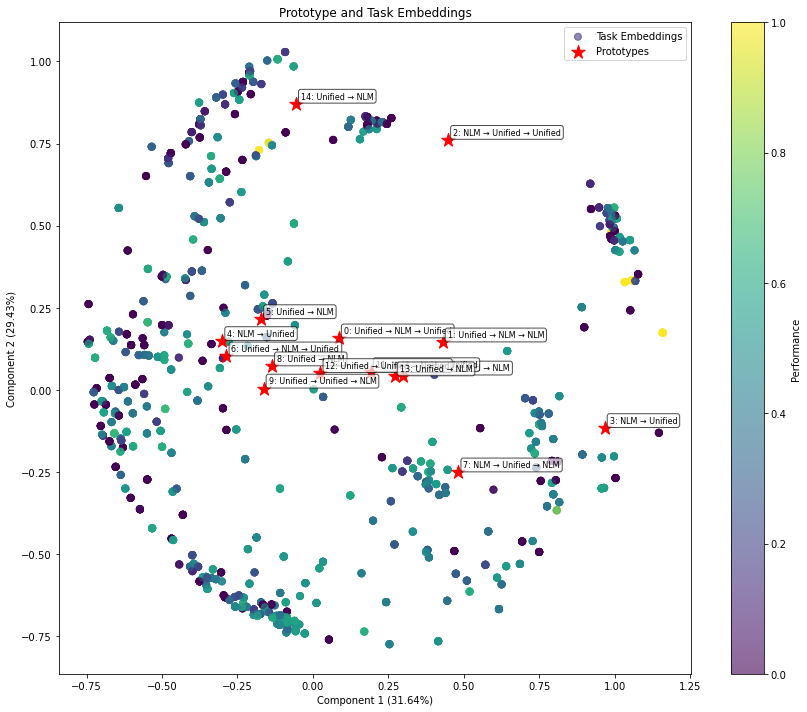

Training MCU:  73%|███████▎  | 367/500 [37:11<09:08,  4.13s/it]

Iteration 367/500, Cell Accuracy: 0.5626, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  74%|███████▎  | 368/500 [37:22<13:44,  6.25s/it]

Iteration 368/500, Cell Accuracy: 0.2094, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  74%|███████▍  | 369/500 [37:23<10:21,  4.75s/it]

Iteration 369/500, Cell Accuracy: 0.7148, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  74%|███████▍  | 370/500 [37:28<10:13,  4.72s/it]

Iteration 370/500, Cell Accuracy: 0.4479, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 371/500, Cell Accuracy: 0.4537, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_371.pt


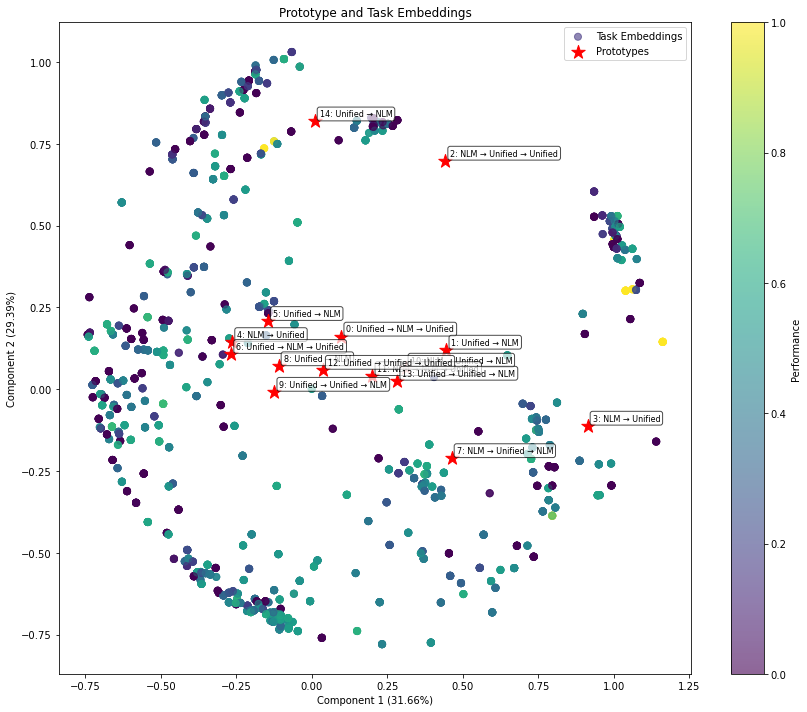

Training MCU:  74%|███████▍  | 372/500 [37:38<09:44,  4.56s/it]

Iteration 372/500, Cell Accuracy: 0.4969, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  75%|███████▍  | 373/500 [37:41<08:26,  3.99s/it]

Iteration 373/500, Cell Accuracy: 0.3972, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  75%|███████▍  | 374/500 [37:42<06:45,  3.22s/it]

Iteration 374/500, Cell Accuracy: 0.5932, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  75%|███████▌  | 375/500 [37:46<07:14,  3.48s/it]

Iteration 375/500, Cell Accuracy: 0.3550, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 376/500, Cell Accuracy: 0.5480, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_376.pt


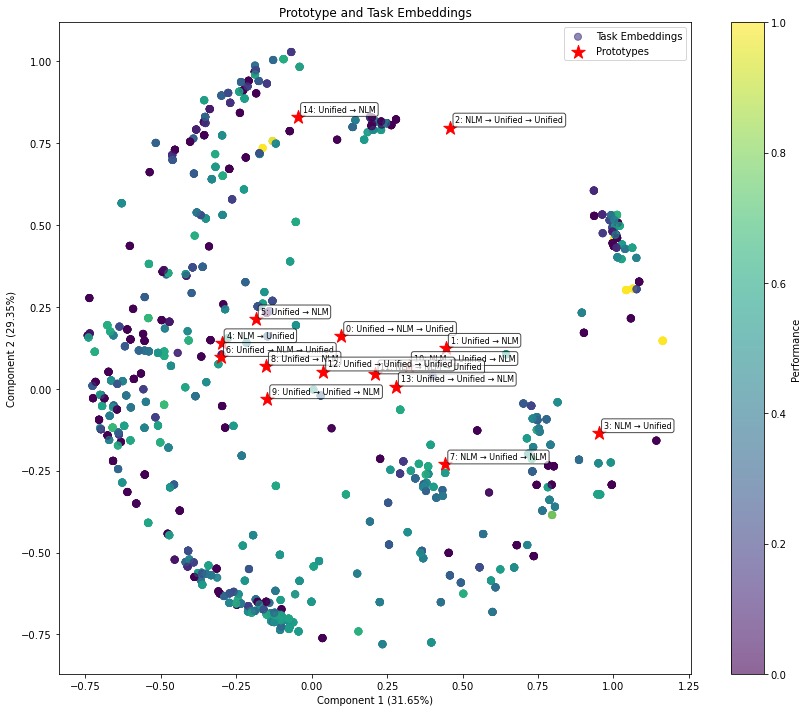

Training MCU:  75%|███████▌  | 377/500 [38:03<11:38,  5.68s/it]

Iteration 377/500, Cell Accuracy: 0.4998, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  76%|███████▌  | 378/500 [38:07<10:12,  5.02s/it]

Iteration 378/500, Cell Accuracy: 0.5683, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  76%|███████▌  | 379/500 [38:09<08:33,  4.24s/it]

Iteration 379/500, Cell Accuracy: 0.6583, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  76%|███████▌  | 380/500 [38:14<08:45,  4.38s/it]

Iteration 380/500, Cell Accuracy: 0.4900, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 381/500, Cell Accuracy: 0.6200, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_381.pt


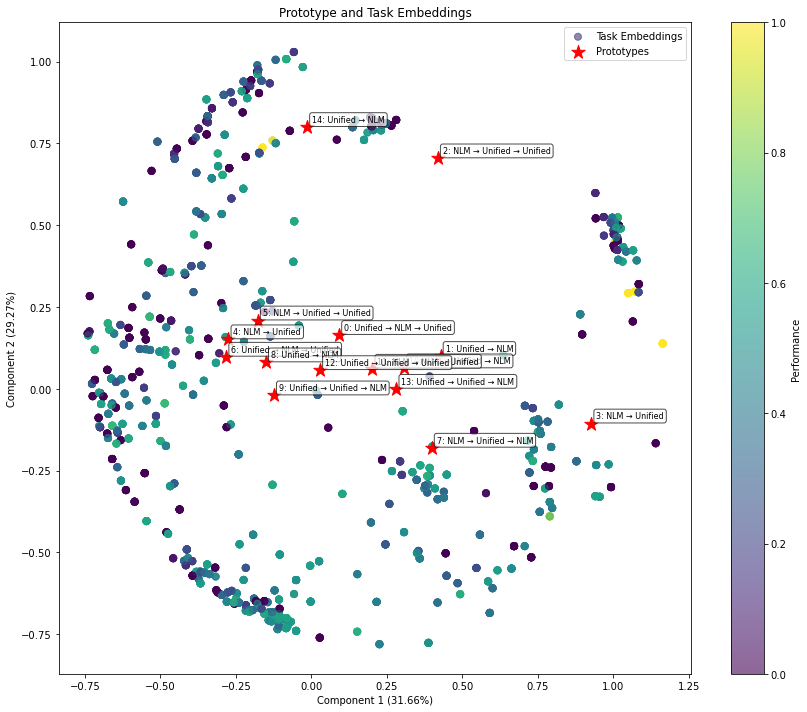

Training MCU:  76%|███████▋  | 382/500 [38:23<08:35,  4.37s/it]

Iteration 382/500, Cell Accuracy: 0.5530, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  77%|███████▋  | 383/500 [38:33<11:45,  6.03s/it]

Iteration 383/500, Cell Accuracy: 0.3969, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  77%|███████▋  | 384/500 [38:37<10:25,  5.39s/it]

Iteration 384/500, Cell Accuracy: 0.4933, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  77%|███████▋  | 385/500 [38:40<08:48,  4.60s/it]

Iteration 385/500, Cell Accuracy: 0.4839, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 386/500, Cell Accuracy: 0.3799, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_386.pt


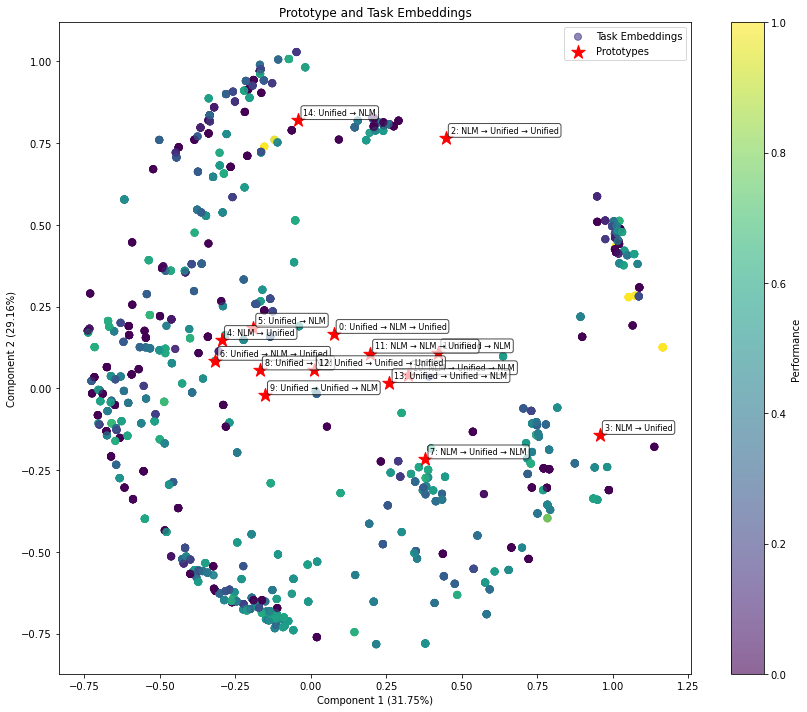

Training MCU:  77%|███████▋  | 387/500 [38:50<08:32,  4.53s/it]

Iteration 387/500, Cell Accuracy: 0.7204, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  78%|███████▊  | 388/500 [38:52<06:49,  3.65s/it]

Iteration 388/500, Cell Accuracy: 0.6569, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  78%|███████▊  | 389/500 [38:53<05:30,  2.98s/it]

Iteration 389/500, Cell Accuracy: 0.6239, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  78%|███████▊  | 390/500 [38:57<05:43,  3.12s/it]

Iteration 390/500, Cell Accuracy: 0.5395, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 391/500, Cell Accuracy: 0.3390, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_391.pt


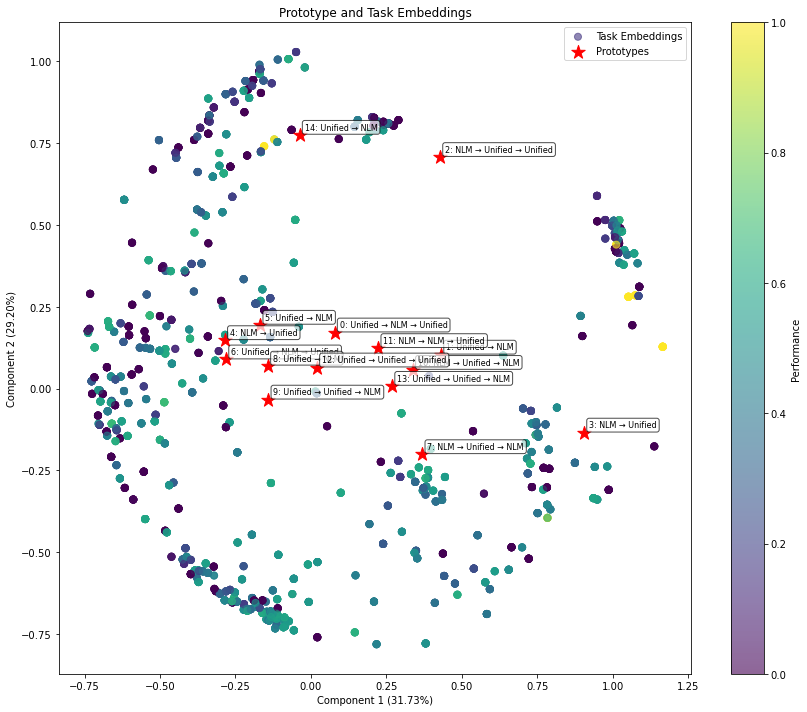

Training MCU:  78%|███████▊  | 392/500 [39:10<08:28,  4.71s/it]

Iteration 392/500, Cell Accuracy: 0.4855, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  79%|███████▊  | 393/500 [39:13<07:31,  4.22s/it]

Iteration 393/500, Cell Accuracy: 0.4746, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  79%|███████▉  | 394/500 [39:16<06:24,  3.62s/it]

Iteration 394/500, Cell Accuracy: 0.5309, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  79%|███████▉  | 395/500 [39:17<05:15,  3.01s/it]

Iteration 395/500, Cell Accuracy: 0.5754, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 396/500, Cell Accuracy: 0.4470, Grid Accuracy: 0.0500, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_396.pt


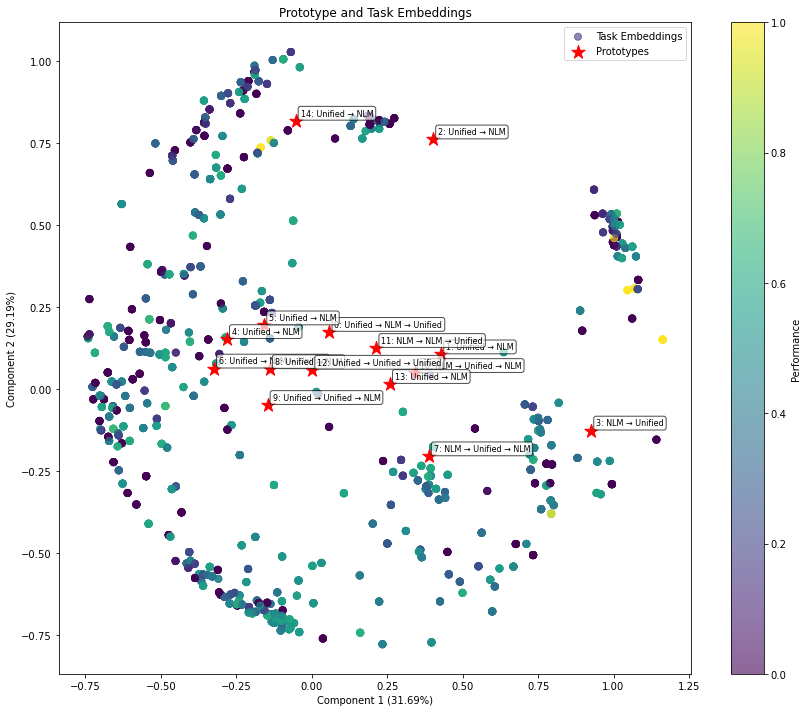

Training MCU:  79%|███████▉  | 397/500 [39:31<07:54,  4.61s/it]

Iteration 397/500, Cell Accuracy: 0.4552, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  80%|███████▉  | 398/500 [39:32<06:02,  3.55s/it]

Iteration 398/500, Cell Accuracy: 0.5184, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  80%|███████▉  | 399/500 [39:45<10:35,  6.30s/it]

Iteration 399/500, Cell Accuracy: 0.4801, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  80%|████████  | 400/500 [39:47<08:24,  5.04s/it]

Iteration 400/500, Cell Accuracy: 0.5343, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 401/500, Cell Accuracy: 0.5193, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_401.pt


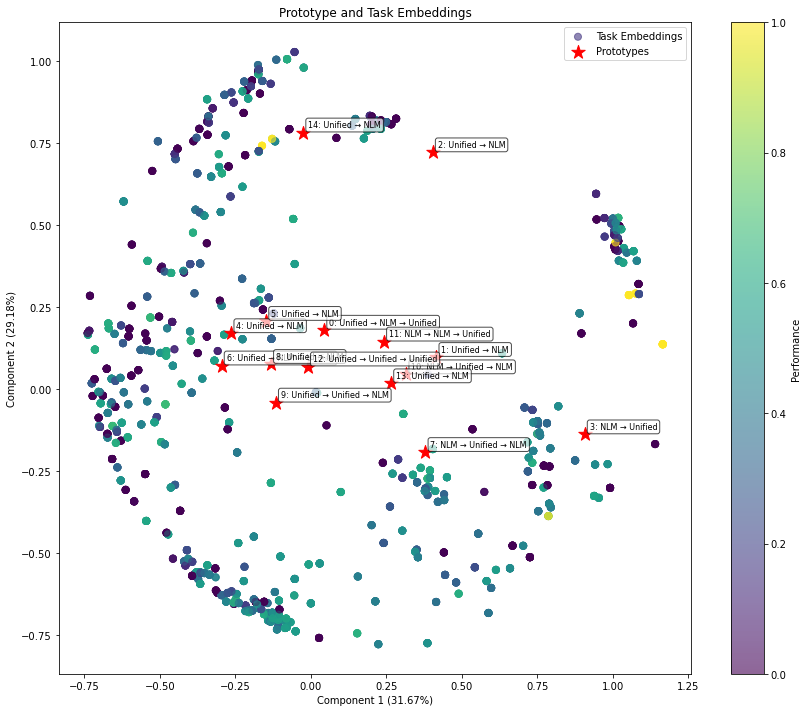

Training MCU:  80%|████████  | 402/500 [39:57<07:54,  4.84s/it]

Iteration 402/500, Cell Accuracy: 0.5736, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  81%|████████  | 403/500 [39:59<06:17,  3.90s/it]

Iteration 403/500, Cell Accuracy: 0.3764, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  81%|████████  | 404/500 [40:00<04:59,  3.12s/it]

Iteration 404/500, Cell Accuracy: 0.2674, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  81%|████████  | 405/500 [40:02<04:26,  2.80s/it]

Iteration 405/500, Cell Accuracy: 0.5629, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 406/500, Cell Accuracy: 0.3358, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_406.pt


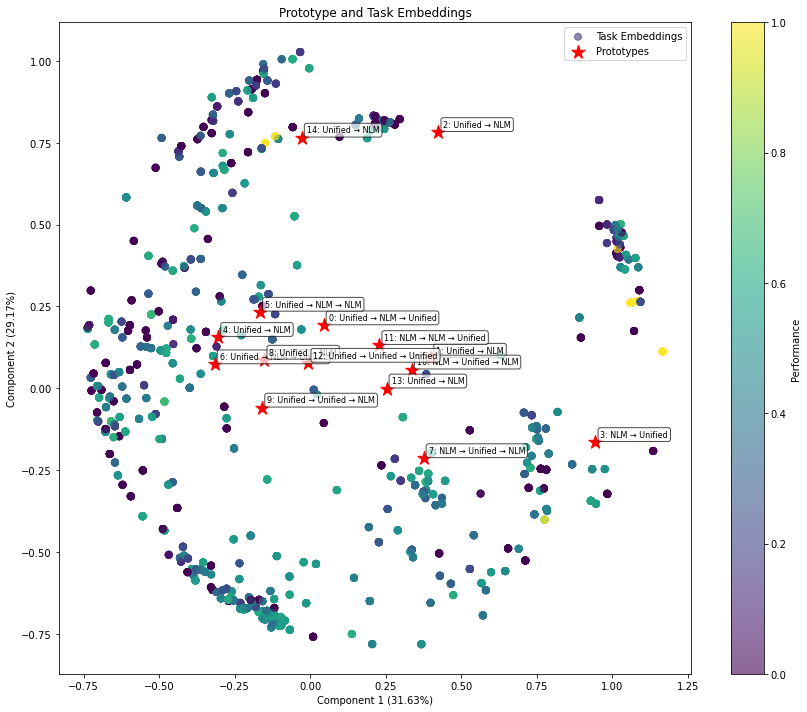

Training MCU:  81%|████████▏ | 407/500 [40:12<05:30,  3.55s/it]

Iteration 407/500, Cell Accuracy: 0.4822, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  82%|████████▏ | 408/500 [40:14<04:39,  3.04s/it]

Iteration 408/500, Cell Accuracy: 0.4508, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  82%|████████▏ | 409/500 [40:16<04:03,  2.68s/it]

Iteration 409/500, Cell Accuracy: 0.4759, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  82%|████████▏ | 410/500 [40:21<05:04,  3.38s/it]

Iteration 410/500, Cell Accuracy: 0.5818, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 411/500, Cell Accuracy: 0.4296, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_411.pt


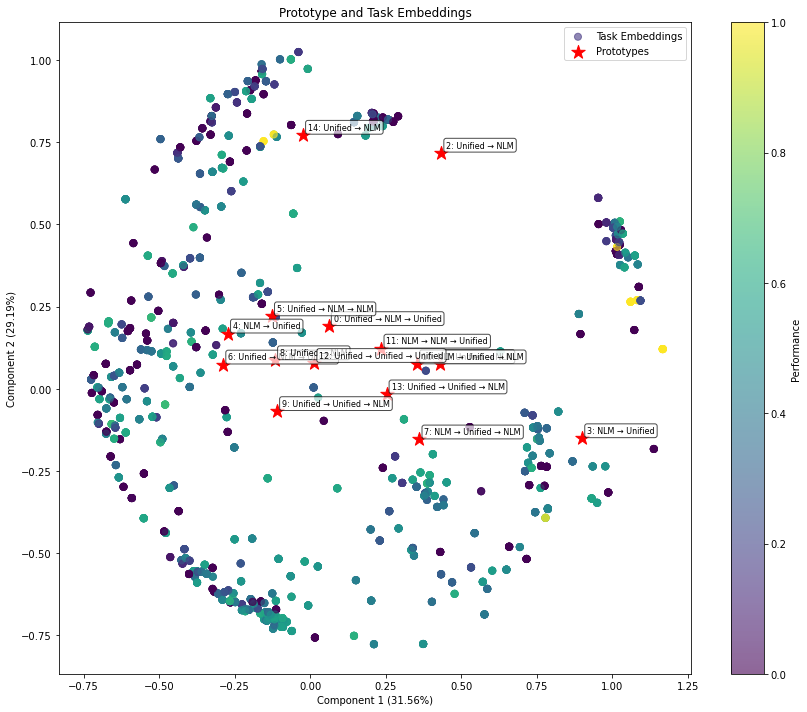

Training MCU:  82%|████████▏ | 412/500 [40:36<08:06,  5.52s/it]

Iteration 412/500, Cell Accuracy: 0.4254, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  83%|████████▎ | 413/500 [40:38<06:23,  4.41s/it]

Iteration 413/500, Cell Accuracy: 0.5066, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  83%|████████▎ | 414/500 [40:39<04:58,  3.48s/it]

Iteration 414/500, Cell Accuracy: 0.5648, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  83%|████████▎ | 415/500 [40:50<07:57,  5.62s/it]

Iteration 415/500, Cell Accuracy: 0.4518, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 416/500, Cell Accuracy: 0.5796, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_416.pt


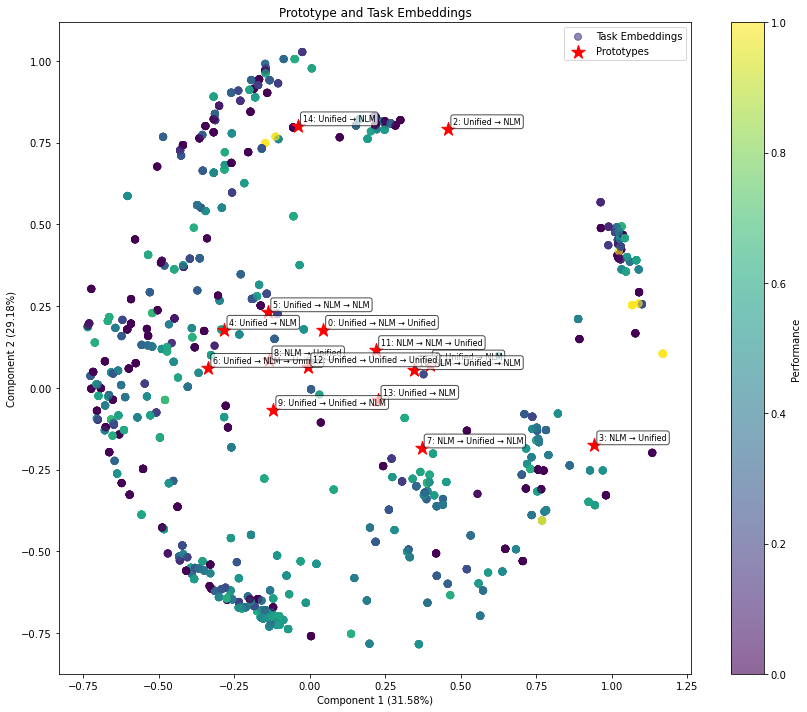

Training MCU:  83%|████████▎ | 417/500 [41:00<06:56,  5.02s/it]

Iteration 417/500, Cell Accuracy: 0.4818, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  84%|████████▎ | 418/500 [41:02<05:48,  4.25s/it]

Iteration 418/500, Cell Accuracy: 0.6536, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  84%|████████▍ | 419/500 [41:11<07:35,  5.63s/it]

Iteration 419/500, Cell Accuracy: 0.4968, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  84%|████████▍ | 420/500 [41:13<05:54,  4.44s/it]

Iteration 420/500, Cell Accuracy: 0.6230, Grid Accuracy: 0.1000, Epsilon: 0.0476
Iteration 421/500, Cell Accuracy: 0.3949, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_421.pt


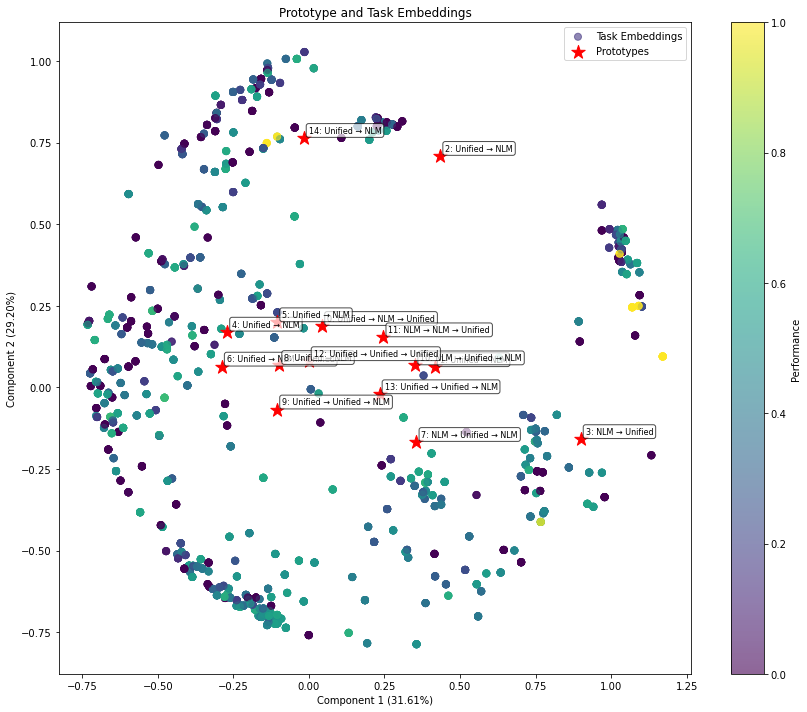

Training MCU:  84%|████████▍ | 422/500 [41:27<07:16,  5.59s/it]

Iteration 422/500, Cell Accuracy: 0.6860, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  85%|████████▍ | 423/500 [41:29<05:54,  4.60s/it]

Iteration 423/500, Cell Accuracy: 0.3409, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  85%|████████▍ | 424/500 [41:31<04:46,  3.77s/it]

Iteration 424/500, Cell Accuracy: 0.5494, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  85%|████████▌ | 425/500 [41:33<03:53,  3.11s/it]

Iteration 425/500, Cell Accuracy: 0.5963, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 426/500, Cell Accuracy: 0.5037, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_426.pt


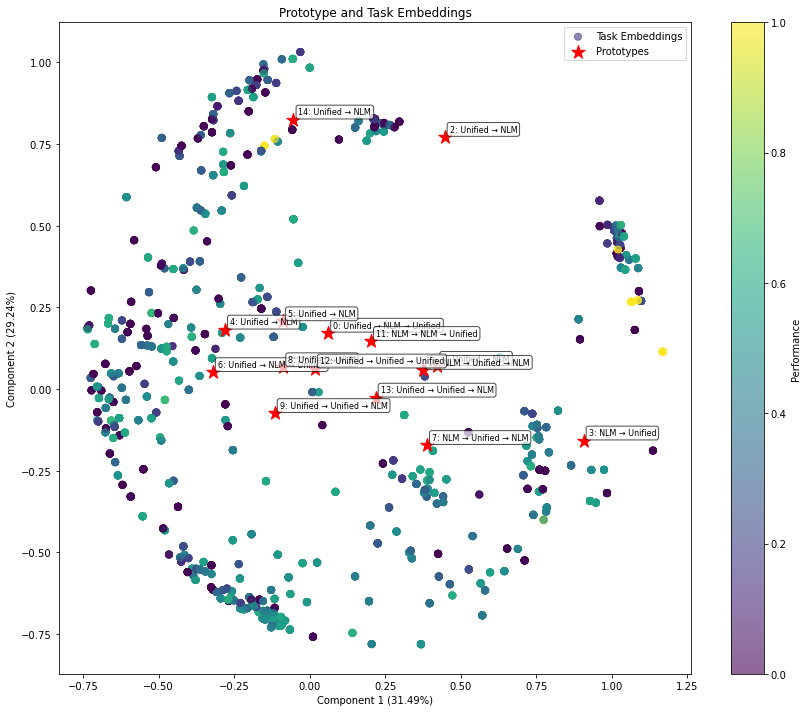

Training MCU:  85%|████████▌ | 427/500 [41:48<06:12,  5.11s/it]

Iteration 427/500, Cell Accuracy: 0.6075, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  86%|████████▌ | 428/500 [41:51<05:12,  4.34s/it]

Iteration 428/500, Cell Accuracy: 0.4650, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  86%|████████▌ | 429/500 [41:53<04:33,  3.85s/it]

Iteration 429/500, Cell Accuracy: 0.4270, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  86%|████████▌ | 430/500 [41:55<03:42,  3.18s/it]

Iteration 430/500, Cell Accuracy: 0.5432, Grid Accuracy: 0.0500, Epsilon: 0.0476
Iteration 431/500, Cell Accuracy: 0.5106, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_431.pt


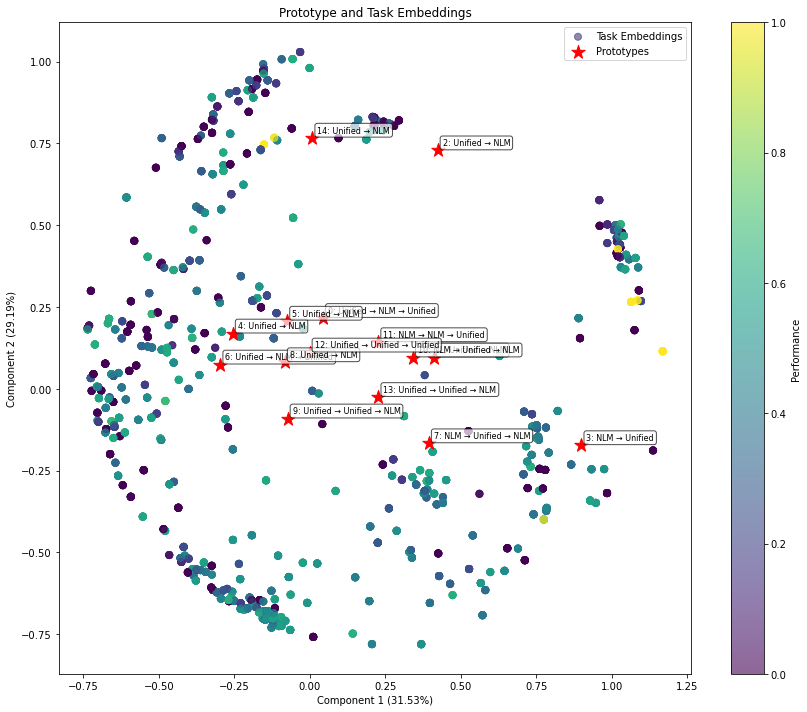

Training MCU:  86%|████████▋ | 432/500 [42:05<04:28,  3.94s/it]

Iteration 432/500, Cell Accuracy: 0.5560, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  87%|████████▋ | 433/500 [42:11<04:54,  4.40s/it]

Iteration 433/500, Cell Accuracy: 0.4916, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  87%|████████▋ | 434/500 [42:13<03:56,  3.58s/it]

Iteration 434/500, Cell Accuracy: 0.7106, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  87%|████████▋ | 435/500 [42:14<03:10,  2.93s/it]

Iteration 435/500, Cell Accuracy: 0.4435, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 436/500, Cell Accuracy: 0.3056, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_436.pt


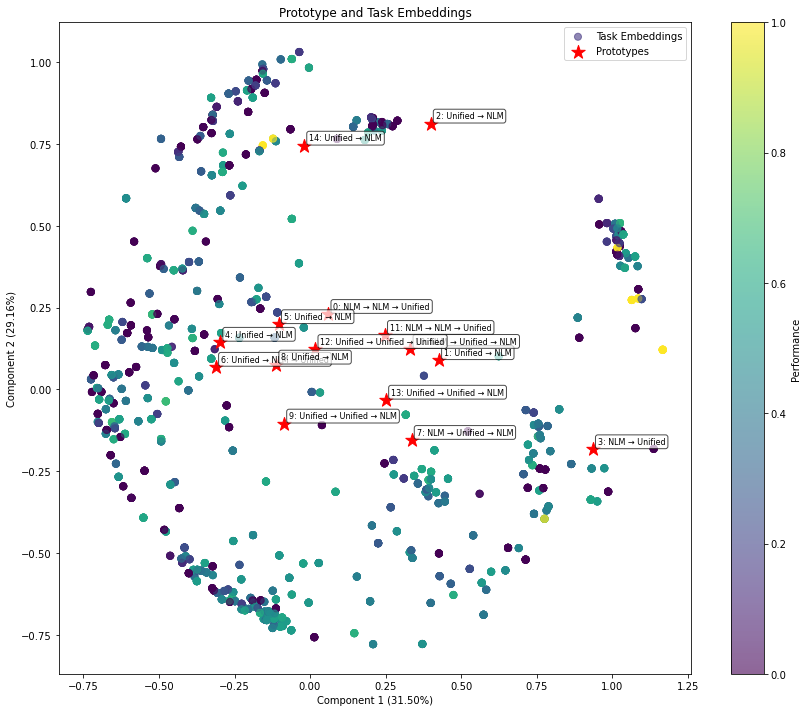

Training MCU:  87%|████████▋ | 437/500 [42:30<05:15,  5.01s/it]

Iteration 437/500, Cell Accuracy: 0.5349, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  88%|████████▊ | 438/500 [42:40<06:37,  6.41s/it]

Iteration 438/500, Cell Accuracy: 0.3491, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  88%|████████▊ | 439/500 [42:50<07:36,  7.48s/it]

Iteration 439/500, Cell Accuracy: 0.5111, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  88%|████████▊ | 440/500 [43:02<08:55,  8.93s/it]

Iteration 440/500, Cell Accuracy: 0.4038, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 441/500, Cell Accuracy: 0.4295, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_441.pt


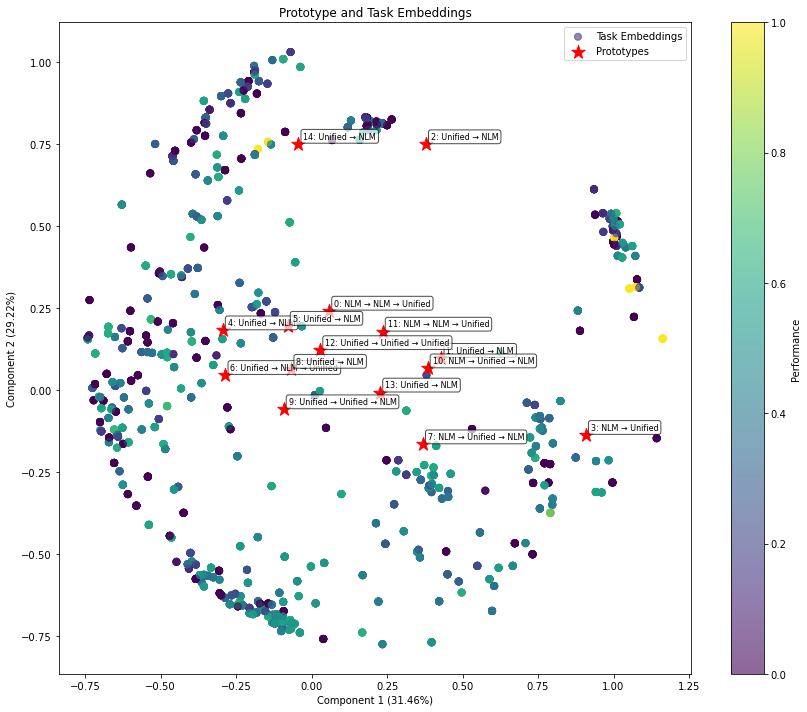

Training MCU:  88%|████████▊ | 442/500 [43:15<07:03,  7.30s/it]

Iteration 442/500, Cell Accuracy: 0.3040, Grid Accuracy: 0.0500, Epsilon: 0.0476


Training MCU:  89%|████████▊ | 443/500 [43:17<05:26,  5.73s/it]

Iteration 443/500, Cell Accuracy: 0.3348, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  89%|████████▉ | 444/500 [43:19<04:12,  4.51s/it]

Iteration 444/500, Cell Accuracy: 0.4545, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  89%|████████▉ | 445/500 [43:27<05:04,  5.53s/it]

Iteration 445/500, Cell Accuracy: 0.4362, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 446/500, Cell Accuracy: 0.3456, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_446.pt


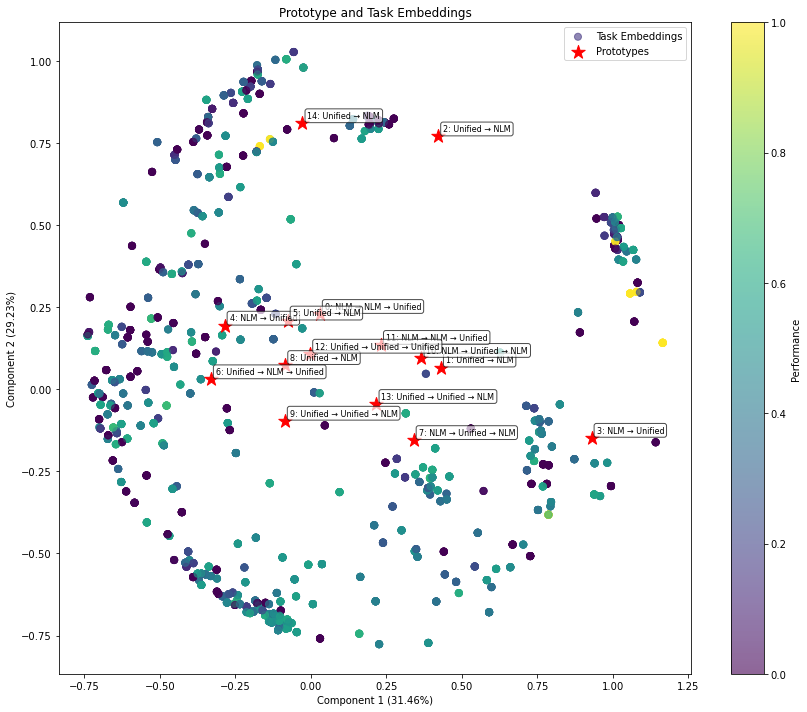

Training MCU:  89%|████████▉ | 447/500 [43:49<07:30,  8.50s/it]

Iteration 447/500, Cell Accuracy: 0.3719, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  90%|████████▉ | 448/500 [43:52<05:55,  6.85s/it]

Iteration 448/500, Cell Accuracy: 0.4049, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  90%|████████▉ | 449/500 [43:55<04:45,  5.59s/it]

Iteration 449/500, Cell Accuracy: 0.4546, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  90%|█████████ | 450/500 [43:56<03:30,  4.22s/it]

Iteration 450/500, Cell Accuracy: 0.4968, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 451/500, Cell Accuracy: 0.6659, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_451.pt


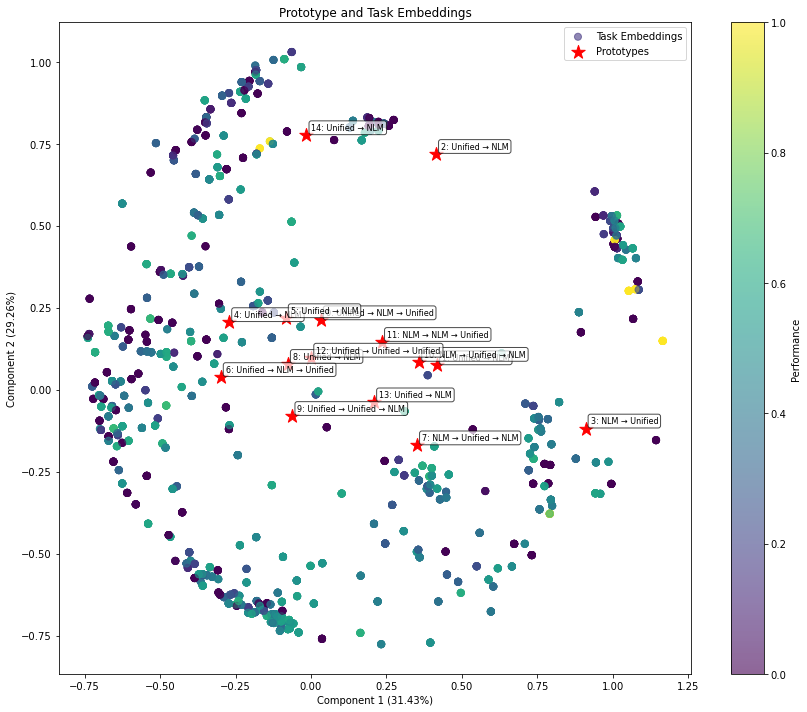

Training MCU:  90%|█████████ | 452/500 [44:09<04:10,  5.22s/it]

Iteration 452/500, Cell Accuracy: 0.5145, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  91%|█████████ | 453/500 [44:14<03:50,  4.91s/it]

Iteration 453/500, Cell Accuracy: 0.5021, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  91%|█████████ | 454/500 [44:19<03:55,  5.11s/it]

Iteration 454/500, Cell Accuracy: 0.4392, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  91%|█████████ | 455/500 [44:27<04:24,  5.87s/it]

Iteration 455/500, Cell Accuracy: 0.3881, Grid Accuracy: 0.1500, Epsilon: 0.0476
Iteration 456/500, Cell Accuracy: 0.5150, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_456.pt


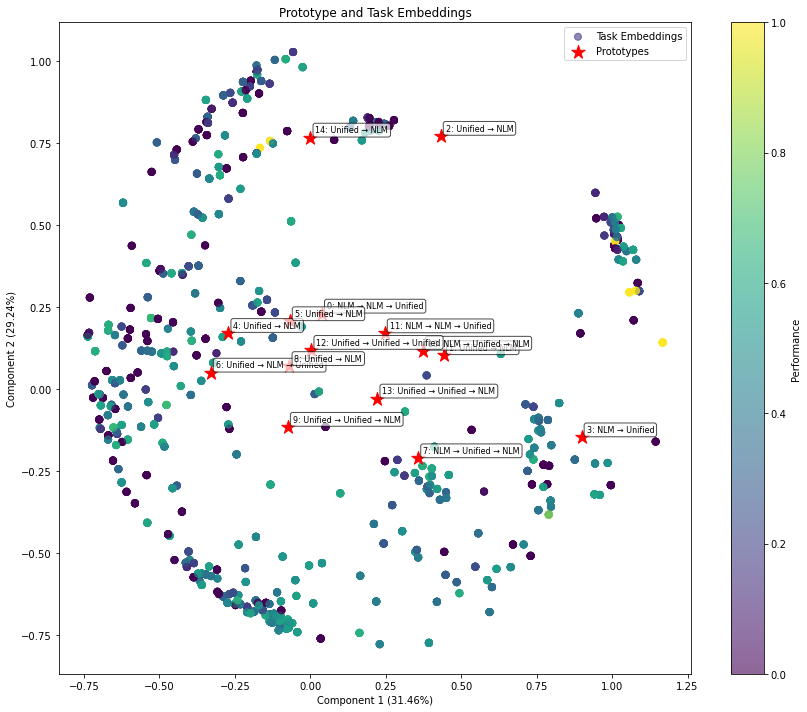

Training MCU:  91%|█████████▏| 457/500 [44:47<05:20,  7.45s/it]

Iteration 457/500, Cell Accuracy: 0.4077, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  92%|█████████▏| 458/500 [44:51<04:27,  6.37s/it]

Iteration 458/500, Cell Accuracy: 0.4000, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  92%|█████████▏| 459/500 [44:59<04:42,  6.89s/it]

Iteration 459/500, Cell Accuracy: 0.2462, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  92%|█████████▏| 460/500 [45:10<05:19,  8.00s/it]

Iteration 460/500, Cell Accuracy: 0.2909, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 461/500, Cell Accuracy: 0.4981, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_461.pt


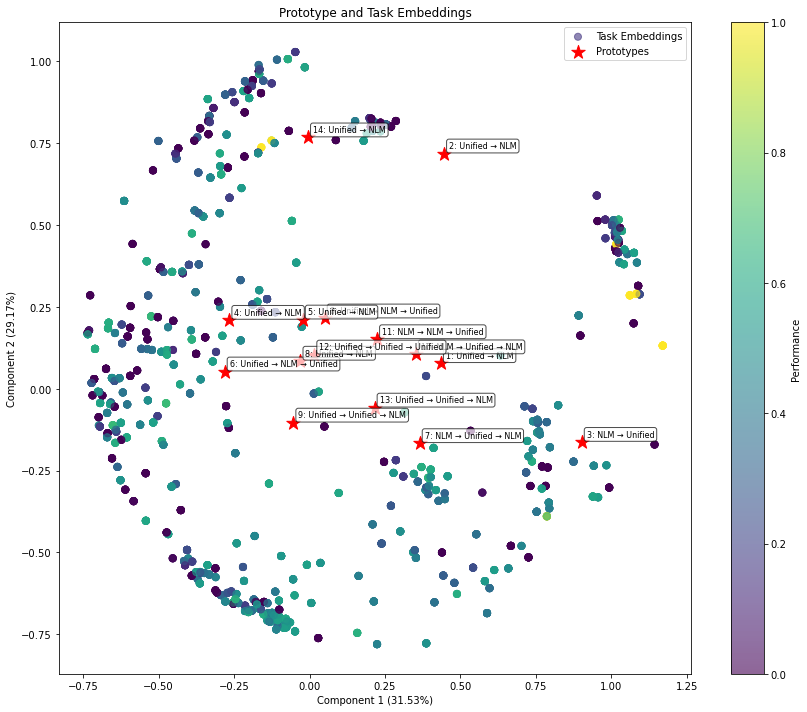

Training MCU:  92%|█████████▏| 462/500 [45:26<04:50,  7.64s/it]

Iteration 462/500, Cell Accuracy: 0.4861, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  93%|█████████▎| 463/500 [45:29<03:53,  6.30s/it]

Iteration 463/500, Cell Accuracy: 0.5261, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  93%|█████████▎| 464/500 [45:30<02:51,  4.78s/it]

Iteration 464/500, Cell Accuracy: 0.5878, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  93%|█████████▎| 465/500 [45:32<02:13,  3.82s/it]

Iteration 465/500, Cell Accuracy: 0.3351, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 466/500, Cell Accuracy: 0.5021, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_466.pt


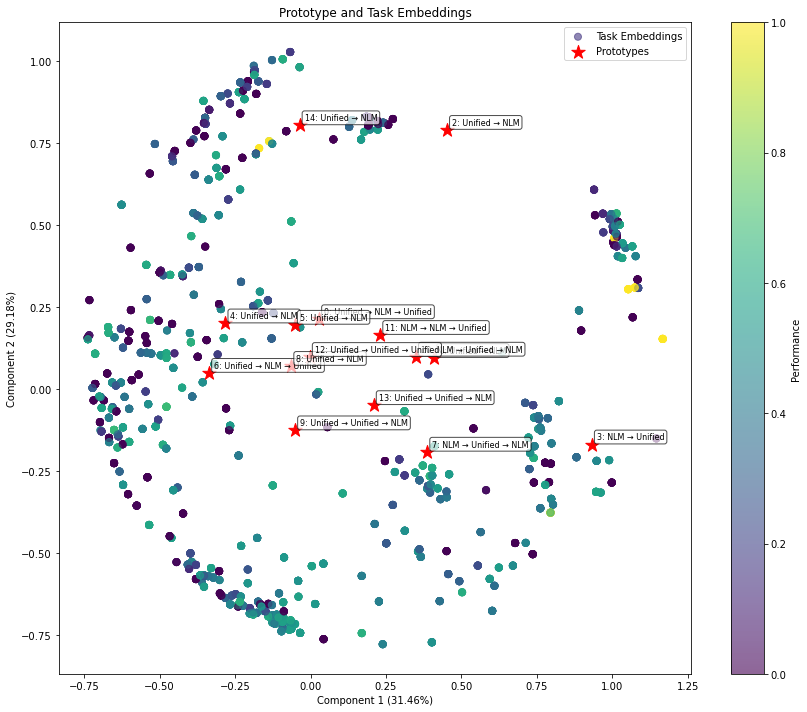

Training MCU:  93%|█████████▎| 467/500 [45:43<02:21,  4.29s/it]

Iteration 467/500, Cell Accuracy: 0.3918, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  94%|█████████▎| 468/500 [45:44<01:52,  3.51s/it]

Iteration 468/500, Cell Accuracy: 0.4439, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  94%|█████████▍| 469/500 [45:46<01:32,  3.00s/it]

Iteration 469/500, Cell Accuracy: 0.6397, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  94%|█████████▍| 470/500 [45:50<01:38,  3.28s/it]

Iteration 470/500, Cell Accuracy: 0.4049, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 471/500, Cell Accuracy: 0.3484, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_471.pt


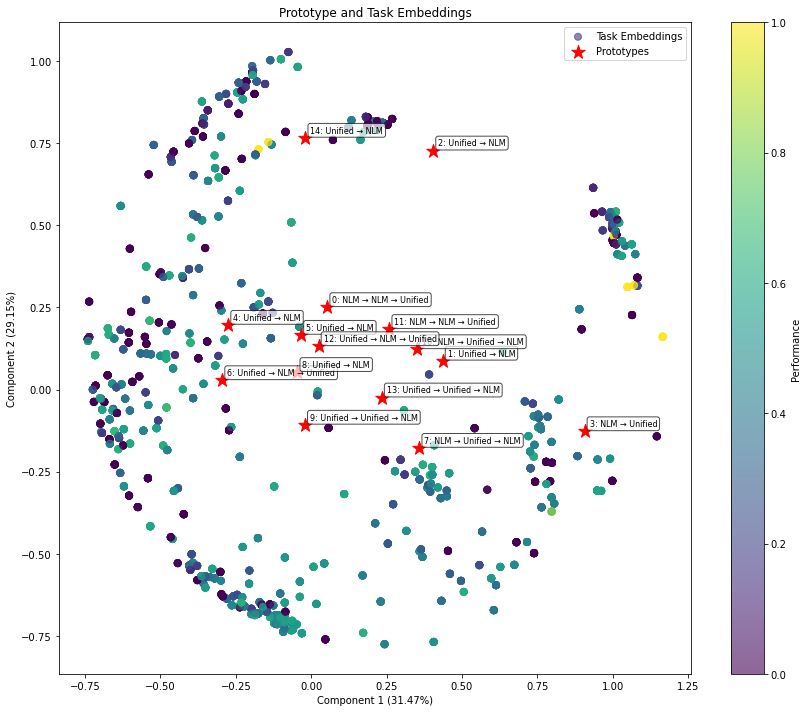

Training MCU:  94%|█████████▍| 472/500 [46:12<02:57,  6.35s/it]

Iteration 472/500, Cell Accuracy: 0.5738, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  95%|█████████▍| 473/500 [46:13<02:08,  4.75s/it]

Iteration 473/500, Cell Accuracy: 0.5239, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  95%|█████████▍| 474/500 [46:20<02:16,  5.24s/it]

Iteration 474/500, Cell Accuracy: 0.5692, Grid Accuracy: 0.2000, Epsilon: 0.0476


Training MCU:  95%|█████████▌| 475/500 [46:23<01:56,  4.66s/it]

Iteration 475/500, Cell Accuracy: 0.4674, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 476/500, Cell Accuracy: 0.5806, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_476.pt


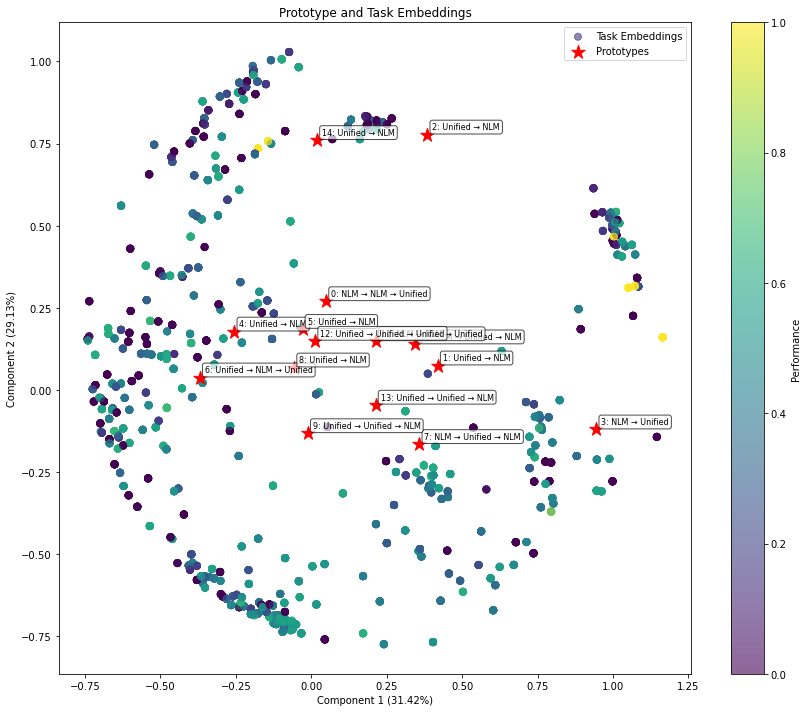

Training MCU:  95%|█████████▌| 477/500 [46:43<02:55,  7.61s/it]

Iteration 477/500, Cell Accuracy: 0.4473, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  96%|█████████▌| 478/500 [46:50<02:41,  7.33s/it]

Iteration 478/500, Cell Accuracy: 0.4186, Grid Accuracy: 0.1500, Epsilon: 0.0476


Training MCU:  96%|█████████▌| 479/500 [46:54<02:12,  6.29s/it]

Iteration 479/500, Cell Accuracy: 0.4552, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  96%|█████████▌| 480/500 [46:55<01:38,  4.90s/it]

Iteration 480/500, Cell Accuracy: 0.5964, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 481/500, Cell Accuracy: 0.6074, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_481.pt


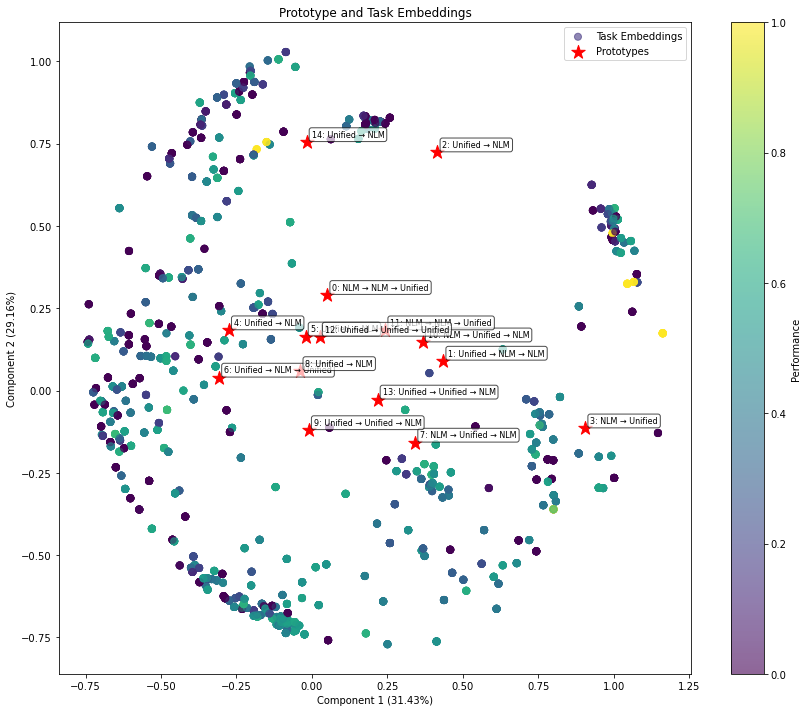

Training MCU:  96%|█████████▋| 482/500 [47:06<01:24,  4.69s/it]

Iteration 482/500, Cell Accuracy: 0.5139, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  97%|█████████▋| 483/500 [47:08<01:09,  4.07s/it]

Iteration 483/500, Cell Accuracy: 0.5270, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  97%|█████████▋| 484/500 [47:09<00:50,  3.17s/it]

Iteration 484/500, Cell Accuracy: 0.6243, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  97%|█████████▋| 485/500 [47:11<00:39,  2.64s/it]

Iteration 485/500, Cell Accuracy: 0.5317, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 486/500, Cell Accuracy: 0.6307, Grid Accuracy: 0.1000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_486.pt


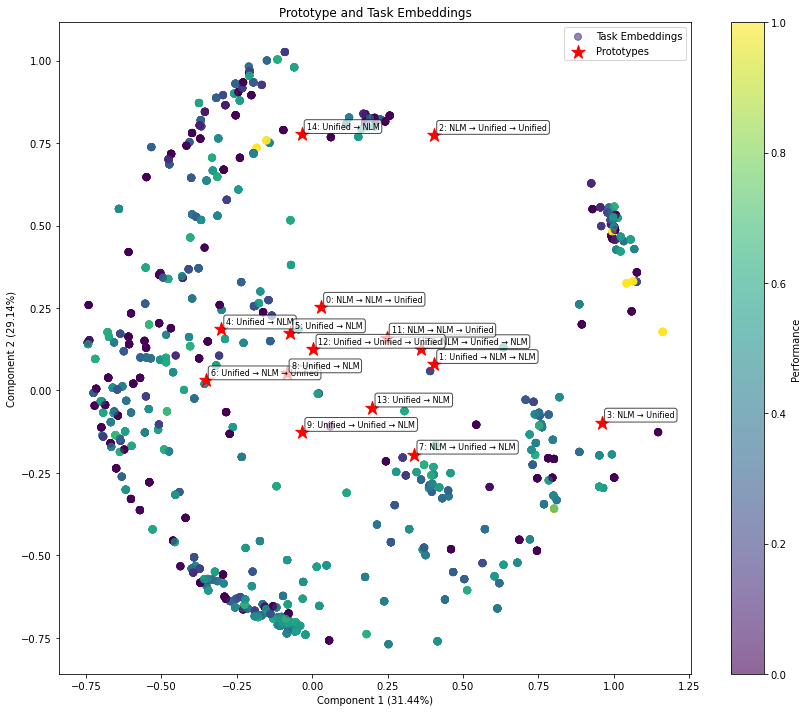

Training MCU:  97%|█████████▋| 487/500 [47:31<01:19,  6.08s/it]

Iteration 487/500, Cell Accuracy: 0.3969, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  98%|█████████▊| 488/500 [47:32<00:55,  4.65s/it]

Iteration 488/500, Cell Accuracy: 0.4175, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  98%|█████████▊| 489/500 [47:35<00:45,  4.10s/it]

Iteration 489/500, Cell Accuracy: 0.3737, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  98%|█████████▊| 490/500 [47:39<00:39,  3.97s/it]

Iteration 490/500, Cell Accuracy: 0.4111, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 491/500, Cell Accuracy: 0.5056, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_491.pt


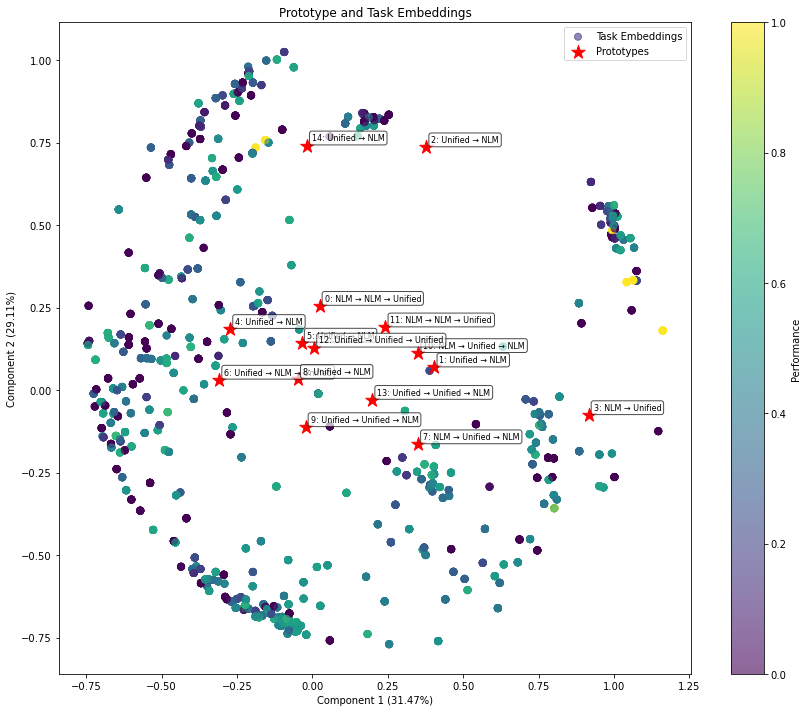

Training MCU:  98%|█████████▊| 492/500 [47:51<00:36,  4.51s/it]

Iteration 492/500, Cell Accuracy: 0.5477, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  99%|█████████▊| 493/500 [47:56<00:33,  4.76s/it]

Iteration 493/500, Cell Accuracy: 0.5748, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU:  99%|█████████▉| 494/500 [47:59<00:25,  4.26s/it]

Iteration 494/500, Cell Accuracy: 0.4346, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU:  99%|█████████▉| 495/500 [48:04<00:22,  4.40s/it]

Iteration 495/500, Cell Accuracy: 0.5043, Grid Accuracy: 0.0000, Epsilon: 0.0476
Iteration 496/500, Cell Accuracy: 0.6494, Grid Accuracy: 0.0000, Epsilon: 0.0476
Model saved to output/models/proto_mcu_iter_496.pt


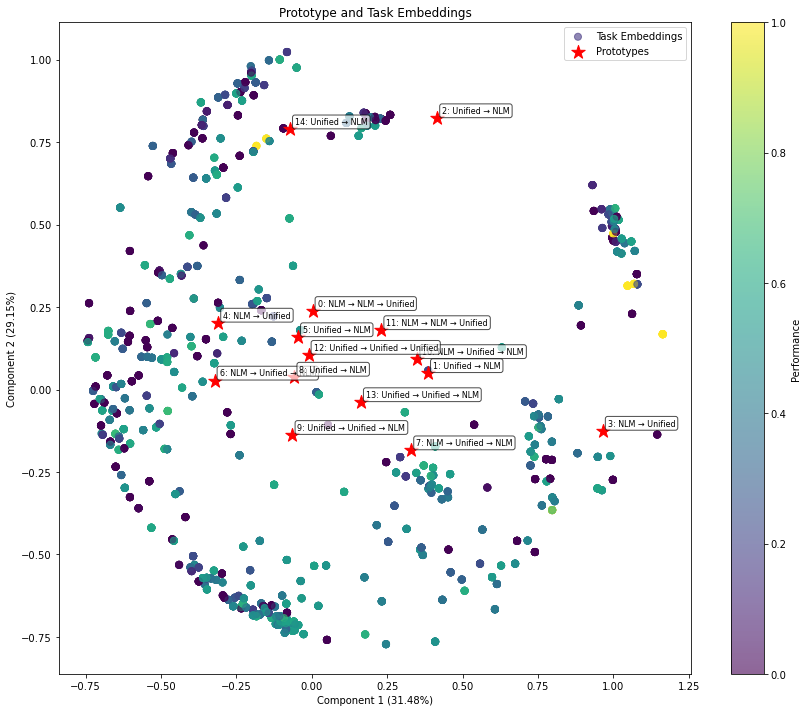

Training MCU:  99%|█████████▉| 497/500 [48:22<00:19,  6.59s/it]

Iteration 497/500, Cell Accuracy: 0.4985, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU: 100%|█████████▉| 498/500 [48:27<00:11,  5.84s/it]

Iteration 498/500, Cell Accuracy: 0.3941, Grid Accuracy: 0.0000, Epsilon: 0.0476


Training MCU: 100%|█████████▉| 499/500 [48:30<00:05,  5.23s/it]

Iteration 499/500, Cell Accuracy: 0.6087, Grid Accuracy: 0.1000, Epsilon: 0.0476


Training MCU: 100%|██████████| 500/500 [48:46<00:00,  5.85s/it]

Iteration 500/500, Cell Accuracy: 0.4359, Grid Accuracy: 0.0000, Epsilon: 0.0476


Model saved to output/models/mcu/proto_mcu_final.pt


In [4]:
import os
import json
import torch
import random
import numpy as np
import matplotlib.pyplot as plt
from task4 import Task
from trainer import load_tasks, load_precomputed_tasks

from nlm_module import NLMReasoningModule
from unified_module import UnifiedReasoningModule
from mcu import ProtoMetaReasoningSystem

# Load your pretrained embedding model
embedding_model = TaskEmbeddingModel(input_dim=40, hidden_dim=128, embedding_dim=128)
embedding_model.load_state_dict(torch.load("task_embedding_model.pt"))
embedding_model.eval()  # Set to evaluation mode

device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
MODEL_DIR = "output/models"

# Initialize your reasoning modules

nlm = NLMReasoningModule(
    input_dim=3,
    hidden_dim=128,
    output_dim=11,
    device=device
)
nlm.load_complete_state(os.path.join(MODEL_DIR, "nlm/nlm_reasoning_module_final.pt"))
nlm.model.to(device)

# LLMReasoningModule(),
unified = UnifiedReasoningModule(
    input_dim=3,
    hidden_dim=128,
    output_dim=11,
    device=device
)
unified.load_complete_state(os.path.join(MODEL_DIR, "unified/unified_reasoning_model_final.pt"))
unified.model.to(device)

reasoning_modules=[nlm, unified]

# Initialize the MCU with your pretrained embedding model
proto_mcu = initialize_mcu_with_task_embedding_model(embedding_model, reasoning_modules)

# Load tasks and select diverse ones for prototype initialization
all_tasks = load_precomputed_tasks("precomputed_tasks/training_400")

# Initialize prototypes with diverse tasks
initialize_prototypes(proto_mcu, all_tasks)

# Train the MCU
proto_mcu, training_history = train_mcu(proto_mcu, all_tasks, num_iterations=500)

In [15]:
# Test on held-out test tasks
test_tasks = load_precomputed_tasks("precomputed_tasks/evaluation_400")
test_accuracy, test_results = test_mcu(proto_mcu, test_tasks)

Loading precomputed tasks from precomputed_tasks/evaluation_400


Loading tasks from precomputed_tasks/evaluation_400: 100%|██████████| 400/400 [00:02<00:00, 163.24it/s]


Loaded 400 precomputed tasks
Task 0692e18c: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=Unified → NLM → Unified
Task 15696249: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=Unified → NLM
Task 5b6cbef5: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Task 695367ec: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Task 7039b2d7: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Task 8719f442: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Task 8e2edd66: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=Unified → NLM → Unified
Task ad7e01d0: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Task c1990cce: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Task e872b94a: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=NLM → Unified
Overall test results: Cell Accuracy=0.5085, Grid Accuracy=0.0250


NameError: name 'datetime' is not defined

In [26]:
import os
import json
import torch
import random
import numpy as np
import matplotlib.pyplot as plt
from task4 import Task
from trainer import load_tasks, load_precomputed_tasks
from nlm_module import NLMReasoningModule
from unified_module import UnifiedReasoningModule
from mcu import ProtoMetaReasoningSystem
from task_adaptation_runner import TaskAdaptationRunner

# Create output directories
os.makedirs("output/models/mcu", exist_ok=True)
os.makedirs("output/models/mcu/visualizations", exist_ok=True)
os.makedirs("output/models/mcu/task_examples", exist_ok=True)

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Set paths
MODEL_DIR = "output/models"

# Load your pretrained embedding model
embedding_model = TaskEmbeddingModel(input_dim=40, hidden_dim=128, embedding_dim=128)
embedding_model.load_state_dict(torch.load("task_embedding_model.pt"))
embedding_model.eval()  # Set to evaluation mode
embedding_model = embedding_model.to(device)

# Initialize your reasoning modules
nlm = NLMReasoningModule(
    input_dim=3,
    hidden_dim=128,
    output_dim=11,
    device=device
)
nlm.load_complete_state(os.path.join(MODEL_DIR, "nlm/nlm_reasoning_module_final.pt"))
nlm.model.to(device)

unified = UnifiedReasoningModule(
    input_dim=3,
    hidden_dim=128,
    output_dim=11,
    device=device
)
unified.load_complete_state(os.path.join(MODEL_DIR, "unified/unified_reasoning_model_final.pt"))
unified.model.to(device)

reasoning_modules=[nlm, unified]

proto_mcu = initialize_mcu_with_task_embedding_model(embedding_model, reasoning_modules)

# Initialize the MCU with your pretrained embedding model
proto_mcu = initialize_mcu_with_task_embedding_model(embedding_model, reasoning_modules)

# Load tasks and select diverse ones for prototype initialization
all_tasks = load_precomputed_tasks("precomputed_tasks/training_400")

# Initialize prototypes with diverse tasks
initialize_prototypes(proto_mcu, all_tasks)


# Define the train_mcu_with_task_adaptation function
def train_mcu_with_task_adaptation(proto_mcu, training_tasks, test_tasks, 
                                  nlm_module, unified_module,
                                  nlm_model_path=None, unified_model_path=None,
                                  num_iterations=100, device="cpu"):
    """
    Train an MCU to choose between NLM with task adaptation and Unified module
    """
    import os
    import json
    import numpy as np
    import torch
    import random
    import datetime
    from tqdm import tqdm
    import matplotlib.pyplot as plt
    from task_adaptation_runner import TaskAdaptationRunner
    
    # Set up the task adaptation runner for NLM
    nlm_adapter = TaskAdaptationRunner(
        model_path=nlm_model_path if nlm_model_path else None,
        reasoning_method="nlm",
        inner_lr=0.01,
        inner_steps=15,
        method="maml",  # Can be "maml" or "proto" depending on your preference
        device=device,
    )
    
    # Initial exploration rate
    proto_mcu.epsilon = 1.0  # Start with high exploration
    
    # Clear any existing modules and add only the two we want
    proto_mcu.modules = {}
    proto_mcu.modules["NLM"] = nlm_adapter
    proto_mcu.modules["Unified"] = unified_module
    
    # Training history
    history = {
        "iterations": [],
        "node_accuracy": [],
        "grid_accuracy": [],
        "epsilon": [],
        "module_usage": {
            "NLM": [],
            "Unified": []
        }
    }
    
    # Train the MCU
    for iteration in tqdm(range(num_iterations), desc="Training MCU"):
        # Sample a batch of tasks
        batch_size = min(10, len(training_tasks))
        batch_tasks = random.sample(training_tasks, batch_size)
        
        batch_node_accuracy = 0.0
        batch_grid_accuracy = 0.0
        module_usage = {"NLM": 0, "Unified": 0}
        
        for task in batch_tasks:
            # Solve with the current policy, choosing between NLM adapter and Unified
            predictions = proto_mcu.solve_task(task, training=True)
            
            # Track both accuracies
            node_accuracy, grid_accuracy = proto_mcu.evaluate_predictions(predictions, task)
            batch_node_accuracy += node_accuracy
            batch_grid_accuracy += grid_accuracy
            
            # Track module usage
            module_sequence = proto_mcu.get_best_module_sequence(task)
            for module in module_sequence:
                if module in module_usage:
                    module_usage[module] += 1
        
        # Calculate average accuracies
        avg_node_accuracy = batch_node_accuracy / batch_size
        avg_grid_accuracy = batch_grid_accuracy / batch_size
        
        # Update module usage tracking
        for module, count in module_usage.items():
            history["module_usage"][module].append(count)
        
        # Log progress
        print(f"Iteration {iteration+1}/{num_iterations}, Cell Accuracy: {avg_node_accuracy:.4f}, Grid Accuracy: {avg_grid_accuracy:.4f}, Epsilon: {proto_mcu.epsilon:.4f}")
        print(f"Module usage: NLM_Adapter: {module_usage['NLM']}, Unified: {module_usage['Unified']}")
        
        # Record history
        history["iterations"].append(iteration+1)
        history["node_accuracy"].append(avg_node_accuracy)
        history["grid_accuracy"].append(avg_grid_accuracy)
        history["epsilon"].append(proto_mcu.epsilon)
        
        # Decay epsilon (exploration rate)
        proto_mcu.epsilon = max(0.05, proto_mcu.epsilon * 0.995)
        
        # Update prototypes every 10 iterations
        if iteration % 10 == 0:
            proto_mcu.update_prototypes_from_memory()
        
        # Save checkpoint periodically
        if (iteration + 1) % 5 == 0 or iteration == num_iterations - 1:
            # Save model
            proto_mcu.save_model(f"output/models/mcu/proto_mcu_iter_{iteration+1}.pt")
            
            # Visualize prototypes
            proto_mcu.visualize_prototypes(f"output/models/mcu/visualizations/prototypes_iter_{iteration+1}.png")
            
            # Plot training progress
            plt.figure(figsize=(15, 10))
            
            # Plot both accuracies in the same subplot
            plt.subplot(2, 2, 1)
            plt.plot(history["iterations"], history["node_accuracy"], label="Cell Accuracy", color="blue")
            plt.plot(history["iterations"], history["grid_accuracy"], label="Grid Accuracy", color="green", linestyle="--")
            plt.title("Training Accuracy")
            plt.xlabel("Iteration")
            plt.ylabel("Accuracy")
            plt.legend()
            plt.grid(True)
            
            plt.subplot(2, 2, 2)
            plt.plot(history["iterations"], history["epsilon"])
            plt.title("Exploration Rate (Epsilon)")
            plt.xlabel("Iteration")
            plt.ylabel("Epsilon")
            plt.grid(True)
            
            # Module usage trends
            plt.subplot(2, 2, 3)
            plt.plot(history["iterations"], history["module_usage"]["NLM"], label="NLM", color="orange")
            plt.plot(history["iterations"], history["module_usage"]["Unified"], label="Unified", color="purple")
            plt.title("Module Usage Trends")
            plt.xlabel("Iteration") 
            plt.ylabel("Usage Count")
            plt.legend()
            plt.grid(True)
            
            # Current module usage pie chart
            plt.subplot(2, 2, 4)
            if iteration > 0:
                # Use last 5 iterations to smooth pie chart
                start_idx = max(0, iteration - 4)
                nlm_usage = sum(history["module_usage"]["NLM"][start_idx:iteration+1])
                unified_usage = sum(history["module_usage"]["Unified"][start_idx:iteration+1])
                
                if nlm_usage + unified_usage > 0:
                    plt.pie([nlm_usage, unified_usage], 
                            labels=["NLM", "Unified"], 
                            autopct='%1.1f%%',
                            colors=["orange", "purple"])
                    plt.title(f"Module Usage Distribution\n(Iterations {start_idx+1}-{iteration+1})")
                else:
                    plt.text(0.5, 0.5, "No module usage data yet", 
                           horizontalalignment='center', verticalalignment='center')
            else:
                plt.text(0.5, 0.5, "No module usage data yet", 
                       horizontalalignment='center', verticalalignment='center')
            
            plt.tight_layout()
            plt.savefig(f"output/models/mcu/visualizations/training_progress_iter_{iteration+1}.png")
            plt.close()
    
    # Final save
    proto_mcu.save_model("output/models/mcu/proto_mcu_final.pt")
    
    # Run final test evaluation
    print("Running final evaluation on test tasks...")
    test_results = test_mcu(proto_mcu, test_tasks)
    
    return proto_mcu, history, test_results

Using device: cuda
Model state loaded from output/models/nlm/nlm_reasoning_module_final.pt
Model state loaded from output/models/unified/unified_reasoning_model_final.pt
Loading precomputed tasks from precomputed_tasks/training_400


Loading tasks from precomputed_tasks/training_400: 100%|██████████| 400/400 [00:02<00:00, 155.61it/s]
/tmp/ipykernel_939550/751339257.py:45: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  features = torch.tensor(features_array, dtype=torch.float32).to(proto_mcu.device)


Loaded 400 precomputed tasks
Initializing prototypes with 400 tasks
Prototypes initialized successfully


Model state loaded from output/models/nlm/maml/nlm_maml_final_model.pt
Loaded MAML model from output/models/nlm/maml/nlm_maml_final_model.pt


Training MCU:   0%|          | 1/500 [00:33<4:36:52, 33.29s/it]

Iteration 1/500, Cell Accuracy: 0.4049, Grid Accuracy: 0.0000, Epsilon: 0.9511
Module usage: NLM_Adapter: 13, Unified: 3


Training MCU:   0%|          | 2/500 [00:41<2:34:45, 18.65s/it]

Iteration 2/500, Cell Accuracy: 0.4345, Grid Accuracy: 0.0000, Epsilon: 0.9001
Module usage: NLM_Adapter: 20, Unified: 10


Training MCU:   1%|          | 3/500 [00:47<1:46:40, 12.88s/it]

Iteration 3/500, Cell Accuracy: 0.6533, Grid Accuracy: 0.0000, Epsilon: 0.8518
Module usage: NLM_Adapter: 20, Unified: 10


Training MCU:   1%|          | 4/500 [00:55<1:29:51, 10.87s/it]

Iteration 4/500, Cell Accuracy: 0.3721, Grid Accuracy: 0.0000, Epsilon: 0.8061
Module usage: NLM_Adapter: 19, Unified: 10
Iteration 5/500, Cell Accuracy: 0.5065, Grid Accuracy: 0.0000, Epsilon: 0.7629
Module usage: NLM_Adapter: 19, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_5.pt


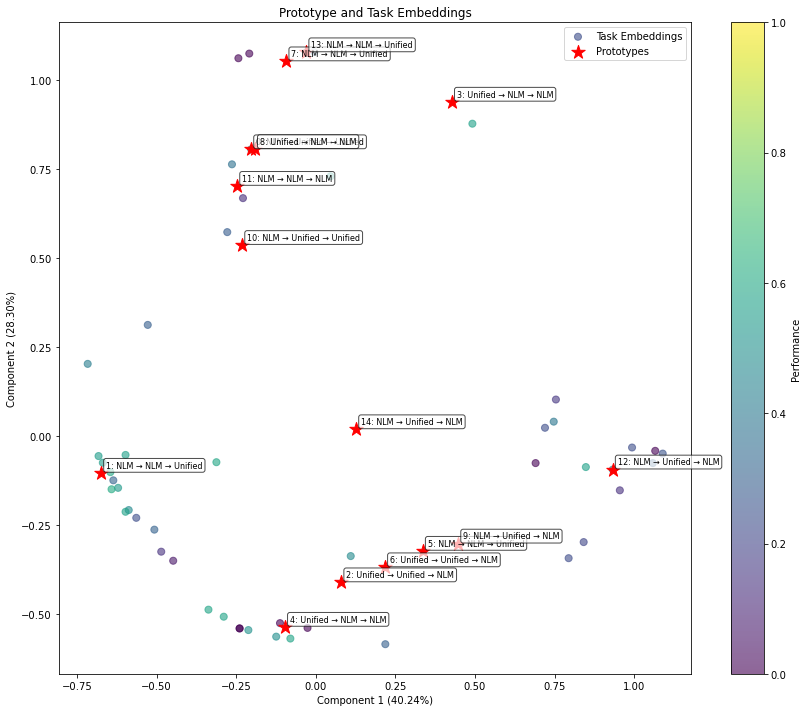

Training MCU:   1%|          | 6/500 [01:48<2:51:37, 20.85s/it]

Iteration 6/500, Cell Accuracy: 0.4380, Grid Accuracy: 0.0000, Epsilon: 0.7219
Module usage: NLM_Adapter: 14, Unified: 10


Training MCU:   1%|▏         | 7/500 [01:50<2:00:54, 14.72s/it]

Iteration 7/500, Cell Accuracy: 0.6252, Grid Accuracy: 0.0000, Epsilon: 0.6832
Module usage: NLM_Adapter: 11, Unified: 10


Training MCU:   2%|▏         | 8/500 [01:53<1:29:44, 10.94s/it]

Iteration 8/500, Cell Accuracy: 0.6675, Grid Accuracy: 0.1000, Epsilon: 0.6466
Module usage: NLM_Adapter: 13, Unified: 12


Training MCU:   2%|▏         | 9/500 [02:03<1:28:18, 10.79s/it]

Iteration 9/500, Cell Accuracy: 0.4373, Grid Accuracy: 0.1000, Epsilon: 0.6119
Module usage: NLM_Adapter: 14, Unified: 10
Iteration 10/500, Cell Accuracy: 0.4393, Grid Accuracy: 0.0000, Epsilon: 0.5790
Module usage: NLM_Adapter: 12, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_10.pt


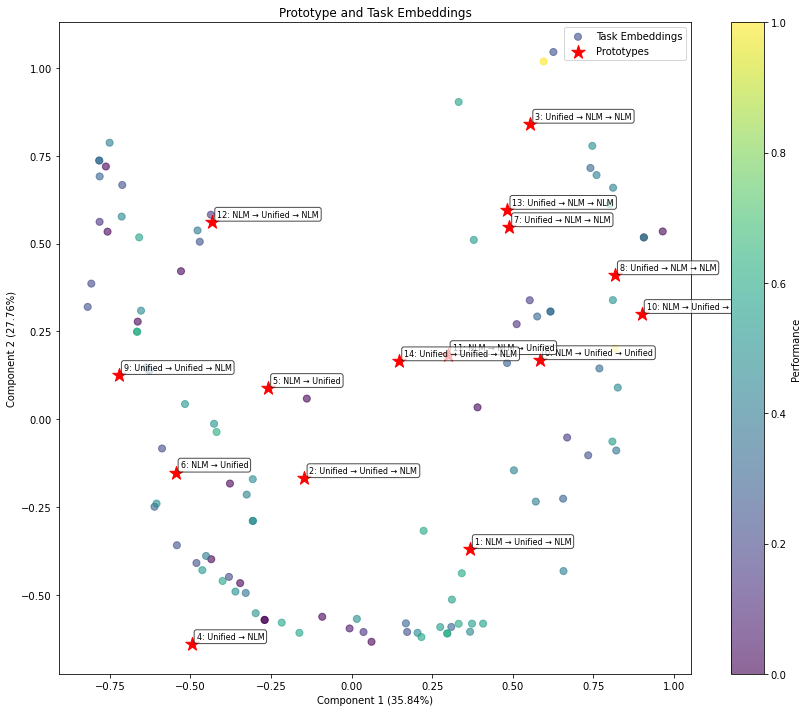

Training MCU:   2%|▏         | 11/500 [02:17<1:11:37,  8.79s/it]

Iteration 11/500, Cell Accuracy: 0.5541, Grid Accuracy: 0.0000, Epsilon: 0.5480
Module usage: NLM_Adapter: 12, Unified: 10


Training MCU:   2%|▏         | 12/500 [02:22<1:01:48,  7.60s/it]

Iteration 12/500, Cell Accuracy: 0.5334, Grid Accuracy: 0.0000, Epsilon: 0.5186
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   3%|▎         | 13/500 [03:01<2:20:20, 17.29s/it]

Iteration 13/500, Cell Accuracy: 0.4800, Grid Accuracy: 0.0000, Epsilon: 0.4908
Module usage: NLM_Adapter: 11, Unified: 12


Training MCU:   3%|▎         | 14/500 [03:04<1:44:45, 12.93s/it]

Iteration 14/500, Cell Accuracy: 0.4943, Grid Accuracy: 0.0000, Epsilon: 0.4644
Module usage: NLM_Adapter: 10, Unified: 12
Iteration 15/500, Cell Accuracy: 0.4297, Grid Accuracy: 0.1000, Epsilon: 0.4395
Module usage: NLM_Adapter: 13, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_15.pt


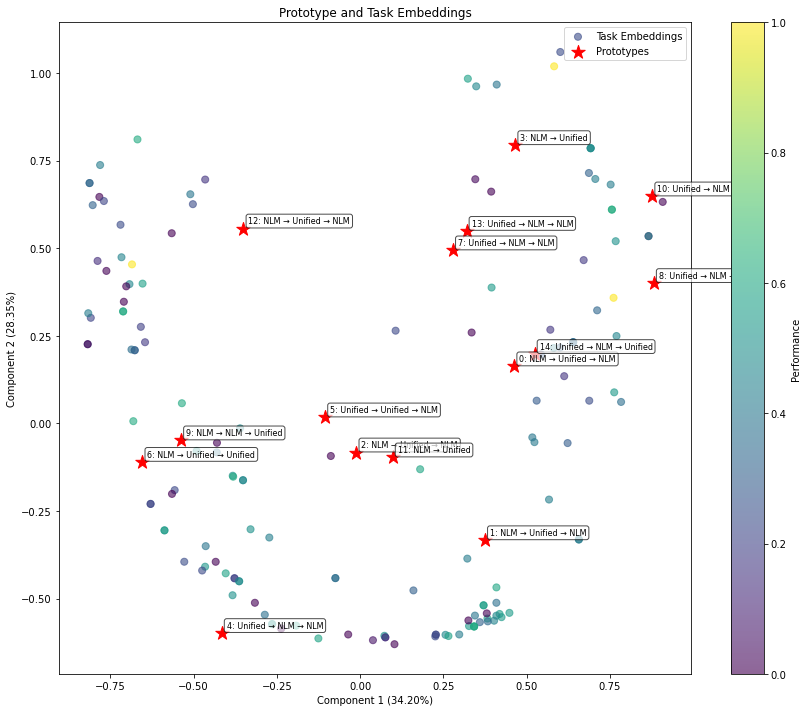

Training MCU:   3%|▎         | 16/500 [03:26<1:38:18, 12.19s/it]

Iteration 16/500, Cell Accuracy: 0.5158, Grid Accuracy: 0.2000, Epsilon: 0.4159
Module usage: NLM_Adapter: 12, Unified: 10


Training MCU:   3%|▎         | 17/500 [03:29<1:16:43,  9.53s/it]

Iteration 17/500, Cell Accuracy: 0.4377, Grid Accuracy: 0.1000, Epsilon: 0.3936
Module usage: NLM_Adapter: 12, Unified: 11


Training MCU:   4%|▎         | 18/500 [03:33<1:01:55,  7.71s/it]

Iteration 18/500, Cell Accuracy: 0.5449, Grid Accuracy: 0.0000, Epsilon: 0.3725
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   4%|▍         | 19/500 [03:35<49:40,  6.20s/it]  

Iteration 19/500, Cell Accuracy: 0.5507, Grid Accuracy: 0.0000, Epsilon: 0.3525
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 20/500, Cell Accuracy: 0.4261, Grid Accuracy: 0.0000, Epsilon: 0.3336
Module usage: NLM_Adapter: 11, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_20.pt


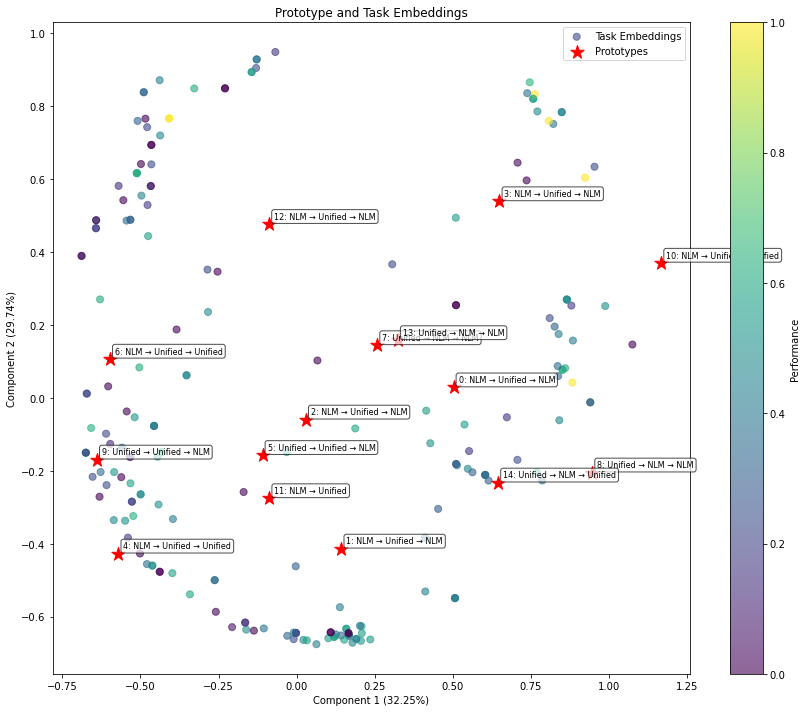

Training MCU:   4%|▍         | 21/500 [04:12<1:32:31, 11.59s/it]

Iteration 21/500, Cell Accuracy: 0.6287, Grid Accuracy: 0.2000, Epsilon: 0.3157
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:   4%|▍         | 22/500 [04:36<2:02:28, 15.37s/it]

Iteration 22/500, Cell Accuracy: 0.2913, Grid Accuracy: 0.0000, Epsilon: 0.2988
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   5%|▍         | 23/500 [04:41<1:36:13, 12.10s/it]

Iteration 23/500, Cell Accuracy: 0.6602, Grid Accuracy: 0.0000, Epsilon: 0.2828
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   5%|▍         | 24/500 [04:59<1:50:01, 13.87s/it]

Iteration 24/500, Cell Accuracy: 0.6976, Grid Accuracy: 0.1000, Epsilon: 0.2676
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 25/500, Cell Accuracy: 0.4445, Grid Accuracy: 0.0000, Epsilon: 0.2532
Module usage: NLM_Adapter: 11, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_25.pt


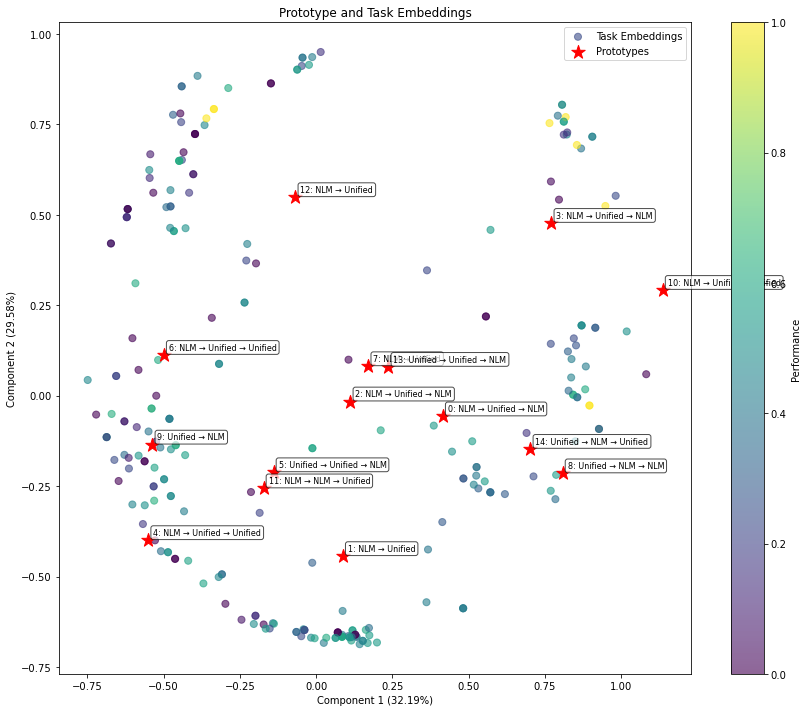

Training MCU:   5%|▌         | 26/500 [05:16<1:28:58, 11.26s/it]

Iteration 26/500, Cell Accuracy: 0.4568, Grid Accuracy: 0.1000, Epsilon: 0.2397
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:   5%|▌         | 27/500 [05:46<2:13:59, 17.00s/it]

Iteration 27/500, Cell Accuracy: 0.5367, Grid Accuracy: 0.1000, Epsilon: 0.2268
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   6%|▌         | 28/500 [05:50<1:42:23, 13.02s/it]

Iteration 28/500, Cell Accuracy: 0.4921, Grid Accuracy: 0.0000, Epsilon: 0.2146
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:   6%|▌         | 29/500 [05:59<1:33:44, 11.94s/it]

Iteration 29/500, Cell Accuracy: 0.4800, Grid Accuracy: 0.0000, Epsilon: 0.2031
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 30/500, Cell Accuracy: 0.5906, Grid Accuracy: 0.0000, Epsilon: 0.1922
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_30.pt


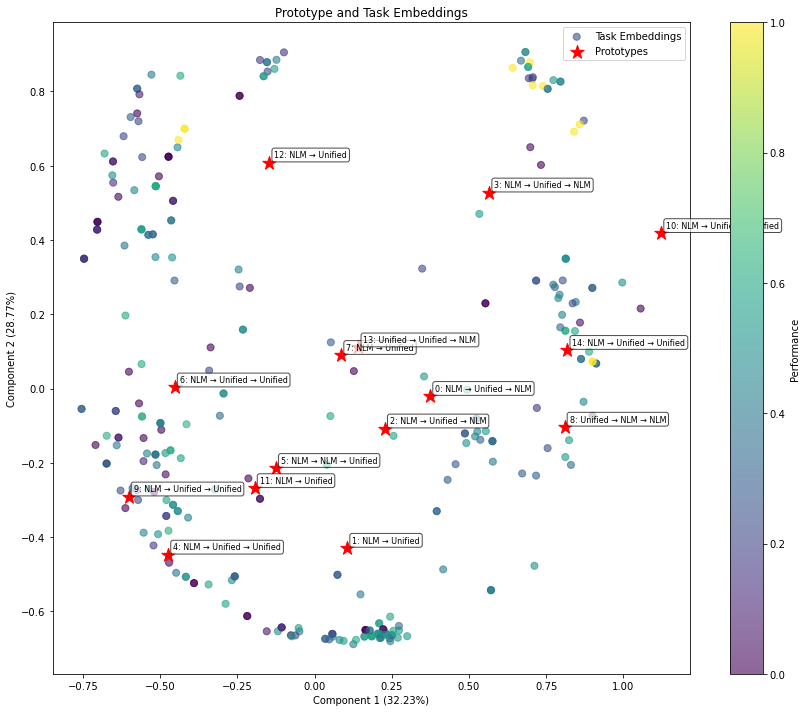

Training MCU:   6%|▌         | 31/500 [06:11<1:08:09,  8.72s/it]

Iteration 31/500, Cell Accuracy: 0.6193, Grid Accuracy: 0.0000, Epsilon: 0.1819
Module usage: NLM_Adapter: 10, Unified: 12


Training MCU:   6%|▋         | 32/500 [06:14<53:57,  6.92s/it]  

Iteration 32/500, Cell Accuracy: 0.6842, Grid Accuracy: 0.0000, Epsilon: 0.1721
Module usage: NLM_Adapter: 10, Unified: 12


Training MCU:   7%|▋         | 33/500 [06:32<1:18:41, 10.11s/it]

Iteration 33/500, Cell Accuracy: 0.3556, Grid Accuracy: 0.0000, Epsilon: 0.1629
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   7%|▋         | 34/500 [06:48<1:33:07, 11.99s/it]

Iteration 34/500, Cell Accuracy: 0.4952, Grid Accuracy: 0.0000, Epsilon: 0.1542
Module usage: NLM_Adapter: 11, Unified: 10
Iteration 35/500, Cell Accuracy: 0.5148, Grid Accuracy: 0.0000, Epsilon: 0.1459
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_35.pt


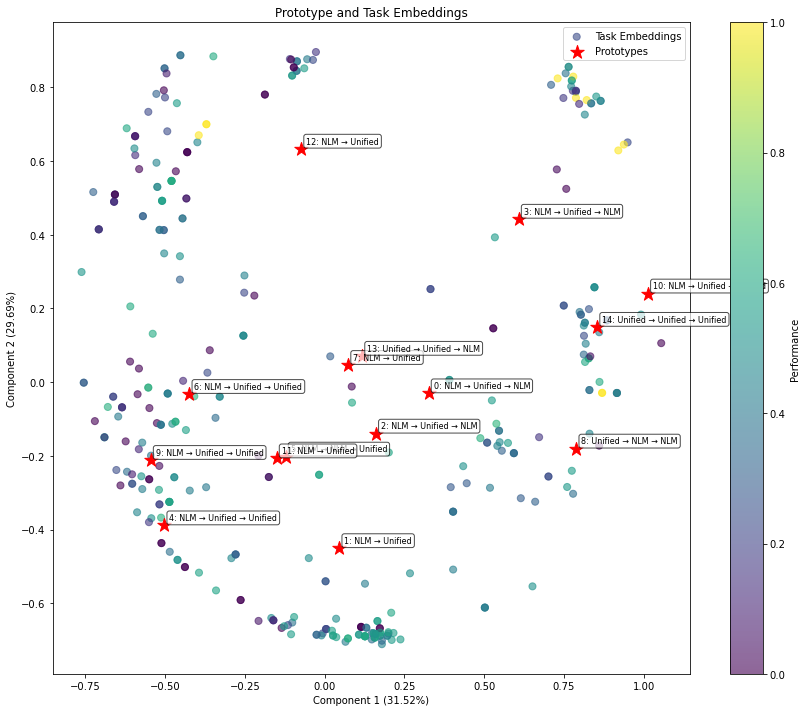

Training MCU:   7%|▋         | 36/500 [06:55<59:00,  7.63s/it]  

Iteration 36/500, Cell Accuracy: 0.4459, Grid Accuracy: 0.1000, Epsilon: 0.1381
Module usage: NLM_Adapter: 9, Unified: 13


Training MCU:   7%|▋         | 37/500 [07:00<51:06,  6.62s/it]

Iteration 37/500, Cell Accuracy: 0.5227, Grid Accuracy: 0.0000, Epsilon: 0.1307
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   8%|▊         | 38/500 [07:02<40:58,  5.32s/it]

Iteration 38/500, Cell Accuracy: 0.6063, Grid Accuracy: 0.0000, Epsilon: 0.1237
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:   8%|▊         | 39/500 [07:14<57:15,  7.45s/it]

Iteration 39/500, Cell Accuracy: 0.6377, Grid Accuracy: 0.1000, Epsilon: 0.1170
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 40/500, Cell Accuracy: 0.5299, Grid Accuracy: 0.0000, Epsilon: 0.1107
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_40.pt


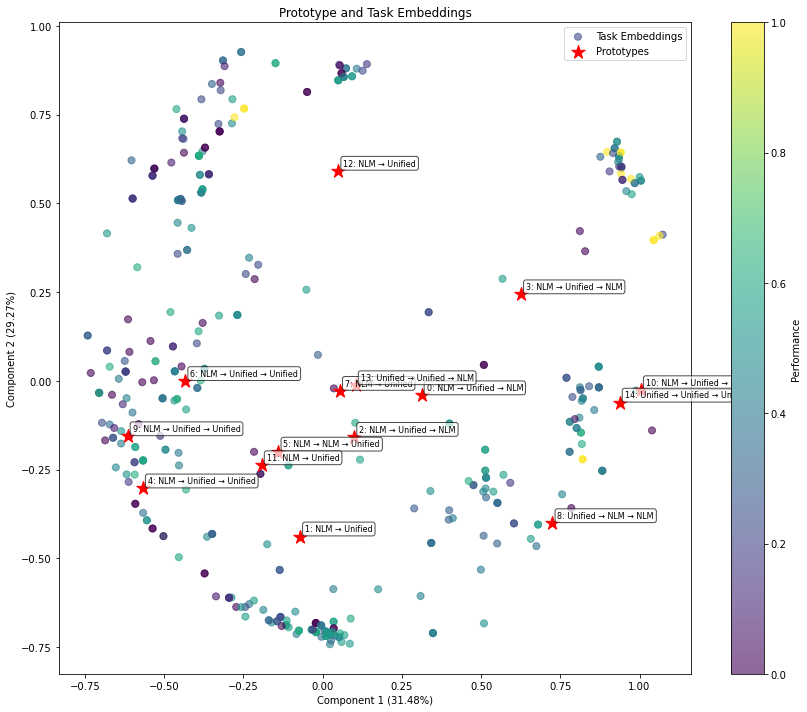

Training MCU:   8%|▊         | 41/500 [07:30<1:01:03,  7.98s/it]

Iteration 41/500, Cell Accuracy: 0.5417, Grid Accuracy: 0.0000, Epsilon: 0.1048
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:   8%|▊         | 42/500 [07:38<1:00:04,  7.87s/it]

Iteration 42/500, Cell Accuracy: 0.5092, Grid Accuracy: 0.0000, Epsilon: 0.0992
Module usage: NLM_Adapter: 12, Unified: 11


Training MCU:   9%|▊         | 43/500 [07:58<1:27:56, 11.55s/it]

Iteration 43/500, Cell Accuracy: 0.5960, Grid Accuracy: 0.2000, Epsilon: 0.0939
Module usage: NLM_Adapter: 10, Unified: 12


Training MCU:   9%|▉         | 44/500 [08:02<1:11:59,  9.47s/it]

Iteration 44/500, Cell Accuracy: 0.5202, Grid Accuracy: 0.2000, Epsilon: 0.0888
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 45/500, Cell Accuracy: 0.4820, Grid Accuracy: 0.0000, Epsilon: 0.0841
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_45.pt


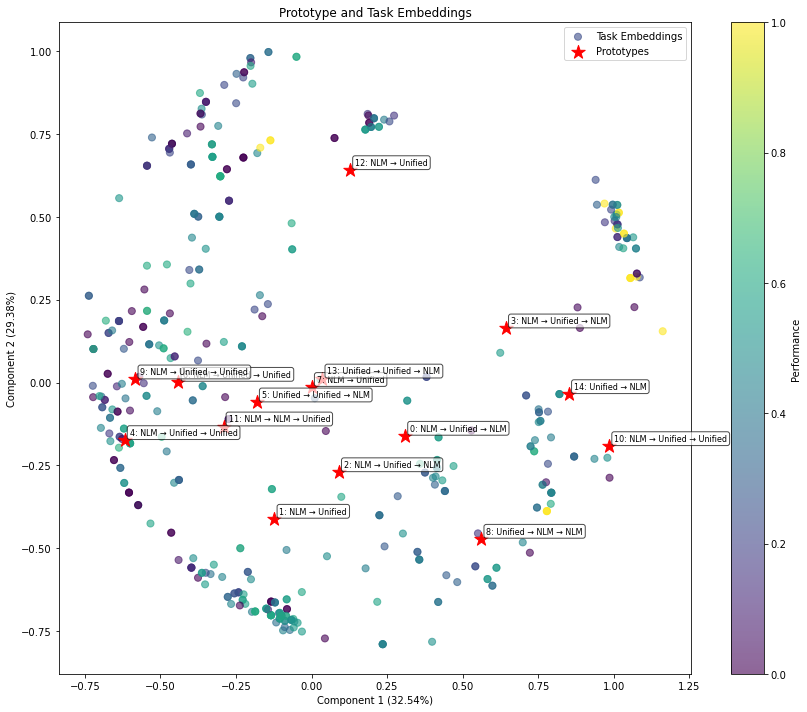

Training MCU:   9%|▉         | 46/500 [08:15<57:53,  7.65s/it]  

Iteration 46/500, Cell Accuracy: 0.5670, Grid Accuracy: 0.0000, Epsilon: 0.0796
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:   9%|▉         | 47/500 [08:19<49:16,  6.53s/it]

Iteration 47/500, Cell Accuracy: 0.5528, Grid Accuracy: 0.0000, Epsilon: 0.0753
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  10%|▉         | 48/500 [08:26<51:33,  6.84s/it]

Iteration 48/500, Cell Accuracy: 0.5223, Grid Accuracy: 0.0000, Epsilon: 0.0712
Module usage: NLM_Adapter: 11, Unified: 10


Training MCU:  10%|▉         | 49/500 [08:28<41:17,  5.49s/it]

Iteration 49/500, Cell Accuracy: 0.5780, Grid Accuracy: 0.0000, Epsilon: 0.0674
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 50/500, Cell Accuracy: 0.5288, Grid Accuracy: 0.0000, Epsilon: 0.0638
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_50.pt


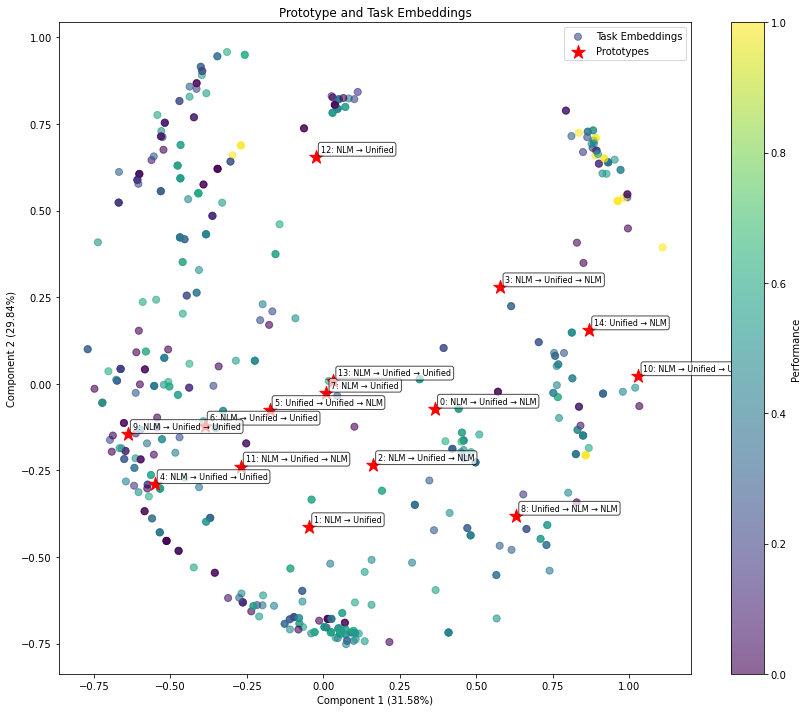

Training MCU:  10%|█         | 51/500 [08:43<43:54,  5.87s/it]

Iteration 51/500, Cell Accuracy: 0.6439, Grid Accuracy: 0.0000, Epsilon: 0.0604
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  10%|█         | 52/500 [08:47<39:13,  5.25s/it]

Iteration 52/500, Cell Accuracy: 0.6145, Grid Accuracy: 0.1000, Epsilon: 0.0571
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  11%|█         | 53/500 [08:49<32:55,  4.42s/it]

Iteration 53/500, Cell Accuracy: 0.4969, Grid Accuracy: 0.0000, Epsilon: 0.0541
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  11%|█         | 54/500 [09:07<1:02:59,  8.47s/it]

Iteration 54/500, Cell Accuracy: 0.4923, Grid Accuracy: 0.2000, Epsilon: 0.0512
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 55/500, Cell Accuracy: 0.5234, Grid Accuracy: 0.0000, Epsilon: 0.0484
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_55.pt


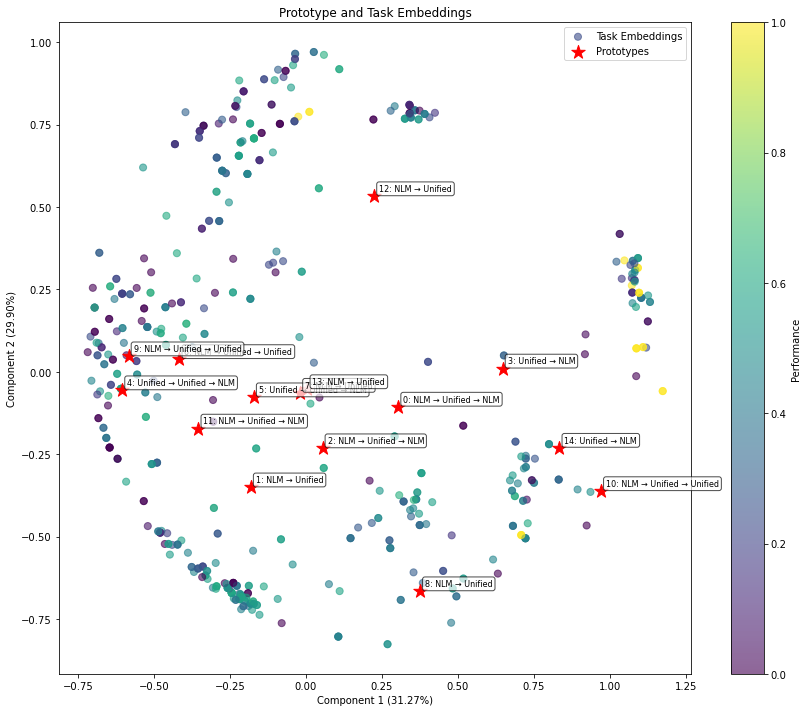

Training MCU:  11%|█         | 56/500 [09:16<47:52,  6.47s/it]  

Iteration 56/500, Cell Accuracy: 0.5055, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  11%|█▏        | 57/500 [09:19<40:23,  5.47s/it]

Iteration 57/500, Cell Accuracy: 0.5267, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:  12%|█▏        | 58/500 [09:35<1:02:02,  8.42s/it]

Iteration 58/500, Cell Accuracy: 0.3779, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  12%|█▏        | 59/500 [09:39<52:17,  7.11s/it]  

Iteration 59/500, Cell Accuracy: 0.4487, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 60/500, Cell Accuracy: 0.4434, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_60.pt


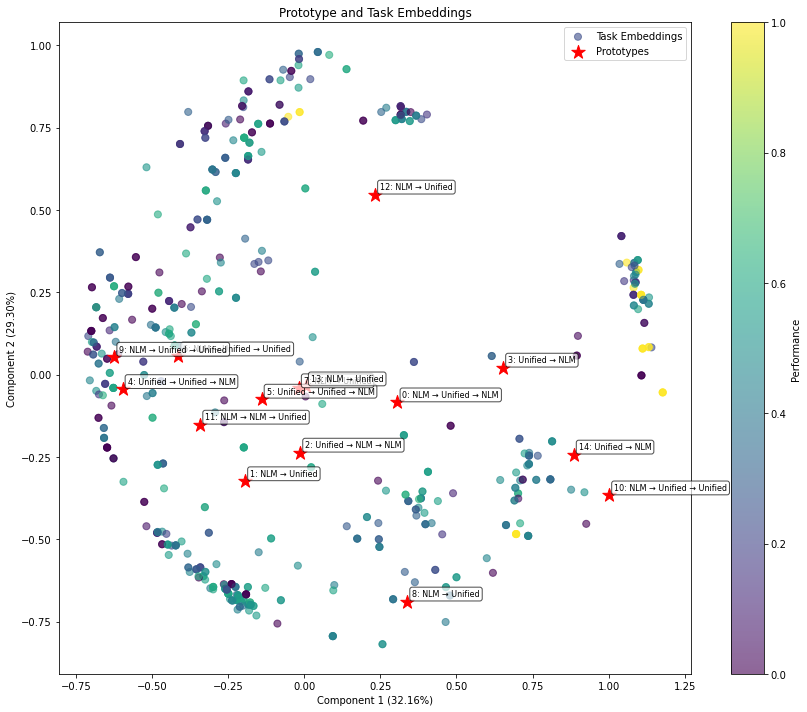

Training MCU:  12%|█▏        | 61/500 [10:01<1:05:28,  8.95s/it]

Iteration 61/500, Cell Accuracy: 0.4965, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  12%|█▏        | 62/500 [10:06<56:13,  7.70s/it]  

Iteration 62/500, Cell Accuracy: 0.5657, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  13%|█▎        | 63/500 [10:09<45:42,  6.28s/it]

Iteration 63/500, Cell Accuracy: 0.5093, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  13%|█▎        | 64/500 [10:18<51:41,  7.11s/it]

Iteration 64/500, Cell Accuracy: 0.2963, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 65/500, Cell Accuracy: 0.5493, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_65.pt


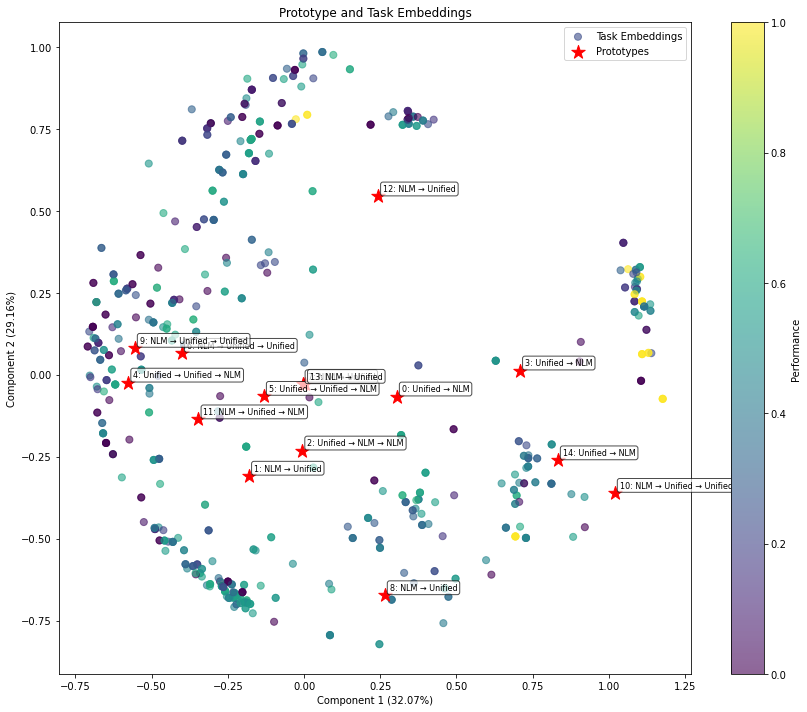

Training MCU:  13%|█▎        | 66/500 [10:40<1:07:29,  9.33s/it]

Iteration 66/500, Cell Accuracy: 0.4966, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  13%|█▎        | 67/500 [10:43<54:07,  7.50s/it]  

Iteration 67/500, Cell Accuracy: 0.5721, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  14%|█▎        | 68/500 [10:51<54:01,  7.50s/it]

Iteration 68/500, Cell Accuracy: 0.5979, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  14%|█▍        | 69/500 [10:52<42:00,  5.85s/it]

Iteration 69/500, Cell Accuracy: 0.6019, Grid Accuracy: 0.3000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 70/500, Cell Accuracy: 0.3665, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_70.pt


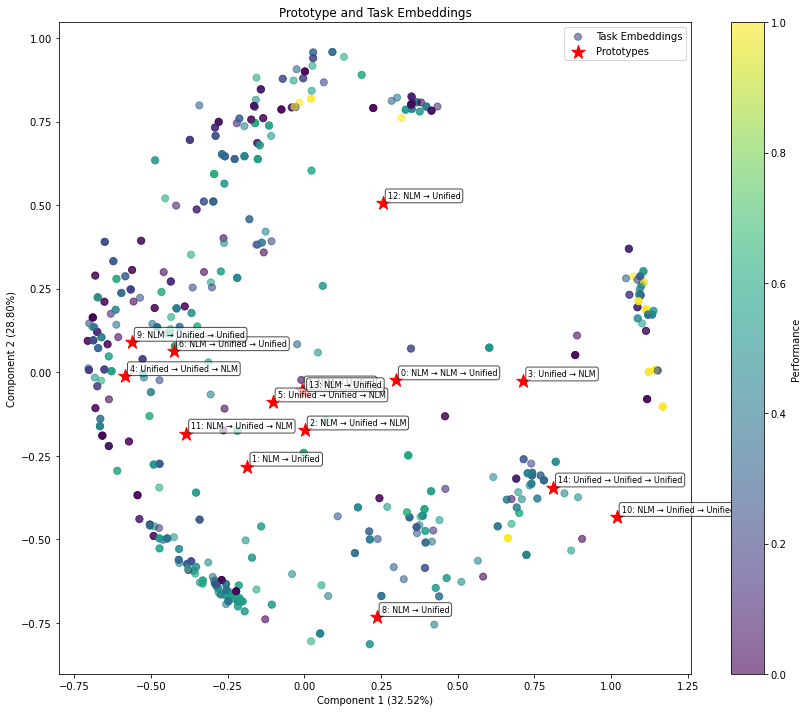

Training MCU:  14%|█▍        | 71/500 [11:09<49:45,  6.96s/it]

Iteration 71/500, Cell Accuracy: 0.4400, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  14%|█▍        | 72/500 [11:12<39:59,  5.61s/it]

Iteration 72/500, Cell Accuracy: 0.4987, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  15%|█▍        | 73/500 [11:25<57:02,  8.02s/it]

Iteration 73/500, Cell Accuracy: 0.3182, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:  15%|█▍        | 74/500 [11:33<55:45,  7.85s/it]

Iteration 74/500, Cell Accuracy: 0.4220, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 75/500, Cell Accuracy: 0.4286, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_75.pt


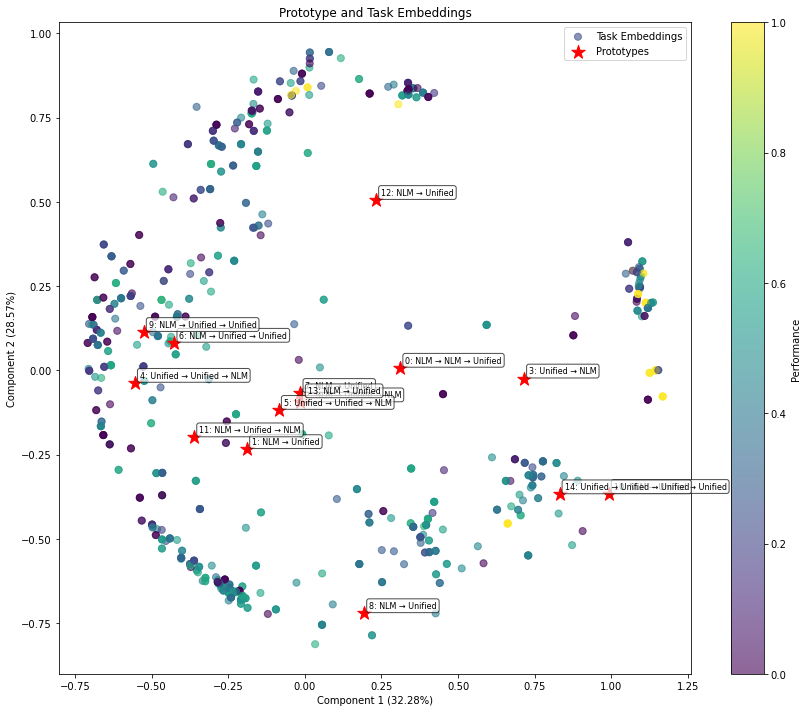

Training MCU:  15%|█▌        | 76/500 [11:54<1:00:22,  8.54s/it]

Iteration 76/500, Cell Accuracy: 0.5963, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  15%|█▌        | 77/500 [11:57<49:03,  6.96s/it]  

Iteration 77/500, Cell Accuracy: 0.5995, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  16%|█▌        | 78/500 [12:16<1:13:42, 10.48s/it]

Iteration 78/500, Cell Accuracy: 0.5813, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  16%|█▌        | 79/500 [12:23<1:07:34,  9.63s/it]

Iteration 79/500, Cell Accuracy: 0.6067, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 80/500, Cell Accuracy: 0.5358, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_80.pt


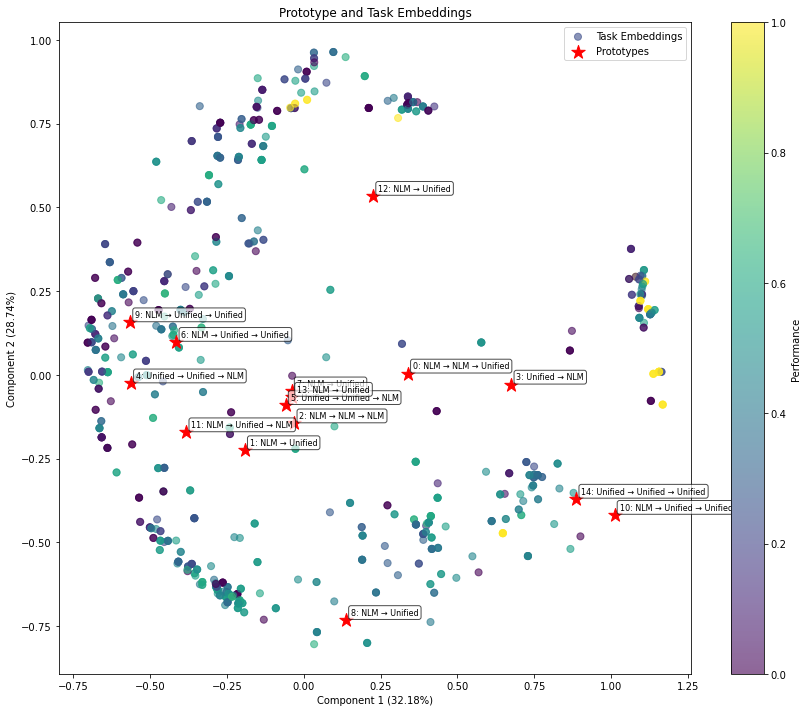

Training MCU:  16%|█▌        | 81/500 [12:36<54:24,  7.79s/it]  

Iteration 81/500, Cell Accuracy: 0.4887, Grid Accuracy: 0.1500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  16%|█▋        | 82/500 [12:41<50:18,  7.22s/it]

Iteration 82/500, Cell Accuracy: 0.5977, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  17%|█▋        | 83/500 [12:44<40:25,  5.82s/it]

Iteration 83/500, Cell Accuracy: 0.7112, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  17%|█▋        | 84/500 [12:48<36:47,  5.31s/it]

Iteration 84/500, Cell Accuracy: 0.6099, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 85/500, Cell Accuracy: 0.4063, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_85.pt


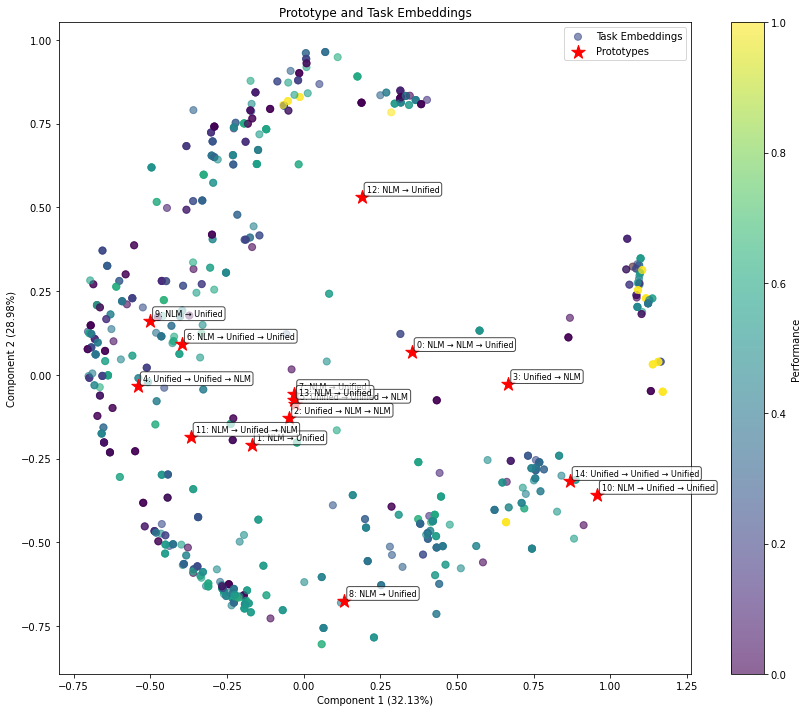

Training MCU:  17%|█▋        | 86/500 [13:15<59:14,  8.58s/it]  

Iteration 86/500, Cell Accuracy: 0.4494, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  17%|█▋        | 87/500 [13:17<45:49,  6.66s/it]

Iteration 87/500, Cell Accuracy: 0.4832, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  18%|█▊        | 88/500 [13:25<48:43,  7.10s/it]

Iteration 88/500, Cell Accuracy: 0.3886, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  18%|█▊        | 89/500 [13:29<41:23,  6.04s/it]

Iteration 89/500, Cell Accuracy: 0.6031, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 11
Iteration 90/500, Cell Accuracy: 0.5083, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_90.pt


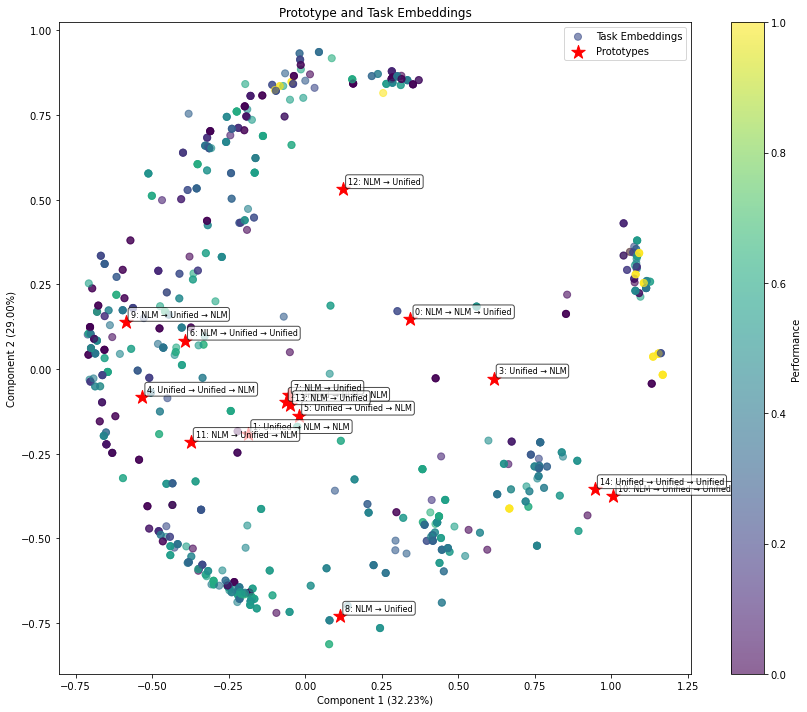

Training MCU:  18%|█▊        | 91/500 [13:38<35:49,  5.26s/it]

Iteration 91/500, Cell Accuracy: 0.3318, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  18%|█▊        | 92/500 [13:54<56:24,  8.30s/it]

Iteration 92/500, Cell Accuracy: 0.6387, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 12


Training MCU:  19%|█▊        | 93/500 [14:00<53:15,  7.85s/it]

Iteration 93/500, Cell Accuracy: 0.4971, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 11


Training MCU:  19%|█▉        | 94/500 [14:04<45:29,  6.72s/it]

Iteration 94/500, Cell Accuracy: 0.5106, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 95/500, Cell Accuracy: 0.3868, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_95.pt


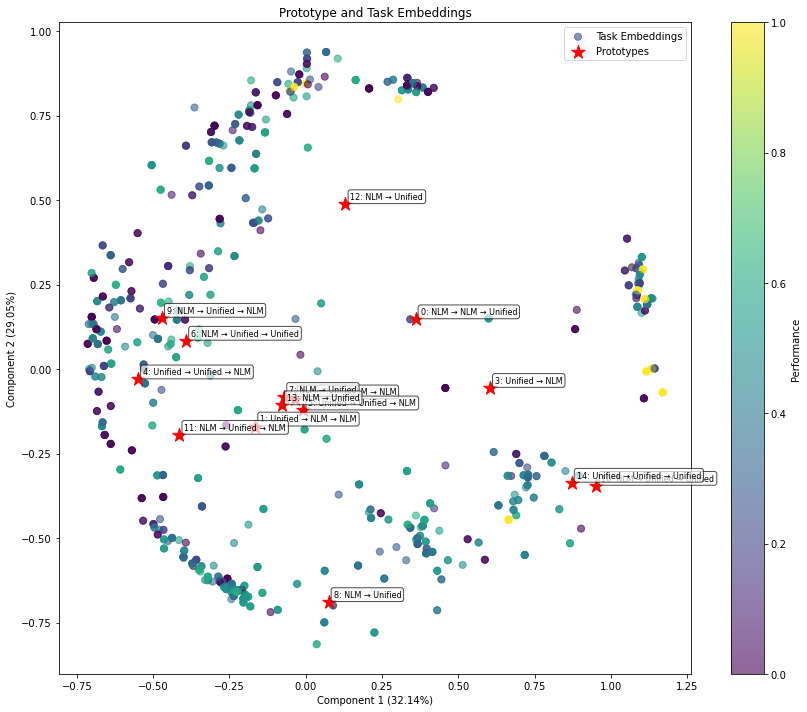

Training MCU:  19%|█▉        | 96/500 [14:28<1:02:55,  9.34s/it]

Iteration 96/500, Cell Accuracy: 0.4587, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  19%|█▉        | 97/500 [14:34<57:21,  8.54s/it]  

Iteration 97/500, Cell Accuracy: 0.5071, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  20%|█▉        | 98/500 [14:45<1:00:36,  9.05s/it]

Iteration 98/500, Cell Accuracy: 0.3858, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  20%|█▉        | 99/500 [15:04<1:20:21, 12.02s/it]

Iteration 99/500, Cell Accuracy: 0.4778, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 100/500, Cell Accuracy: 0.7100, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_100.pt


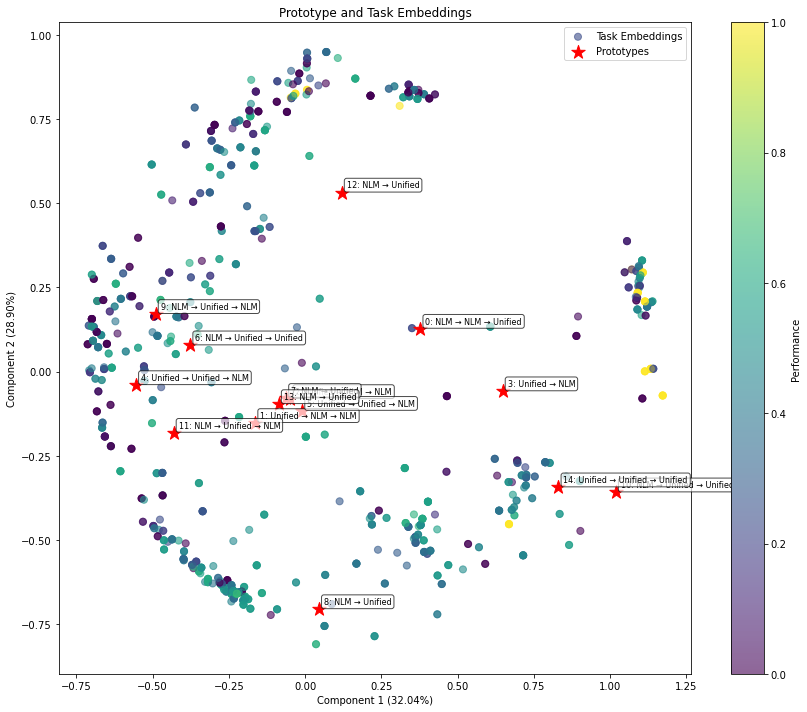

Training MCU:  20%|██        | 101/500 [15:17<1:01:02,  9.18s/it]

Iteration 101/500, Cell Accuracy: 0.6293, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  20%|██        | 102/500 [15:32<1:13:34, 11.09s/it]

Iteration 102/500, Cell Accuracy: 0.4357, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  21%|██        | 103/500 [15:35<56:08,  8.49s/it]  

Iteration 103/500, Cell Accuracy: 0.5934, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  21%|██        | 104/500 [15:38<44:40,  6.77s/it]

Iteration 104/500, Cell Accuracy: 0.6505, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 11
Iteration 105/500, Cell Accuracy: 0.4290, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_105.pt


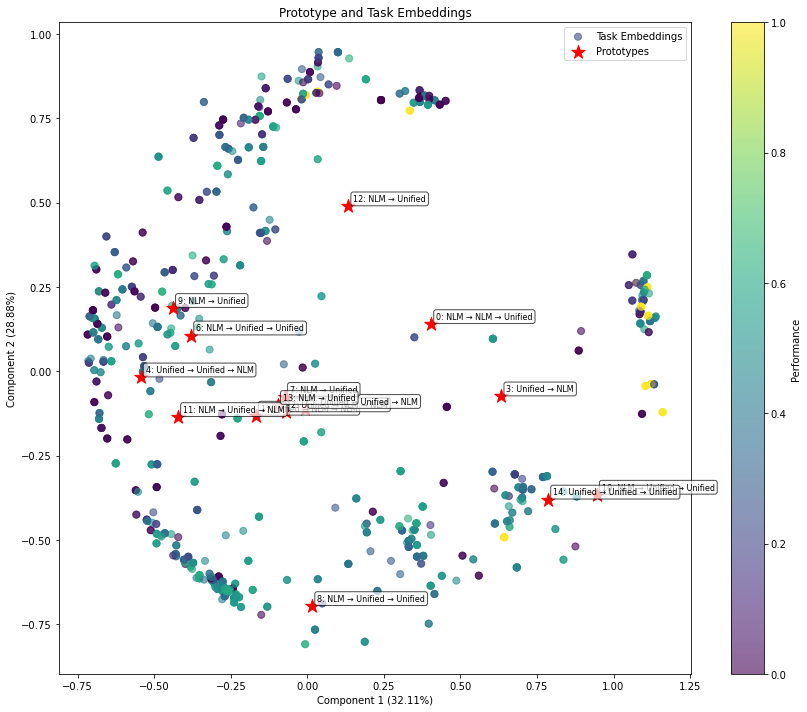

Training MCU:  21%|██        | 106/500 [15:53<48:09,  7.33s/it]

Iteration 106/500, Cell Accuracy: 0.4045, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  21%|██▏       | 107/500 [16:07<1:00:10,  9.19s/it]

Iteration 107/500, Cell Accuracy: 0.4068, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  22%|██▏       | 108/500 [16:09<46:15,  7.08s/it]  

Iteration 108/500, Cell Accuracy: 0.5441, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  22%|██▏       | 109/500 [16:12<38:38,  5.93s/it]

Iteration 109/500, Cell Accuracy: 0.6827, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 110/500, Cell Accuracy: 0.5735, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_110.pt


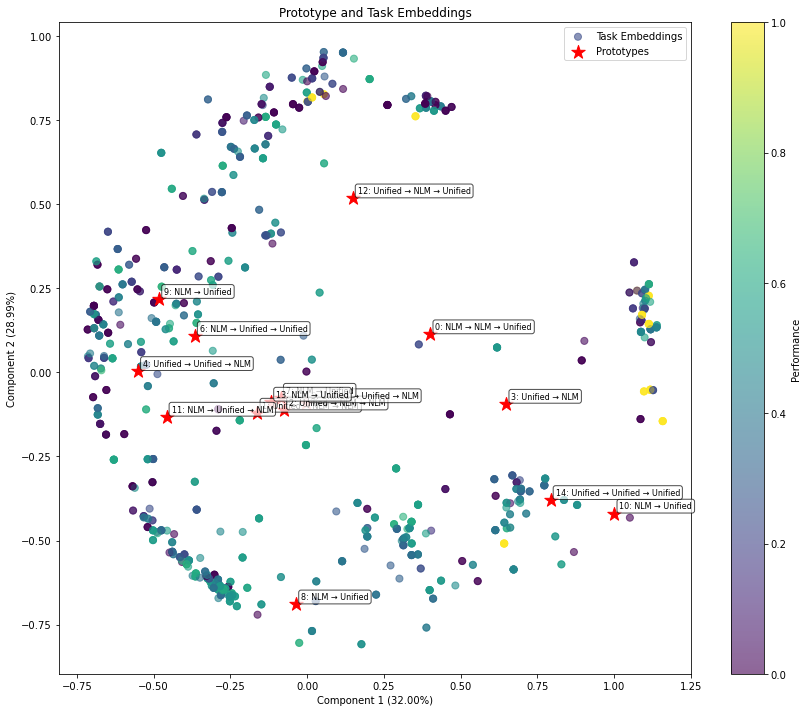

Training MCU:  22%|██▏       | 111/500 [16:24<39:02,  6.02s/it]

Iteration 111/500, Cell Accuracy: 0.5387, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 10


Training MCU:  22%|██▏       | 112/500 [16:27<32:43,  5.06s/it]

Iteration 112/500, Cell Accuracy: 0.7212, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  23%|██▎       | 113/500 [16:38<44:21,  6.88s/it]

Iteration 113/500, Cell Accuracy: 0.4493, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  23%|██▎       | 114/500 [16:44<43:18,  6.73s/it]

Iteration 114/500, Cell Accuracy: 0.1591, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 115/500, Cell Accuracy: 0.5755, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_115.pt


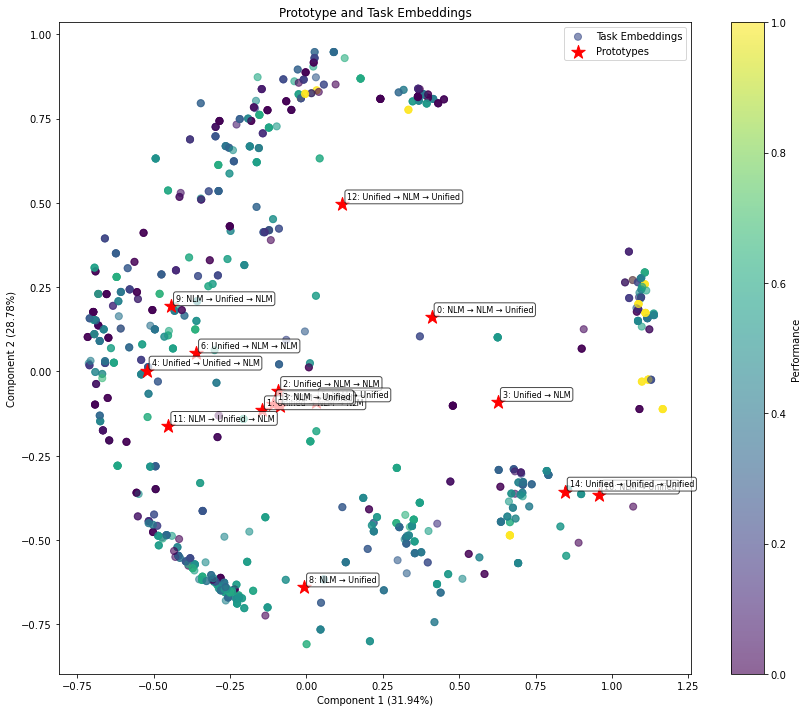

Training MCU:  23%|██▎       | 116/500 [16:58<45:13,  7.07s/it]

Iteration 116/500, Cell Accuracy: 0.2904, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  23%|██▎       | 117/500 [17:01<37:00,  5.80s/it]

Iteration 117/500, Cell Accuracy: 0.5745, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 12


Training MCU:  24%|██▎       | 118/500 [17:11<43:44,  6.87s/it]

Iteration 118/500, Cell Accuracy: 0.5347, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  24%|██▍       | 119/500 [17:20<48:04,  7.57s/it]

Iteration 119/500, Cell Accuracy: 0.4748, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 120/500, Cell Accuracy: 0.5595, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_120.pt


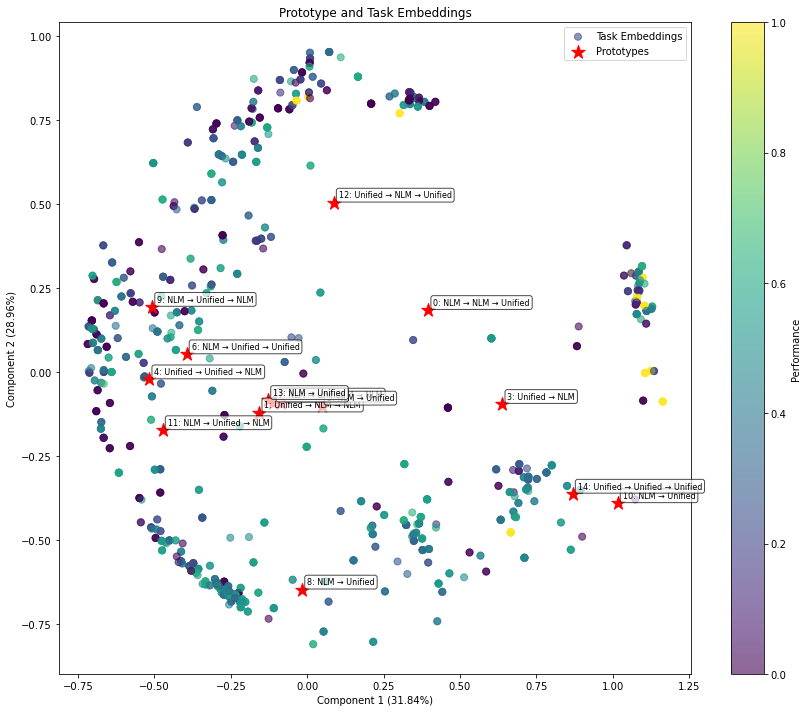

Training MCU:  24%|██▍       | 121/500 [17:31<41:13,  6.53s/it]

Iteration 121/500, Cell Accuracy: 0.4905, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  24%|██▍       | 122/500 [17:34<33:48,  5.37s/it]

Iteration 122/500, Cell Accuracy: 0.5140, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  25%|██▍       | 123/500 [17:50<53:22,  8.50s/it]

Iteration 123/500, Cell Accuracy: 0.4089, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  25%|██▍       | 124/500 [17:57<51:49,  8.27s/it]

Iteration 124/500, Cell Accuracy: 0.4525, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 125/500, Cell Accuracy: 0.3533, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_125.pt


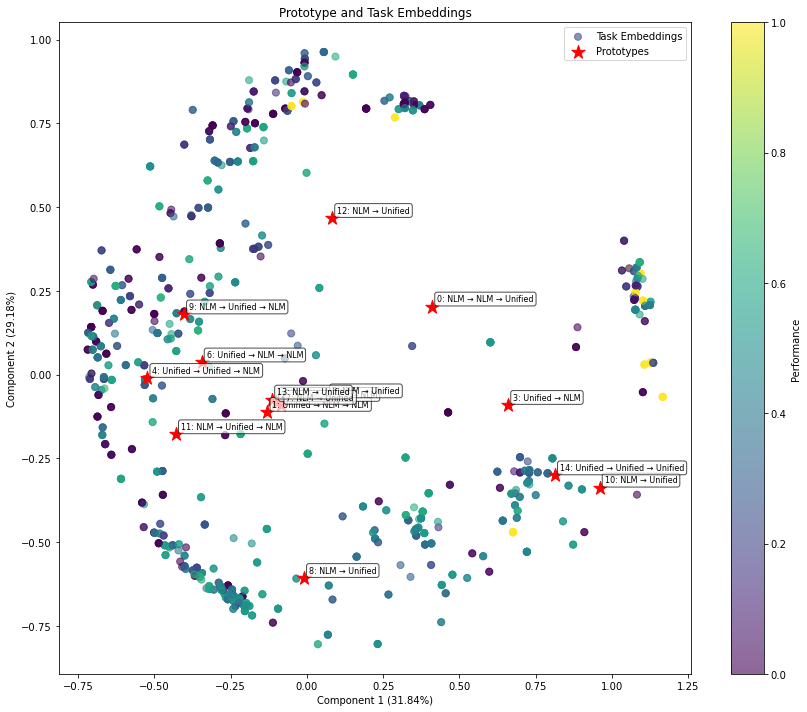

Training MCU:  25%|██▌       | 126/500 [18:11<45:57,  7.37s/it]

Iteration 126/500, Cell Accuracy: 0.3879, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  25%|██▌       | 127/500 [18:14<37:22,  6.01s/it]

Iteration 127/500, Cell Accuracy: 0.5565, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  26%|██▌       | 128/500 [18:18<34:17,  5.53s/it]

Iteration 128/500, Cell Accuracy: 0.3123, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  26%|██▌       | 129/500 [18:25<36:54,  5.97s/it]

Iteration 129/500, Cell Accuracy: 0.2947, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 10
Iteration 130/500, Cell Accuracy: 0.6164, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_130.pt


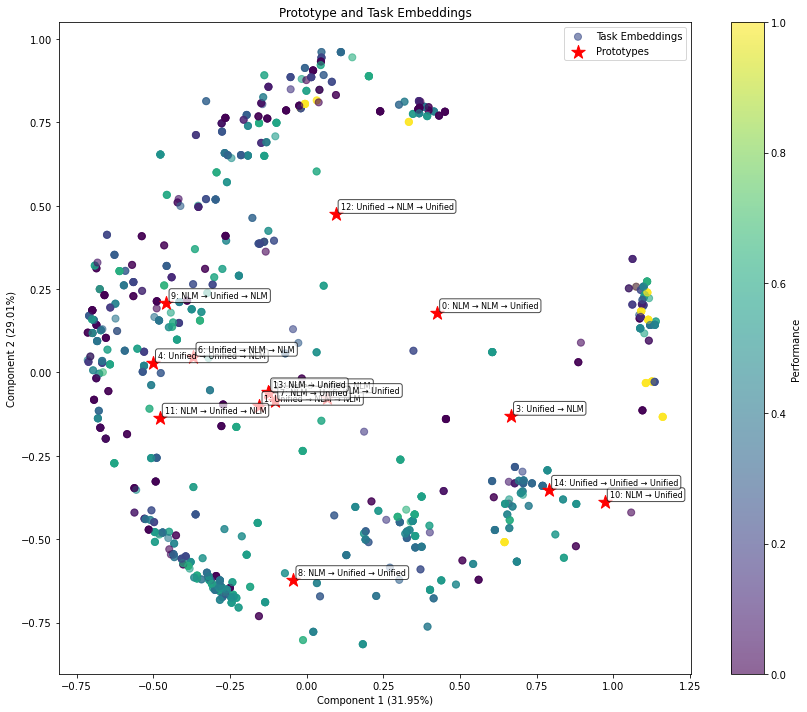

Training MCU:  26%|██▌       | 131/500 [18:36<33:26,  5.44s/it]

Iteration 131/500, Cell Accuracy: 0.6628, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  26%|██▋       | 132/500 [18:42<34:43,  5.66s/it]

Iteration 132/500, Cell Accuracy: 0.3342, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  27%|██▋       | 133/500 [18:49<38:00,  6.21s/it]

Iteration 133/500, Cell Accuracy: 0.4889, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  27%|██▋       | 134/500 [18:57<40:21,  6.62s/it]

Iteration 134/500, Cell Accuracy: 0.4813, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 135/500, Cell Accuracy: 0.5588, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_135.pt


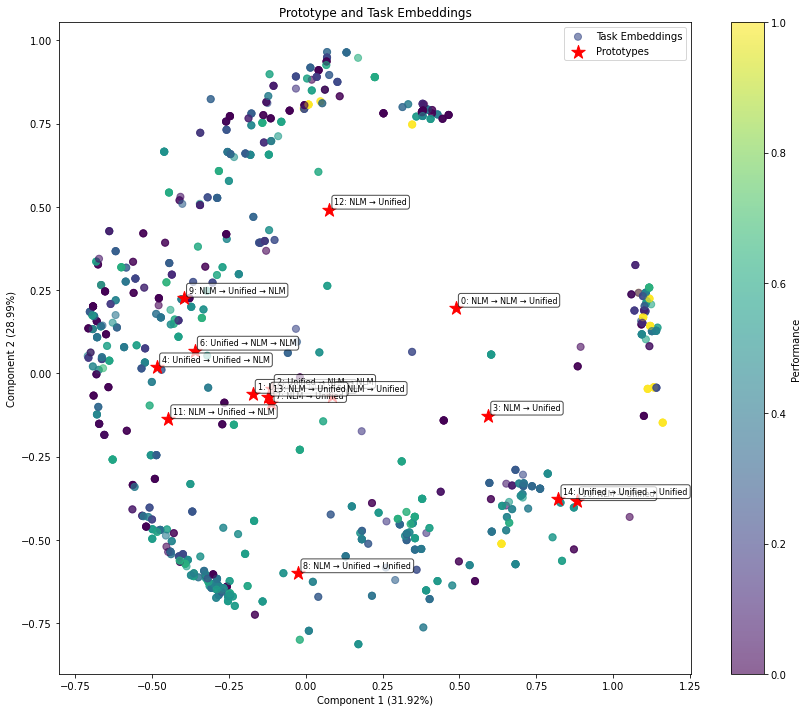

Training MCU:  27%|██▋       | 136/500 [19:13<44:08,  7.28s/it]

Iteration 136/500, Cell Accuracy: 0.3994, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  27%|██▋       | 137/500 [19:16<36:12,  5.99s/it]

Iteration 137/500, Cell Accuracy: 0.4090, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  28%|██▊       | 138/500 [19:29<48:01,  7.96s/it]

Iteration 138/500, Cell Accuracy: 0.5609, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  28%|██▊       | 139/500 [19:33<40:38,  6.75s/it]

Iteration 139/500, Cell Accuracy: 0.5674, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 140/500, Cell Accuracy: 0.5611, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_140.pt


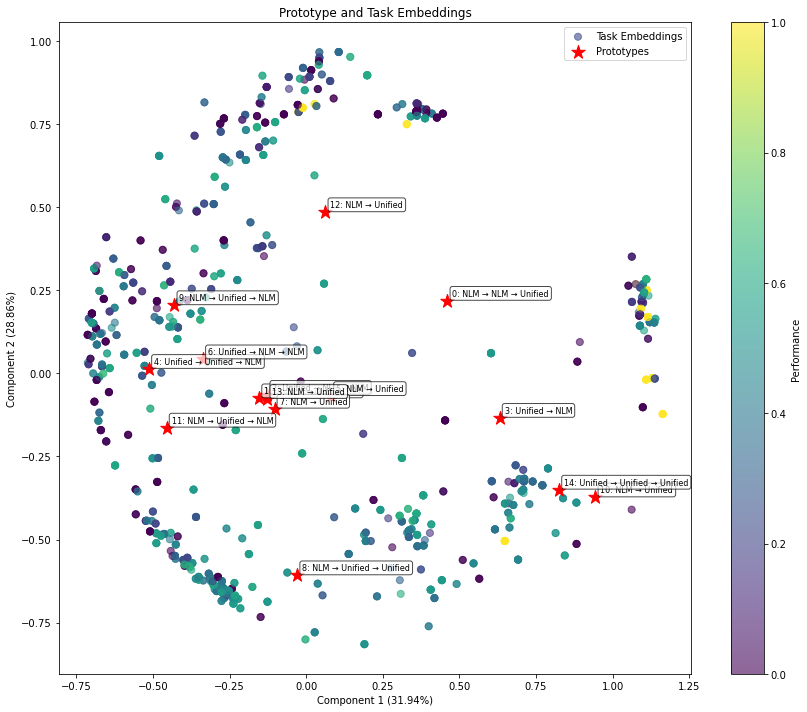

Training MCU:  28%|██▊       | 141/500 [20:03<1:10:24, 11.77s/it]

Iteration 141/500, Cell Accuracy: 0.4339, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  28%|██▊       | 142/500 [20:09<59:54, 10.04s/it]  

Iteration 142/500, Cell Accuracy: 0.4775, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  29%|██▊       | 143/500 [20:13<49:04,  8.25s/it]

Iteration 143/500, Cell Accuracy: 0.4078, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  29%|██▉       | 144/500 [20:22<51:08,  8.62s/it]

Iteration 144/500, Cell Accuracy: 0.2134, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 145/500, Cell Accuracy: 0.5349, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_145.pt


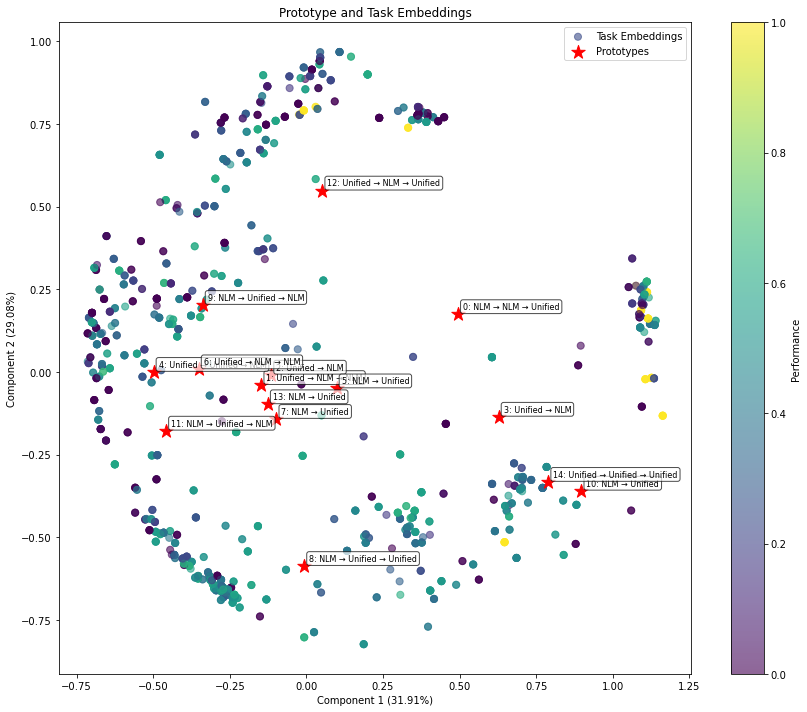

Training MCU:  29%|██▉       | 146/500 [20:41<52:33,  8.91s/it]

Iteration 146/500, Cell Accuracy: 0.3859, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  29%|██▉       | 147/500 [20:56<1:02:09, 10.56s/it]

Iteration 147/500, Cell Accuracy: 0.6857, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  30%|██▉       | 148/500 [21:10<1:08:14, 11.63s/it]

Iteration 148/500, Cell Accuracy: 0.3326, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  30%|██▉       | 149/500 [21:20<1:05:44, 11.24s/it]

Iteration 149/500, Cell Accuracy: 0.5307, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 150/500, Cell Accuracy: 0.7033, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_150.pt


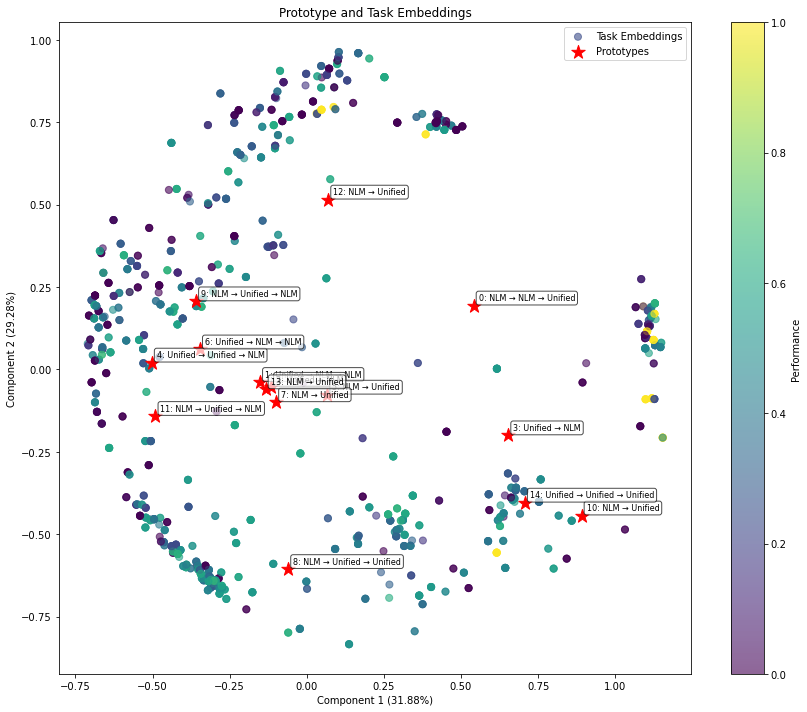

Training MCU:  30%|███       | 151/500 [21:35<51:30,  8.86s/it]  

Iteration 151/500, Cell Accuracy: 0.6483, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  30%|███       | 152/500 [21:39<42:34,  7.34s/it]

Iteration 152/500, Cell Accuracy: 0.5168, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  31%|███       | 153/500 [21:45<40:03,  6.93s/it]

Iteration 153/500, Cell Accuracy: 0.5164, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  31%|███       | 154/500 [21:48<33:50,  5.87s/it]

Iteration 154/500, Cell Accuracy: 0.4833, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 155/500, Cell Accuracy: 0.4512, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_155.pt


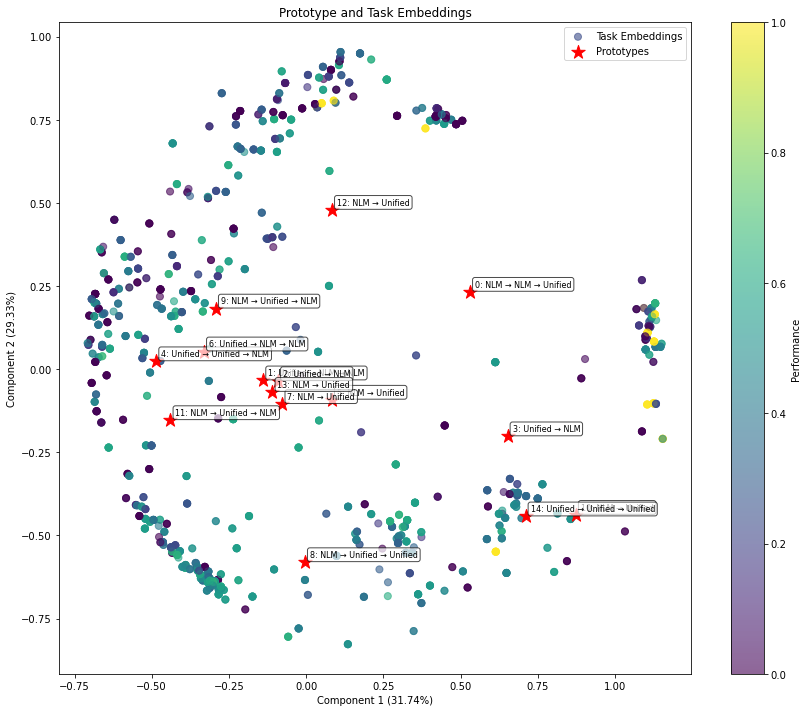

Training MCU:  31%|███       | 156/500 [22:03<36:45,  6.41s/it]

Iteration 156/500, Cell Accuracy: 0.4137, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  31%|███▏      | 157/500 [22:14<44:43,  7.82s/it]

Iteration 157/500, Cell Accuracy: 0.4265, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  32%|███▏      | 158/500 [22:30<59:44, 10.48s/it]

Iteration 158/500, Cell Accuracy: 0.3896, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  32%|███▏      | 159/500 [22:35<49:49,  8.77s/it]

Iteration 159/500, Cell Accuracy: 0.5833, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 160/500, Cell Accuracy: 0.4216, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_160.pt


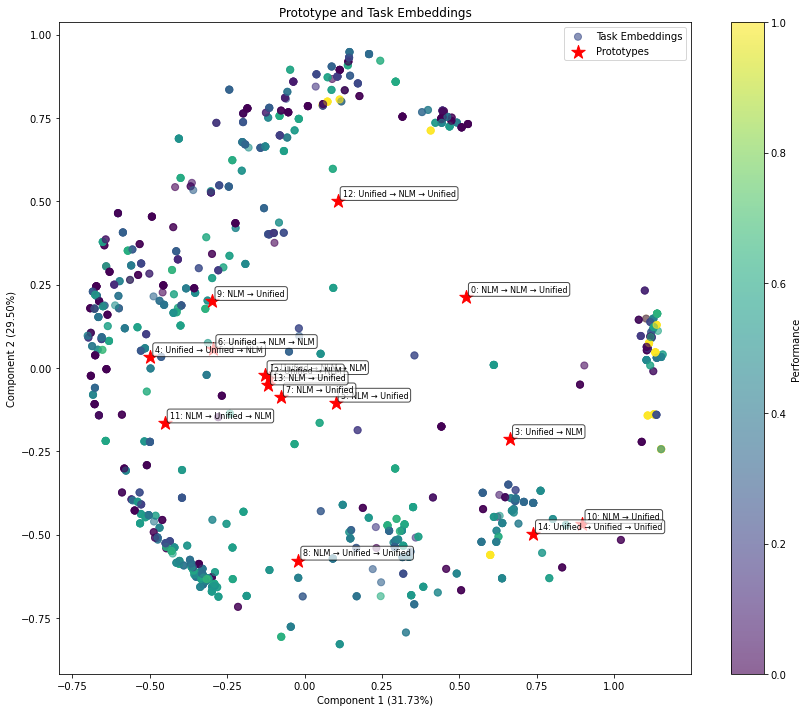

Training MCU:  32%|███▏      | 161/500 [22:54<49:43,  8.80s/it]

Iteration 161/500, Cell Accuracy: 0.3656, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  32%|███▏      | 162/500 [22:58<42:23,  7.53s/it]

Iteration 162/500, Cell Accuracy: 0.4416, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  33%|███▎      | 163/500 [23:02<36:29,  6.50s/it]

Iteration 163/500, Cell Accuracy: 0.4835, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  33%|███▎      | 164/500 [23:06<32:05,  5.73s/it]

Iteration 164/500, Cell Accuracy: 0.5114, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 165/500, Cell Accuracy: 0.3893, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_165.pt


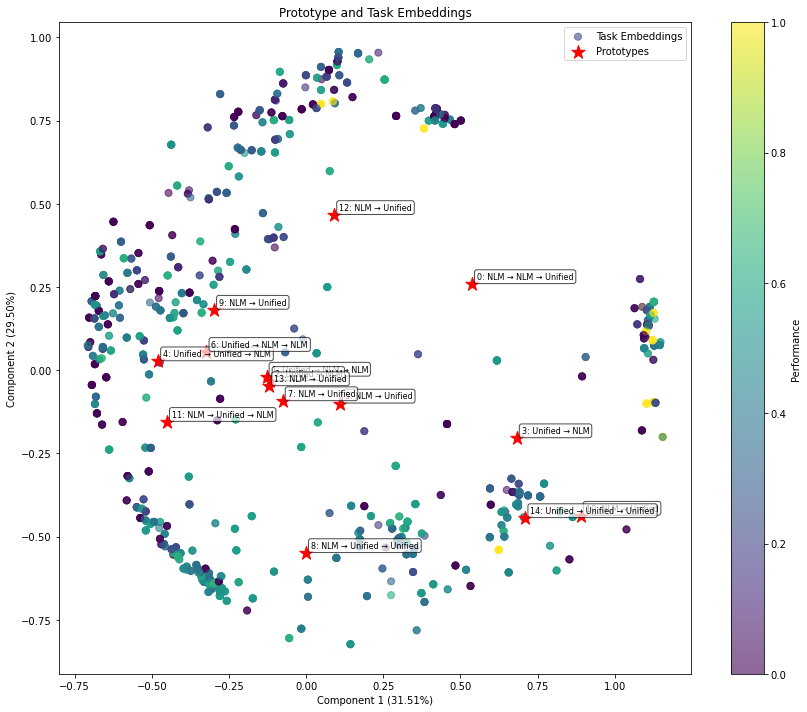

Training MCU:  33%|███▎      | 166/500 [23:22<36:38,  6.58s/it]

Iteration 166/500, Cell Accuracy: 0.5496, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  33%|███▎      | 167/500 [23:26<31:34,  5.69s/it]

Iteration 167/500, Cell Accuracy: 0.3503, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  34%|███▎      | 168/500 [23:31<29:30,  5.33s/it]

Iteration 168/500, Cell Accuracy: 0.4657, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  34%|███▍      | 169/500 [23:36<29:01,  5.26s/it]

Iteration 169/500, Cell Accuracy: 0.4718, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 170/500, Cell Accuracy: 0.5689, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_170.pt


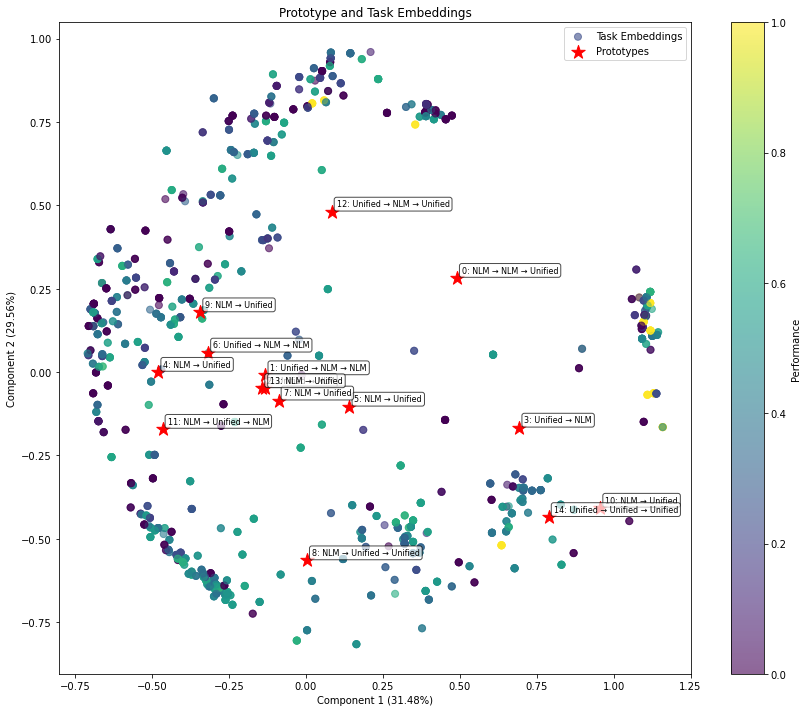

Training MCU:  34%|███▍      | 171/500 [23:49<32:51,  5.99s/it]

Iteration 171/500, Cell Accuracy: 0.4706, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  34%|███▍      | 172/500 [23:56<33:34,  6.14s/it]

Iteration 172/500, Cell Accuracy: 0.5953, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  35%|███▍      | 173/500 [24:01<32:15,  5.92s/it]

Iteration 173/500, Cell Accuracy: 0.5597, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  35%|███▍      | 174/500 [24:13<41:35,  7.65s/it]

Iteration 174/500, Cell Accuracy: 0.4279, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 175/500, Cell Accuracy: 0.3863, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_175.pt


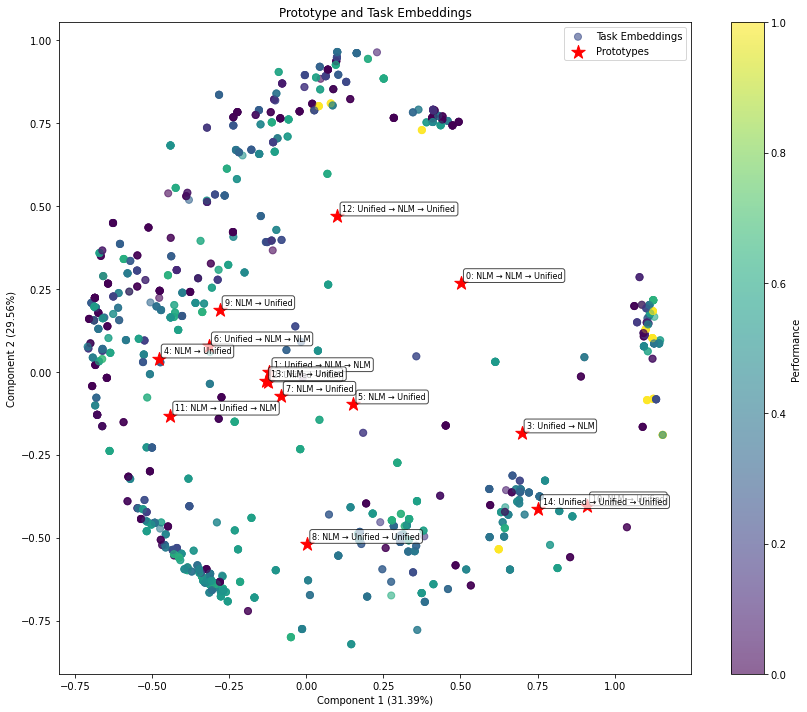

Training MCU:  35%|███▌      | 176/500 [24:36<51:59,  9.63s/it]

Iteration 176/500, Cell Accuracy: 0.5339, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  35%|███▌      | 177/500 [24:44<50:22,  9.36s/it]

Iteration 177/500, Cell Accuracy: 0.4153, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  36%|███▌      | 178/500 [24:50<44:05,  8.22s/it]

Iteration 178/500, Cell Accuracy: 0.4630, Grid Accuracy: 0.0500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  36%|███▌      | 179/500 [25:08<59:12, 11.07s/it]

Iteration 179/500, Cell Accuracy: 0.3483, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 180/500, Cell Accuracy: 0.5507, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_180.pt


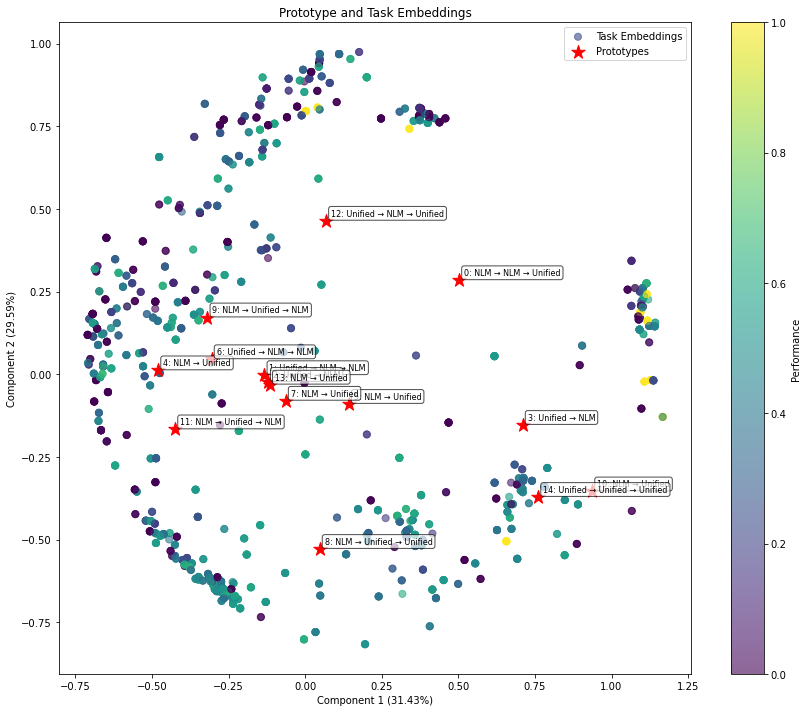

Training MCU:  36%|███▌      | 181/500 [25:24<49:17,  9.27s/it]  

Iteration 181/500, Cell Accuracy: 0.4912, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  36%|███▋      | 182/500 [25:29<42:24,  8.00s/it]

Iteration 182/500, Cell Accuracy: 0.6127, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  37%|███▋      | 183/500 [25:34<37:56,  7.18s/it]

Iteration 183/500, Cell Accuracy: 0.5559, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  37%|███▋      | 184/500 [25:38<32:04,  6.09s/it]

Iteration 184/500, Cell Accuracy: 0.4172, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 185/500, Cell Accuracy: 0.4061, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_185.pt


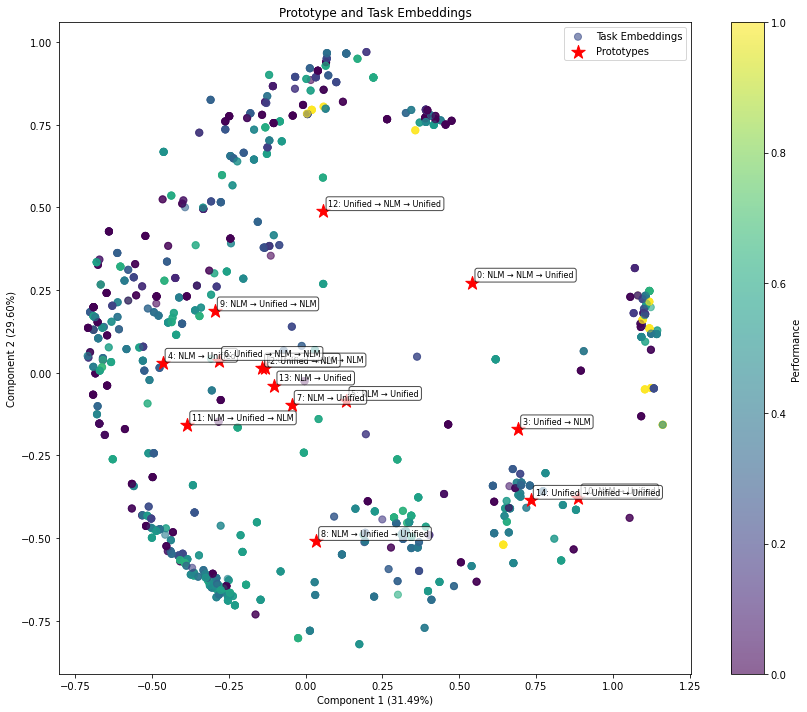

Training MCU:  37%|███▋      | 186/500 [25:55<38:03,  7.27s/it]

Iteration 186/500, Cell Accuracy: 0.6326, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  37%|███▋      | 187/500 [26:03<39:06,  7.50s/it]

Iteration 187/500, Cell Accuracy: 0.4988, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  38%|███▊      | 188/500 [26:07<34:32,  6.64s/it]

Iteration 188/500, Cell Accuracy: 0.5922, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  38%|███▊      | 189/500 [26:16<38:00,  7.33s/it]

Iteration 189/500, Cell Accuracy: 0.4961, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 190/500, Cell Accuracy: 0.4687, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_190.pt


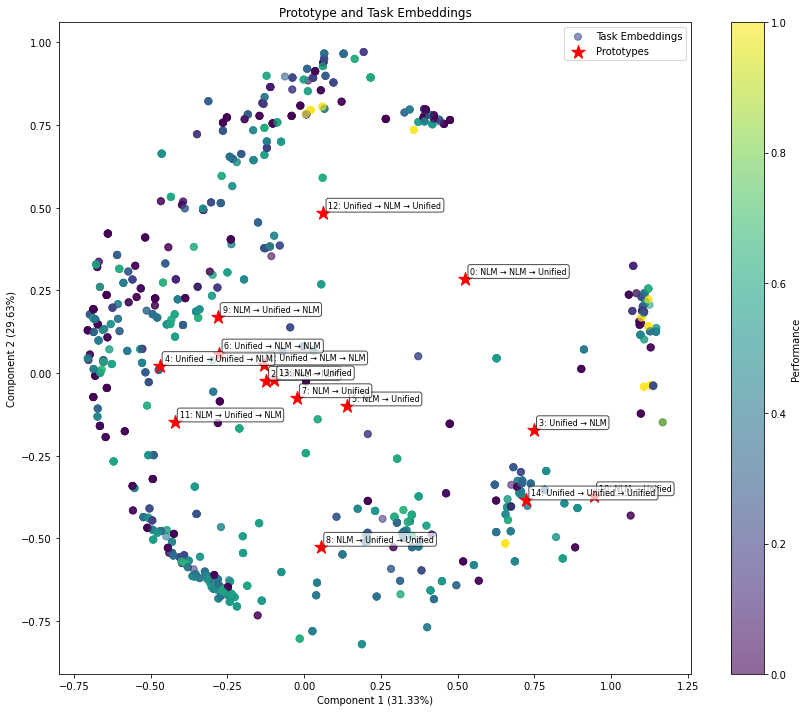

Training MCU:  38%|███▊      | 191/500 [26:34<40:08,  7.79s/it]

Iteration 191/500, Cell Accuracy: 0.3410, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  38%|███▊      | 192/500 [26:38<34:14,  6.67s/it]

Iteration 192/500, Cell Accuracy: 0.6334, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 12


Training MCU:  39%|███▊      | 193/500 [26:45<33:27,  6.54s/it]

Iteration 193/500, Cell Accuracy: 0.4181, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  39%|███▉      | 194/500 [26:49<30:43,  6.02s/it]

Iteration 194/500, Cell Accuracy: 0.5498, Grid Accuracy: 0.0500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 195/500, Cell Accuracy: 0.5760, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_195.pt


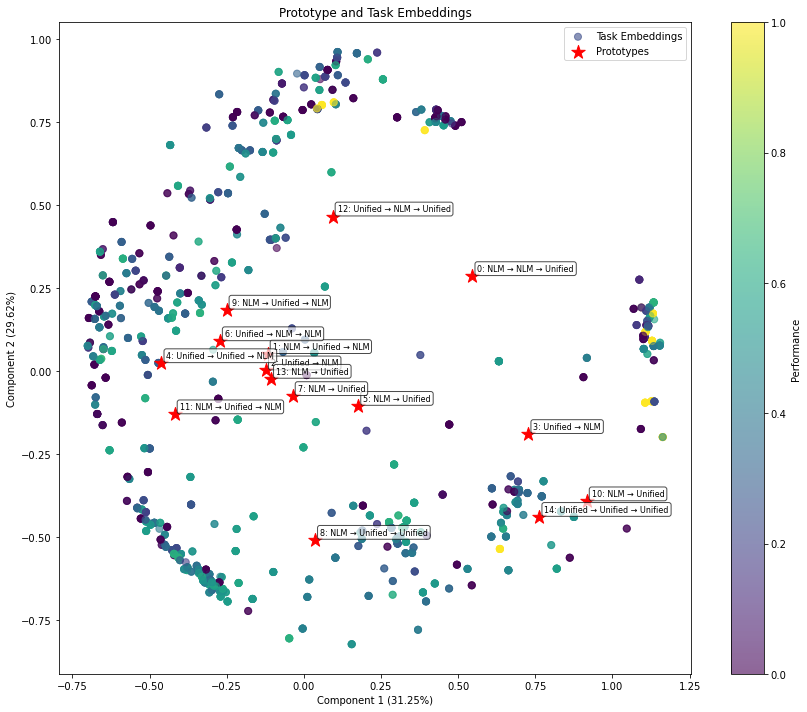

Training MCU:  39%|███▉      | 196/500 [27:03<32:39,  6.44s/it]

Iteration 196/500, Cell Accuracy: 0.4510, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  39%|███▉      | 197/500 [27:11<33:42,  6.67s/it]

Iteration 197/500, Cell Accuracy: 0.4248, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  40%|███▉      | 198/500 [27:14<29:10,  5.80s/it]

Iteration 198/500, Cell Accuracy: 0.6710, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  40%|███▉      | 199/500 [27:19<26:51,  5.35s/it]

Iteration 199/500, Cell Accuracy: 0.3710, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 10
Iteration 200/500, Cell Accuracy: 0.5618, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 12
Model saved to output/models/mcu/proto_mcu_iter_200.pt


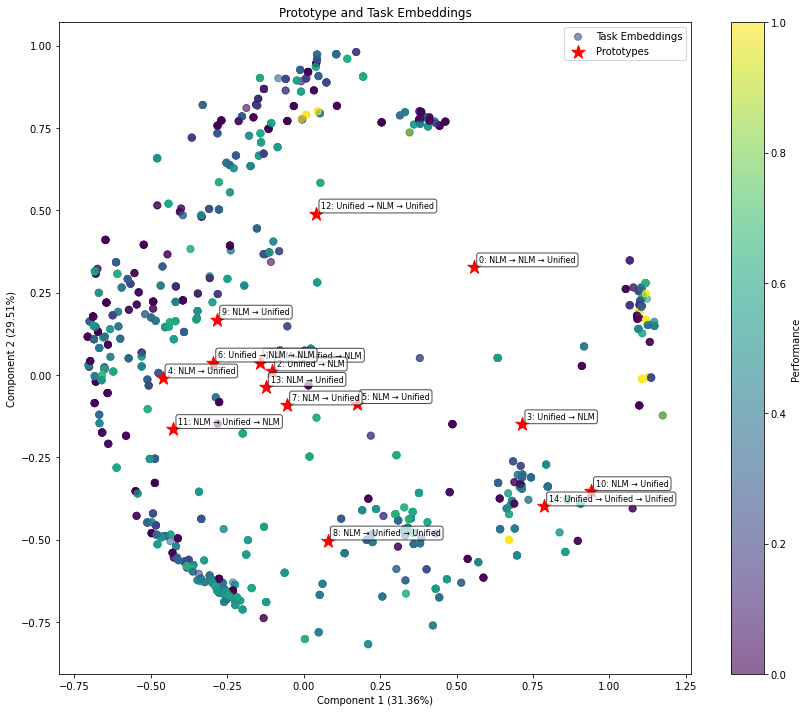

Training MCU:  40%|████      | 201/500 [27:35<32:30,  6.52s/it]

Iteration 201/500, Cell Accuracy: 0.4071, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  40%|████      | 202/500 [27:40<31:00,  6.24s/it]

Iteration 202/500, Cell Accuracy: 0.5831, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  41%|████      | 203/500 [27:56<44:24,  8.97s/it]

Iteration 203/500, Cell Accuracy: 0.4229, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  41%|████      | 204/500 [28:06<45:30,  9.23s/it]

Iteration 204/500, Cell Accuracy: 0.5390, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 13
Iteration 205/500, Cell Accuracy: 0.2193, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_205.pt


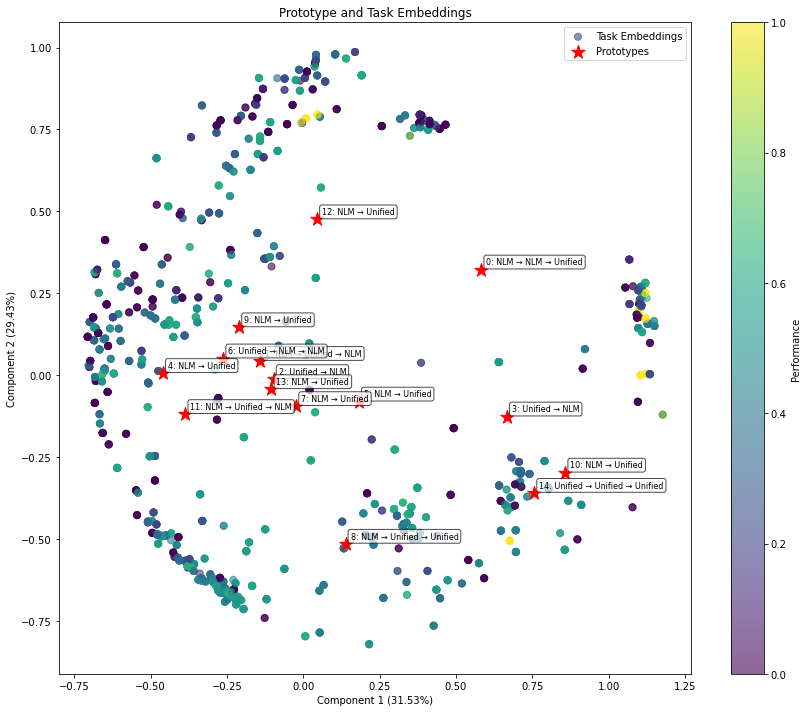

Training MCU:  41%|████      | 206/500 [28:24<43:36,  8.90s/it]

Iteration 206/500, Cell Accuracy: 0.6479, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  41%|████▏     | 207/500 [28:31<39:57,  8.18s/it]

Iteration 207/500, Cell Accuracy: 0.4239, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  42%|████▏     | 208/500 [28:36<34:44,  7.14s/it]

Iteration 208/500, Cell Accuracy: 0.4980, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  42%|████▏     | 209/500 [28:42<33:06,  6.83s/it]

Iteration 209/500, Cell Accuracy: 0.4298, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 10
Iteration 210/500, Cell Accuracy: 0.5542, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_210.pt


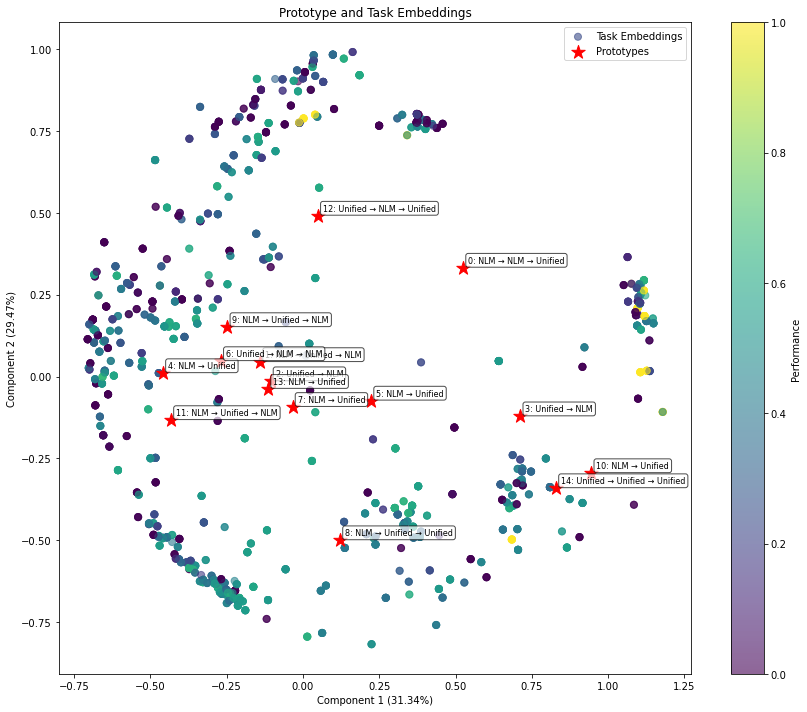

Training MCU:  42%|████▏     | 211/500 [29:02<40:43,  8.46s/it]

Iteration 211/500, Cell Accuracy: 0.4414, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  42%|████▏     | 212/500 [29:06<34:27,  7.18s/it]

Iteration 212/500, Cell Accuracy: 0.3530, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  43%|████▎     | 213/500 [29:12<32:42,  6.84s/it]

Iteration 213/500, Cell Accuracy: 0.5701, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  43%|████▎     | 214/500 [29:21<35:09,  7.37s/it]

Iteration 214/500, Cell Accuracy: 0.4647, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 215/500, Cell Accuracy: 0.5909, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_215.pt


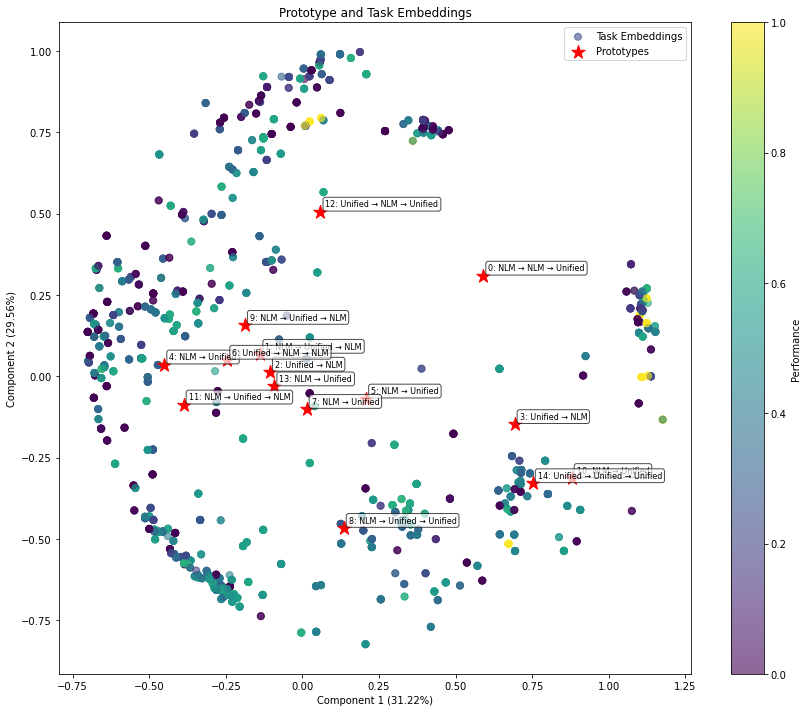

Training MCU:  43%|████▎     | 216/500 [29:34<32:11,  6.80s/it]

Iteration 216/500, Cell Accuracy: 0.3782, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  43%|████▎     | 217/500 [29:37<27:35,  5.85s/it]

Iteration 217/500, Cell Accuracy: 0.4550, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  44%|████▎     | 218/500 [29:47<32:50,  6.99s/it]

Iteration 218/500, Cell Accuracy: 0.5497, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  44%|████▍     | 219/500 [29:52<30:19,  6.47s/it]

Iteration 219/500, Cell Accuracy: 0.3346, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 220/500, Cell Accuracy: 0.5901, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 12
Model saved to output/models/mcu/proto_mcu_iter_220.pt


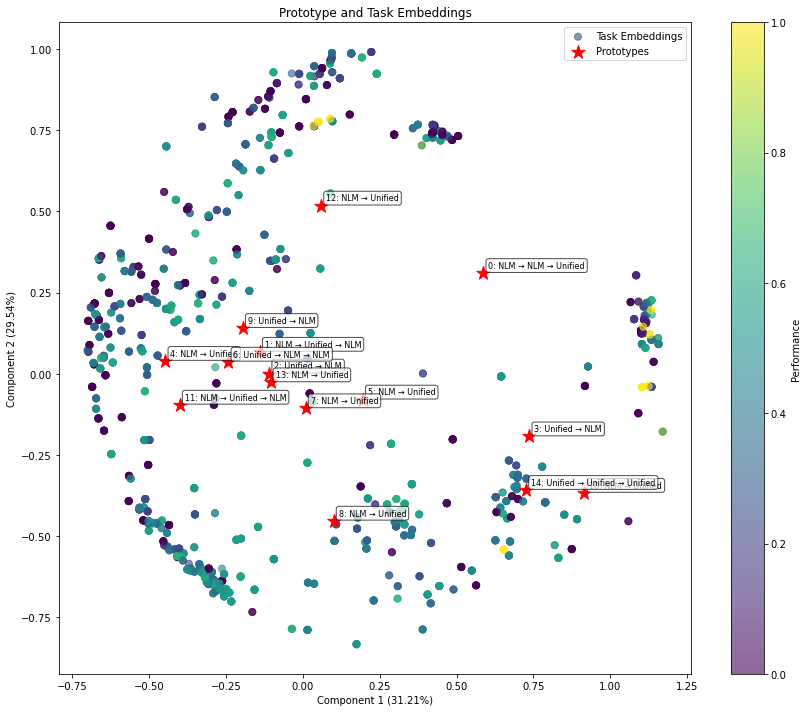

Training MCU:  44%|████▍     | 221/500 [30:25<54:06, 11.63s/it]

Iteration 221/500, Cell Accuracy: 0.4718, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  44%|████▍     | 222/500 [30:31<46:22, 10.01s/it]

Iteration 222/500, Cell Accuracy: 0.6374, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  45%|████▍     | 223/500 [30:35<37:53,  8.21s/it]

Iteration 223/500, Cell Accuracy: 0.3816, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  45%|████▍     | 224/500 [30:40<33:31,  7.29s/it]

Iteration 224/500, Cell Accuracy: 0.5392, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 225/500, Cell Accuracy: 0.3783, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_225.pt


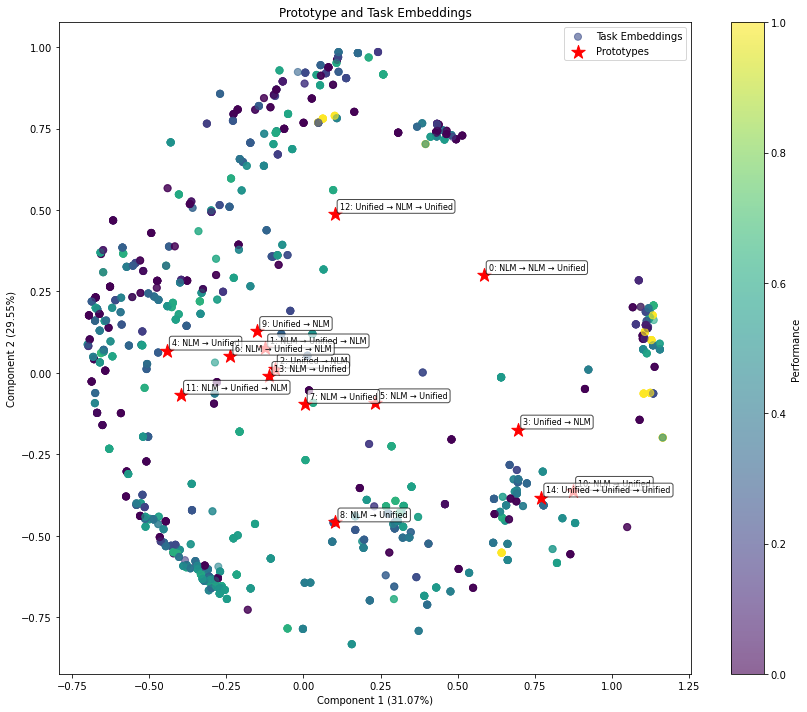

Training MCU:  45%|████▌     | 226/500 [30:57<35:21,  7.74s/it]

Iteration 226/500, Cell Accuracy: 0.5733, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  45%|████▌     | 227/500 [31:02<30:39,  6.74s/it]

Iteration 227/500, Cell Accuracy: 0.4889, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  46%|████▌     | 228/500 [31:07<27:40,  6.10s/it]

Iteration 228/500, Cell Accuracy: 0.4259, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  46%|████▌     | 229/500 [31:13<28:16,  6.26s/it]

Iteration 229/500, Cell Accuracy: 0.3293, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 230/500, Cell Accuracy: 0.4104, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_230.pt


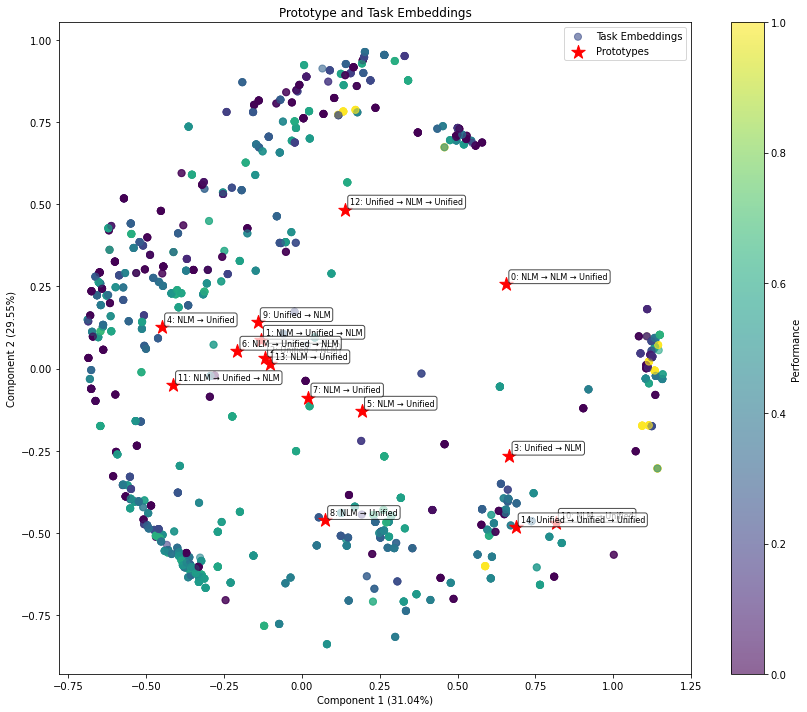

Training MCU:  46%|████▌     | 231/500 [31:25<26:43,  5.96s/it]

Iteration 231/500, Cell Accuracy: 0.7356, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  46%|████▋     | 232/500 [31:32<27:48,  6.23s/it]

Iteration 232/500, Cell Accuracy: 0.5659, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 10


Training MCU:  47%|████▋     | 233/500 [31:39<28:46,  6.47s/it]

Iteration 233/500, Cell Accuracy: 0.2030, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  47%|████▋     | 234/500 [31:47<30:30,  6.88s/it]

Iteration 234/500, Cell Accuracy: 0.3542, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 235/500, Cell Accuracy: 0.5768, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_235.pt


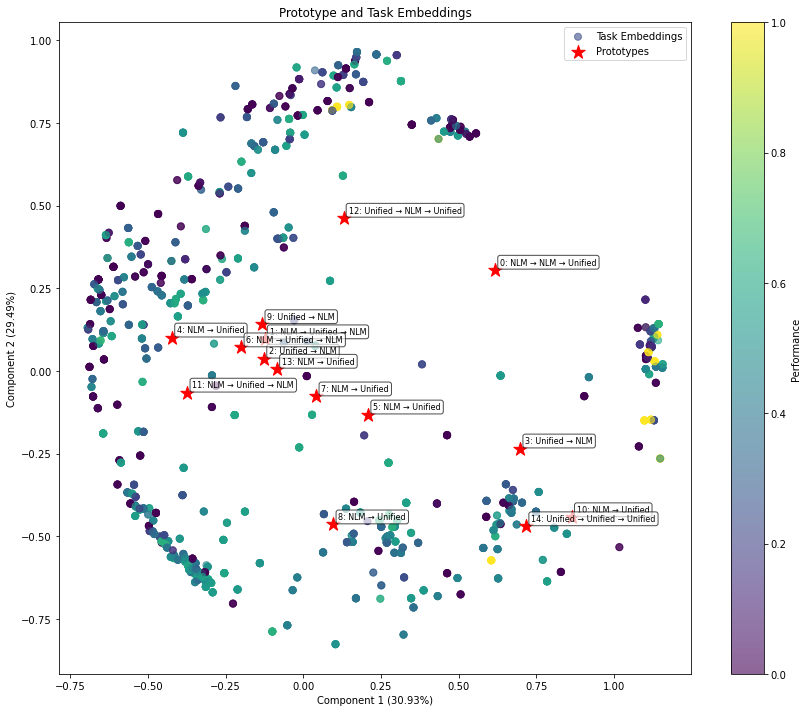

Training MCU:  47%|████▋     | 236/500 [32:13<44:54, 10.21s/it]

Iteration 236/500, Cell Accuracy: 0.3498, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  47%|████▋     | 237/500 [32:20<40:22,  9.21s/it]

Iteration 237/500, Cell Accuracy: 0.4611, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  48%|████▊     | 238/500 [32:30<41:02,  9.40s/it]

Iteration 238/500, Cell Accuracy: 0.4670, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  48%|████▊     | 239/500 [32:37<38:37,  8.88s/it]

Iteration 239/500, Cell Accuracy: 0.4304, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 240/500, Cell Accuracy: 0.5683, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_240.pt


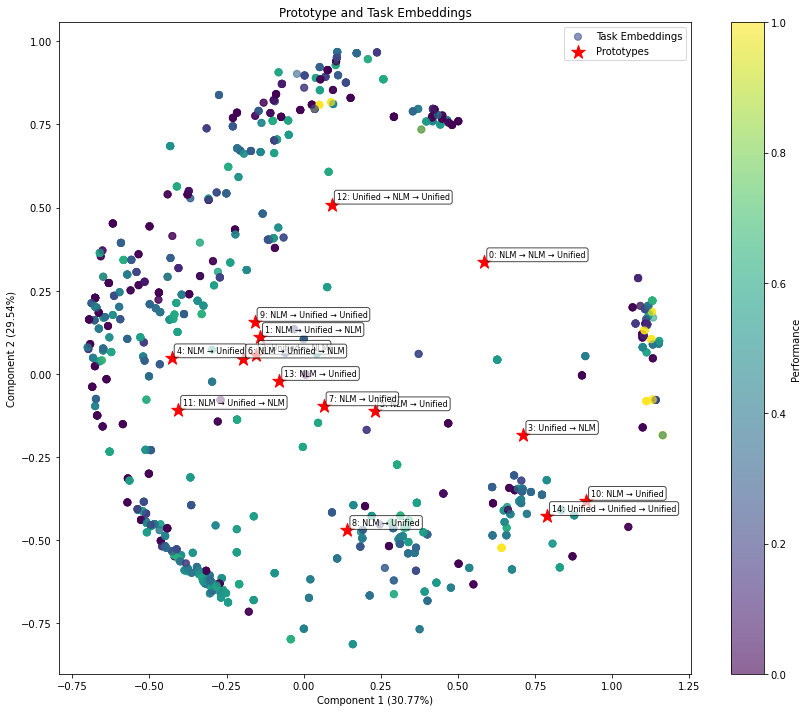

Training MCU:  48%|████▊     | 241/500 [32:59<42:41,  9.89s/it]

Iteration 241/500, Cell Accuracy: 0.3192, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  48%|████▊     | 242/500 [33:05<37:23,  8.70s/it]

Iteration 242/500, Cell Accuracy: 0.4679, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  49%|████▊     | 243/500 [33:21<46:42, 10.90s/it]

Iteration 243/500, Cell Accuracy: 0.5569, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  49%|████▉     | 244/500 [33:31<44:57, 10.54s/it]

Iteration 244/500, Cell Accuracy: 0.4762, Grid Accuracy: 0.1500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 245/500, Cell Accuracy: 0.4421, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_245.pt


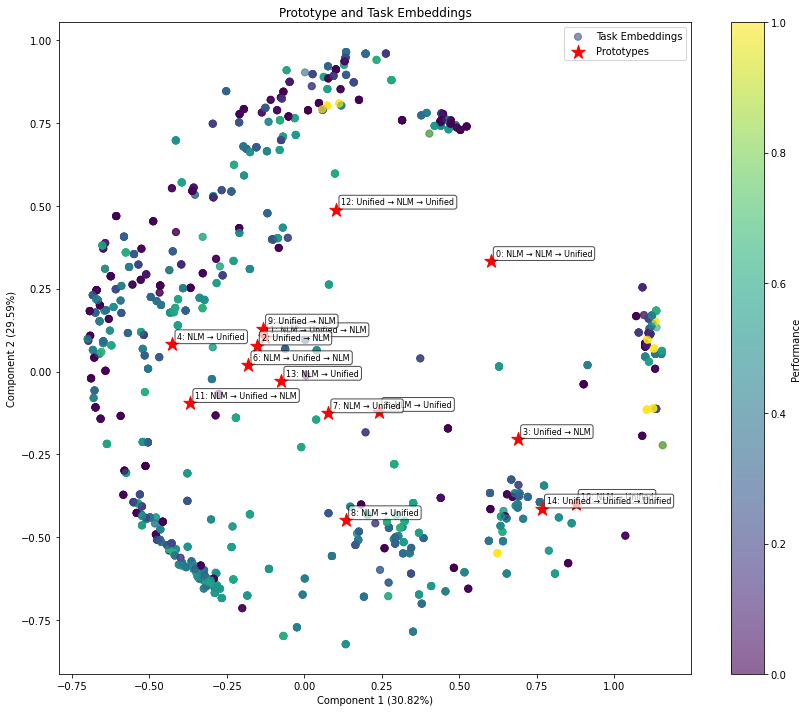

Training MCU:  49%|████▉     | 246/500 [33:54<48:12, 11.39s/it]

Iteration 246/500, Cell Accuracy: 0.5355, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  49%|████▉     | 247/500 [33:59<39:50,  9.45s/it]

Iteration 247/500, Cell Accuracy: 0.5416, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  50%|████▉     | 248/500 [34:05<35:41,  8.50s/it]

Iteration 248/500, Cell Accuracy: 0.5712, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  50%|████▉     | 249/500 [34:11<32:18,  7.72s/it]

Iteration 249/500, Cell Accuracy: 0.5086, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Iteration 250/500, Cell Accuracy: 0.5090, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_250.pt


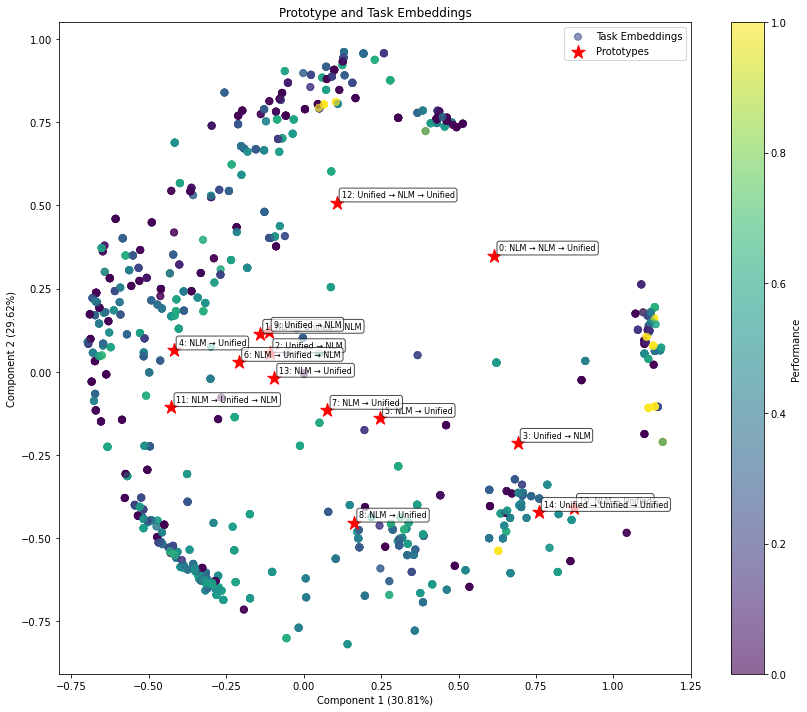

Training MCU:  50%|█████     | 251/500 [34:32<36:48,  8.87s/it]

Iteration 251/500, Cell Accuracy: 0.5024, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  50%|█████     | 252/500 [34:36<30:53,  7.47s/it]

Iteration 252/500, Cell Accuracy: 0.4993, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  51%|█████     | 253/500 [34:42<28:53,  7.02s/it]

Iteration 253/500, Cell Accuracy: 0.4261, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  51%|█████     | 254/500 [34:52<31:23,  7.66s/it]

Iteration 254/500, Cell Accuracy: 0.4531, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 255/500, Cell Accuracy: 0.3390, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_255.pt


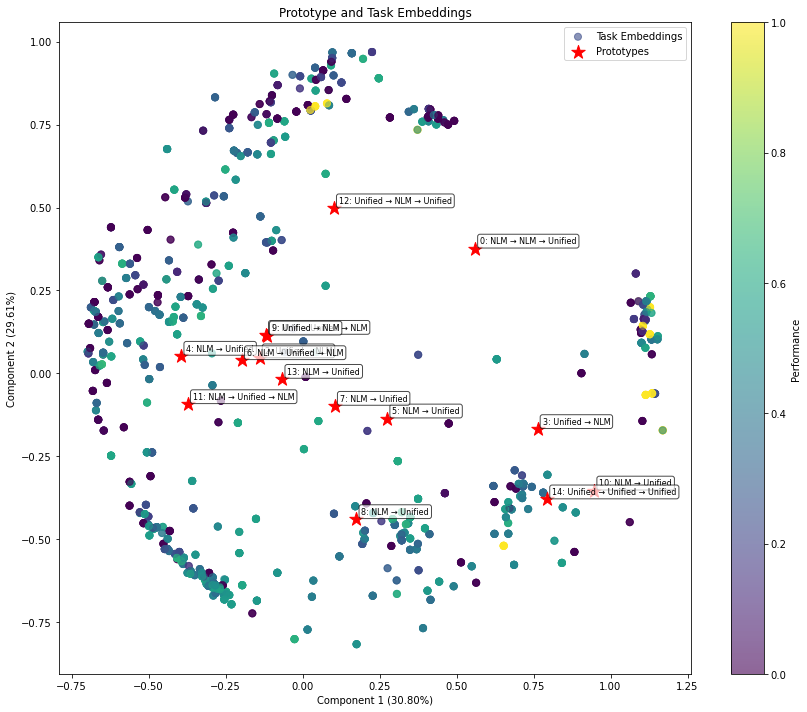

Training MCU:  51%|█████     | 256/500 [35:14<37:15,  9.16s/it]

Iteration 256/500, Cell Accuracy: 0.3615, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  51%|█████▏    | 257/500 [35:22<35:44,  8.82s/it]

Iteration 257/500, Cell Accuracy: 0.5124, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  52%|█████▏    | 258/500 [35:26<30:20,  7.52s/it]

Iteration 258/500, Cell Accuracy: 0.4085, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  52%|█████▏    | 259/500 [35:33<29:11,  7.27s/it]

Iteration 259/500, Cell Accuracy: 0.6125, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 260/500, Cell Accuracy: 0.5708, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_260.pt


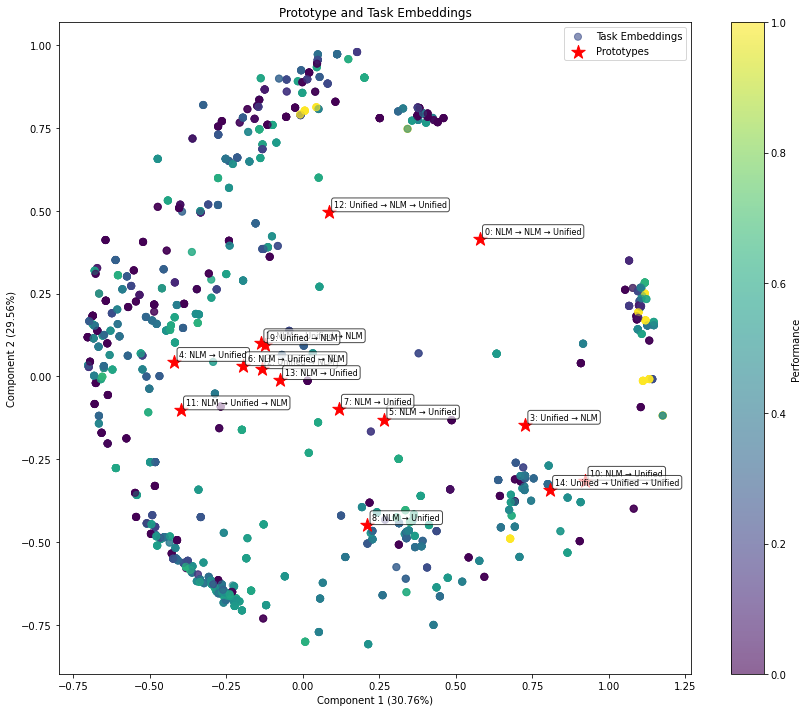

Training MCU:  52%|█████▏    | 261/500 [35:53<33:35,  8.43s/it]

Iteration 261/500, Cell Accuracy: 0.4128, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  52%|█████▏    | 262/500 [36:03<35:15,  8.89s/it]

Iteration 262/500, Cell Accuracy: 0.5743, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  53%|█████▎    | 263/500 [36:08<30:29,  7.72s/it]

Iteration 263/500, Cell Accuracy: 0.4593, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  53%|█████▎    | 264/500 [36:14<27:57,  7.11s/it]

Iteration 264/500, Cell Accuracy: 0.5449, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 265/500, Cell Accuracy: 0.4033, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_265.pt


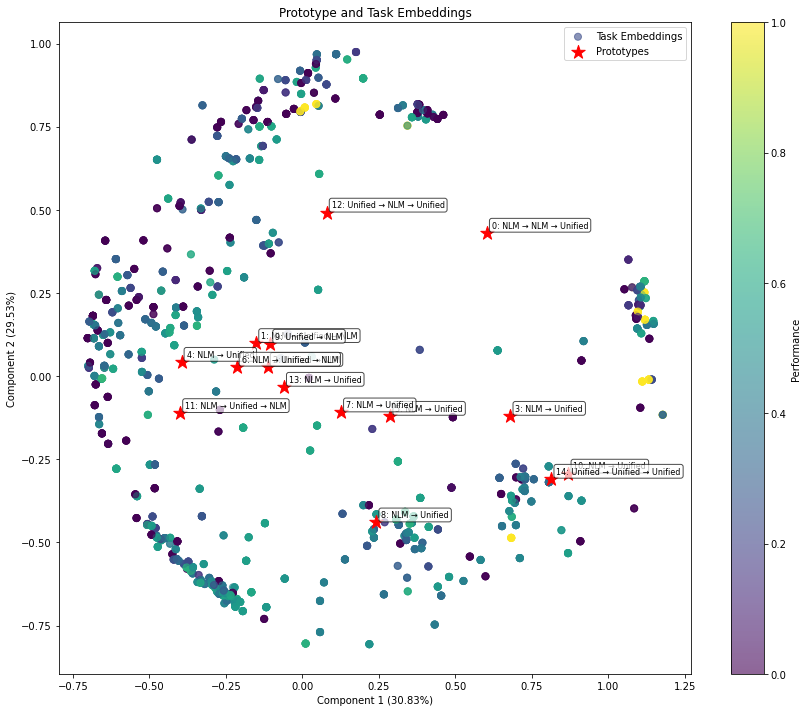

Training MCU:  53%|█████▎    | 266/500 [36:34<32:44,  8.40s/it]

Iteration 266/500, Cell Accuracy: 0.2975, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  53%|█████▎    | 267/500 [36:38<27:50,  7.17s/it]

Iteration 267/500, Cell Accuracy: 0.5379, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  54%|█████▎    | 268/500 [36:44<25:31,  6.60s/it]

Iteration 268/500, Cell Accuracy: 0.3468, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  54%|█████▍    | 269/500 [36:57<32:58,  8.57s/it]

Iteration 269/500, Cell Accuracy: 0.4402, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 270/500, Cell Accuracy: 0.4734, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_270.pt


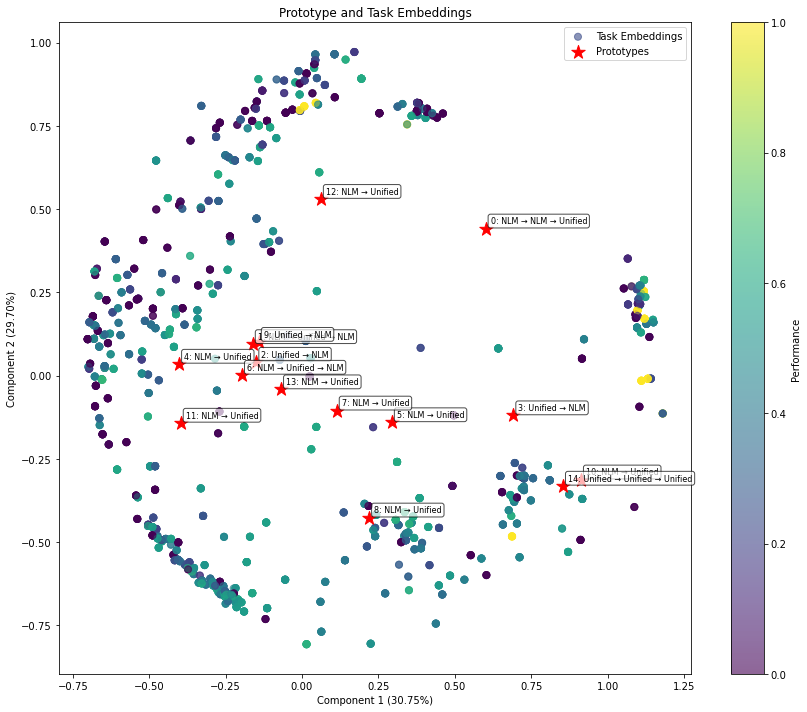

Training MCU:  54%|█████▍    | 271/500 [37:14<32:19,  8.47s/it]

Iteration 271/500, Cell Accuracy: 0.5733, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  54%|█████▍    | 272/500 [37:20<28:55,  7.61s/it]

Iteration 272/500, Cell Accuracy: 0.4162, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  55%|█████▍    | 273/500 [37:24<25:14,  6.67s/it]

Iteration 273/500, Cell Accuracy: 0.4012, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  55%|█████▍    | 274/500 [37:33<26:43,  7.10s/it]

Iteration 274/500, Cell Accuracy: 0.2896, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 275/500, Cell Accuracy: 0.5368, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_275.pt


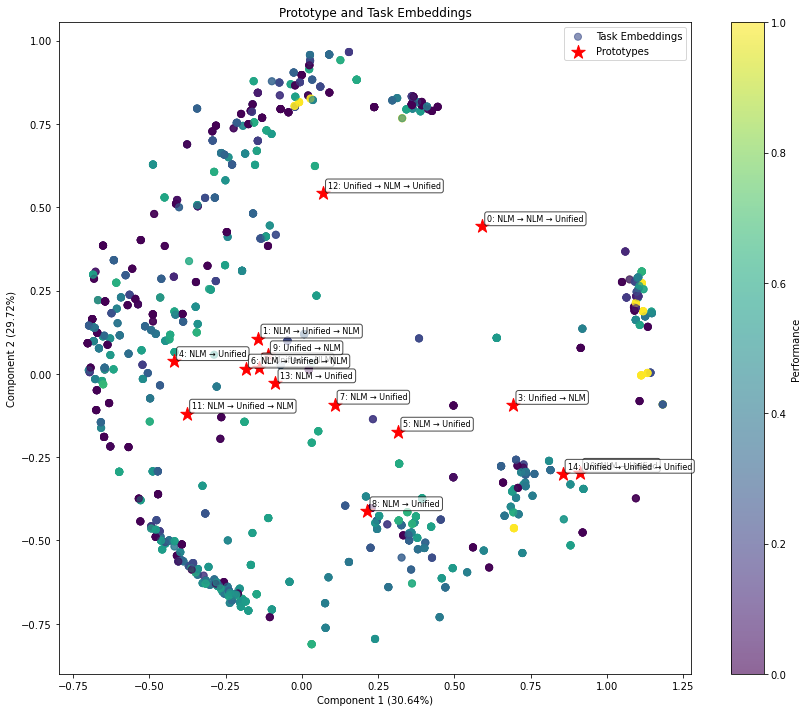

Training MCU:  55%|█████▌    | 276/500 [37:47<25:48,  6.91s/it]

Iteration 276/500, Cell Accuracy: 0.5010, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  55%|█████▌    | 277/500 [37:53<24:23,  6.56s/it]

Iteration 277/500, Cell Accuracy: 0.4564, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  56%|█████▌    | 278/500 [38:00<25:07,  6.79s/it]

Iteration 278/500, Cell Accuracy: 0.4892, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  56%|█████▌    | 279/500 [38:11<30:04,  8.17s/it]

Iteration 279/500, Cell Accuracy: 0.5122, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 280/500, Cell Accuracy: 0.5872, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_280.pt


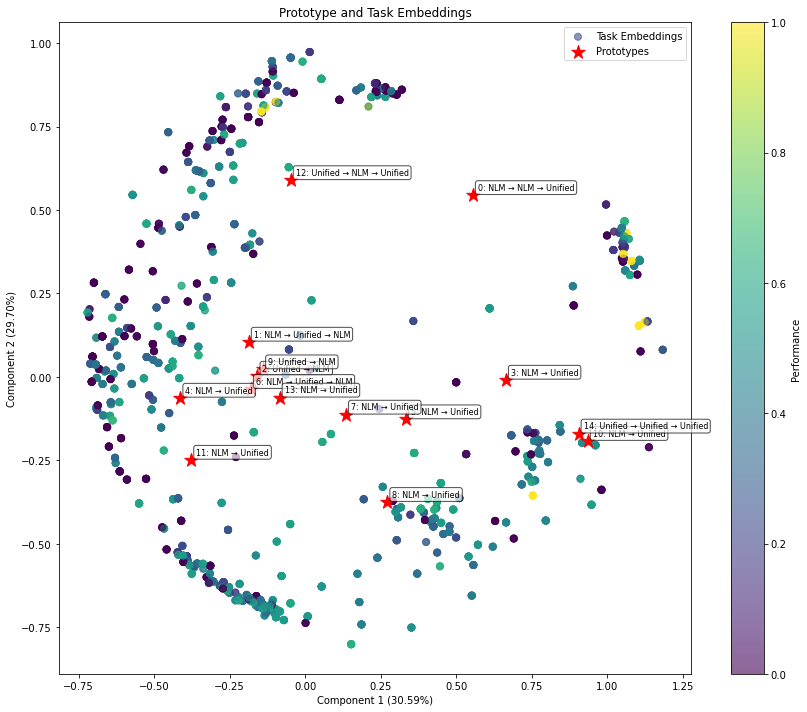

Training MCU:  56%|█████▌    | 281/500 [38:30<30:28,  8.35s/it]

Iteration 281/500, Cell Accuracy: 0.5204, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  56%|█████▋    | 282/500 [38:34<25:51,  7.12s/it]

Iteration 282/500, Cell Accuracy: 0.5274, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  57%|█████▋    | 283/500 [38:40<24:14,  6.70s/it]

Iteration 283/500, Cell Accuracy: 0.5175, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  57%|█████▋    | 284/500 [38:51<28:16,  7.85s/it]

Iteration 284/500, Cell Accuracy: 0.4329, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 285/500, Cell Accuracy: 0.3542, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_285.pt


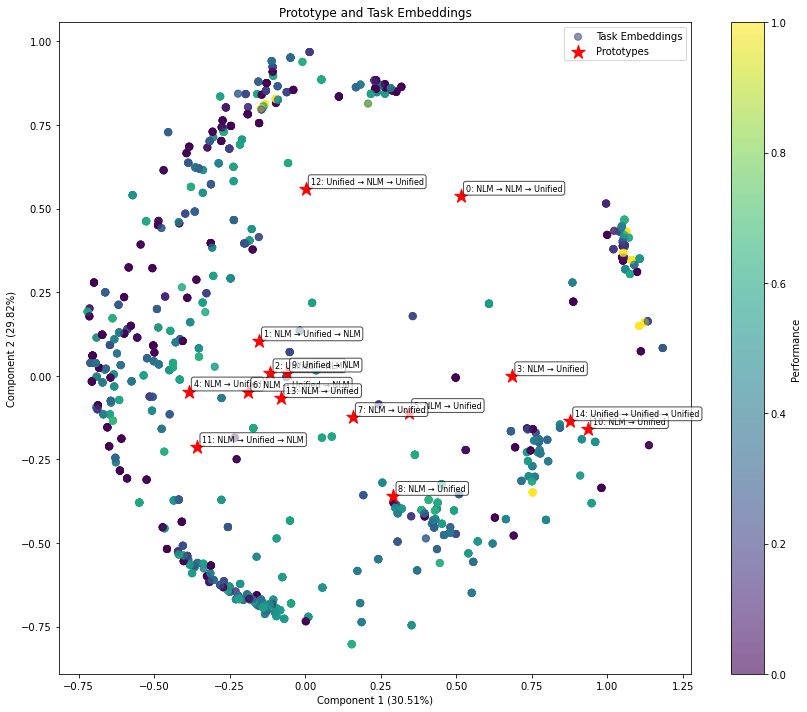

Training MCU:  57%|█████▋    | 286/500 [39:09<29:17,  8.21s/it]

Iteration 286/500, Cell Accuracy: 0.5932, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  57%|█████▋    | 287/500 [39:16<27:51,  7.85s/it]

Iteration 287/500, Cell Accuracy: 0.4015, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  58%|█████▊    | 288/500 [39:24<27:14,  7.71s/it]

Iteration 288/500, Cell Accuracy: 0.4924, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  58%|█████▊    | 289/500 [39:37<32:41,  9.29s/it]

Iteration 289/500, Cell Accuracy: 0.5045, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 290/500, Cell Accuracy: 0.5422, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_290.pt


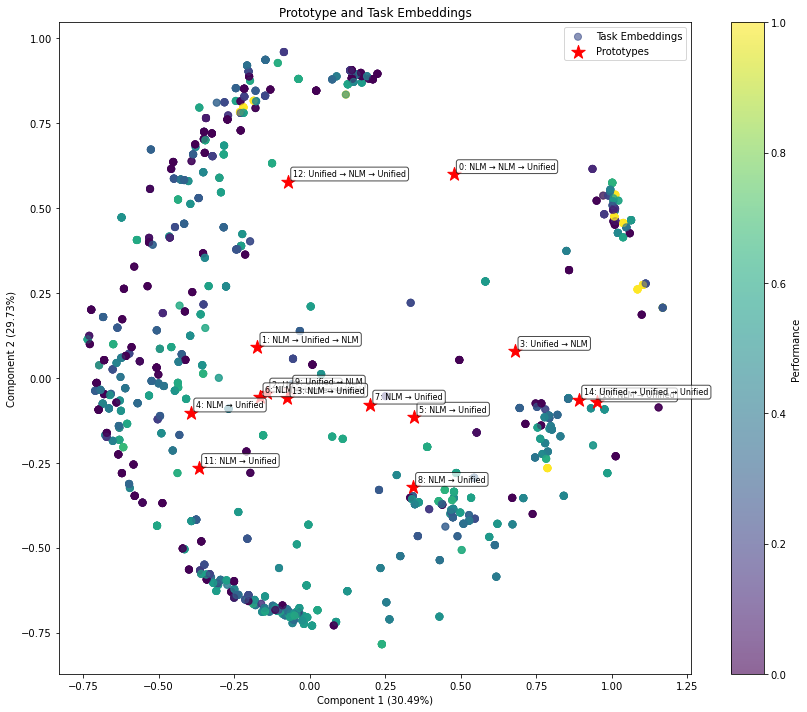

Training MCU:  58%|█████▊    | 291/500 [39:53<29:52,  8.58s/it]

Iteration 291/500, Cell Accuracy: 0.6517, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  58%|█████▊    | 292/500 [40:03<31:01,  8.95s/it]

Iteration 292/500, Cell Accuracy: 0.3621, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  59%|█████▊    | 293/500 [40:10<28:42,  8.32s/it]

Iteration 293/500, Cell Accuracy: 0.5695, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  59%|█████▉    | 294/500 [40:18<27:55,  8.14s/it]

Iteration 294/500, Cell Accuracy: 0.4081, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 295/500, Cell Accuracy: 0.4486, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_295.pt


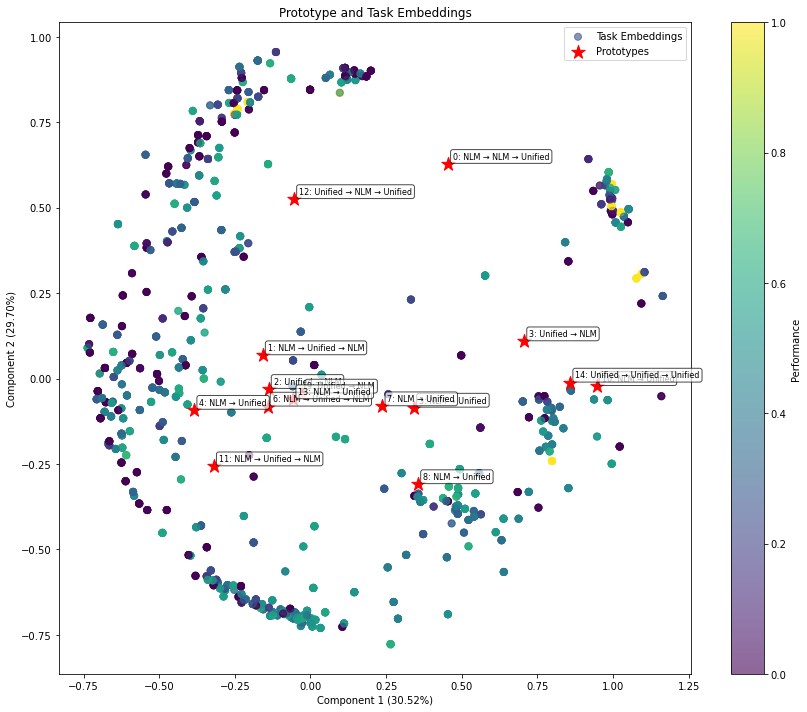

Training MCU:  59%|█████▉    | 296/500 [40:36<29:11,  8.58s/it]

Iteration 296/500, Cell Accuracy: 0.4239, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  59%|█████▉    | 297/500 [40:46<30:18,  8.96s/it]

Iteration 297/500, Cell Accuracy: 0.5714, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  60%|█████▉    | 298/500 [40:52<27:16,  8.10s/it]

Iteration 298/500, Cell Accuracy: 0.5729, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  60%|█████▉    | 299/500 [41:00<27:02,  8.07s/it]

Iteration 299/500, Cell Accuracy: 0.3182, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 300/500, Cell Accuracy: 0.2964, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_300.pt


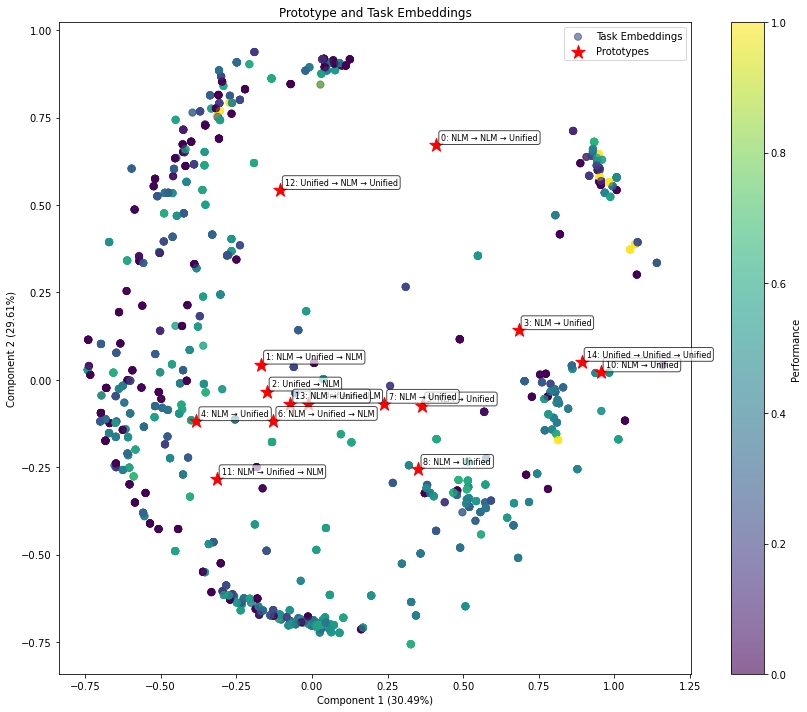

Training MCU:  60%|██████    | 301/500 [41:16<26:04,  7.86s/it]

Iteration 301/500, Cell Accuracy: 0.5458, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  60%|██████    | 302/500 [41:27<28:43,  8.70s/it]

Iteration 302/500, Cell Accuracy: 0.3911, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  61%|██████    | 303/500 [41:40<33:01, 10.06s/it]

Iteration 303/500, Cell Accuracy: 0.4463, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  61%|██████    | 304/500 [41:45<27:37,  8.46s/it]

Iteration 304/500, Cell Accuracy: 0.6149, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 305/500, Cell Accuracy: 0.3416, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_305.pt


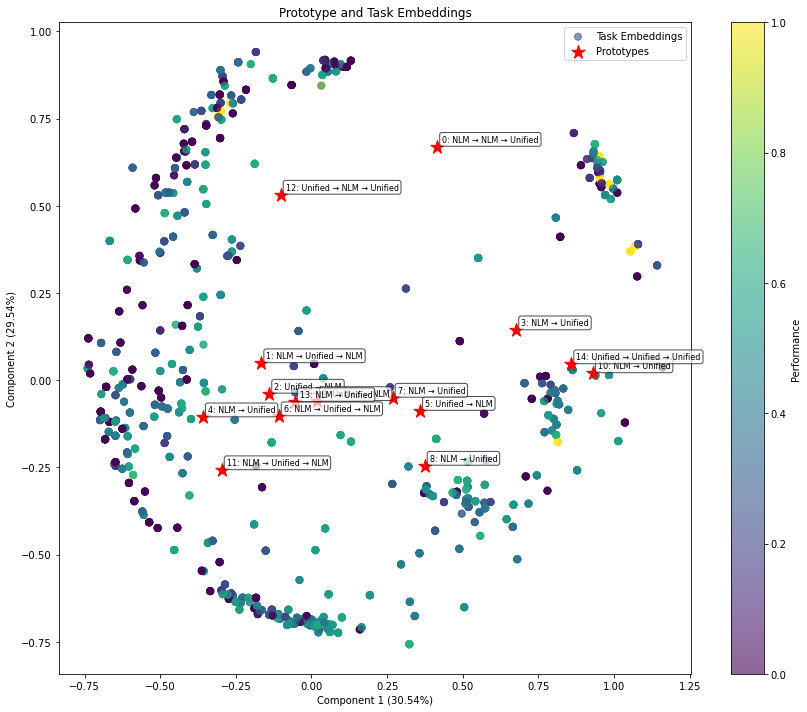

Training MCU:  61%|██████    | 306/500 [42:03<27:08,  8.40s/it]

Iteration 306/500, Cell Accuracy: 0.5733, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  61%|██████▏   | 307/500 [42:12<27:20,  8.50s/it]

Iteration 307/500, Cell Accuracy: 0.5477, Grid Accuracy: 0.0500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  62%|██████▏   | 308/500 [42:17<23:55,  7.48s/it]

Iteration 308/500, Cell Accuracy: 0.6309, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  62%|██████▏   | 309/500 [42:25<25:01,  7.86s/it]

Iteration 309/500, Cell Accuracy: 0.4503, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 310/500, Cell Accuracy: 0.5193, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_310.pt


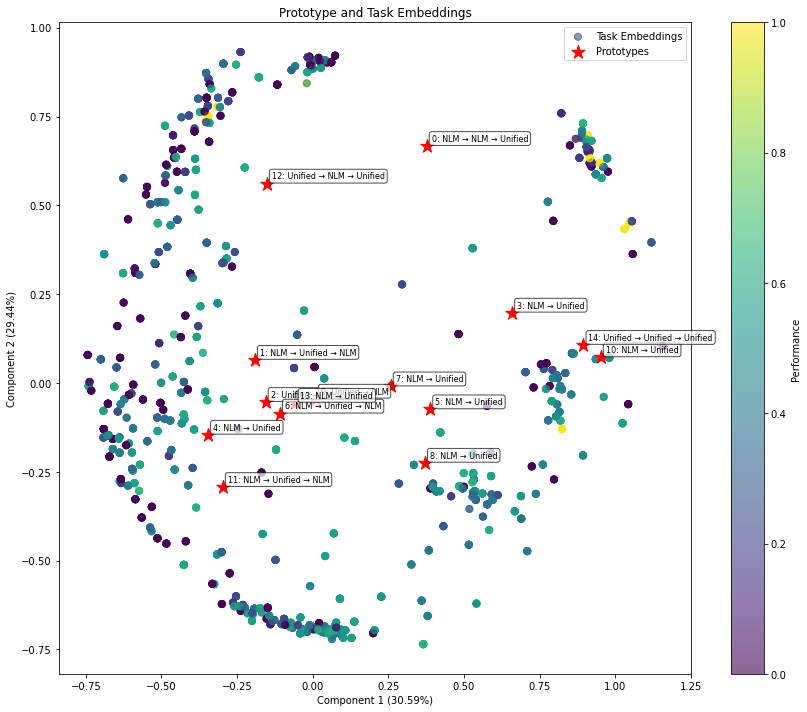

Training MCU:  62%|██████▏   | 311/500 [42:48<28:58,  9.20s/it]

Iteration 311/500, Cell Accuracy: 0.5441, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  62%|██████▏   | 312/500 [42:57<28:08,  8.98s/it]

Iteration 312/500, Cell Accuracy: 0.5825, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  63%|██████▎   | 313/500 [43:02<24:34,  7.89s/it]

Iteration 313/500, Cell Accuracy: 0.6239, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  63%|██████▎   | 314/500 [43:07<21:28,  6.93s/it]

Iteration 314/500, Cell Accuracy: 0.4696, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 315/500, Cell Accuracy: 0.5120, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 11, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_315.pt


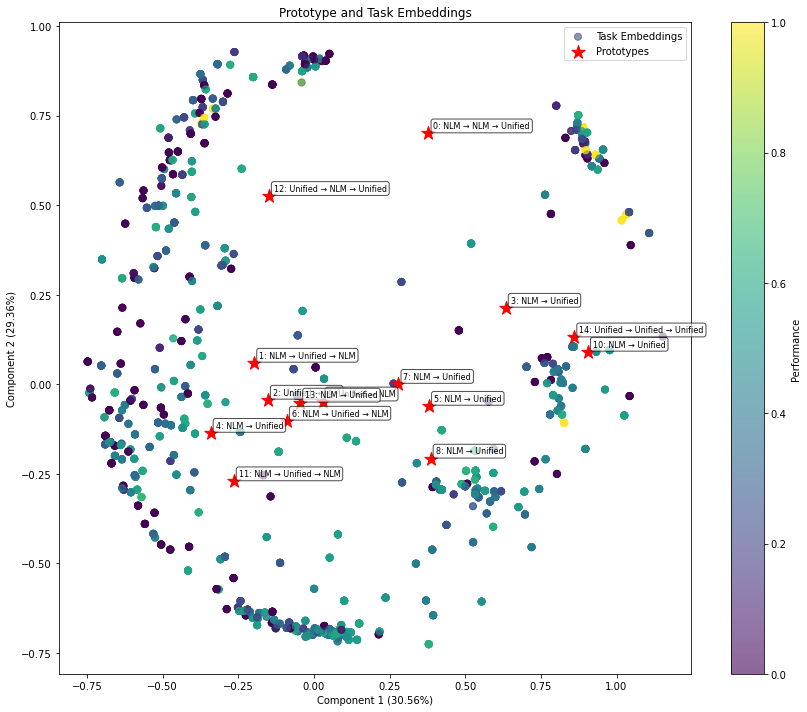

Training MCU:  63%|██████▎   | 316/500 [43:23<22:55,  7.48s/it]

Iteration 316/500, Cell Accuracy: 0.4447, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  63%|██████▎   | 317/500 [43:29<20:33,  6.74s/it]

Iteration 317/500, Cell Accuracy: 0.4786, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  64%|██████▎   | 318/500 [43:35<19:55,  6.57s/it]

Iteration 318/500, Cell Accuracy: 0.4807, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  64%|██████▍   | 319/500 [43:41<19:40,  6.52s/it]

Iteration 319/500, Cell Accuracy: 0.6537, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 320/500, Cell Accuracy: 0.4416, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_320.pt


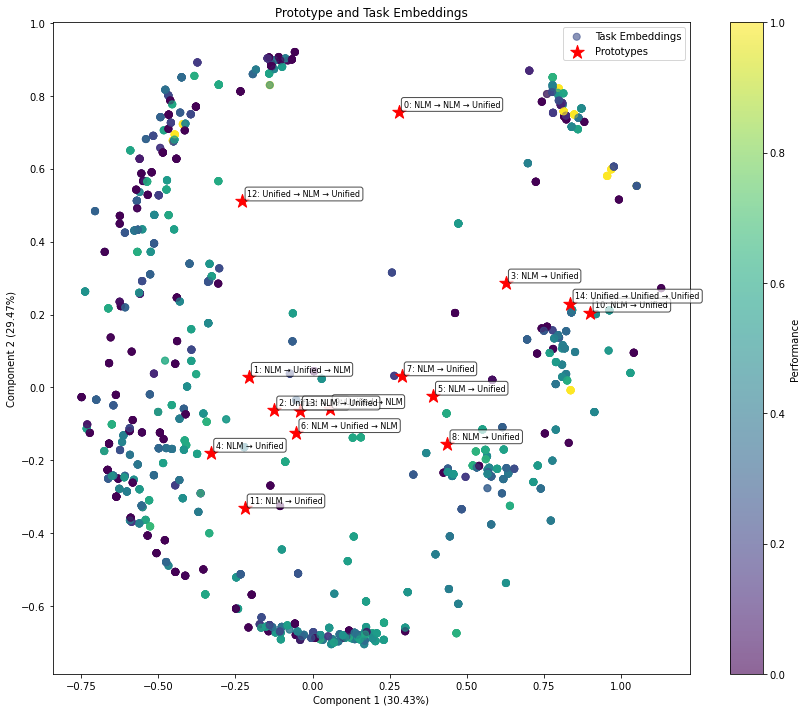

Training MCU:  64%|██████▍   | 321/500 [44:07<28:39,  9.60s/it]

Iteration 321/500, Cell Accuracy: 0.2971, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  64%|██████▍   | 322/500 [44:12<24:50,  8.37s/it]

Iteration 322/500, Cell Accuracy: 0.3905, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  65%|██████▍   | 323/500 [44:17<21:27,  7.28s/it]

Iteration 323/500, Cell Accuracy: 0.5766, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  65%|██████▍   | 324/500 [44:22<19:18,  6.58s/it]

Iteration 324/500, Cell Accuracy: 0.6095, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 325/500, Cell Accuracy: 0.4339, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_325.pt


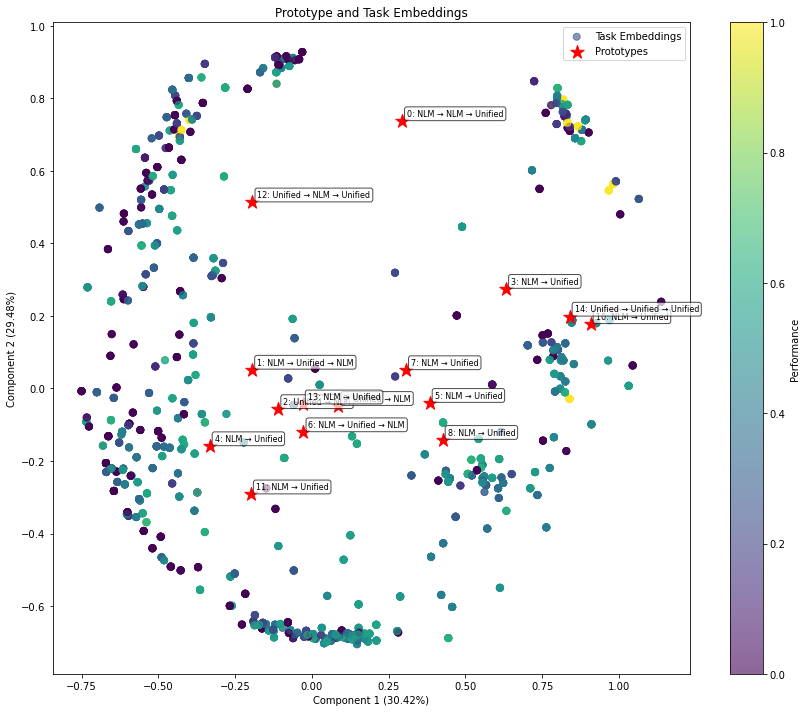

Training MCU:  65%|██████▌   | 326/500 [44:42<23:57,  8.26s/it]

Iteration 326/500, Cell Accuracy: 0.4085, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  65%|██████▌   | 327/500 [44:48<21:54,  7.60s/it]

Iteration 327/500, Cell Accuracy: 0.4620, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  66%|██████▌   | 328/500 [44:59<24:27,  8.53s/it]

Iteration 328/500, Cell Accuracy: 0.4920, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  66%|██████▌   | 329/500 [45:05<22:17,  7.82s/it]

Iteration 329/500, Cell Accuracy: 0.4024, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 330/500, Cell Accuracy: 0.4937, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_330.pt


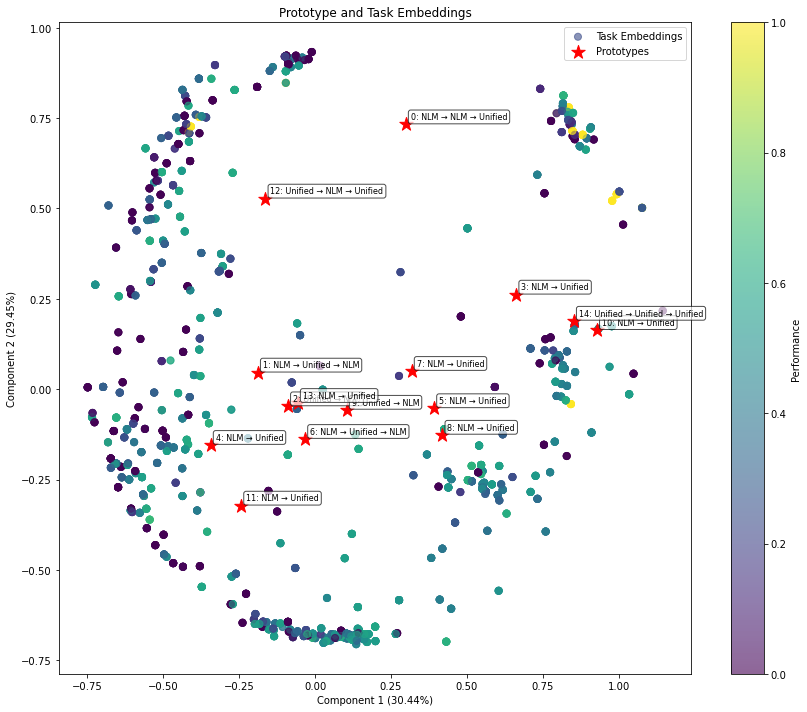

Training MCU:  66%|██████▌   | 331/500 [45:22<22:20,  7.93s/it]

Iteration 331/500, Cell Accuracy: 0.5881, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  66%|██████▋   | 332/500 [45:29<20:56,  7.48s/it]

Iteration 332/500, Cell Accuracy: 0.5091, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  67%|██████▋   | 333/500 [45:37<21:01,  7.56s/it]

Iteration 333/500, Cell Accuracy: 0.4164, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  67%|██████▋   | 334/500 [45:42<19:22,  7.00s/it]

Iteration 334/500, Cell Accuracy: 0.5310, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 335/500, Cell Accuracy: 0.4689, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_335.pt


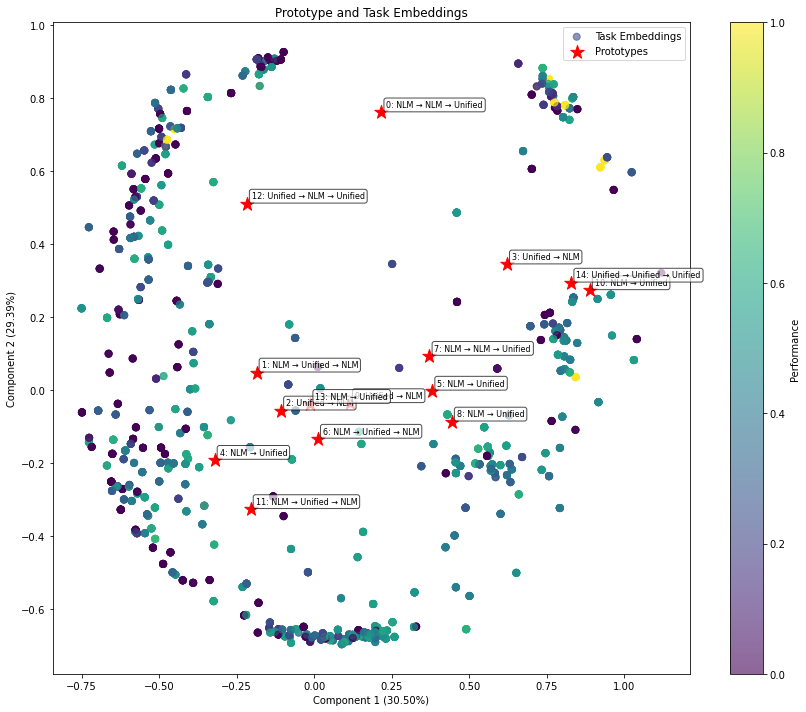

Training MCU:  67%|██████▋   | 336/500 [46:06<26:24,  9.66s/it]

Iteration 336/500, Cell Accuracy: 0.4358, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  67%|██████▋   | 337/500 [46:12<22:43,  8.36s/it]

Iteration 337/500, Cell Accuracy: 0.6879, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  68%|██████▊   | 338/500 [46:17<19:50,  7.35s/it]

Iteration 338/500, Cell Accuracy: 0.4594, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  68%|██████▊   | 339/500 [46:22<18:16,  6.81s/it]

Iteration 339/500, Cell Accuracy: 0.6683, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 340/500, Cell Accuracy: 0.5560, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 12
Model saved to output/models/mcu/proto_mcu_iter_340.pt


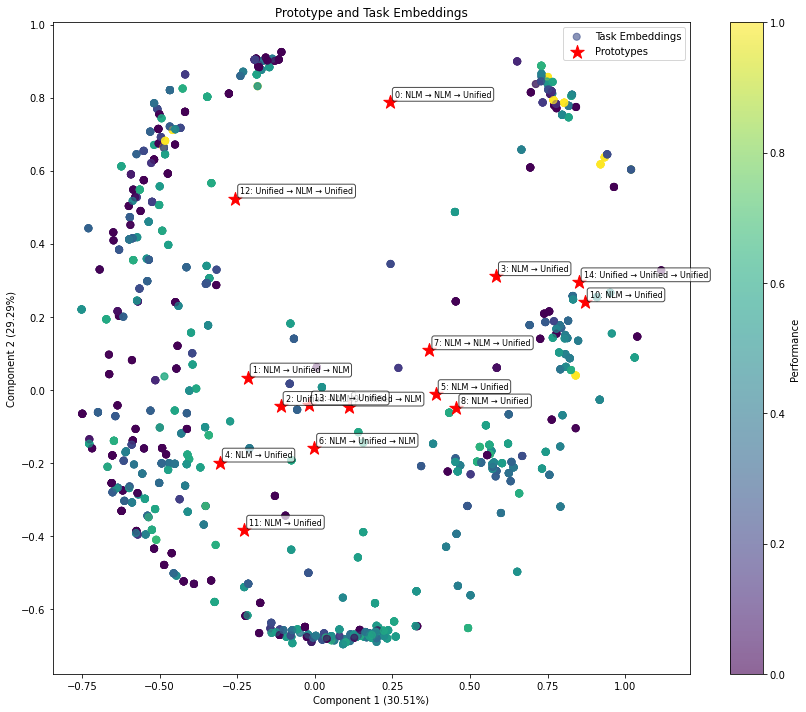

Training MCU:  68%|██████▊   | 341/500 [46:49<26:20,  9.94s/it]

Iteration 341/500, Cell Accuracy: 0.4078, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  68%|██████▊   | 342/500 [46:57<24:51,  9.44s/it]

Iteration 342/500, Cell Accuracy: 0.5925, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  69%|██████▊   | 343/500 [47:09<26:11, 10.01s/it]

Iteration 343/500, Cell Accuracy: 0.5822, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  69%|██████▉   | 344/500 [47:19<26:00, 10.00s/it]

Iteration 344/500, Cell Accuracy: 0.4759, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 345/500, Cell Accuracy: 0.4735, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_345.pt


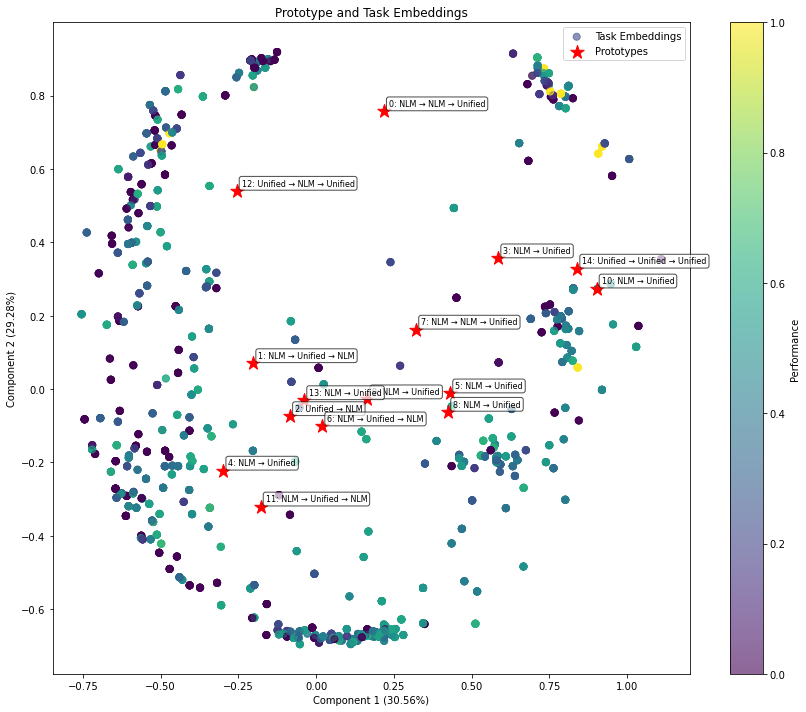

Training MCU:  69%|██████▉   | 346/500 [47:45<29:10, 11.37s/it]

Iteration 346/500, Cell Accuracy: 0.5956, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  69%|██████▉   | 347/500 [47:55<28:07, 11.03s/it]

Iteration 347/500, Cell Accuracy: 0.6427, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  70%|██████▉   | 348/500 [48:01<24:14,  9.57s/it]

Iteration 348/500, Cell Accuracy: 0.4240, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  70%|██████▉   | 349/500 [48:17<28:51, 11.47s/it]

Iteration 349/500, Cell Accuracy: 0.5452, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 350/500, Cell Accuracy: 0.6101, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_350.pt


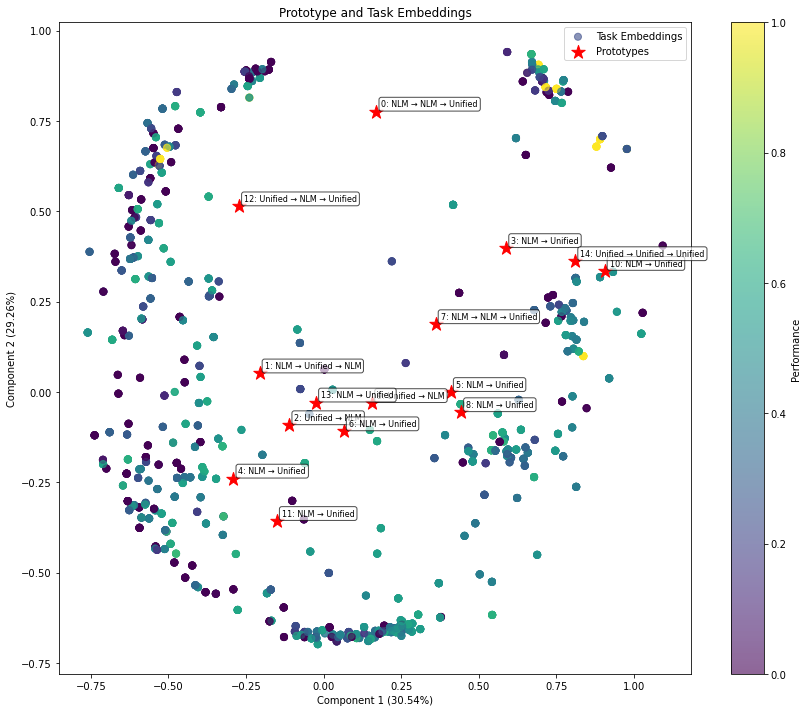

Training MCU:  70%|███████   | 351/500 [48:38<26:52, 10.82s/it]

Iteration 351/500, Cell Accuracy: 0.2622, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  70%|███████   | 352/500 [48:45<23:35,  9.56s/it]

Iteration 352/500, Cell Accuracy: 0.4215, Grid Accuracy: 0.0500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  71%|███████   | 353/500 [48:51<21:24,  8.74s/it]

Iteration 353/500, Cell Accuracy: 0.6129, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  71%|███████   | 354/500 [48:57<18:49,  7.74s/it]

Iteration 354/500, Cell Accuracy: 0.5571, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 355/500, Cell Accuracy: 0.4691, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_355.pt


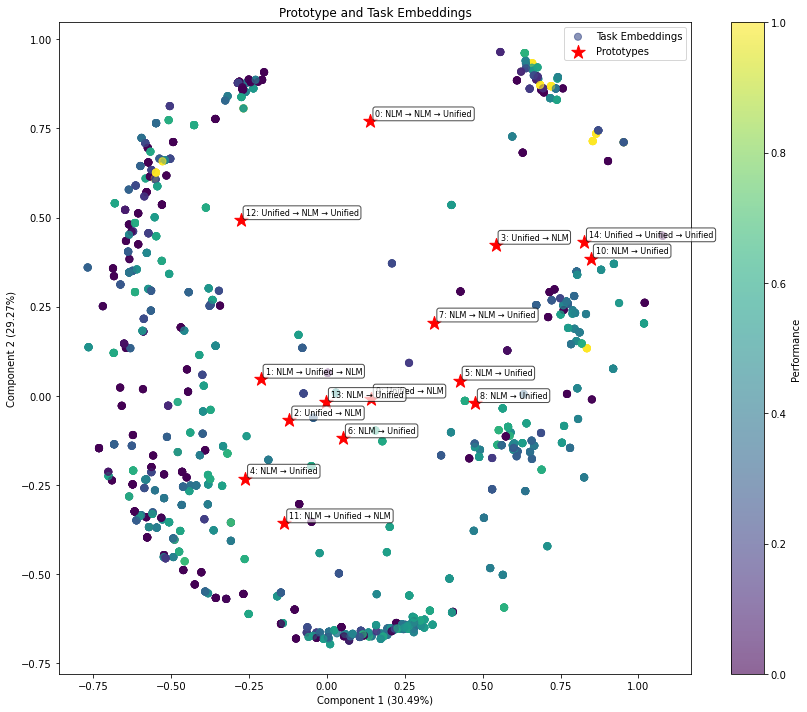

Training MCU:  71%|███████   | 356/500 [49:28<28:07, 11.72s/it]

Iteration 356/500, Cell Accuracy: 0.2979, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  71%|███████▏  | 357/500 [49:35<24:34, 10.31s/it]

Iteration 357/500, Cell Accuracy: 0.6208, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  72%|███████▏  | 358/500 [49:40<21:00,  8.87s/it]

Iteration 358/500, Cell Accuracy: 0.4446, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  72%|███████▏  | 359/500 [49:51<22:06,  9.41s/it]

Iteration 359/500, Cell Accuracy: 0.5518, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 360/500, Cell Accuracy: 0.5425, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_360.pt


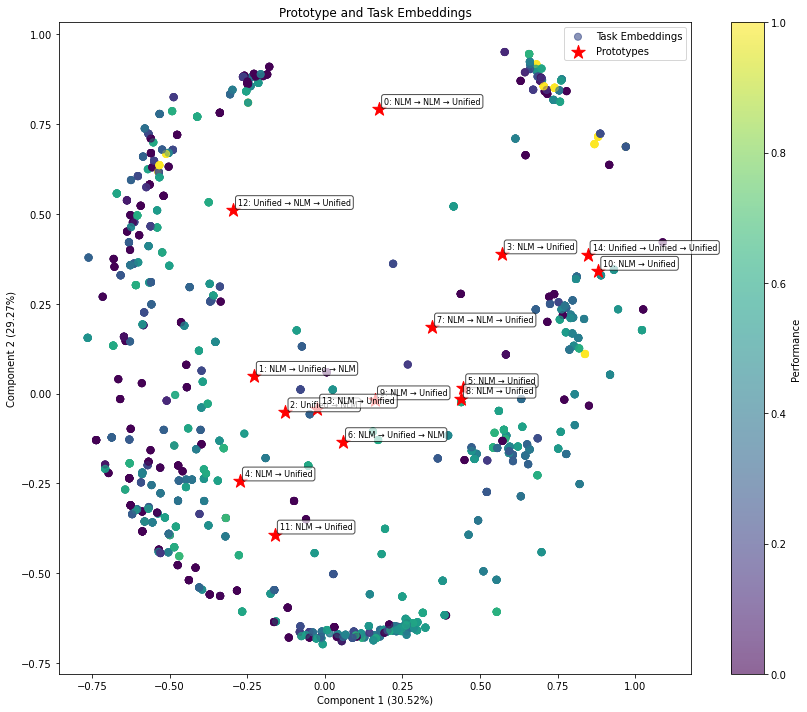

Training MCU:  72%|███████▏  | 361/500 [50:11<21:14,  9.17s/it]

Iteration 361/500, Cell Accuracy: 0.5490, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  72%|███████▏  | 362/500 [50:17<19:21,  8.41s/it]

Iteration 362/500, Cell Accuracy: 0.4765, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  73%|███████▎  | 363/500 [50:31<22:50, 10.01s/it]

Iteration 363/500, Cell Accuracy: 0.3834, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  73%|███████▎  | 364/500 [50:37<20:19,  8.97s/it]

Iteration 364/500, Cell Accuracy: 0.5983, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 365/500, Cell Accuracy: 0.4896, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_365.pt


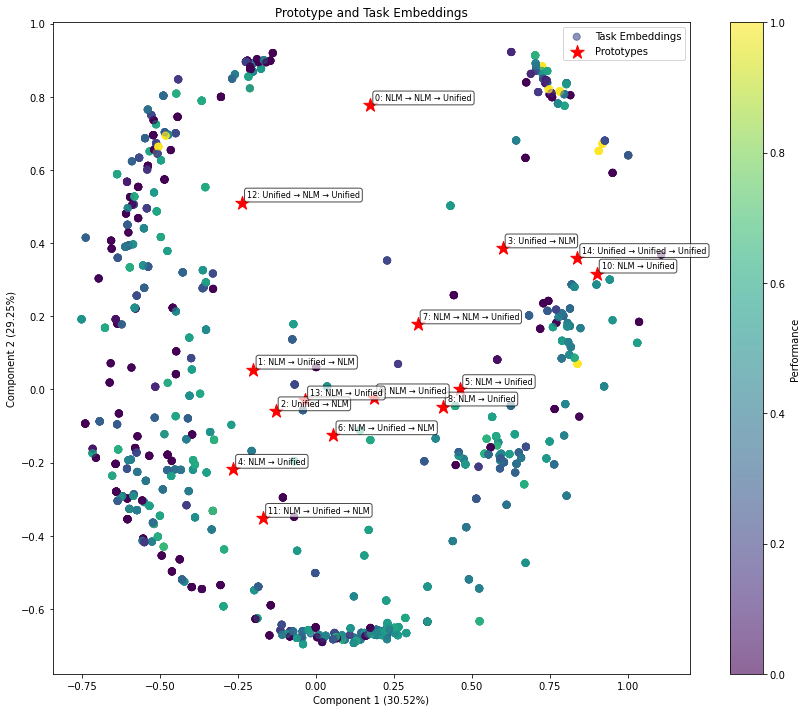

Training MCU:  73%|███████▎  | 366/500 [51:02<23:25, 10.49s/it]

Iteration 366/500, Cell Accuracy: 0.3954, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  73%|███████▎  | 367/500 [51:07<19:48,  8.93s/it]

Iteration 367/500, Cell Accuracy: 0.6121, Grid Accuracy: 0.0500, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  74%|███████▎  | 368/500 [51:14<18:47,  8.54s/it]

Iteration 368/500, Cell Accuracy: 0.4657, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  74%|███████▍  | 369/500 [51:20<16:48,  7.70s/it]

Iteration 369/500, Cell Accuracy: 0.5892, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 370/500, Cell Accuracy: 0.3637, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_370.pt


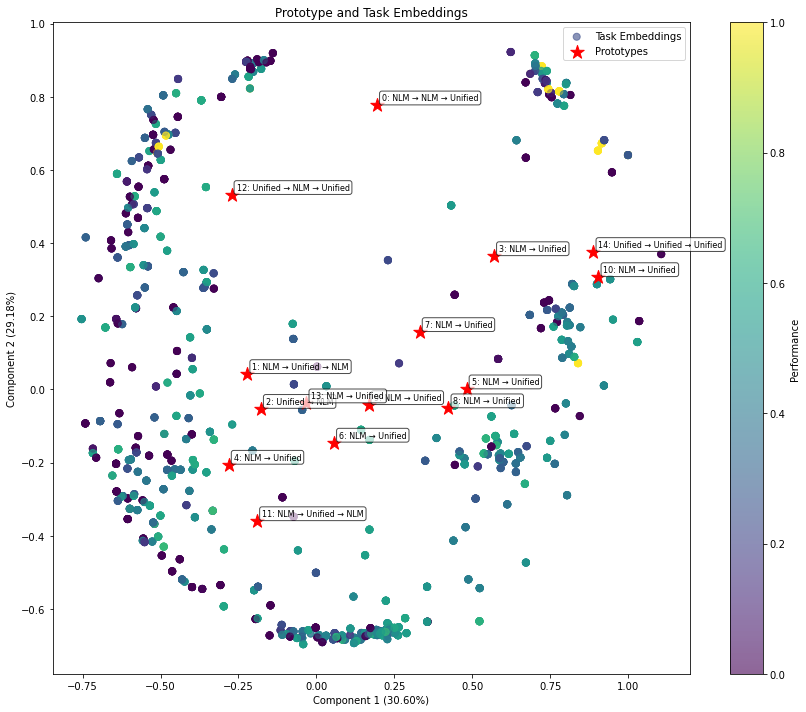

Training MCU:  74%|███████▍  | 371/500 [51:39<17:50,  8.30s/it]

Iteration 371/500, Cell Accuracy: 0.5670, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  74%|███████▍  | 372/500 [51:50<19:50,  9.30s/it]

Iteration 372/500, Cell Accuracy: 0.6086, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  75%|███████▍  | 373/500 [52:01<20:34,  9.72s/it]

Iteration 373/500, Cell Accuracy: 0.4564, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  75%|███████▍  | 374/500 [52:07<18:04,  8.61s/it]

Iteration 374/500, Cell Accuracy: 0.4651, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 375/500, Cell Accuracy: 0.5650, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_375.pt


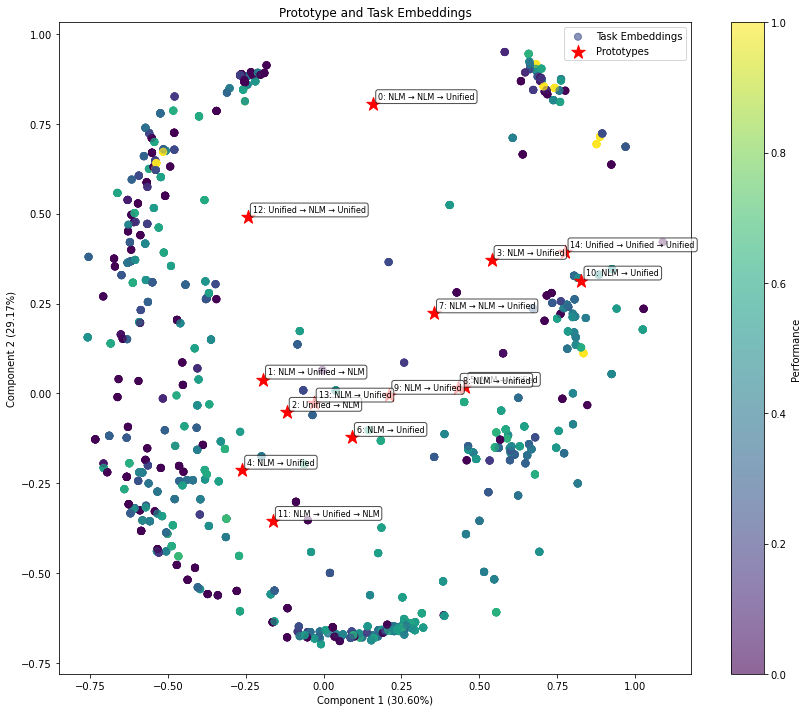

Training MCU:  75%|███████▌  | 376/500 [52:31<20:54, 10.12s/it]

Iteration 376/500, Cell Accuracy: 0.5710, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  75%|███████▌  | 377/500 [52:40<20:03,  9.78s/it]

Iteration 377/500, Cell Accuracy: 0.5235, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  76%|███████▌  | 378/500 [52:46<17:41,  8.70s/it]

Iteration 378/500, Cell Accuracy: 0.6293, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  76%|███████▌  | 379/500 [53:00<20:30, 10.17s/it]

Iteration 379/500, Cell Accuracy: 0.4261, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 380/500, Cell Accuracy: 0.4143, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_380.pt


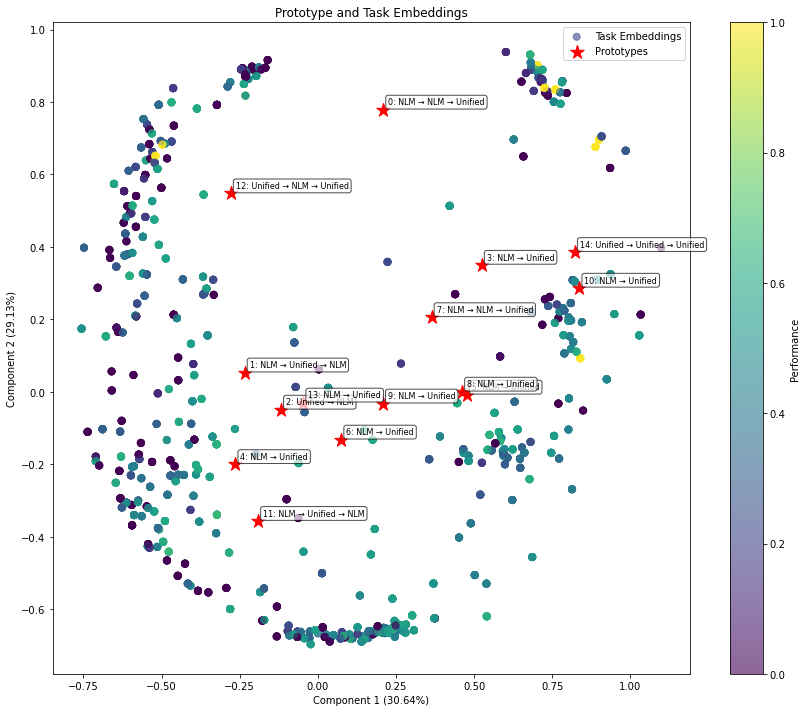

Training MCU:  76%|███████▌  | 381/500 [53:21<20:25, 10.30s/it]

Iteration 381/500, Cell Accuracy: 0.4737, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  76%|███████▋  | 382/500 [53:27<17:41,  9.00s/it]

Iteration 382/500, Cell Accuracy: 0.5396, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  77%|███████▋  | 383/500 [53:33<15:46,  8.09s/it]

Iteration 383/500, Cell Accuracy: 0.6216, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  77%|███████▋  | 384/500 [53:39<14:29,  7.50s/it]

Iteration 384/500, Cell Accuracy: 0.4803, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 385/500, Cell Accuracy: 0.4981, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_385.pt


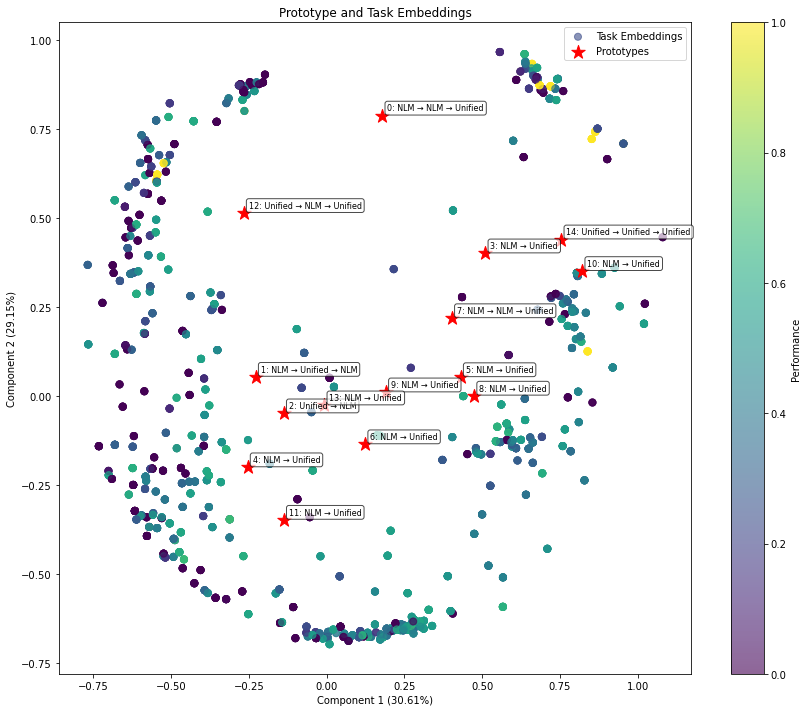

Training MCU:  77%|███████▋  | 386/500 [54:21<24:32, 12.92s/it]

Iteration 386/500, Cell Accuracy: 0.7183, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  77%|███████▋  | 387/500 [54:36<25:29, 13.54s/it]

Iteration 387/500, Cell Accuracy: 0.2634, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  78%|███████▊  | 388/500 [54:49<24:47, 13.28s/it]

Iteration 388/500, Cell Accuracy: 0.4248, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  78%|███████▊  | 389/500 [55:05<26:24, 14.27s/it]

Iteration 389/500, Cell Accuracy: 0.4932, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 390/500, Cell Accuracy: 0.5141, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_390.pt


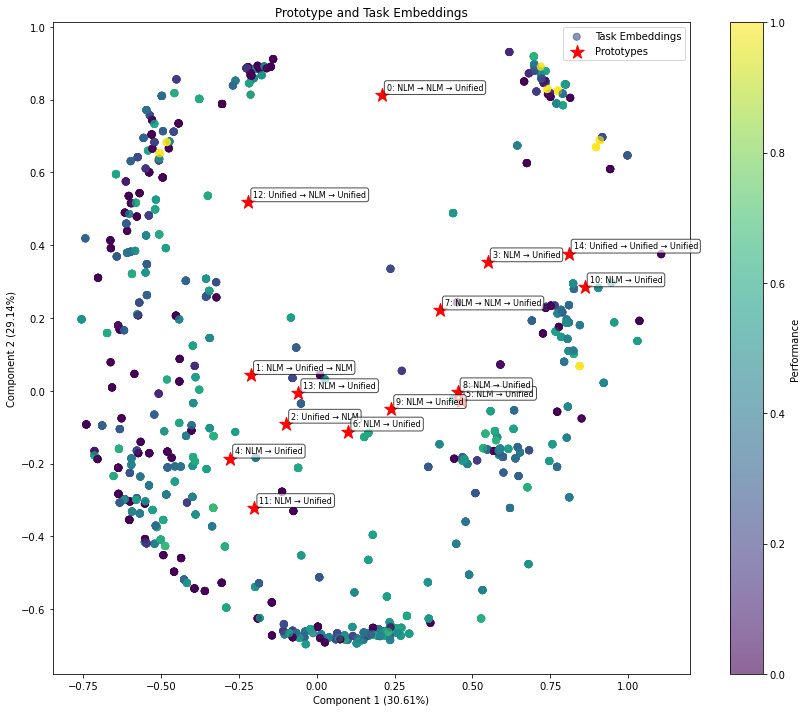

Training MCU:  78%|███████▊  | 391/500 [55:30<23:53, 13.15s/it]

Iteration 391/500, Cell Accuracy: 0.6011, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  78%|███████▊  | 392/500 [55:46<25:25, 14.12s/it]

Iteration 392/500, Cell Accuracy: 0.3145, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  79%|███████▊  | 393/500 [56:05<27:51, 15.62s/it]

Iteration 393/500, Cell Accuracy: 0.3410, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  79%|███████▉  | 394/500 [56:18<25:49, 14.62s/it]

Iteration 394/500, Cell Accuracy: 0.3352, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 12
Iteration 395/500, Cell Accuracy: 0.3874, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_395.pt


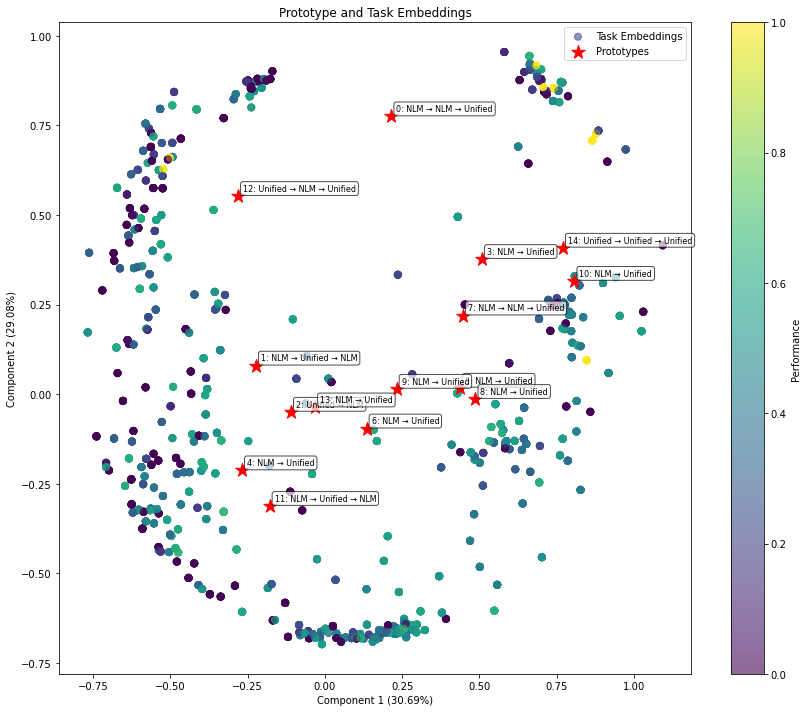

Training MCU:  79%|███████▉  | 396/500 [56:39<21:14, 12.25s/it]

Iteration 396/500, Cell Accuracy: 0.4861, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  79%|███████▉  | 397/500 [56:49<19:29, 11.36s/it]

Iteration 397/500, Cell Accuracy: 0.3112, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  80%|███████▉  | 398/500 [56:56<17:04, 10.05s/it]

Iteration 398/500, Cell Accuracy: 0.5277, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  80%|███████▉  | 399/500 [57:03<15:27,  9.18s/it]

Iteration 399/500, Cell Accuracy: 0.5440, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 400/500, Cell Accuracy: 0.4730, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_400.pt


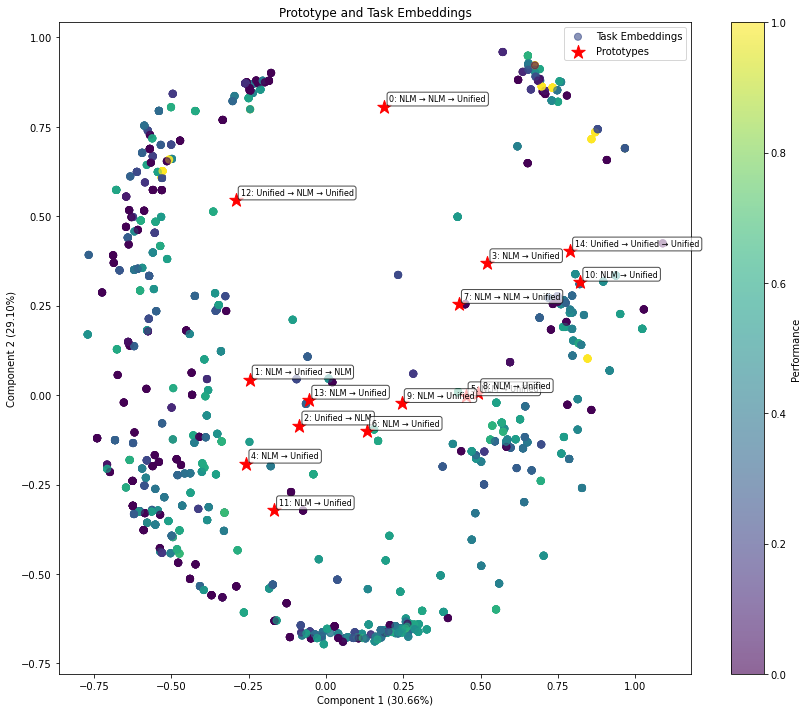

Training MCU:  80%|████████  | 401/500 [57:24<15:57,  9.67s/it]

Iteration 401/500, Cell Accuracy: 0.3822, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  80%|████████  | 402/500 [57:32<14:40,  8.98s/it]

Iteration 402/500, Cell Accuracy: 0.4292, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  81%|████████  | 403/500 [57:40<14:25,  8.92s/it]

Iteration 403/500, Cell Accuracy: 0.4689, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  81%|████████  | 404/500 [57:46<12:44,  7.97s/it]

Iteration 404/500, Cell Accuracy: 0.4310, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 405/500, Cell Accuracy: 0.5694, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_405.pt


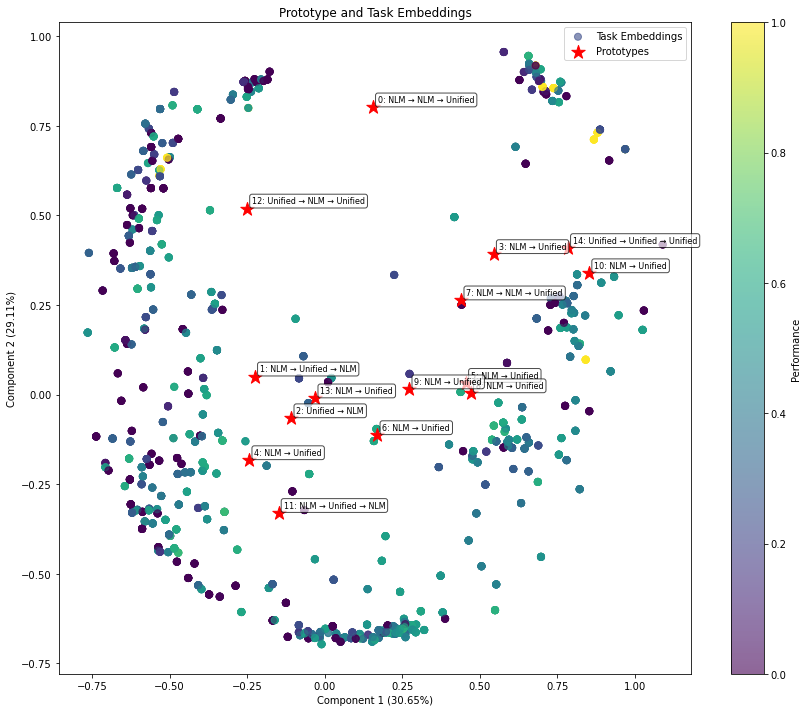

Training MCU:  81%|████████  | 406/500 [58:13<16:22, 10.45s/it]

Iteration 406/500, Cell Accuracy: 0.5432, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  81%|████████▏ | 407/500 [58:19<14:08,  9.13s/it]

Iteration 407/500, Cell Accuracy: 0.5097, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  82%|████████▏ | 408/500 [58:38<18:30, 12.07s/it]

Iteration 408/500, Cell Accuracy: 0.4518, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  82%|████████▏ | 409/500 [58:46<16:29, 10.88s/it]

Iteration 409/500, Cell Accuracy: 0.4807, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 410/500, Cell Accuracy: 0.5590, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_410.pt


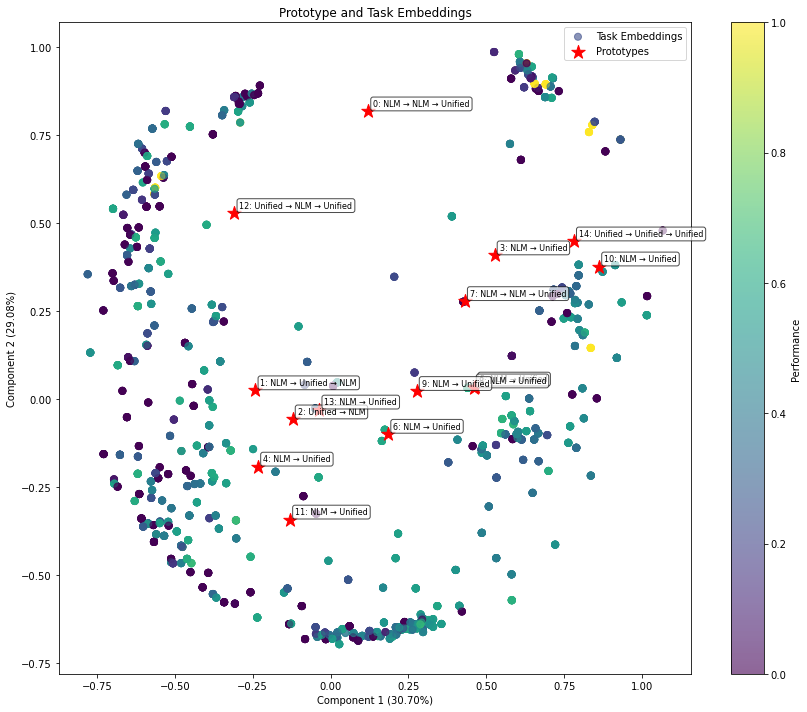

Training MCU:  82%|████████▏ | 411/500 [59:04<14:20,  9.67s/it]

Iteration 411/500, Cell Accuracy: 0.5659, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  82%|████████▏ | 412/500 [59:12<13:20,  9.10s/it]

Iteration 412/500, Cell Accuracy: 0.5900, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  83%|████████▎ | 413/500 [59:18<11:57,  8.25s/it]

Iteration 413/500, Cell Accuracy: 0.4596, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  83%|████████▎ | 414/500 [59:25<11:16,  7.86s/it]

Iteration 414/500, Cell Accuracy: 0.3541, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 415/500, Cell Accuracy: 0.3149, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_415.pt


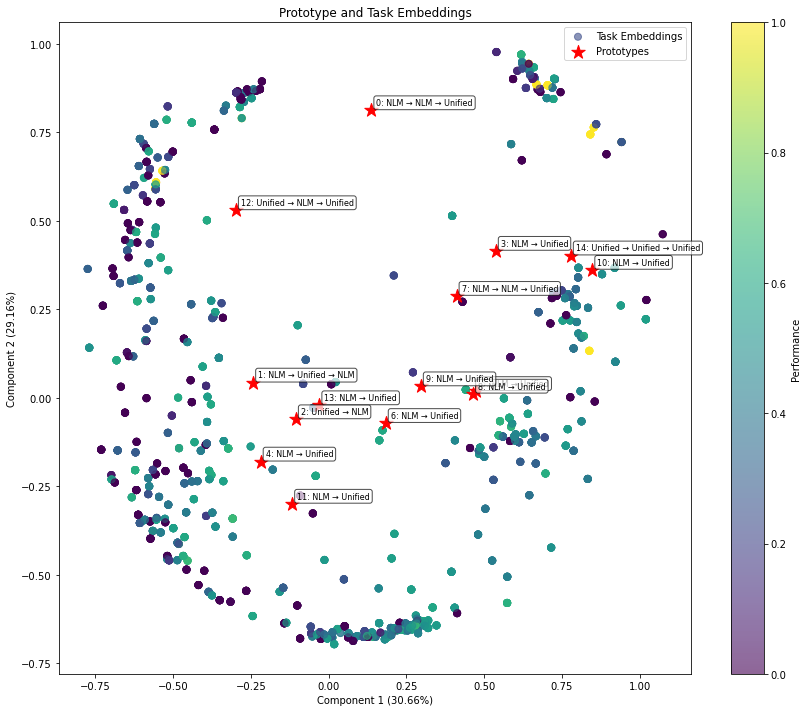

Training MCU:  83%|████████▎ | 416/500 [59:49<13:22,  9.55s/it]

Iteration 416/500, Cell Accuracy: 0.4939, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  83%|████████▎ | 417/500 [59:57<12:39,  9.16s/it]

Iteration 417/500, Cell Accuracy: 0.6125, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  84%|████████▍ | 422/500 [1:00:58<14:55, 11.48s/it]

Iteration 422/500, Cell Accuracy: 0.4244, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  85%|████████▍ | 423/500 [1:01:21<18:59, 14.80s/it]

Iteration 423/500, Cell Accuracy: 0.3456, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  85%|████████▍ | 424/500 [1:01:30<16:44, 13.22s/it]

Iteration 424/500, Cell Accuracy: 0.5440, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 425/500, Cell Accuracy: 0.4581, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_425.pt


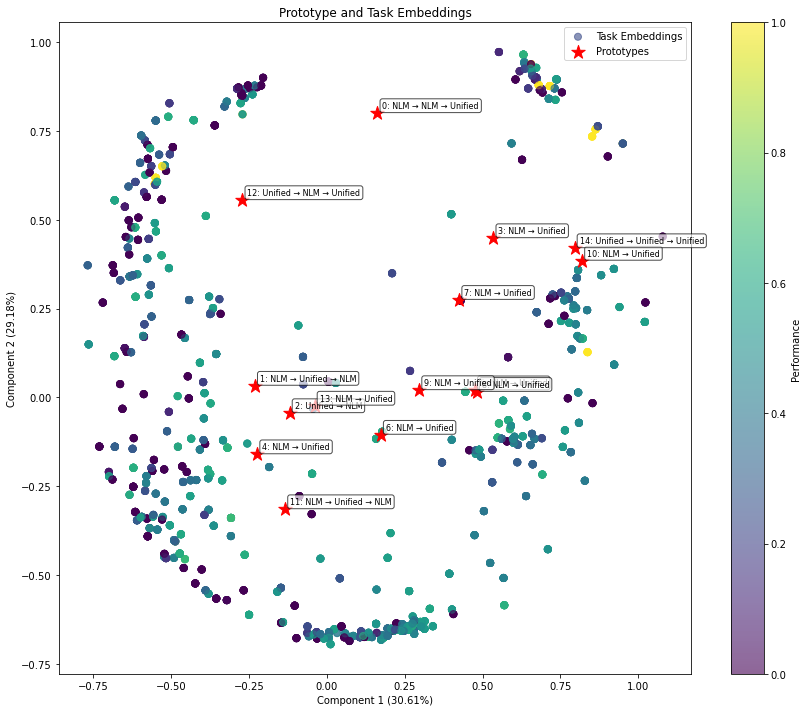

Training MCU:  85%|████████▌ | 426/500 [1:01:53<15:01, 12.18s/it]

Iteration 426/500, Cell Accuracy: 0.5547, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  86%|████████▌ | 431/500 [1:03:07<16:21, 14.22s/it]

Iteration 431/500, Cell Accuracy: 0.5009, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  86%|████████▋ | 432/500 [1:03:13<13:35, 12.00s/it]

Iteration 432/500, Cell Accuracy: 0.6297, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  87%|████████▋ | 433/500 [1:03:21<12:03, 10.79s/it]

Iteration 433/500, Cell Accuracy: 0.5059, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  87%|████████▋ | 434/500 [1:03:33<12:12, 11.09s/it]

Iteration 434/500, Cell Accuracy: 0.3740, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 12
Iteration 435/500, Cell Accuracy: 0.7381, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 13
Model saved to output/models/mcu/proto_mcu_iter_435.pt


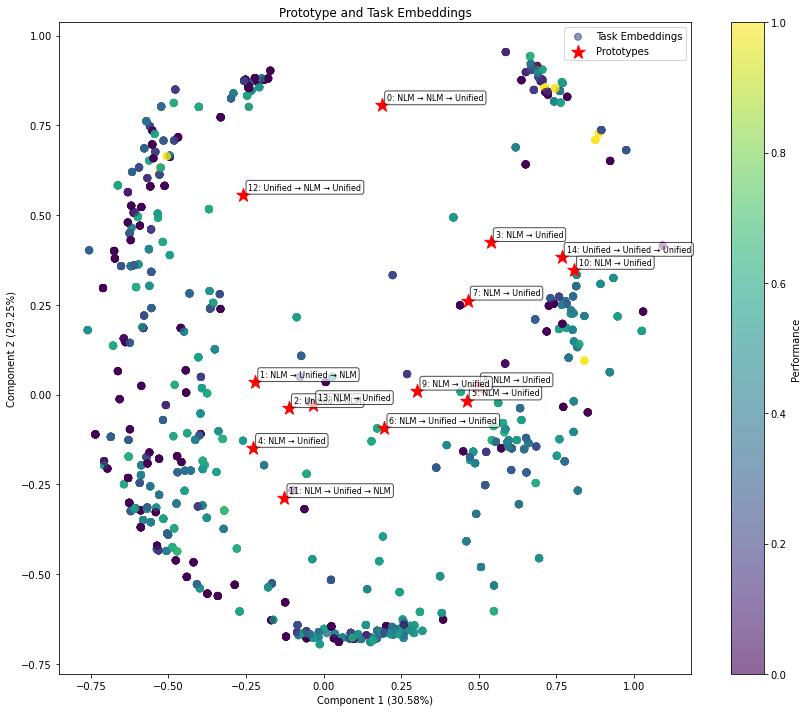

Training MCU:  87%|████████▋ | 436/500 [1:03:55<11:26, 10.73s/it]

Iteration 436/500, Cell Accuracy: 0.4083, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  87%|████████▋ | 437/500 [1:04:03<10:25,  9.93s/it]

Iteration 437/500, Cell Accuracy: 0.3725, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  88%|████████▊ | 438/500 [1:04:13<10:22, 10.05s/it]

Iteration 438/500, Cell Accuracy: 0.3666, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  88%|████████▊ | 439/500 [1:04:22<09:49,  9.66s/it]

Iteration 439/500, Cell Accuracy: 0.3049, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 440/500, Cell Accuracy: 0.3271, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_440.pt


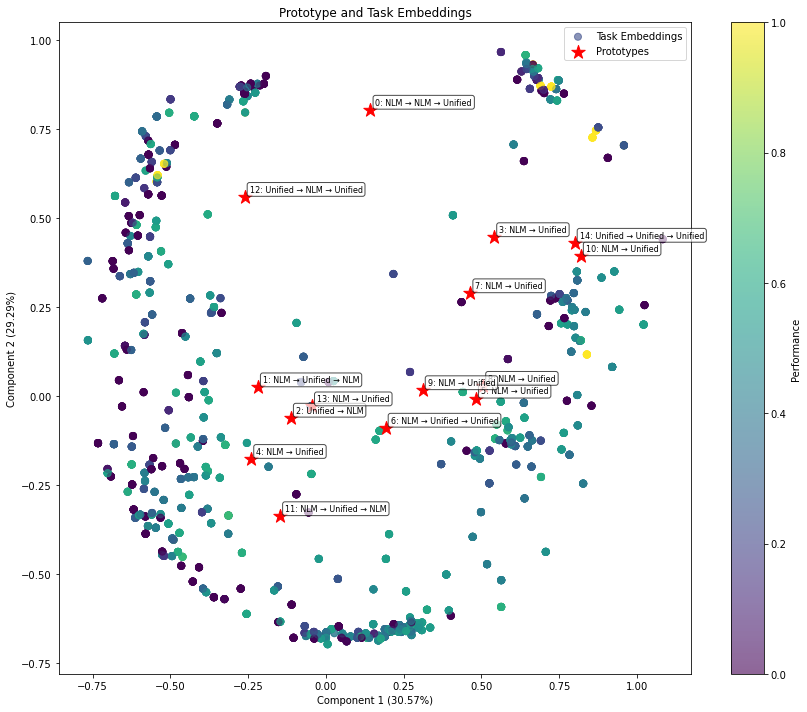

Training MCU:  88%|████████▊ | 441/500 [1:04:52<11:26, 11.64s/it]

Iteration 441/500, Cell Accuracy: 0.3614, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  88%|████████▊ | 442/500 [1:05:02<10:59, 11.38s/it]

Iteration 442/500, Cell Accuracy: 0.4092, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  89%|████████▊ | 443/500 [1:05:13<10:44, 11.31s/it]

Iteration 443/500, Cell Accuracy: 0.4608, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 450/500, Cell Accuracy: 0.4777, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_450.pt


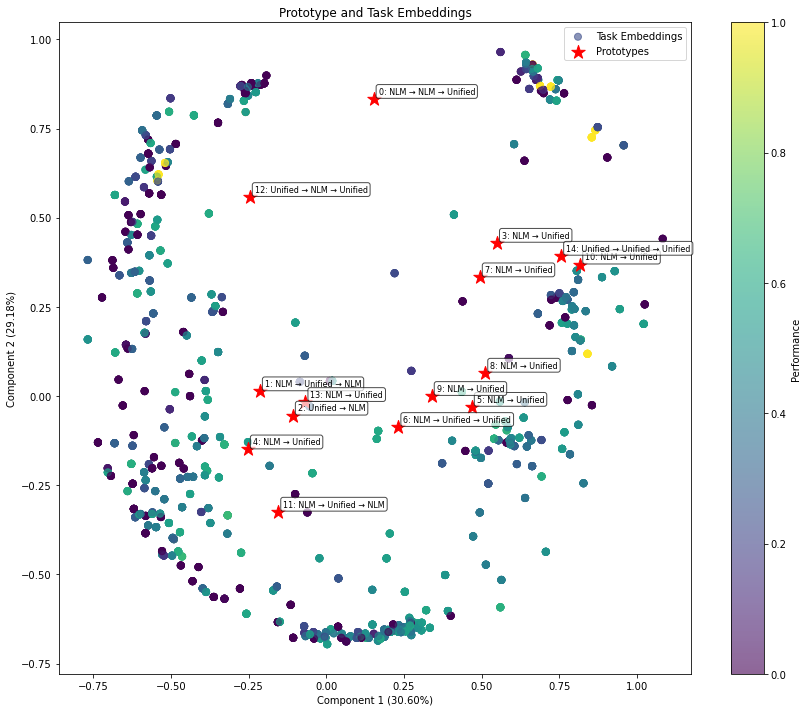

Training MCU:  90%|█████████ | 451/500 [1:06:40<09:25, 11.53s/it]

Iteration 451/500, Cell Accuracy: 0.2390, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  90%|█████████ | 452/500 [1:06:51<09:04, 11.34s/it]

Iteration 452/500, Cell Accuracy: 0.5839, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  91%|█████████ | 453/500 [1:07:07<10:04, 12.86s/it]

Iteration 453/500, Cell Accuracy: 0.3933, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  91%|█████████ | 454/500 [1:07:21<10:05, 13.15s/it]

Iteration 454/500, Cell Accuracy: 0.5167, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 455/500, Cell Accuracy: 0.5291, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11
Model saved to output/models/mcu/proto_mcu_iter_455.pt


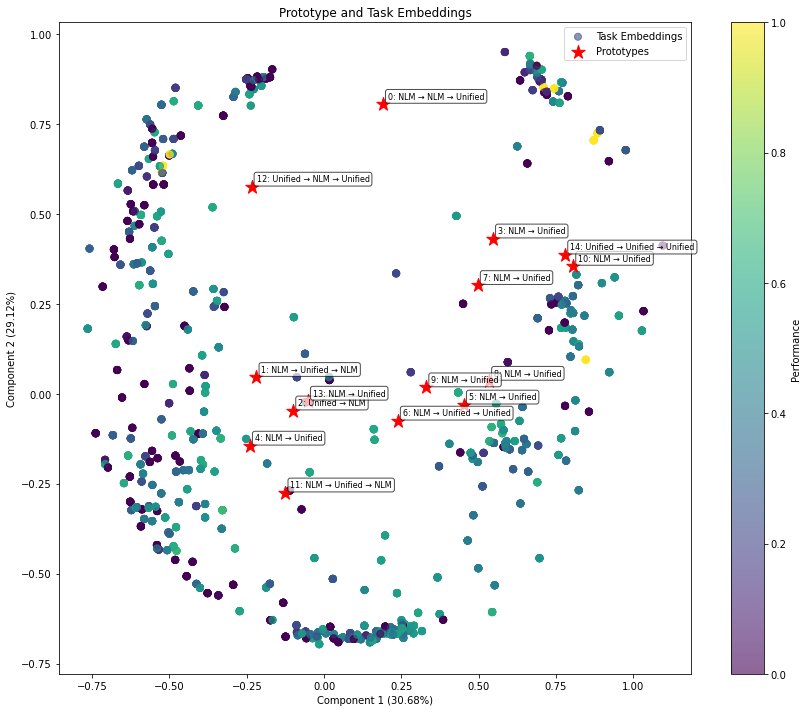

Training MCU:  91%|█████████ | 456/500 [1:07:44<08:41, 11.84s/it]

Iteration 456/500, Cell Accuracy: 0.4430, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  91%|█████████▏| 457/500 [1:07:55<08:25, 11.75s/it]

Iteration 457/500, Cell Accuracy: 0.4006, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  92%|█████████▏| 458/500 [1:08:02<07:13, 10.31s/it]

Iteration 458/500, Cell Accuracy: 0.7095, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  92%|█████████▏| 459/500 [1:08:10<06:35,  9.65s/it]

Iteration 459/500, Cell Accuracy: 0.3735, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 460/500, Cell Accuracy: 0.4702, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_460.pt


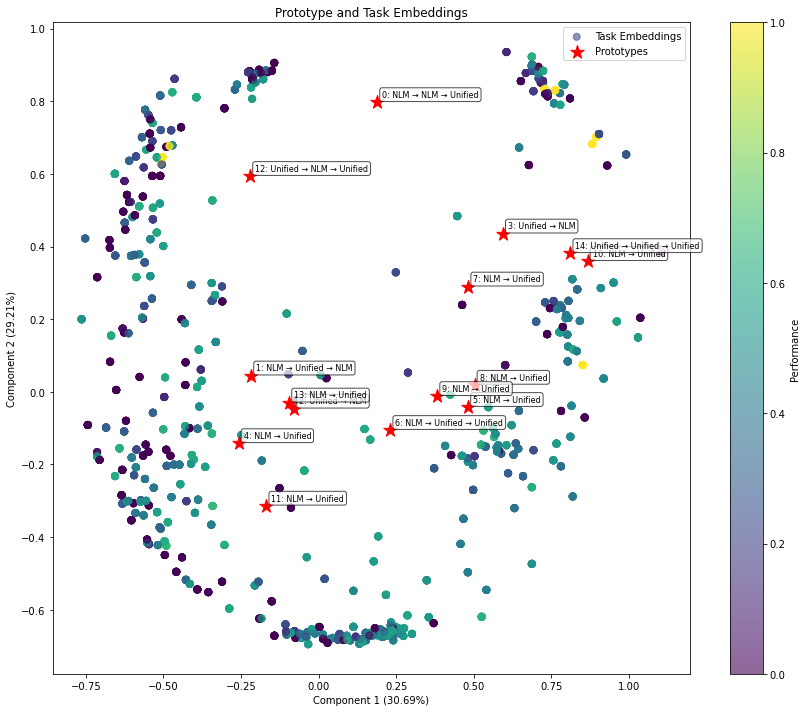

Training MCU:  92%|█████████▏| 461/500 [1:08:36<07:03, 10.85s/it]

Iteration 461/500, Cell Accuracy: 0.3683, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  92%|█████████▏| 462/500 [1:08:44<06:18,  9.95s/it]

Iteration 462/500, Cell Accuracy: 0.5994, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  93%|█████████▎| 463/500 [1:08:51<05:42,  9.26s/it]

Iteration 463/500, Cell Accuracy: 0.5822, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  93%|█████████▎| 464/500 [1:09:02<05:44,  9.58s/it]

Iteration 464/500, Cell Accuracy: 0.3866, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 465/500, Cell Accuracy: 0.6206, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 9, Unified: 12
Model saved to output/models/mcu/proto_mcu_iter_465.pt


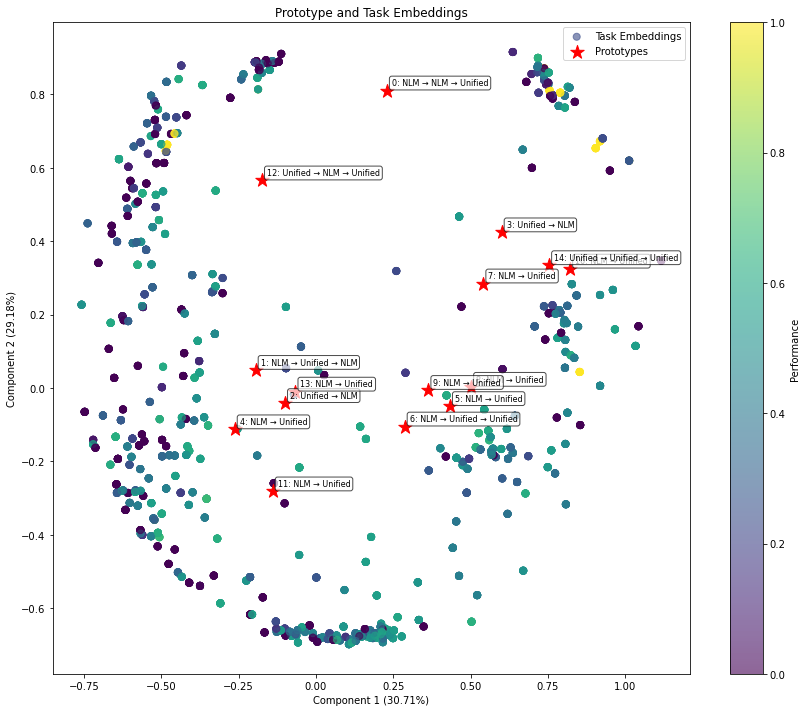

Training MCU:  93%|█████████▎| 466/500 [1:09:25<05:45, 10.16s/it]

Iteration 466/500, Cell Accuracy: 0.5154, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  93%|█████████▎| 467/500 [1:09:36<05:50, 10.64s/it]

Iteration 467/500, Cell Accuracy: 0.3679, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  94%|█████████▎| 468/500 [1:09:44<05:15,  9.87s/it]

Iteration 468/500, Cell Accuracy: 0.5557, Grid Accuracy: 0.2000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 11


Training MCU:  94%|█████████▍| 469/500 [1:09:51<04:36,  8.91s/it]

Iteration 469/500, Cell Accuracy: 0.5760, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 470/500, Cell Accuracy: 0.6017, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_470.pt


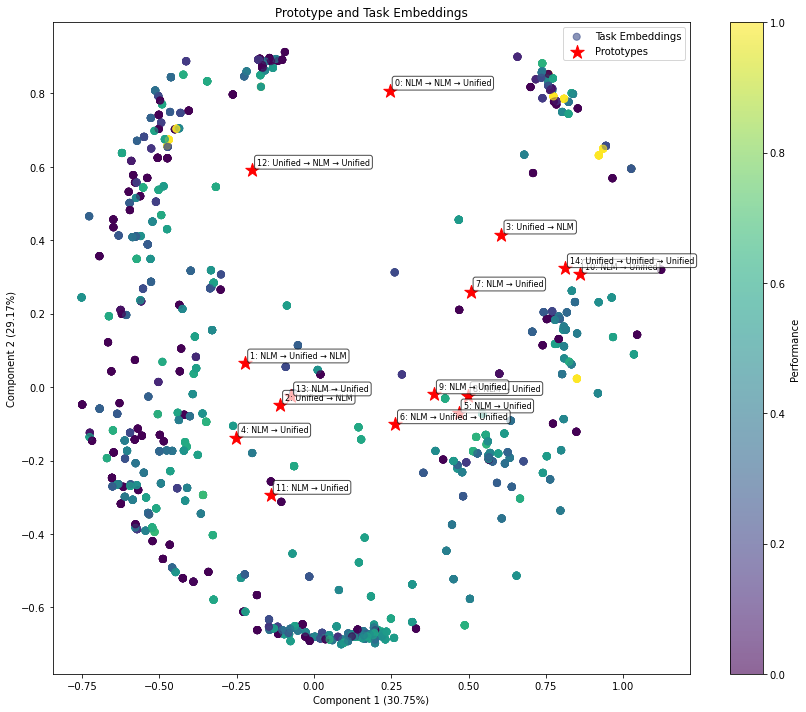

Training MCU:  94%|█████████▍| 471/500 [1:10:13<04:39,  9.64s/it]

Iteration 471/500, Cell Accuracy: 0.4019, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  94%|█████████▍| 472/500 [1:10:28<05:13, 11.20s/it]

Iteration 472/500, Cell Accuracy: 0.3362, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  95%|█████████▍| 473/500 [1:10:49<06:24, 14.24s/it]

Iteration 473/500, Cell Accuracy: 0.4033, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  95%|█████████▍| 474/500 [1:11:05<06:21, 14.68s/it]

Iteration 474/500, Cell Accuracy: 0.4849, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 475/500, Cell Accuracy: 0.6014, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_475.pt


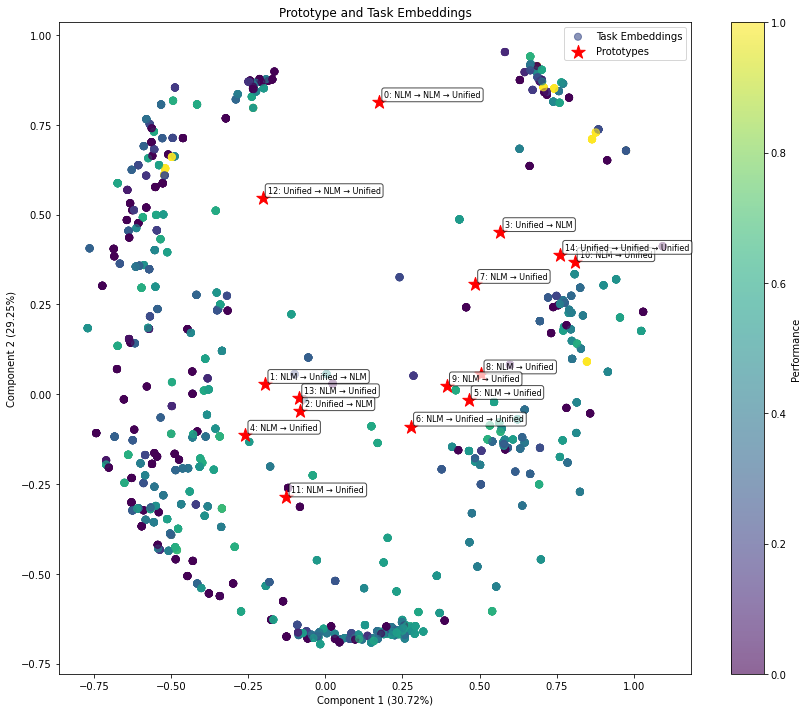

Training MCU:  95%|█████████▌| 476/500 [1:11:36<05:58, 14.92s/it]

Iteration 476/500, Cell Accuracy: 0.6270, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  95%|█████████▌| 477/500 [1:11:45<05:03, 13.19s/it]

Iteration 477/500, Cell Accuracy: 0.4781, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  96%|█████████▌| 478/500 [1:11:53<04:11, 11.45s/it]

Iteration 478/500, Cell Accuracy: 0.4378, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  96%|█████████▌| 479/500 [1:12:04<03:59, 11.41s/it]

Iteration 479/500, Cell Accuracy: 0.4904, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 480/500, Cell Accuracy: 0.3405, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_480.pt


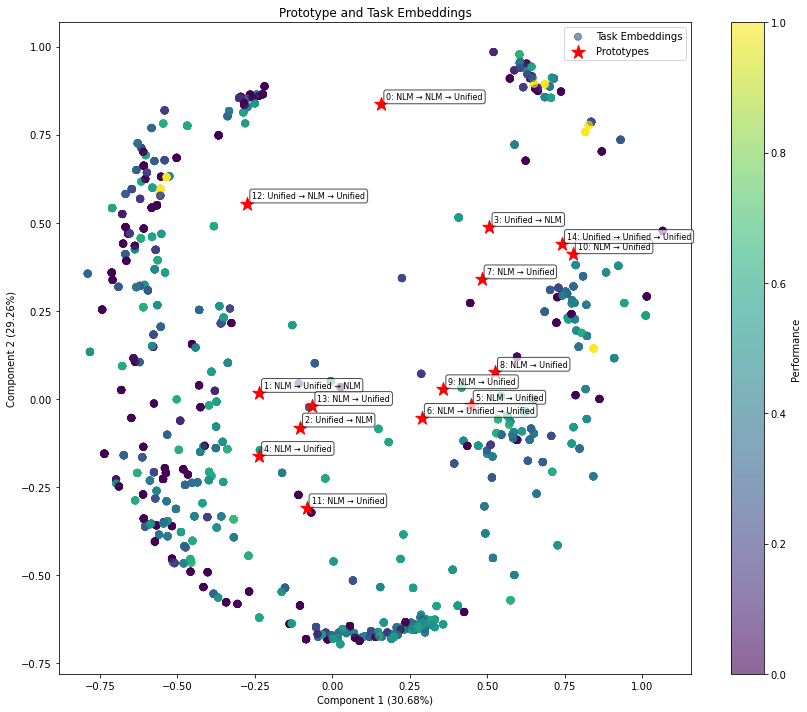

Training MCU:  96%|█████████▌| 481/500 [1:12:33<03:58, 12.58s/it]

Iteration 481/500, Cell Accuracy: 0.3069, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  96%|█████████▋| 482/500 [1:12:41<03:19, 11.09s/it]

Iteration 482/500, Cell Accuracy: 0.4049, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  97%|█████████▋| 483/500 [1:12:56<03:32, 12.48s/it]

Iteration 483/500, Cell Accuracy: 0.6159, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  97%|█████████▋| 484/500 [1:13:09<03:22, 12.66s/it]

Iteration 484/500, Cell Accuracy: 0.3041, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 485/500, Cell Accuracy: 0.5033, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_485.pt


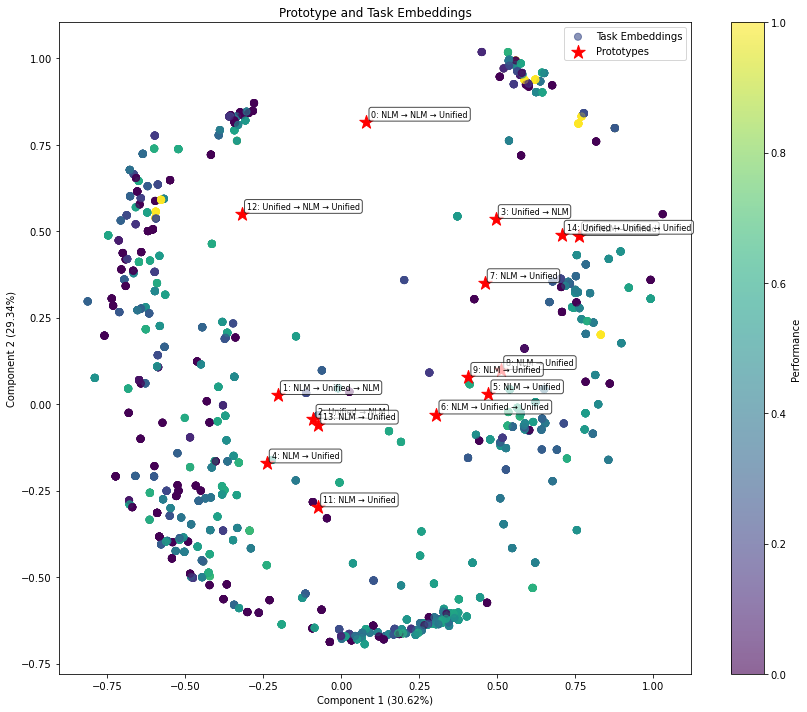

Training MCU:  97%|█████████▋| 486/500 [1:13:38<03:07, 13.42s/it]

Iteration 486/500, Cell Accuracy: 0.4822, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  97%|█████████▋| 487/500 [1:13:46<02:32, 11.72s/it]

Iteration 487/500, Cell Accuracy: 0.5263, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  98%|█████████▊| 488/500 [1:13:53<02:04, 10.39s/it]

Iteration 488/500, Cell Accuracy: 0.5085, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  98%|█████████▊| 489/500 [1:14:01<01:46,  9.68s/it]

Iteration 489/500, Cell Accuracy: 0.5463, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 490/500, Cell Accuracy: 0.4694, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_490.pt


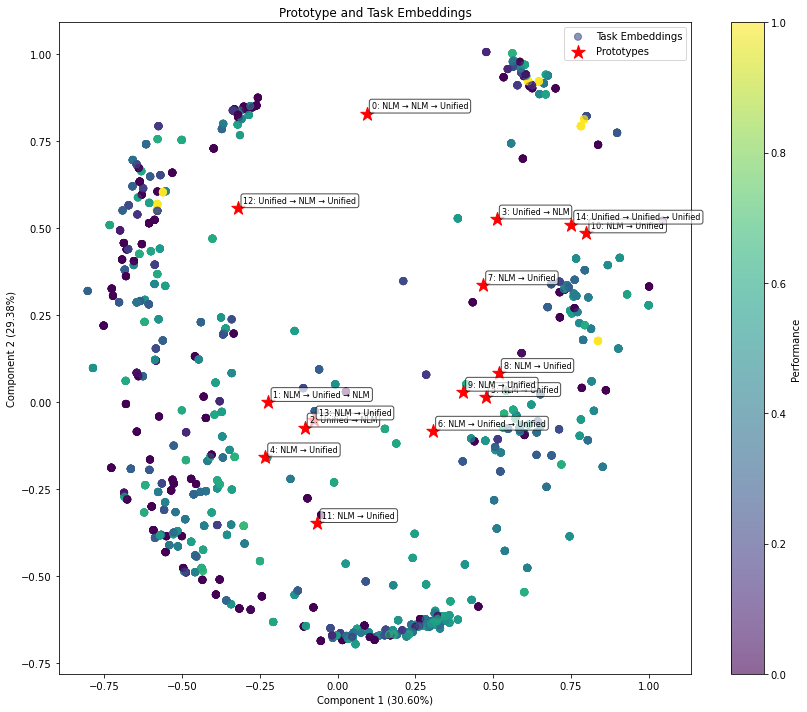

Training MCU:  98%|█████████▊| 491/500 [1:14:27<01:39, 11.03s/it]

Iteration 491/500, Cell Accuracy: 0.5301, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  98%|█████████▊| 492/500 [1:14:39<01:29, 11.19s/it]

Iteration 492/500, Cell Accuracy: 0.3212, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  99%|█████████▊| 493/500 [1:14:51<01:19, 11.35s/it]

Iteration 493/500, Cell Accuracy: 0.4062, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  99%|█████████▉| 494/500 [1:14:59<01:01, 10.31s/it]

Iteration 494/500, Cell Accuracy: 0.4135, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 495/500, Cell Accuracy: 0.3732, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_495.pt


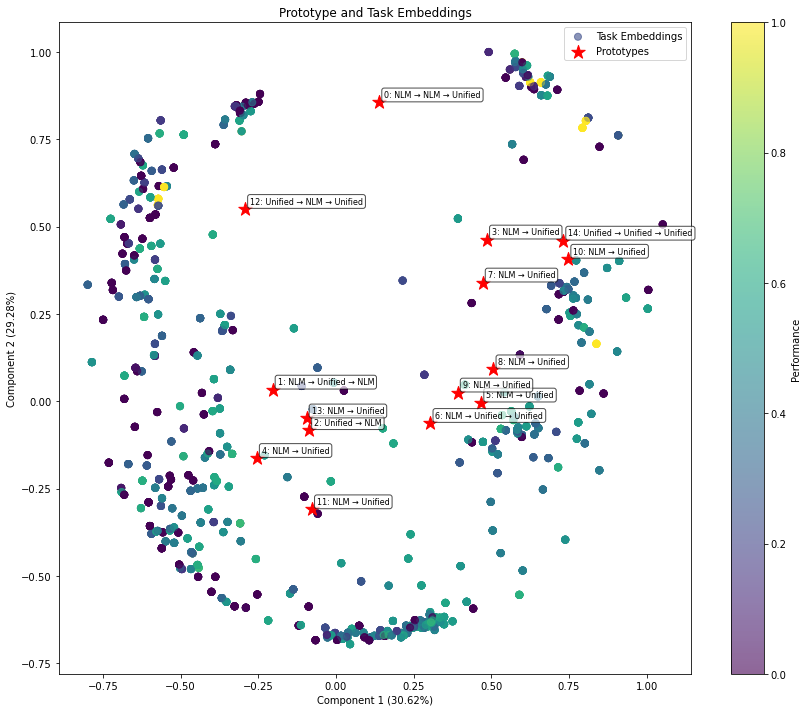

Training MCU:  99%|█████████▉| 496/500 [1:15:29<00:48, 12.17s/it]

Iteration 496/500, Cell Accuracy: 0.6154, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU:  99%|█████████▉| 497/500 [1:15:36<00:32, 10.75s/it]

Iteration 497/500, Cell Accuracy: 0.5009, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU: 100%|█████████▉| 498/500 [1:15:48<00:21, 10.99s/it]

Iteration 498/500, Cell Accuracy: 0.4680, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10


Training MCU: 100%|█████████▉| 499/500 [1:16:00<00:11, 11.41s/it]

Iteration 499/500, Cell Accuracy: 0.5153, Grid Accuracy: 0.1000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Iteration 500/500, Cell Accuracy: 0.5290, Grid Accuracy: 0.0000, Epsilon: 0.0476
Module usage: NLM_Adapter: 10, Unified: 10
Model saved to output/models/mcu/proto_mcu_iter_500.pt


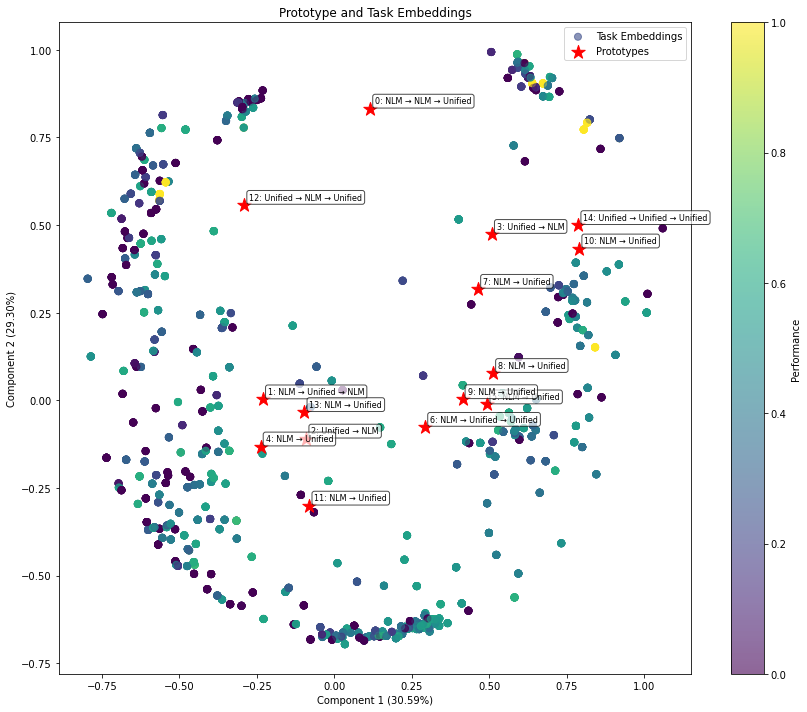

Training MCU: 100%|██████████| 500/500 [1:16:21<00:00,  9.16s/it]


Model saved to output/models/mcu/proto_mcu_final.pt
Running final evaluation on test tasks...


TypeError: 'NoneType' object is not iterable

In [27]:
# Train the MCU with task adaptation on NLM
proto_mcu, history, test_results = train_mcu_with_task_adaptation(
    proto_mcu=proto_mcu,
    training_tasks=all_tasks,
    test_tasks=None,
    nlm_module=nlm,
    unified_module=unified,
    nlm_model_path=os.path.join(MODEL_DIR, "nlm/maml/nlm_maml_final_model.pt"),
    unified_model_path=os.path.join(MODEL_DIR, "unified/maml/unified_maml_final_model.pt"),
    num_iterations=500,
    device=device
)

print("Training completed!")
print(f"Final test results: Node accuracy = {test_results[0]:.4f}, Grid accuracy = {test_results[1]:.4f}")

In [32]:
def test_mcu(proto_mcu, test_tasks):
    """
    Test MCU on test tasks with enhanced metrics tracking including timing measurements
    
    Args:
        proto_mcu: Trained MCU model
        test_tasks: List of test tasks
        
    Returns:
        Tuple of (metrics_dict, results_list)
    """
    import os
    import json
    import numpy as np
    import matplotlib.pyplot as plt
    import datetime
    import time
    
    # Initialize metrics
    metrics = {
        "total_node_accuracy": 0.0,
        "total_grid_accuracy": 0.0,
        "correct_tasks": 0,      # Tasks with perfect grid accuracy
        "correct_test_grids": 0, # Total number of correctly predicted grids
        "total_test_grids": 0,   # Total number of test grids
        "correct_test_nodes": 0, # Total number of correctly predicted nodes
        "total_test_nodes": 0,   # Total number of test nodes
        "module_usage": {},      # Track module usage across tasks
        "module_times": {},      # Track average deliberation time by module
        "total_time": 0.0,       # Total time for all tasks
    }
    
    results = []
    
    # Create output directories if they don't exist
    os.makedirs("output/models/mcu", exist_ok=True)
    os.makedirs("output/models/mcu/visualizations", exist_ok=True)
    os.makedirs("output/models/mcu/task_examples", exist_ok=True)
    
    # Create a tracking function to monitor which modules are used
    module_execution_times = {}
    
    # Add the tracking functions to the modules themselves
    for module_name, module in proto_mcu.modules.items():
        # Store the original solve method
        if hasattr(module, 'solve'):
            original_solve = module.solve
            
            # Create a wrapper to track timing
            def get_timed_solve(original_fn, module_name):
                def timed_solve(task, *args, **kwargs):
                    start_time = time.time()
                    result = original_fn(task, *args, **kwargs)
                    end_time = time.time()
                    execution_time = end_time - start_time
                    
                    # Store the timing
                    if module_name not in module_execution_times:
                        module_execution_times[module_name] = []
                    module_execution_times[module_name].append(execution_time)
                    
                    return result
                return timed_solve
            
            # Replace the solve method
            module.solve = get_timed_solve(original_solve, module_name)
    
    for i, task in tqdm(enumerate(test_tasks), desc="Evaluating MCU"):
        # Clear previous execution times for this task
        for module_name in module_execution_times:
            module_execution_times[module_name] = []
        
        # Record overall task solving time
        task_start_time = time.time()
        
        # Use learned policy to select modules
        predictions = proto_mcu.solve_task(task, training=False)
        
        # Record task solving time
        task_end_time = time.time()
        task_time = task_end_time - task_start_time
        
        # Evaluate predictions
        node_accuracy, grid_accuracy = proto_mcu.evaluate_predictions(predictions, task)
        
        # Count correct nodes and grids
        task_correct_nodes = 0
        task_total_nodes = 0
        task_correct_grids = 0
        
        for j, ((inp, expected), pred) in enumerate(zip(task.test_pairs, predictions if isinstance(predictions, list) else [predictions])):
            # Convert to numpy arrays for comparison
            expected_np = np.array(expected)
            pred_np = np.array(pred)
            
            # Check if shapes match
            if expected_np.shape == pred_np.shape:
                # Count correct nodes
                matches = (expected_np == pred_np)
                task_correct_nodes += np.sum(matches)
                task_total_nodes += matches.size
                
                # Check if entire grid is correct
                if np.all(matches):
                    task_correct_grids += 1
            else:
                # If shapes don't match, count all nodes as incorrect
                task_total_nodes += expected_np.size
        
        # Update overall metrics
        metrics["total_node_accuracy"] += node_accuracy
        metrics["total_grid_accuracy"] += grid_accuracy
        metrics["correct_test_nodes"] += task_correct_nodes
        metrics["total_test_nodes"] += task_total_nodes
        metrics["correct_test_grids"] += task_correct_grids
        metrics["total_test_grids"] += len(task.test_pairs)
        metrics["total_time"] += task_time
        
        # Mark task as correct if all grids are correct
        if task_correct_grids == len(task.test_pairs):
            metrics["correct_tasks"] += 1
        
        # Get module sequence
        module_sequence = proto_mcu.get_best_module_sequence(task)
        sequence_str = " → ".join(module_sequence)
        
        # Get module execution times for this task
        module_times = {}
        for module_name in module_execution_times:
            if module_execution_times[module_name]:
                module_times[module_name] = module_execution_times[module_name][0]
        
        # Update module usage counts
        for module in module_sequence:
            if module in metrics["module_usage"]:
                metrics["module_usage"][module] += 1
            else:
                metrics["module_usage"][module] = 1
                
            # Aggregate module times
            if module in module_times:
                if module not in metrics["module_times"]:
                    metrics["module_times"][module] = []
                metrics["module_times"][module].append(module_times[module])
        
        # Format time information
        module_time_str = ", ".join([f"{m}: {t:.3f}s" for m, t in module_times.items()])

        if task_correct_grids > 0:
            # Print results
            print(f"Task {task.task_id}: Cell Accuracy={node_accuracy:.4f}, Grid Accuracy={grid_accuracy:.4f}, Modules={sequence_str}")
            print(f"  Correct nodes: {task_correct_nodes}/{task_total_nodes}, Correct grids: {task_correct_grids}/{len(task.test_pairs)}")
            print(f"  Task time: {task_time:.3f}s, Module times: {module_time_str}")

            # Visualize results if specified
            # Calculate figure size based on number of test pairs
            rows = len(task.test_pairs)
            plt.figure(figsize=(15, 5 * rows))
            
            # Basic grid visualization function that properly handles dimensions
            def visualize_grid(grid, ax, title):
                if grid is None:
                    ax.text(0.5, 0.5, 'Grid data unavailable', 
                           horizontalalignment='center', verticalalignment='center')
                    return
                
                # Handle different grid formats
                if isinstance(grid, list):
                    grid = np.array(grid)
                
                # Remove batch dimension if present (shape like [1, H, W])
                if len(grid.shape) == 3 and grid.shape[0] == 1:
                    grid = grid[0]
                
                # Display the grid
                im = ax.imshow(grid, cmap='viridis', interpolation='nearest')
                ax.set_title(title)
                # Add grid lines
                ax.grid(False)
                ax.set_xticks(np.arange(-.5, grid.shape[1], 1), minor=True)
                ax.set_yticks(np.arange(-.5, grid.shape[0], 1), minor=True)
                ax.grid(which="minor", color="w", linestyle='-', linewidth=1)
                return im
            
            # Create a subplot for each test pair
            for row, (input_grid, output_grid) in enumerate(task.test_pairs):
                # Input grid
                ax1 = plt.subplot(rows, 3, row*3 + 1)
                im1 = visualize_grid(input_grid, ax1, f"Input {row+1}")
                
                # Ground truth
                ax2 = plt.subplot(rows, 3, row*3 + 2)
                im2 = visualize_grid(output_grid, ax2, f"Ground Truth {row+1}")
                
                # Prediction
                ax3 = plt.subplot(rows, 3, row*3 + 3)
                # For multiple test pairs, we need to get the corresponding prediction
                # This assumes predictions has the same structure as test_pairs
                pred = predictions[row] if isinstance(predictions, list) else predictions
                im3 = visualize_grid(pred, ax3, f"Prediction {row+1}")
            
            plt.suptitle(f"Task {task.task_id} - Module Sequence: {sequence_str} (Time: {task_time:.3f}s)")
            plt.tight_layout()
            plt.savefig(f"output/models/mcu/task_examples/task_{task.task_id}_result.png", dpi=150)
            plt.close()
        
        # Store result with timing information
        results.append({
            "task_id": task.task_id,
            "node_accuracy": float(node_accuracy),
            "grid_accuracy": float(grid_accuracy),
            "correct_nodes": int(task_correct_nodes),
            "total_nodes": int(task_total_nodes),
            "correct_grids": int(task_correct_grids),
            "total_grids": int(len(task.test_pairs)),
            "module_sequence": module_sequence,
            "execution_time": float(task_time),
            "module_times": {m: float(t) for m, t in module_times.items()}
        })
    
    # Restore original solve methods
    for module_name, module in proto_mcu.modules.items():
        if hasattr(module, '_original_solve'):
            module.solve = module._original_solve
            delattr(module, '_original_solve')
    
    # Calculate average metrics
    num_tasks = len(test_tasks)
    metrics["avg_node_accuracy"] = metrics["total_node_accuracy"] / num_tasks
    metrics["avg_grid_accuracy"] = metrics["total_grid_accuracy"] / num_tasks
    metrics["task_accuracy"] = metrics["correct_tasks"] / num_tasks if num_tasks > 0 else 0
    metrics["grid_level_accuracy"] = metrics["correct_test_grids"] / metrics["total_test_grids"] if metrics["total_test_grids"] > 0 else 0
    metrics["node_level_accuracy"] = metrics["correct_test_nodes"] / metrics["total_test_nodes"] if metrics["total_test_nodes"] > 0 else 0
    metrics["total_tasks"] = num_tasks
    metrics["avg_task_time"] = metrics["total_time"] / num_tasks if num_tasks > 0 else 0
    
    # Calculate average module times
    avg_module_times = {}
    for module, times in metrics["module_times"].items():
        avg_module_times[module] = sum(times) / len(times) if times else 0
    
    metrics["avg_module_times"] = avg_module_times
    
    # Print overall results
    print("\n===== OVERALL TEST RESULTS =====")
    print(f"Task Accuracy: {metrics['task_accuracy']:.4f} ({metrics['correct_tasks']}/{metrics['total_tasks']} tasks)")
    print(f"Grid Accuracy: {metrics['grid_level_accuracy']:.4f} ({metrics['correct_test_grids']}/{metrics['total_test_grids']} grids)")
    print(f"Node Accuracy: {metrics['node_level_accuracy']:.4f} ({metrics['correct_test_nodes']}/{metrics['total_test_nodes']} nodes)")
    print(f"Avg Node Accuracy per Task: {metrics['avg_node_accuracy']:.4f}")
    print(f"Avg Grid Accuracy per Task: {metrics['avg_grid_accuracy']:.4f}")
    print(f"Average Task Time: {metrics['avg_task_time']:.3f}s")
    print("Module Usage and Timing:")
    for module, count in sorted(metrics["module_usage"].items(), key=lambda x: x[1], reverse=True):
        avg_time = avg_module_times.get(module, 0)
        print(f"  {module}: {count} times, Avg Time: {avg_time:.3f}s")
    
    # Save test results
    with open("output/models/mcu/test_results.json", "w") as f:
        json.dump({
            "metrics": {
                "task_accuracy": float(metrics["task_accuracy"]),
                "grid_level_accuracy": float(metrics["grid_level_accuracy"]),
                "node_level_accuracy": float(metrics["node_level_accuracy"]),
                "avg_node_accuracy": float(metrics["avg_node_accuracy"]),
                "avg_grid_accuracy": float(metrics["avg_grid_accuracy"]),
                "correct_tasks": int(metrics["correct_tasks"]),
                "total_tasks": int(metrics["total_tasks"]),
                "correct_test_grids": int(metrics["correct_test_grids"]),
                "total_test_grids": int(metrics["total_test_grids"]),
                "correct_test_nodes": int(metrics["correct_test_nodes"]),
                "total_test_nodes": int(metrics["total_test_nodes"]),
                "total_time": float(metrics["total_time"]),
                "avg_task_time": float(metrics["avg_task_time"]),
                "avg_module_times": {m: float(t) for m, t in avg_module_times.items()}
            },
            "module_usage": metrics["module_usage"],
            "task_results": results,
            "timestamp": datetime.datetime.now().isoformat(),
            "model_config": {
                "name": proto_mcu.name if hasattr(proto_mcu, "name") else "Unknown",
                "num_modules": len(proto_mcu.modules) if hasattr(proto_mcu, "modules") else "Unknown",
                "max_seq_length": proto_mcu.max_sequence_length if hasattr(proto_mcu, "max_sequence_length") else "Unknown",
                "modules": list(proto_mcu.modules.keys()) if hasattr(proto_mcu, "modules") else []
            }
        }, f, indent=2)
    
    # Create enhanced visualization of test results
    plt.figure(figsize=(15, 15))
    
    # Sort tasks by grid accuracy for better visualization
    sorted_results = sorted(results, key=lambda x: x["grid_accuracy"])
    task_ids = [r["task_id"] for r in sorted_results]
    node_accuracies = [r["node_accuracy"] for r in sorted_results]
    grid_accuracies = [r["grid_accuracy"] for r in sorted_results]
    task_times = [r["execution_time"] for r in sorted_results]
    
    # Bar chart of all task accuracies
    plt.subplot(3, 2, 1)
    x = np.arange(len(task_ids))
    width = 0.35
    plt.bar(x - width/2, node_accuracies, width, label='Cell Accuracy', color='blue', alpha=0.7)
    plt.bar(x + width/2, grid_accuracies, width, label='Grid Accuracy', color='green', alpha=0.7)
    plt.axhline(y=metrics["avg_node_accuracy"], color='blue', linestyle='--', 
               label=f'Avg Cell: {metrics["avg_node_accuracy"]:.3f}')
    plt.axhline(y=metrics["avg_grid_accuracy"], color='green', linestyle='--', 
               label=f'Avg Grid: {metrics["avg_grid_accuracy"]:.3f}')
    plt.xlabel('Tasks')
    plt.ylabel('Accuracy')
    plt.title('Test Results by Task')
    plt.legend()
    plt.xticks([])  # Hide task IDs as there might be too many
    
    # Histogram of accuracies
    plt.subplot(3, 2, 2)
    plt.hist([node_accuracies, grid_accuracies], bins=10, 
             label=['Cell Accuracy', 'Grid Accuracy'], color=['blue', 'green'],
             alpha=0.7, edgecolor='black')
    plt.axvline(x=metrics["avg_node_accuracy"], color='blue', linestyle='--', 
               label=f'Avg Cell: {metrics["avg_node_accuracy"]:.3f}')
    plt.axvline(x=metrics["avg_grid_accuracy"], color='green', linestyle='--', 
               label=f'Avg Grid: {metrics["avg_grid_accuracy"]:.3f}')
    plt.xlabel('Accuracy')
    plt.ylabel('Number of Tasks')
    plt.title('Distribution of Accuracies')
    plt.legend()
    
    # Module usage chart - show how often each module is used
    plt.subplot(3, 2, 3)
    modules = list(metrics["module_usage"].keys())
    counts = list(metrics["module_usage"].values())
    # Sort by frequency for better visualization
    sorted_indices = np.argsort(counts)[::-1]
    modules = [modules[i] for i in sorted_indices]
    counts = [counts[i] for i in sorted_indices]
    
    plt.bar(modules, counts, color='purple', alpha=0.7)
    plt.xlabel('Module')
    plt.ylabel('Times Used')
    plt.title('Module Usage Frequency')
    plt.xticks(rotation=45, ha='right')
    
    # Module timing chart
    plt.subplot(3, 2, 4)
    modules = list(avg_module_times.keys())
    times = [avg_module_times[m] for m in modules]
    
    # Sort by time
    sorted_indices = np.argsort(times)[::-1]
    modules = [modules[i] for i in sorted_indices]
    times = [times[i] for i in sorted_indices]
    
    plt.bar(modules, times, color='orange', alpha=0.7)
    plt.xlabel('Module')
    plt.ylabel('Average Time (s)')
    plt.title('Module Average Execution Time')
    plt.xticks(rotation=45, ha='right')
    
    # Task times visualization
    plt.subplot(3, 2, 5)
    plt.hist(task_times, bins=15, color='teal', alpha=0.7)
    plt.axvline(x=metrics["avg_task_time"], color='red', linestyle='--', 
                label=f'Avg: {metrics["avg_task_time"]:.3f}s')
    plt.xlabel('Task Time (s)')
    plt.ylabel('Number of Tasks')
    plt.title('Distribution of Task Execution Times')
    plt.legend()
    
    # Scatterplot of accuracy vs time
    plt.subplot(3, 2, 6)
    plt.scatter(task_times, grid_accuracies, alpha=0.7, c=range(len(task_ids)), cmap='viridis')
    plt.xlabel('Task Time (s)')
    plt.ylabel('Grid Accuracy')
    plt.title('Task Time vs Grid Accuracy')
    plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.savefig("output/models/mcu/visualizations/mcu_test_results.png", dpi=200)
    plt.close()
    
    # Specialized timing visualization
    plt.figure(figsize=(15, 7))
    
    # Time vs Accuracy by Module
    plt.subplot(1, 2, 1)
    
    # Collect time and accuracy data by module
    module_times_data = {}
    module_accuracies = {}
    
    for result in results:
        for module in result["module_sequence"]:
            if module not in module_times_data:
                module_times_data[module] = []
                module_accuracies[module] = []
            
            if module in result["module_times"]:
                module_times_data[module].append(result["module_times"][module])
                module_accuracies[module].append(result["grid_accuracy"])
    
    # Plot scatter for each module with different colors
    for i, module in enumerate(module_times_data.keys()):
        if module_times_data[module] and module_accuracies[module]:
            plt.scatter(module_times_data[module], module_accuracies[module], 
                       label=module, alpha=0.7, s=80)
    
    plt.xlabel('Module Execution Time (s)')
    plt.ylabel('Grid Accuracy')
    plt.title('Module Execution Time vs Accuracy')
    plt.grid(True, linestyle='--', alpha=0.4)
    plt.legend()
    
    # Module time bar chart with successful vs unsuccessful execution
    plt.subplot(1, 2, 2)
    
    # Collect times for successful and unsuccessful tasks
    success_times = {m: [] for m in modules}
    failure_times = {m: [] for m in modules}
    
    for result in results:
        is_success = result["grid_accuracy"] == 1.0
        
        for module in result["module_sequence"]:
            if module in result["module_times"]:
                if is_success:
                    success_times[module].append(result["module_times"][module])
                else:
                    failure_times[module].append(result["module_times"][module])
    
    # Calculate average times
    avg_success_times = [np.mean(success_times[m]) if success_times[m] else 0 for m in modules]
    avg_failure_times = [np.mean(failure_times[m]) if failure_times[m] else 0 for m in modules]
    
    # Create bar chart
    x = np.arange(len(modules))
    width = 0.35
    
    plt.bar(x - width/2, avg_success_times, width, label='Successful Tasks', color='green', alpha=0.7)
    plt.bar(x + width/2, avg_failure_times, width, label='Unsuccessful Tasks', color='red', alpha=0.7)
    
    plt.xlabel('Module')
    plt.ylabel('Average Time (s)')
    plt.title('Module Execution Time: Success vs Failure')
    plt.xticks(x, modules, rotation=45, ha='right')
    plt.legend()
    
    plt.tight_layout()
    plt.savefig("output/models/mcu/visualizations/timing_analysis.png", dpi=200)
    plt.close()
    
    return (metrics, results)

In [33]:
test_tasks = load_precomputed_tasks("precomputed_tasks/evaluation_400")

# Run final test evaluation
print("Running final evaluation on test tasks...")
test_results = test_mcu(proto_mcu, test_tasks)

Loading precomputed tasks from precomputed_tasks/evaluation_400


Loading tasks from precomputed_tasks/evaluation_400: 100%|██████████| 400/400 [00:02<00:00, 150.54it/s]


Loaded 400 precomputed tasks
Running final evaluation on test tasks...


Evaluating MCU: 289it [12:01,  1.68s/it]

Task bf32578f: Cell Accuracy=1.0000, Grid Accuracy=1.0000, Modules=Unified → NLM
  Correct nodes: 64/64, Correct grids: 1/1
  Task time: 0.542s, Module times: Unified: 0.005s


Evaluating MCU: 400it [16:24,  2.46s/it]



===== OVERALL TEST RESULTS =====
Task Accuracy: 0.0025 (1/400 tasks)
Grid Accuracy: 0.0024 (1/419 grids)
Node Accuracy: 0.5357 (52770/98515 nodes)
Avg Node Accuracy per Task: 0.5247
Avg Grid Accuracy per Task: 0.0200
Average Task Time: 1.878s
Module Usage and Timing:
  Unified: 406 times, Avg Time: 0.006s
  NLM: 399 times, Avg Time: 0.000s


In [36]:
for i in range(4):
    # Run final test evaluation
    print("Running final evaluation on test tasks...")
    test_results = test_mcu(proto_mcu, test_tasks)

Running final evaluation on test tasks...


Evaluating MCU: 400it [16:32,  2.48s/it]



===== OVERALL TEST RESULTS =====
Task Accuracy: 0.0000 (0/400 tasks)
Grid Accuracy: 0.0000 (0/419 grids)
Node Accuracy: 0.5189 (51122/98515 nodes)
Avg Node Accuracy per Task: 0.5137
Avg Grid Accuracy per Task: 0.0200
Average Task Time: 1.898s
Module Usage and Timing:
  Unified: 406 times, Avg Time: 0.005s
  NLM: 399 times, Avg Time: 0.000s
Running final evaluation on test tasks...


Evaluating MCU: 400it [15:54,  2.39s/it]



===== OVERALL TEST RESULTS =====
Task Accuracy: 0.0000 (0/400 tasks)
Grid Accuracy: 0.0000 (0/419 grids)
Node Accuracy: 0.5013 (49387/98515 nodes)
Avg Node Accuracy per Task: 0.5053
Avg Grid Accuracy per Task: 0.0200
Average Task Time: 1.803s
Module Usage and Timing:
  Unified: 406 times, Avg Time: 0.005s
  NLM: 399 times, Avg Time: 0.000s
Running final evaluation on test tasks...


Evaluating MCU: 400it [14:29,  2.17s/it]



===== OVERALL TEST RESULTS =====
Task Accuracy: 0.0000 (0/400 tasks)
Grid Accuracy: 0.0000 (0/419 grids)
Node Accuracy: 0.4980 (49065/98515 nodes)
Avg Node Accuracy per Task: 0.5063
Avg Grid Accuracy per Task: 0.0225
Average Task Time: 1.592s
Module Usage and Timing:
  Unified: 406 times, Avg Time: 0.005s
  NLM: 399 times, Avg Time: 0.000s
Running final evaluation on test tasks...


Evaluating MCU: 400it [13:12,  1.98s/it]



===== OVERALL TEST RESULTS =====
Task Accuracy: 0.0000 (0/400 tasks)
Grid Accuracy: 0.0000 (0/419 grids)
Node Accuracy: 0.4969 (48952/98515 nodes)
Avg Node Accuracy per Task: 0.5069
Avg Grid Accuracy per Task: 0.0250
Average Task Time: 1.403s
Module Usage and Timing:
  Unified: 406 times, Avg Time: 0.005s
  NLM: 399 times, Avg Time: 0.000s
